In [1]:
import pandas as pd
import numpy as np
import requests
from pathlib import Path
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd
from pydub import AudioSegment
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,Activation,Flatten
from tensorflow.keras.optimizers import Adam
from sklearn import metrics
import os
import gc

INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2


In [13]:
!pip install pydub

In [3]:
!pip install ffmpeg-python

# Reading all the JSON files

In [2]:
filesList = []
def readJSON():
    for fileNumber in range(1,31):
        filesList.append(pd.read_json("D://C Drive Documents//Bird_Sound_Recognition//data//dataset//metadata//cnt_India//page" + str(fileNumber) + ".json"))

In [3]:
readJSON()

# Extracting the recordings column in the JSON files

In [4]:
dfList = []
def recordingsDF(filesList):
    for fileNumber in filesList:
        values = [[] * len(fileNumber.recordings[0].keys())] * fileNumber.shape[0]
        for index in range(fileNumber.shape[0]):
            values[index] = list(fileNumber.recordings[index].values())
        dfList.append(pd.DataFrame(values,columns = tuple(fileNumber.recordings[0].keys())))

In [5]:
recordingsDF(filesList)

# Combining all the dataframes in one

In [6]:
df = pd.concat(dfList)

In [7]:
df.head()

,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,lic,q,length,time,date,uploaded,also,rmk,bird-seen,playback-used
0,429767,Dendrocygna,bicolor,,Fulvous Whistling Duck,Sreekumar Chirukandoth,India,"OMR - Medavakkam Toll Gate (near Chennai), Ka...",12.9011,80.2199,...,//creativecommons.org/licenses/by-nc-sa/4.0/,A,0:08,07:00,2017-08-27,2018-08-08,"[Corvus splendens, Tachybaptus ruficollis]",Call of a single bird flying in to join a smal...,yes,no
1,369151,Dendrocygna,javanica,,Lesser Whistling Duck,Peter Boesman,India,"Near Chouldari, South Andaman County, Andaman ...",11.63,92.67,...,//creativecommons.org/licenses/by-nc-nd/4.0/,A,0:18,15:00,2017-04-23,2017-05-12,[],,unknown,unknown
2,369150,Dendrocygna,javanica,,Lesser Whistling Duck,Peter Boesman,India,"Near Chouldari, South Andaman County, Andaman ...",11.63,92.67,...,//creativecommons.org/licenses/by-nc-nd/4.0/,A,0:30,15:00,2017-04-23,2017-05-12,[],,unknown,unknown
3,178554,Dendrocygna,javanica,,Lesser Whistling Duck,Eveny Luis,India,"Goncoi, Aldona,Bardez, Goa",15.5966,73.8729,...,//creativecommons.org/licenses/by-nc-nd/4.0/,A,0:06,19:17,2014-05-18,2014-05-18,[],,yes,no
4,667381,Dendrocygna,javanica,,Lesser Whistling Duck,Nishant Bhagwat,India,"Virar, Thane, Maharashtra",19.4605,72.7932,...,//creativecommons.org/licenses/by-nc-sa/4.0/,B,0:11,16:30,2021-07-01,2021-08-10,"[Prinia socialis, Corvus splendens]",,unknown,unknown


In [164]:
df.en.value_counts()

Identity unknown          406
Oriental Magpie-Robin     185
Common Tailorbird         128
Asian Koel                123
Rufous Treepie            120
                         ... 
European Bee-eater          1
Isabelline Wheatear         1
Wreathed Hornbill           1
White-browed Bush Chat      1
Fulvous Whistling Duck      1
Name: en, Length: 997, dtype: int64

In [9]:
(df.en.value_counts() == 1).sum()

112

In [10]:
df.isna().sum()

id                 0
gen                0
sp                 0
ssp                0
en                 0
rec                0
cnt                0
loc                0
lat              319
lng              319
alt                0
type               0
url                0
file               0
file-name          0
sono               0
lic                0
q                  0
length             0
time               0
date               0
uploaded           0
also               0
rmk                0
bird-seen          0
playback-used      0
dtype: int64

In [11]:
df.shape

(14951, 26)

In [12]:
df.en.nunique()

997

In [13]:
df.iloc[0,4]

'Fulvous Whistling Duck'

# Downloading the audio files for all the records

In [165]:
import os 
os.mkdir(os.getcwd() + '/audioFromIPYNB')

FileExistsError: [WinError 183] Cannot create a file when that file already exists: 'C:\\Users\\91836\\Documents\\Bird_Sound_Recognition/audioFromIPYNB'

In [8]:
os.getcwd()

'C:\\Users\\91836\\Documents\\Bird_Sound_Recognition'

In [37]:
df.iloc[0,13]

'//www.xeno-canto.org/429767/download'

In [16]:
df.shape

(14951, 26)

In [43]:
import requests
errored_index = []
for index in range(14468,df.shape[0]):
# for index in range(10):
    try:
        doc = requests.get("https:" + df.iloc[index,13])
        with open(str(index) + '.mp3', 'wb') as f:
            f.write(doc.content)
            f.close()
        print(index)
    except:
        errored_index.append(index)
        print(f'Unable to fetch audio for dataframe index {errored_index[-1]}')
        continue
  


        


# Converting mp3 to wav

__for %f in (*.wav) do ( ffmpeg -i "%f" -q:a 2 "%~nf.mp3" ) was used in the folder containing all the mp3 files__

In [24]:
filepath = Path('C:/Users/91836/Documents/Bird Sound Recognition/audioFromIPYNB/')
outputpath =  Path('C:/Users/91836/Documents/Bird Sound Recognition/wav_audio/')
print(os.getcwd())
for audio in os.listdir():
    print(f"Converting {audio} to wav")
    mp3_to_wav(filepath,audio,outputpath)
    

C:\Users\91836\Documents\Bird_Sound_Recognition
Converting .ipynb_checkpoints to wav


FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\91836\\Documents\\Bird Sound Recognition\\audioFromIPYNB\\.ipynb_checkpoints'

In [23]:
def mp3_to_wav(filepath,filename,outputpath):
    sound = AudioSegment.from_mp3(filepath / filename)
    outputfilename = filename[:-3] + "wav"
    sound.export(outputpath / outputfilename, format="wav")

__To make it easier I'd convert with some tools mp3 to wav, either:__



*  ffmpeg -i foo.mp3 -vn -acodec pcm_s16le -ac 1 -ar 44100 -f wav foo.wav
*  mpg123 -w foo.wav foo.mp3



# Audio Preprocessing

In signal processing, __sampling__ is the reduction of a continuous signal into a series of discrete values. The sampling frequency or rate is the number of samples taken over some fixed amount of time. A high sampling frequency results in less information loss but higher computational expense, and low sampling frequencies have higher information loss but are fast and cheap to compute.

In [9]:
ipd.Audio('D:/wavAudio/14234.wav')

In [10]:
ipd.Audio('D:/wavAudio/1434.wav')

In [8]:
signal, sample_rate = librosa.load('D:/wavAudio/1.wav',sr = None)
# y - Audio Time Series ; sr = Sampling Rate of y
print(librosa.feature.melspectrogram(y=signal, sr=sample_rate))

[[0.0000000e+00 0.0000000e+00 1.0919274e-13 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.3050689e-13 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.2148728e-13 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 3.7399740e-14 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 8.9359164e-14 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.1024670e-13 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]


## Creating chunks

In [64]:
for wav in os.listdir('D:/wavAudio4MFCC/'):
    audio = AudioSegment.from_wav('D:/wavAudio/' + wav)
    create_chunks(audio,wav[:-4])
    print(wav)


    


0.wav
1.wav
10.wav
100.wav
1000.wav
10000.wav
10001.wav
10002.wav
10003.wav
10004.wav
10005.wav
10006.wav
10007.wav
10008.wav
10009.wav
10010.wav
10011.wav
10012.wav
10013.wav
10014.wav
10015.wav
10016.wav
10017.wav
10018.wav
10019.wav
1002.wav
10020.wav
10021.wav
10022.wav
10023.wav
10024.wav
10025.wav
10026.wav
10027.wav
10028.wav
10029.wav
1003.wav
10030.wav
10031.wav
10032.wav
10033.wav
10034.wav
10035.wav
10036.wav
10037.wav
10038.wav
10039.wav
1004.wav
10040.wav
10041.wav
10042.wav
10043.wav
10044.wav
10045.wav
10046.wav
10047.wav
10048.wav
10049.wav
1005.wav
10050.wav
10051.wav
10052.wav
10053.wav
10054.wav
10055.wav
10056.wav
10057.wav
10058.wav
10059.wav
1006.wav
10060.wav
10061.wav
10062.wav
10063.wav
10064.wav
10065.wav
10066.wav
10067.wav
10068.wav
10069.wav
1007.wav
10070.wav
10071.wav
10072.wav
10073.wav
10074.wav
10075.wav
10076.wav
10077.wav
10078.wav
10079.wav
1008.wav
10080.wav
10081.wav
10082.wav
10083.wav
10084.wav
10085.wav
10086.wav
10087.wav
10088.wav
10089.wav
1

10806.wav
10807.wav
10808.wav
10809.wav
1081.wav
10810.wav
10811.wav
10812.wav
10813.wav
10814.wav
10815.wav
10816.wav
10817.wav
10818.wav
10819.wav
1082.wav
10820.wav
10821.wav
10822.wav
10823.wav
10824.wav
10825.wav
10826.wav
10827.wav
10828.wav
10829.wav
1083.wav
10830.wav
10831.wav
10832.wav
10833.wav
10834.wav
10835.wav
10836.wav
10837.wav
10838.wav
10839.wav
1084.wav
10840.wav
10841.wav
10842.wav
10843.wav
10844.wav
10845.wav
10846.wav
10847.wav
10848.wav
10849.wav
1085.wav
10850.wav
10851.wav
10852.wav
10853.wav
10854.wav
10855.wav
10856.wav
10857.wav
10858.wav
10859.wav
1086.wav
10860.wav
10861.wav
10862.wav
10863.wav
10864.wav
10865.wav
10866.wav
10867.wav
10868.wav
10869.wav
1087.wav
10870.wav
10871.wav
10872.wav
10873.wav
10874.wav
10875.wav
10876.wav
10877.wav
10878.wav
10879.wav
1088.wav
10880.wav
10881.wav
10882.wav
10883.wav
10884.wav
10885.wav
10886.wav
10887.wav
10888.wav
10889.wav
1089.wav
10890.wav
10891.wav
10892.wav
10893.wav
10896.wav
10897.wav
10898.wav
10899.wav

11672.wav
11673.wav
11674.wav
11675.wav
11676.wav
11677.wav
11678.wav
11679.wav
1168.wav
11680.wav
11681.wav
11682.wav
11683.wav
11684.wav
11685.wav
11686.wav
11687.wav
11688.wav
11689.wav
1169.wav
11690.wav
11691.wav
11692.wav
11693.wav
11694.wav
11695.wav
11696.wav
11697.wav
11698.wav
11699.wav
1170.wav
11700.wav
11701.wav
11702.wav
11703.wav
11704.wav
11705.wav
11706.wav
11707.wav
11708.wav
11709.wav
1171.wav
11710.wav
11711.wav
11712.wav
11713.wav
11714.wav
11715.wav
11716.wav
11717.wav
11718.wav
11719.wav
1172.wav
11720.wav
11721.wav
11722.wav
11723.wav
11724.wav
11725.wav
11726.wav
11727.wav
11728.wav
11729.wav
1173.wav
11730.wav
11731.wav
11732.wav
11733.wav
11734.wav
11736.wav
11737.wav
11738.wav
11739.wav
1174.wav
11740.wav
1175.wav
11757.wav
11758.wav
11759.wav
1176.wav
11760.wav
11761.wav
11762.wav
11763.wav
11764.wav
11765.wav
11766.wav
11767.wav
11768.wav
11769.wav
1177.wav
11770.wav
11771.wav
11772.wav
11773.wav
11774.wav
11775.wav
11776.wav
11777.wav
11778.wav
11779.wav


12730.wav
12731.wav
12732.wav
12733.wav
12734.wav
12735.wav
12736.wav
12737.wav
12738.wav
12739.wav
1274.wav
12740.wav
12741.wav
12742.wav
12743.wav
12744.wav
12745.wav
12746.wav
12747.wav
12748.wav
12749.wav
1275.wav
12750.wav
12751.wav
12752.wav
12753.wav
12754.wav
12755.wav
12756.wav
12757.wav
12758.wav
1276.wav
12760.wav
12761.wav
12762.wav
12763.wav
12764.wav
12765.wav
12766.wav
12767.wav
12768.wav
12769.wav
1277.wav
12770.wav
12771.wav
12772.wav
12773.wav
12774.wav
12775.wav
12776.wav
12777.wav
12778.wav
12779.wav
1278.wav
12780.wav
12781.wav
12782.wav
12783.wav
12784.wav
12785.wav
12786.wav
12787.wav
12788.wav
12789.wav
1279.wav
12790.wav
12791.wav
12792.wav
12793.wav
12794.wav
12795.wav
12796.wav
12797.wav
12798.wav
12799.wav
128.wav
1280.wav
12800.wav
12801.wav
12802.wav
12803.wav
12804.wav
12805.wav
12806.wav
12807.wav
12808.wav
12809.wav
1281.wav
12810.wav
12811.wav
12812.wav
12813.wav
12814.wav
12815.wav
12816.wav
12817.wav
12818.wav
12819.wav
1282.wav
12820.wav
12821.wav
1

13510.wav
13511.wav
13512.wav
13513.wav
13514.wav
13515.wav
13516.wav
13517.wav
13518.wav
13519.wav
1352.wav
13520.wav
13521.wav
13522.wav
13523.wav
13524.wav
13525.wav
13526.wav
13527.wav
13528.wav
13529.wav
1353.wav
13530.wav
13531.wav
13532.wav
13533.wav
13534.wav
13535.wav
13536.wav
13537.wav
13538.wav
13539.wav
1354.wav
13540.wav
13541.wav
13542.wav
13543.wav
13544.wav
13545.wav
13546.wav
13547.wav
13548.wav
13549.wav
1355.wav
13550.wav
13551.wav
13552.wav
13553.wav
13554.wav
13555.wav
13556.wav
13557.wav
13558.wav
13559.wav
1356.wav
13560.wav
13561.wav
13562.wav
13563.wav
13564.wav
13565.wav
13566.wav
13567.wav
13568.wav
13569.wav
1357.wav
13570.wav
13571.wav
13572.wav
13573.wav
13574.wav
13575.wav
13576.wav
13577.wav
13578.wav
13579.wav
1358.wav
13580.wav
13581.wav
13582.wav
13583.wav
13584.wav
13585.wav
13586.wav
13587.wav
13588.wav
1359.wav
13590.wav
13591.wav
13592.wav
13593.wav
13594.wav
13595.wav
13596.wav
13597.wav
13598.wav
13599.wav
136.wav
1360.wav
13601.wav
13602.wav
1

14284.wav
14285.wav
14286.wav
14287.wav
14288.wav
14289.wav
1429.wav
14290.wav
14291.wav
14292.wav
14293.wav
14294.wav
14295.wav
14296.wav
14297.wav
14298.wav
14299.wav
143.wav
1430.wav
14300.wav
14301.wav
14302.wav
14303.wav
14304.wav
14305.wav
14306.wav
14307.wav
14308.wav
14309.wav
1431.wav
14310.wav
14311.wav
14312.wav
14313.wav
14314.wav
14315.wav
14316.wav
14317.wav
14318.wav
14319.wav
1432.wav
14320.wav
14321.wav
14322.wav
14323.wav
14324.wav
14325.wav
14326.wav
14327.wav
14328.wav
14329.wav
1433.wav
14330.wav
14331.wav
14332.wav
14333.wav
14334.wav
14335.wav
14336.wav
14337.wav
14338.wav
14339.wav
1434.wav
14340.wav
14341.wav
14342.wav
14343.wav
14344.wav
14345.wav
14346.wav
14347.wav
14348.wav
14349.wav
1435.wav
14350.wav
14351.wav
14352.wav
14353.wav
14354.wav
14355.wav
14356.wav
14357.wav
14358.wav
14359.wav
1436.wav
14360.wav
14362.wav
14363.wav
14364.wav
14365.wav
14366.wav
14367.wav
14368.wav
14369.wav
1437.wav
14370.wav
14371.wav
14372.wav
14373.wav
14374.wav
14375.wav
1

1606.wav
1607.wav
1608.wav
1609.wav
161.wav
1610.wav
1611.wav
1612.wav
1613.wav
1614.wav
1615.wav
1616.wav
1617.wav
1618.wav
1619.wav
162.wav
1620.wav
1621.wav
1622.wav
1623.wav
1624.wav
1625.wav
1626.wav
1627.wav
1628.wav
1629.wav
163.wav
1630.wav
1631.wav
1632.wav
1633.wav
1634.wav
1635.wav
1636.wav
1637.wav
1638.wav
1639.wav
164.wav
1640.wav
1641.wav
1642.wav
1643.wav
1644.wav
1645.wav
1646.wav
1647.wav
1648.wav
1649.wav
165.wav
1650.wav
1653.wav
1654.wav
1655.wav
1656.wav
1657.wav
1659.wav
166.wav
1660.wav
1661.wav
1662.wav
1663.wav
1664.wav
1665.wav
1666.wav
1667.wav
1668.wav
1669.wav
167.wav
1670.wav
1671.wav
1672.wav
1673.wav
1674.wav
1675.wav
1676.wav
1677.wav
1679.wav
168.wav
1680.wav
1681.wav
1682.wav
1683.wav
1687.wav
1688.wav
1689.wav
169.wav
1690.wav
1691.wav
1692.wav
1693.wav
1694.wav
1695.wav
1696.wav
1697.wav
1698.wav
1699.wav
17.wav
170.wav
1700.wav
1701.wav
1702.wav
1703.wav
1704.wav
1705.wav
1706.wav
1707.wav
1708.wav
1709.wav
171.wav
1710.wav
1711.wav
1712.wav
1713.

2455.wav
2456.wav
2457.wav
2458.wav
2459.wav
246.wav
2460.wav
2461.wav
2462.wav
2463.wav
2464.wav
2465.wav
2466.wav
2467.wav
2468.wav
2469.wav
247.wav
2470.wav
2471.wav
2472.wav
2473.wav
2474.wav
2475.wav
2476.wav
2477.wav
2478.wav
2479.wav
248.wav
2480.wav
2481.wav
2482.wav
2483.wav
2484.wav
2485.wav
2486.wav
2487.wav
2488.wav
2489.wav
249.wav
2490.wav
2491.wav
2492.wav
2493.wav
2494.wav
2495.wav
2496.wav
2497.wav
2498.wav
2499.wav
25.wav
250.wav
2500.wav
2501.wav
2502.wav
2504.wav
2505.wav
2506.wav
2507.wav
2508.wav
2509.wav
251.wav
2510.wav
2511.wav
2512.wav
2513.wav
2514.wav
2515.wav
2516.wav
2517.wav
2518.wav
2519.wav
252.wav
2520.wav
2521.wav
2522.wav
2523.wav
2524.wav
2525.wav
2526.wav
2527.wav
2528.wav
2529.wav
253.wav
2530.wav
2531.wav
2532.wav
2533.wav
2534.wav
2535.wav
2536.wav
2537.wav
2538.wav
2539.wav
254.wav
2540.wav
2541.wav
2542.wav
2543.wav
2544.wav
2545.wav
2546.wav
2547.wav
2548.wav
2549.wav
255.wav
2550.wav
2551.wav
2552.wav
2553.wav
2554.wav
2555.wav
2556.wav
2557

3294.wav
3295.wav
3296.wav
3297.wav
3298.wav
3299.wav
33.wav
330.wav
3300.wav
3301.wav
3302.wav
3303.wav
3304.wav
3305.wav
3306.wav
3307.wav
3308.wav
3309.wav
331.wav
3310.wav
3311.wav
3312.wav
3313.wav
3314.wav
3315.wav
3316.wav
3317.wav
3318.wav
3319.wav
332.wav
3320.wav
3321.wav
3322.wav
3323.wav
3324.wav
3325.wav
3326.wav
3327.wav
3328.wav
3329.wav
333.wav
3330.wav
3331.wav
3332.wav
3333.wav
3334.wav
3335.wav
3336.wav
3337.wav
3338.wav
3339.wav
334.wav
3340.wav
3341.wav
3342.wav
3343.wav
3344.wav
3345.wav
3346.wav
3347.wav
3348.wav
3349.wav
335.wav
3350.wav
3351.wav
3352.wav
3353.wav
3354.wav
3355.wav
3356.wav
3357.wav
3358.wav
3359.wav
336.wav
3360.wav
3361.wav
3362.wav
3363.wav
3364.wav
3365.wav
3366.wav
3367.wav
3368.wav
3369.wav
337.wav
3370.wav
3371.wav
3372.wav
3373.wav
3374.wav
3375.wav
3376.wav
3377.wav
3378.wav
3379.wav
338.wav
3380.wav
3381.wav
3382.wav
3383.wav
3384.wav
3385.wav
3386.wav
3387.wav
3388.wav
3389.wav
339.wav
3390.wav
3391.wav
3392.wav
3393.wav
3394.wav
3395

4133.wav
4134.wav
4135.wav
4136.wav
4137.wav
4138.wav
4139.wav
414.wav
4140.wav
4141.wav
4142.wav
4143.wav
4144.wav
4145.wav
4146.wav
4147.wav
4148.wav
4149.wav
415.wav
4150.wav
4151.wav
4152.wav
4153.wav
4154.wav
4155.wav
4156.wav
4157.wav
4158.wav
4159.wav
416.wav
4160.wav
4161.wav
4162.wav
4163.wav
4164.wav
4165.wav
4166.wav
4167.wav
4168.wav
4169.wav
417.wav
4170.wav
4171.wav
4172.wav
4173.wav
4174.wav
4175.wav
4176.wav
4177.wav
4178.wav
4179.wav
418.wav
4180.wav
4181.wav
4182.wav
4183.wav
4185.wav
4186.wav
4187.wav
4188.wav
4189.wav
419.wav
4190.wav
4191.wav
4192.wav
4193.wav
4194.wav
4195.wav
4196.wav
4197.wav
4198.wav
4199.wav
42.wav
420.wav
4200.wav
4201.wav
4202.wav
4203.wav
4204.wav
4205.wav
4206.wav
4207.wav
4208.wav
4209.wav
421.wav
4210.wav
4211.wav
4212.wav
4213.wav
4214.wav
4215.wav
4216.wav
4217.wav
4218.wav
4219.wav
422.wav
4220.wav
4221.wav
4222.wav
4223.wav
4224.wav
4226.wav
4227.wav
4228.wav
4229.wav
423.wav
4230.wav
4231.wav
4232.wav
4233.wav
4234.wav
4235.wav
4236

4982.wav
4983.wav
4984.wav
4985.wav
4986.wav
4987.wav
4988.wav
4989.wav
499.wav
4990.wav
4991.wav
4992.wav
4993.wav
4994.wav
4995.wav
4996.wav
4997.wav
4998.wav
4999.wav
5.wav
50.wav
500.wav
5000.wav
5001.wav
5002.wav
5003.wav
5004.wav
5005.wav
5006.wav
5007.wav
5008.wav
501.wav
5010.wav
5013.wav
5014.wav
5015.wav
5016.wav
5017.wav
5018.wav
5019.wav
502.wav
5020.wav
5021.wav
5022.wav
5023.wav
5024.wav
5025.wav
5026.wav
5027.wav
5028.wav
5029.wav
503.wav
5030.wav
5031.wav
5032.wav
5033.wav
5034.wav
5035.wav
5036.wav
5037.wav
5038.wav
5039.wav
504.wav
5040.wav
5041.wav
5042.wav
5043.wav
5044.wav
5045.wav
5046.wav
5047.wav
5048.wav
5049.wav
505.wav
5050.wav
5051.wav
5054.wav
5055.wav
5056.wav
5057.wav
5058.wav
5059.wav
506.wav
5060.wav
5061.wav
5062.wav
5063.wav
5064.wav
5065.wav
5066.wav
5067.wav
5068.wav
5069.wav
507.wav
5070.wav
5071.wav
5072.wav
5073.wav
5074.wav
5075.wav
5076.wav
5077.wav
5078.wav
5079.wav
508.wav
5080.wav
5081.wav
5082.wav
5083.wav
5084.wav
5085.wav
5086.wav
5087.wa

5871.wav
5872.wav
5873.wav
5874.wav
5875.wav
5876.wav
5877.wav
5878.wav
5879.wav
588.wav
5880.wav
5881.wav
5882.wav
5883.wav
5884.wav
5885.wav
5886.wav
5887.wav
5888.wav
5889.wav
589.wav
5890.wav
5891.wav
5892.wav
5893.wav
5894.wav
5895.wav
5896.wav
5897.wav
5898.wav
5899.wav
59.wav
590.wav
5900.wav
5901.wav
5902.wav
5903.wav
5904.wav
5905.wav
5906.wav
5907.wav
5908.wav
5909.wav
591.wav
5910.wav
5911.wav
5912.wav
5913.wav
5914.wav
5915.wav
5916.wav
5917.wav
5918.wav
5919.wav
592.wav
5920.wav
5921.wav
5922.wav
5923.wav
5924.wav
5925.wav
5926.wav
5927.wav
5928.wav
5929.wav
593.wav
5930.wav
5931.wav
5932.wav
5933.wav
5934.wav
5935.wav
5936.wav
5937.wav
5938.wav
5939.wav
594.wav
5940.wav
5941.wav
5942.wav
5943.wav
5944.wav
5945.wav
5946.wav
5947.wav
5948.wav
5949.wav
595.wav
5950.wav
5951.wav
5952.wav
5953.wav
5954.wav
5955.wav
5956.wav
5957.wav
5958.wav
5959.wav
596.wav
5960.wav
5961.wav
5962.wav
5963.wav
5964.wav
5965.wav
5966.wav
5967.wav
5969.wav
597.wav
5970.wav
5972.wav
5975.wav
5978

6735.wav
6736.wav
6737.wav
6738.wav
6739.wav
674.wav
6740.wav
6741.wav
6742.wav
6743.wav
6744.wav
6745.wav
6746.wav
6747.wav
6749.wav
675.wav
6750.wav
6751.wav
6752.wav
6753.wav
6754.wav
6755.wav
6757.wav
6758.wav
676.wav
6760.wav
6761.wav
6762.wav
6763.wav
6764.wav
6765.wav
6766.wav
6767.wav
6768.wav
6769.wav
677.wav
6770.wav
6771.wav
6772.wav
6773.wav
6774.wav
6775.wav
6776.wav
6777.wav
6778.wav
6779.wav
678.wav
6780.wav
6781.wav
6782.wav
6783.wav
6784.wav
6785.wav
6786.wav
6787.wav
6788.wav
6789.wav
679.wav
6790.wav
6791.wav
6792.wav
6793.wav
6794.wav
6795.wav
6796.wav
6797.wav
6798.wav
6799.wav
68.wav
680.wav
6800.wav
6801.wav
6802.wav
6803.wav
6804.wav
6805.wav
6806.wav
6807.wav
6808.wav
6809.wav
681.wav
6810.wav
6811.wav
6812.wav
6813.wav
6814.wav
6815.wav
6816.wav
6817.wav
6818.wav
6819.wav
682.wav
6820.wav
6821.wav
6822.wav
6823.wav
6824.wav
6825.wav
6826.wav
6827.wav
6828.wav
6829.wav
683.wav
6830.wav
6831.wav
6832.wav
6833.wav
6834.wav
6835.wav
6836.wav
6837.wav
6838.wav
6839

7590.wav
7591.wav
7592.wav
7593.wav
7594.wav
7595.wav
7596.wav
7597.wav
7598.wav
7599.wav
76.wav
760.wav
7600.wav
7601.wav
7602.wav
7603.wav
7604.wav
7605.wav
7606.wav
7607.wav
7608.wav
7609.wav
761.wav
7610.wav
7611.wav
7612.wav
7613.wav
7614.wav
7615.wav
7616.wav
7617.wav
7618.wav
7619.wav
762.wav
7620.wav
7621.wav
7622.wav
7624.wav
7625.wav
7626.wav
7627.wav
7628.wav
7629.wav
763.wav
7630.wav
7631.wav
7632.wav
7633.wav
7634.wav
7635.wav
7636.wav
7637.wav
7638.wav
7639.wav
764.wav
7640.wav
7641.wav
7642.wav
7643.wav
7644.wav
7645.wav
7646.wav
7647.wav
7648.wav
7649.wav
765.wav
7650.wav
7651.wav
7652.wav
7653.wav
7654.wav
7655.wav
7656.wav
7657.wav
7658.wav
7659.wav
766.wav
7660.wav
7661.wav
7662.wav
7663.wav
7664.wav
7665.wav
7666.wav
7667.wav
7668.wav
7669.wav
767.wav
7670.wav
7671.wav
7672.wav
7673.wav
7674.wav
7675.wav
7676.wav
7677.wav
7678.wav
7679.wav
768.wav
7680.wav
7681.wav
7682.wav
7683.wav
7684.wav
7685.wav
7686.wav
7687.wav
7688.wav
7689.wav
769.wav
7690.wav
7691.wav
7692

8435.wav
8436.wav
8437.wav
8438.wav
8439.wav
844.wav
8440.wav
8441.wav
8442.wav
8443.wav
8444.wav
8445.wav
8446.wav
8447.wav
8448.wav
8449.wav
845.wav
8450.wav
8451.wav
8452.wav
8453.wav
8454.wav
8455.wav
8457.wav
8458.wav
8459.wav
846.wav
8460.wav
8461.wav
8462.wav
8463.wav
8464.wav
8465.wav
8466.wav
8467.wav
8468.wav
8469.wav
847.wav
8470.wav
8471.wav
8472.wav
8473.wav
8474.wav
8475.wav
8476.wav
8477.wav
8478.wav
8479.wav
848.wav
8480.wav
8481.wav
8482.wav
8483.wav
8484.wav
8485.wav
8486.wav
8487.wav
8488.wav
8489.wav
849.wav
8490.wav
8491.wav
8493.wav
8494.wav
8495.wav
8496.wav
8497.wav
8498.wav
8499.wav
85.wav
850.wav
8500.wav
8501.wav
8502.wav
8503.wav
8504.wav
8505.wav
8506.wav
8507.wav
8508.wav
8509.wav
851.wav
8510.wav
8511.wav
8512.wav
8513.wav
8514.wav
8515.wav
8516.wav
8517.wav
8518.wav
8519.wav
852.wav
8520.wav
8521.wav
8522.wav
8523.wav
8524.wav
8525.wav
8526.wav
8527.wav
8528.wav
8529.wav
853.wav
8530.wav
8531.wav
8532.wav
8533.wav
8534.wav
8535.wav
8536.wav
8537.wav
8538

9280.wav
9281.wav
9282.wav
9283.wav
9284.wav
9285.wav
9286.wav
9287.wav
9288.wav
9289.wav
929.wav
9290.wav
9291.wav
9292.wav
9293.wav
9294.wav
9295.wav
9296.wav
9297.wav
9298.wav
93.wav
930.wav
9300.wav
9301.wav
9303.wav
9305.wav
9306.wav
9308.wav
9309.wav
931.wav
9310.wav
9311.wav
9312.wav
9313.wav
9314.wav
9315.wav
9316.wav
9317.wav
9318.wav
9319.wav
932.wav
9320.wav
9321.wav
9322.wav
9323.wav
9324.wav
9325.wav
9326.wav
9327.wav
9328.wav
9329.wav
933.wav
9330.wav
9331.wav
9332.wav
9333.wav
9334.wav
9335.wav
9336.wav
9337.wav
9338.wav
9339.wav
934.wav
9340.wav
9341.wav
9342.wav
9343.wav
9344.wav
9345.wav
9346.wav
9347.wav
9348.wav
9349.wav
935.wav
9350.wav
9351.wav
9352.wav
9353.wav
9354.wav
9355.wav
9356.wav
9357.wav
9358.wav
9359.wav
9360.wav
9361.wav
9362.wav
9363.wav
9364.wav
9365.wav
9366.wav
9367.wav
9368.wav
9369.wav
937.wav
9370.wav
9371.wav
9372.wav
9373.wav
9374.wav
9375.wav
9376.wav
9377.wav
9378.wav
9379.wav
938.wav
9380.wav
9381.wav
9382.wav
9383.wav
9384.wav
9385.wav
938

In [59]:
def create_chunks(audio,wavNumber):
    if len(audio) < 10000:
        return "Audio too small"
    chunk_no = 0
    t1 = 0
    for step in range(0,len(audio),5000):
        t2 = step
        if step == 0:
            t1 = step
            continue
        curr_chunk = audio[t1:t2]
        chunk_no += 1
        curr_chunk.export(wavNumber + '-' + str(chunk_no) + '.wav', format="wav")
        t1 ,t2 = t2, t1        

In [17]:
ipd.Audio('D:/wavAudio/13396.wav')

__Librosa produces normalized audio time series array__

In [9]:
signal

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

__A sample rate (or "sampling rate") defines how many times per second a sound is sampled. Technically speaking, it is the frequency of samples used in a digital recording.__

In [10]:
sample_rate #in Hertz

44100

<Figure size 432x288 with 0 Axes>

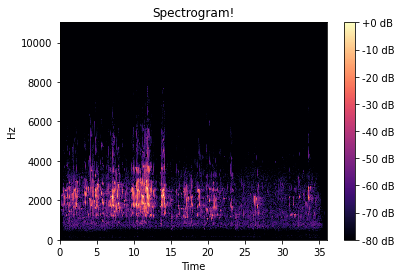

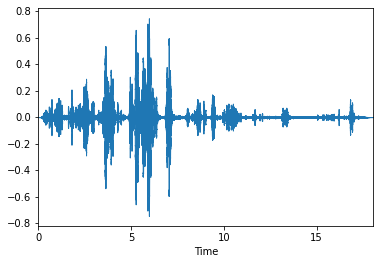

In [11]:
D = librosa.stft(signal)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure()

# Pyplot interface
# librosa.display.specshow(S_db)
# plt.colorbar()

# Object-oriented interface
fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='linear', ax=ax)
ax.set(title='Spectrogram!')
fig.colorbar(img, ax=ax, format="%+2.f dB")
plt.show()

plt.figure()
librosa.display.waveplot(signal,sr=sample_rate, max_points=50000.0, x_axis='time', offset=0.0, max_sr=1000)
plt.show()

# plt.figure(figsize=(10, 4))
# librosa.display.specshow(librosa.power_to_db(y,ref=np.max), y_axis='mel', fmax=8000, x_axis='time')
# plt.colorbar(format='%+2.0f dB')
# plt.title('Mel spectrogram')
# plt.tight_layout()
# plt.show()

In [17]:
help(librosa.feature.melspectrogram)

Help on function melspectrogram in module librosa.feature.spectral:

melspectrogram(y=None, sr=22050, S=None, n_fft=2048, hop_length=512, win_length=None, window='hann', center=True, pad_mode='reflect', power=2.0, **kwargs)
    Compute a mel-scaled spectrogram.
    
    If a spectrogram input ``S`` is provided, then it is mapped directly onto
    the mel basis by ``mel_f.dot(S)``.
    
    If a time-series input ``y, sr`` is provided, then its magnitude spectrogram
    ``S`` is first computed, and then mapped onto the mel scale by
    ``mel_f.dot(S**power)``.
    
    By default, ``power=2`` operates on a power spectrum.
    
    Parameters
    ----------
    y : np.ndarray [shape=(n,)] or None
        audio time-series
    
    sr : number > 0 [scalar]
        sampling rate of ``y``
    
    S : np.ndarray [shape=(d, t)]
        spectrogram
    
    n_fft : int > 0 [scalar]
        length of the FFT window
    
    hop_length : int > 0 [scalar]
        number of samples between succes

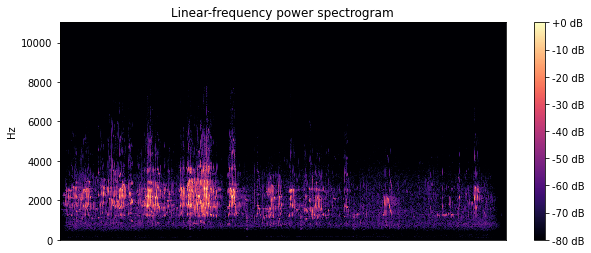

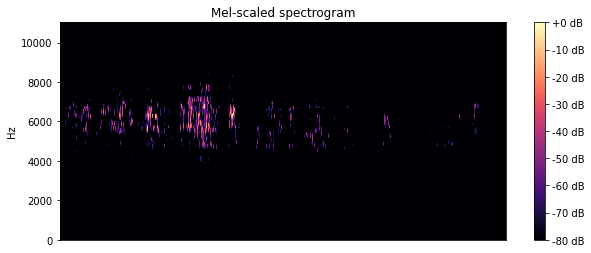

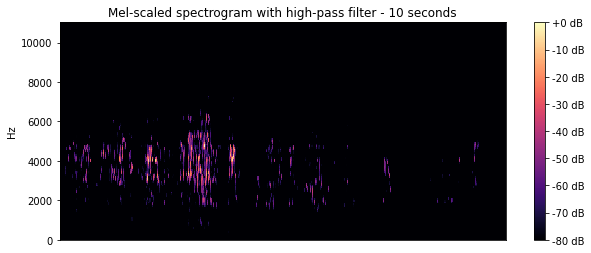

In [14]:

# Plot spectogram
plt.figure(figsize=(10, 4))
D = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)
librosa.display.specshow(D, y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')
plt.show()

# Plot mel-spectrogram
N_FFT = 1024         
HOP_SIZE = 1024       
N_MELS = 128            
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 0 

S = librosa.feature.melspectrogram(y=signal,sr=sample_rate,
                                    n_fft=N_FFT,
                                    hop_length=HOP_SIZE, 
                                    n_mels=N_MELS, 
                                    htk=True, 
                                    fmin=FMIN, 
                                    fmax=sample_rate/2) 

plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max), fmin=FMIN,y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-scaled spectrogram')
plt.show()

# Plot mel-spectrogram with high-pass filter
N_FFT = 1024         
HOP_SIZE = 1024       
N_MELS = 128            
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 1400 

S = librosa.feature.melspectrogram(y=signal,sr=sample_rate,
                                    n_fft=N_FFT,
                                    hop_length=HOP_SIZE, 
                                    n_mels=N_MELS, 
                                    htk=True, 
                                    fmin=FMIN, 
                                    fmax=sample_rate/2) 

plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max), fmin=FMIN,y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-scaled spectrogram with high-pass filter - 10 seconds')
plt.show()

# Creating Mel-Spectograms for CNN

In [3]:

os.chdir('D:/BirdImagesForCNN/')
os.getcwd()

'D:\\BirdImagesForCNN'

In [22]:
N_FFT = 1024         
HOP_SIZE = 1024       
N_MELS = 128            
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 1400 



for wav in os.listdir('D:/wavAudio/'):
    if(wav + '.png' in os.listdir('D:/BirdImagesForCNN/')) or (wav[:-3] + '.png' in os.listdir('D:/BirdImagesForCNN/')):
        print(wav)
        continue
    signal, sample_rate = librosa.load('D:/wavAudio/' + str(wav) ,sr = None)
    print(wav)
    S = librosa.feature.melspectrogram(y=signal,sr=sample_rate,
                                    n_fft=N_FFT,
                                    hop_length=HOP_SIZE, 
                                    n_mels=N_MELS, 
                                    htk=True, 
                                    fmin=FMIN, 
                                    fmax=sample_rate/2) 

    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max), fmin=FMIN,y_axis='linear')
#     plt.colorbar(format='%+2.0f dB')
#     plt.title('Mel-scaled spectrogram with high-pass filter - 10 seconds')
    plt.axis('off')
#     plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off',
#                     labelright='off', labelbottom='off')
#     plt.legend('',frameon=False)
    plt.savefig('D:/BirdImagesForCNN/' + wav[:-3] + '.png',bbox_inches='tight',transparent=True, pad_inches=0)
    plt.clf()
    plt.close("all")
    gc.collect()
#     plt.show()
    

# Plot mel-spectrogram with high-pass filter




0.wav
1.wav
10.wav
100.wav
1000.wav
10000.wav
10001.wav
10002.wav
10003.wav
10004.wav
10005.wav
10006.wav
10007.wav
10008.wav
10009.wav
10010.wav
10011.wav
10012.wav
10013.wav
10014.wav
10015.wav
10016.wav
10017.wav
10018.wav
10019.wav
1002.wav
10020.wav
10021.wav
10022.wav
10023.wav
10024.wav
10025.wav
10026.wav
10027.wav
10028.wav
10029.wav
1003.wav
10030.wav
10031.wav
10032.wav
10033.wav
10034.wav
10035.wav
10036.wav
10037.wav
10038.wav
10039.wav
1004.wav
10040.wav
10041.wav
10042.wav
10043.wav
10044.wav
10045.wav
10046.wav
10047.wav
10048.wav
10049.wav
1005.wav
10050.wav
10051.wav
10052.wav
10053.wav
10054.wav
10055.wav
10056.wav
10057.wav
10058.wav
10059.wav
1006.wav
10060.wav
10061.wav
10062.wav
10063.wav
10064.wav
10065.wav
10066.wav
10067.wav
10068.wav
10069.wav
1007.wav
10070.wav
10071.wav
10072.wav
10073.wav
10074.wav
10075.wav
10076.wav
10077.wav
10078.wav
10079.wav
1008.wav
10080.wav
10081.wav
10082.wav
10083.wav
10084.wav
10085.wav
10086.wav
10087.wav
10088.wav
10089.wav
1

10819.wav
1082.wav
10820.wav
10821.wav
10822.wav
10823.wav
10824.wav
10825.wav
10826.wav
10827.wav
10828.wav
10829.wav
1083.wav
10830.wav
10831.wav
10832.wav
10833.wav
10834.wav
10835.wav
10836.wav
10837.wav
10838.wav
10839.wav
1084.wav
10840.wav
10841.wav
10842.wav
10843.wav
10844.wav
10845.wav
10846.wav
10847.wav
10848.wav
10849.wav
1085.wav
10850.wav
10851.wav
10852.wav
10853.wav
10854.wav
10855.wav
10856.wav
10857.wav
10858.wav
10859.wav
1086.wav
10860.wav
10861.wav
10862.wav
10863.wav
10864.wav
10865.wav
10866.wav
10867.wav
10868.wav
10869.wav
1087.wav
10870.wav
10871.wav
10872.wav
10873.wav
10874.wav
10875.wav
10876.wav
10877.wav
10878.wav
10879.wav
1088.wav
10880.wav
10881.wav
10882.wav
10883.wav
10884.wav
10885.wav
10886.wav
10887.wav
10888.wav
10889.wav
1089.wav
10890.wav
10891.wav
10892.wav
10893.wav
10896.wav
10897.wav
10898.wav
10899.wav
109.wav
1090.wav
10900.wav
10901.wav
10902.wav
10903.wav
10904.wav
10905.wav
10906.wav
10907.wav
10908.wav
10909.wav
1091.wav
10910.wav
10

11696.wav
11697.wav
11698.wav
11699.wav
1170.wav
11700.wav
11701.wav
11702.wav
11703.wav
11704.wav
11705.wav
11706.wav
11707.wav
11708.wav
11709.wav
1171.wav
11710.wav
11711.wav
11712.wav
11713.wav
11714.wav
11715.wav
11716.wav
11717.wav
11718.wav
11719.wav
1172.wav
11720.wav
11721.wav
11722.wav
11723.wav
11724.wav
11725.wav
11726.wav
11727.wav
11728.wav
11729.wav
1173.wav
11730.wav
11731.wav
11732.wav
11733.wav
11734.wav
11736.wav
11737.wav
11738.wav
11739.wav
1174.wav
11740.wav
1175.wav
11757.wav
11758.wav
11759.wav
1176.wav
11760.wav
11761.wav
11762.wav
11763.wav
11764.wav
11765.wav
11766.wav
11767.wav
11768.wav
11769.wav
1177.wav
11770.wav
11771.wav
11772.wav
11773.wav
11774.wav
11775.wav
11776.wav
11777.wav
11778.wav
11779.wav
1178.wav
11780.wav
11781.wav
11782.wav
11783.wav
11784.wav
11785.wav
11786.wav
11787.wav
11788.wav
11789.wav
1179.wav
11790.wav
11791.wav
11792.wav
11793.wav
11794.wav
11795.wav
11796.wav
11797.wav
11798.wav
11799.wav
118.wav
1180.wav
11800.wav
11801.wav
118

12800.wav
12801.wav
12802.wav
12803.wav
12804.wav
12805.wav
12806.wav
12807.wav
12808.wav
12809.wav
1281.wav
12810.wav
12811.wav
12812.wav
12813.wav
12814.wav
12815.wav
12816.wav
12817.wav
12818.wav
12819.wav
1282.wav
12820.wav
12821.wav
12822.wav
12823.wav
12824.wav
12825.wav
12826.wav
12827.wav
12828.wav
1283.wav
12830.wav
12831.wav
12833.wav
12834.wav
12836.wav
12837.wav
12838.wav
12839.wav
1284.wav
12840.wav
12841.wav
12842.wav
12843.wav
12844.wav
12845.wav
12846.wav
12847.wav
12848.wav
12849.wav
1285.wav
12850.wav
12851.wav
12853.wav
12854.wav
12855.wav
12856.wav
12857.wav
12858.wav
12859.wav
1286.wav
12860.wav
12861.wav
12862.wav
12863.wav
12864.wav
12865.wav
12866.wav
12867.wav
12868.wav
1287.wav
12870.wav
12871.wav
12872.wav
12873.wav
12874.wav
12875.wav
12876.wav
12877.wav
12878.wav
12879.wav
1288.wav
12880.wav
12881.wav
12882.wav
12883.wav
12884.wav
12885.wav
12886.wav
12887.wav
12888.wav
12889.wav
1289.wav
12890.wav
12891.wav
12892.wav
12893.wav
12894.wav
12895.wav
12896.wav

13585.wav
13586.wav
13587.wav
13588.wav
1359.wav
13590.wav
13591.wav
13592.wav
13593.wav
13594.wav
13595.wav
13596.wav
13597.wav
13598.wav
13599.wav
136.wav
1360.wav
13601.wav
13602.wav
13603.wav
13604.wav
13605.wav
13606.wav
13607.wav
13608.wav
13609.wav
1361.wav
13610.wav
13611.wav
13612.wav
13613.wav
13614.wav
13618.wav
13619.wav
1362.wav
13620.wav
13621.wav
13622.wav
13623.wav
13624.wav
13625.wav
13626.wav
13627.wav
13629.wav
1363.wav
13630.wav
13631.wav
13632.wav
13633.wav
13634.wav
13635.wav
13636.wav
13637.wav
13638.wav
13639.wav
1364.wav
13640.wav
13641.wav
13642.wav
13643.wav
13644.wav
13645.wav
13646.wav
13647.wav
13648.wav
13649.wav
1365.wav
13650.wav
13651.wav
13652.wav
13653.wav
13654.wav
13655.wav
13656.wav
13657.wav
13658.wav
13659.wav
1366.wav
13660.wav
13661.wav
13662.wav
13663.wav
13664.wav
13665.wav
13666.wav
13667.wav
13668.wav
13669.wav
1367.wav
13670.wav
13671.wav
13672.wav
13673.wav
13674.wav
13675.wav
13676.wav
13677.wav
13678.wav
13679.wav
1368.wav
13680.wav
13

14385.wav
14386.wav
14387.wav
14388.wav
14389.wav
1439.wav
14390.wav
14391.wav
14393.wav
14394.wav
14395.wav
14396.wav
14397.wav
14399.wav
144.wav
1440.wav
14400.wav
14401.wav
14402.wav
14403.wav
14404.wav
14405.wav
14406.wav
14407.wav
14408.wav
14409.wav
1441.wav
14410.wav
14411.wav
14412.wav
14413.wav
14414.wav
14416.wav
14417.wav
14418.wav
1442.wav
14421.wav
14422.wav
14423.wav
14425.wav
14426.wav
14427.wav
14428.wav
14429.wav
1443.wav
14430.wav
14431.wav
14432.wav
14433.wav
14434.wav
14435.wav
14436.wav
14437.wav
14438.wav
14439.wav
1444.wav
14440.wav
14441.wav
14442.wav
14443.wav
14444.wav
14445.wav
14446.wav
14447.wav
14449.wav
1445.wav
14451.wav
14452.wav
14453.wav
14454.wav
14455.wav
14456.wav
14457.wav
14458.wav
14459.wav
1446.wav
14460.wav
14461.wav
14462.wav
14463.wav
14464.wav
14465.wav
14466.wav
14467.wav
14468.wav
14469.wav
1447.wav
14470.wav
14471.wav
14472.wav
14473.wav
14474.wav
14475.wav
14476.wav
14477.wav
14478.wav
14479.wav
14480.wav
14481.wav
14482.wav
14483.wav
1

1727.wav
1728.wav
1729.wav
173.wav
1730.wav
1731.wav
1732.wav
1733.wav
1734.wav
1735.wav
1736.wav
1737.wav
1738.wav
1739.wav
174.wav
1740.wav
1741.wav
1742.wav
1743.wav
1744.wav
1745.wav
1746.wav
1747.wav
1748.wav
1749.wav
175.wav
1750.wav
1752.wav
1753.wav
1754.wav
1755.wav
1756.wav
1757.wav
1758.wav
1759.wav
176.wav
1760.wav
1761.wav
1762.wav
1763.wav
1764.wav
1765.wav
1766.wav
1767.wav
1768.wav
1769.wav
177.wav
1770.wav
1771.wav
1772.wav
1773.wav
1774.wav
1775.wav
1776.wav
1778.wav
1779.wav
178.wav
1780.wav
1781.wav
1782.wav
1783.wav
1784.wav
1785.wav
1786.wav
1787.wav
1788.wav
1789.wav
179.wav
1790.wav
1791.wav
1792.wav
1793.wav
1794.wav
1795.wav
1796.wav
1797.wav
1798.wav
1799.wav
18.wav
180.wav
1800.wav
1801.wav
1802.wav
1803.wav
1804.wav
1805.wav
1806.wav
1807.wav
1808.wav
1809.wav
181.wav
1810.wav
1811.wav
1812.wav
1813.wav
1814.wav
1815.wav
1816.wav
1817.wav
1818.wav
1819.wav
182.wav
1820.wav
1821.wav
1822.wav
1823.wav
1825.wav
1826.wav
1827.wav
1828.wav
1829.wav
183.wav
1830.

258.wav
2580.wav
2581.wav
2582.wav
2583.wav
2584.wav
2585.wav
2586.wav
2587.wav
259.wav
2590.wav
2591.wav
2592.wav
2593.wav
2594.wav
2595.wav
2596.wav
2597.wav
2598.wav
2599.wav
26.wav
260.wav
2600.wav
2601.wav
2602.wav
2603.wav
2604.wav
2605.wav
2606.wav
2607.wav
2608.wav
2609.wav
261.wav
2610.wav
2611.wav
2612.wav
2613.wav
2614.wav
2615.wav
2616.wav
2617.wav
2618.wav
2619.wav
262.wav
2620.wav
2621.wav
2622.wav
2623.wav
2624.wav
2625.wav
2626.wav
2627.wav
2628.wav
2629.wav
263.wav
2630.wav
2631.wav
2632.wav
2633.wav
2634.wav
2635.wav
2636.wav
2637.wav
2638.wav
2639.wav
264.wav
2640.wav
2641.wav
2642.wav
2643.wav
2644.wav
2645.wav
2646.wav
2647.wav
2648.wav
2649.wav
265.wav
2650.wav
2651.wav
2652.wav
2653.wav
2654.wav
2655.wav
2656.wav
2657.wav
2658.wav
2659.wav
266.wav
2660.wav
2661.wav
2662.wav
2663.wav
2664.wav
2665.wav
2666.wav
2667.wav
2668.wav
2669.wav
267.wav
2670.wav
2671.wav
2672.wav
2673.wav
2674.wav
2675.wav
2676.wav
2677.wav
2678.wav
2679.wav
268.wav
2680.wav
2681.wav
2682.

3416.wav
3417.wav
3418.wav
3419.wav
342.wav
3420.wav
3421.wav
3422.wav
3423.wav
3424.wav
3425.wav
3426.wav
3427.wav
3428.wav
3429.wav
343.wav
3430.wav
3431.wav
3432.wav
3433.wav
3434.wav
3435.wav
3436.wav
3438.wav
3439.wav
344.wav
3440.wav
3441.wav
3442.wav
3443.wav
3444.wav
3445.wav
3446.wav
3447.wav
3448.wav
3449.wav
345.wav
3450.wav
3451.wav
3452.wav
3453.wav
3454.wav
3455.wav
3456.wav
3457.wav
3458.wav
3459.wav
346.wav
3460.wav
3461.wav
3462.wav
3463.wav
3464.wav
3465.wav
3466.wav
3467.wav
3468.wav
3469.wav
347.wav
3470.wav
3471.wav
3472.wav
3473.wav
3474.wav
3475.wav
3476.wav
3477.wav
3478.wav
3479.wav
348.wav
3480.wav
3481.wav
3482.wav
3483.wav
3484.wav
3485.wav
3486.wav
3487.wav
3488.wav
3489.wav
349.wav
3490.wav
3491.wav
3492.wav
3493.wav
3494.wav
3495.wav
3496.wav
3497.wav
3498.wav
3499.wav
35.wav
350.wav
3500.wav
3501.wav
3502.wav
3503.wav
3504.wav
3505.wav
3506.wav
3507.wav
3508.wav
3509.wav
351.wav
3510.wav
3511.wav
3512.wav
3513.wav
3514.wav
3515.wav
3516.wav
3517.wav
3518

4258.wav
4259.wav
426.wav
4260.wav
4261.wav
4262.wav
4263.wav
4264.wav
4265.wav
4266.wav
4267.wav
4268.wav
4269.wav
427.wav
4270.wav
4271.wav
4272.wav
4273.wav
4274.wav
4275.wav
4276.wav
4277.wav
4278.wav
4279.wav
428.wav
4280.wav
4281.wav
4282.wav
4283.wav
4284.wav
4285.wav
4286.wav
4287.wav
4288.wav
4289.wav
429.wav
4290.wav
4291.wav
4292.wav
4293.wav
4294.wav
4295.wav
4296.wav
4297.wav
4298.wav
4299.wav
43.wav
430.wav
4300.wav
4301.wav
4302.wav
4303.wav
4304.wav
4305.wav
4306.wav
4307.wav
4308.wav
4309.wav
431.wav
4310.wav
4311.wav
4312.wav
4313.wav
4314.wav
4315.wav
4316.wav
4317.wav
4318.wav
4319.wav
432.wav
4320.wav
4321.wav
4322.wav
4323.wav
4324.wav
4325.wav
4326.wav
4327.wav
4328.wav
4329.wav
433.wav
4330.wav
4331.wav
4332.wav
4333.wav
4334.wav
4335.wav
4336.wav
4337.wav
4338.wav
4339.wav
434.wav
4340.wav
4341.wav
4342.wav
4343.wav
4344.wav
4345.wav
4346.wav
4347.wav
4348.wav
4349.wav
435.wav
4350.wav
4351.wav
4352.wav
4353.wav
4354.wav
4355.wav
4356.wav
4357.wav
4358.wav
4359

5109.wav
511.wav
5110.wav
5111.wav
5112.wav
5113.wav
5114.wav
5115.wav
5116.wav
5117.wav
5118.wav
5119.wav
512.wav
5120.wav
5121.wav
5122.wav
5123.wav
5124.wav
5125.wav
5126.wav
5127.wav
5128.wav
5129.wav
513.wav
5130.wav
5131.wav
5132.wav
5133.wav
5134.wav
5135.wav
5136.wav
5137.wav
5138.wav
5139.wav
514.wav
5140.wav
5141.wav
5142.wav
5143.wav
5144.wav
5145.wav
5146.wav
5147.wav
5148.wav
5149.wav
515.wav
5150.wav
5151.wav
5152.wav
5153.wav
5154.wav
5155.wav
5156.wav
5157.wav
5158.wav
5159.wav
516.wav
5160.wav
5161.wav
5162.wav
5163.wav
5164.wav
5165.wav
5166.wav
5167.wav
5168.wav
5169.wav
517.wav
5170.wav
5171.wav
5172.wav
5173.wav
5174.wav
5175.wav
5176.wav
5177.wav
5179.wav
518.wav
5180.wav
5181.wav
5182.wav
5183.wav
5184.wav
5185.wav
5186.wav
5187.wav
5188.wav
5189.wav
519.wav
5190.wav
5191.wav
5192.wav
5193.wav
5194.wav
5195.wav
5196.wav
5197.wav
5198.wav
5199.wav
52.wav
520.wav
5200.wav
5201.wav
5202.wav
5203.wav
5204.wav
5205.wav
5206.wav
5207.wav
5208.wav
5209.wav
521.wav
5210.

6002.wav
6003.wav
6004.wav
6005.wav
6006.wav
6007.wav
6008.wav
6009.wav
601.wav
6010.wav
6011.wav
6012.wav
6013.wav
6014.wav
6015.wav
6016.wav
6017.wav
6018.wav
6019.wav
602.wav
6020.wav
6021.wav
6022.wav
6023.wav
6024.wav
6025.wav
6026.wav
6027.wav
6028.wav
6029.wav
603.wav
6030.wav
6031.wav
6032.wav
6033.wav
6034.wav
6035.wav
6036.wav
6037.wav
6038.wav
6039.wav
604.wav
6040.wav
6041.wav
6042.wav
6043.wav
6044.wav
6045.wav
6046.wav
6047.wav
6048.wav
6049.wav
605.wav
6050.wav
6051.wav
6052.wav
6053.wav
6054.wav
6056.wav
6058.wav
6059.wav
606.wav
6060.wav
6061.wav
6062.wav
6063.wav
6064.wav
6065.wav
6066.wav
6067.wav
6068.wav
6069.wav
607.wav
6070.wav
6071.wav
6072.wav
6073.wav
6074.wav
608.wav
609.wav
6091.wav
6092.wav
6093.wav
6094.wav
6095.wav
6096.wav
6097.wav
6098.wav
6099.wav
61.wav
610.wav
6100.wav
6101.wav
6102.wav
6103.wav
6104.wav
6105.wav
6106.wav
6107.wav
6108.wav
6109.wav
611.wav
6110.wav
6111.wav
6112.wav
6113.wav
6114.wav
6115.wav
6116.wav
6117.wav
6118.wav
6119.wav
612.w

6860.wav
6861.wav
6862.wav
6863.wav
6864.wav
6865.wav
6866.wav
6867.wav
6868.wav
6869.wav
687.wav
6870.wav
6871.wav
6872.wav
6873.wav
6874.wav
6875.wav
6876.wav
6877.wav
6878.wav
6879.wav
688.wav
6880.wav
6881.wav
6882.wav
6883.wav
6884.wav
6885.wav
6886.wav
6887.wav
6888.wav
6889.wav
689.wav
6890.wav
6891.wav
6892.wav
6893.wav
6894.wav
6895.wav
6896.wav
6897.wav
6898.wav
6899.wav
69.wav
690.wav
6900.wav
6901.wav
6902.wav
6903.wav
6904.wav
6905.wav
6906.wav
6907.wav
6909.wav
691.wav
6911.wav
6912.wav
6913.wav
6914.wav
6915.wav
6916.wav
6917.wav
6918.wav
6919.wav
692.wav
6920.wav
6921.wav
6922.wav
6923.wav
6924.wav
6925.wav
6926.wav
6927.wav
6928.wav
6929.wav
693.wav
6930.wav
6931.wav
6932.wav
6933.wav
6934.wav
6935.wav
6936.wav
6937.wav
6938.wav
6939.wav
694.wav
6940.wav
6941.wav
6942.wav
6943.wav
6944.wav
6945.wav
6946.wav
6947.wav
6948.wav
6949.wav
695.wav
6950.wav
6951.wav
6952.wav
6953.wav
6954.wav
6955.wav
6956.wav
6957.wav
6958.wav
6959.wav
6960.wav
6961.wav
6962.wav
6963.wav
696

7713.wav
7714.wav
7715.wav
7716.wav
7717.wav
7718.wav
7719.wav
772.wav
7720.wav
7721.wav
7722.wav
7723.wav
7724.wav
7725.wav
7726.wav
7727.wav
7728.wav
7729.wav
773.wav
7730.wav
7731.wav
7732.wav
7733.wav
7734.wav
7735.wav
7736.wav
7737.wav
7738.wav
7739.wav
774.wav
7740.wav
7741.wav
7742.wav
7743.wav
7744.wav
7745.wav
7746.wav
7747.wav
7748.wav
7749.wav
775.wav
7750.wav
7751.wav
7752.wav
7753.wav
7754.wav
7755.wav
7756.wav
7757.wav
7758.wav
7759.wav
776.wav
7760.wav
7761.wav
7762.wav
7763.wav
7764.wav
7765.wav
7766.wav
7767.wav
7768.wav
7769.wav
777.wav
7770.wav
7771.wav
7772.wav
7773.wav
7774.wav
7775.wav
7776.wav
7777.wav
7778.wav
7779.wav
778.wav
7780.wav
7781.wav
7782.wav
7783.wav
7784.wav
7785.wav
7786.wav
7787.wav
7788.wav
7789.wav
779.wav
7790.wav
7791.wav
7792.wav
7793.wav
7794.wav
7795.wav
7796.wav
7797.wav
7798.wav
7799.wav
78.wav
780.wav
7800.wav
7801.wav
7802.wav
7803.wav
7804.wav
7805.wav
7806.wav
7807.wav
7808.wav
7809.wav
781.wav
7810.wav
7811.wav
7812.wav
7813.wav
7814

8559.wav
856.wav
8560.wav
8561.wav
8562.wav
8563.wav
8564.wav
8565.wav
8566.wav
8567.wav
8568.wav
8569.wav
857.wav
8570.wav
8571.wav
8572.wav
8573.wav
8574.wav
8575.wav
8576.wav
8577.wav
8578.wav
8579.wav
858.wav
8580.wav
8581.wav
8582.wav
8583.wav
8586.wav
8587.wav
8588.wav
8589.wav
859.wav
8590.wav
8591.wav
8592.wav
8593.wav
8594.wav
8595.wav
8596.wav
8597.wav
8598.wav
8599.wav
86.wav
860.wav
8600.wav
8601.wav
8602.wav
8603.wav
8605.wav
8606.wav
8607.wav
8608.wav
861.wav
8610.wav
8611.wav
8612.wav
8613.wav
8614.wav
8615.wav
8616.wav
8617.wav
8618.wav
8619.wav
862.wav
8620.wav
8621.wav
8622.wav
8623.wav
8624.wav
8625.wav
8626.wav
8627.wav
8628.wav
8629.wav
863.wav
8630.wav
8631.wav
8632.wav
8633.wav
8634.wav
8635.wav
8636.wav
8637.wav
8638.wav
8639.wav
864.wav
8640.wav
8641.wav
8642.wav
8643.wav
8644.wav
8645.wav
8646.wav
8647.wav
8648.wav
8649.wav
865.wav
8650.wav
8651.wav
8652.wav
8653.wav
8654.wav
8655.wav
8656.wav
8657.wav
8658.wav
8659.wav
866.wav
8660.wav
8661.wav
8662.wav
8663.

9406.wav
9407.wav
9408.wav
9409.wav
941.wav
9410.wav
9411.wav
9412.wav
9413.wav
9414.wav
9415.wav
9416.wav
9417.wav
9418.wav
9419.wav
942.wav
9420.wav
9421.wav
9422.wav
9423.wav
9424.wav
9425.wav
9426.wav
9427.wav
9428.wav
9429.wav
943.wav
9430.wav
9431.wav
9432.wav
9433.wav
9434.wav
9435.wav
9436.wav
9437.wav
9438.wav
9439.wav
944.wav
9440.wav
9441.wav
9442.wav
9443.wav
9444.wav
9445.wav
9446.wav
9447.wav
9448.wav
9449.wav
945.wav
9450.wav
9451.wav
9452.wav
9453.wav
9454.wav
9455.wav
9456.wav
9457.wav
9458.wav
9459.wav
9460.wav
9461.wav
9462.wav
9463.wav
9464.wav
9465.wav
9466.wav
9467.wav
9468.wav
9469.wav
947.wav
9470.wav
9471.wav
9472.wav
9473.wav
9474.wav
9475.wav
9476.wav
9477.wav
9478.wav
9479.wav
948.wav
9480.wav
9481.wav
9482.wav
9483.wav
9484.wav
9485.wav
9486.wav
9487.wav
9488.wav
9489.wav
9490.wav
9491.wav
9492.wav
9493.wav
9494.wav
9495.wav
9496.wav
9497.wav
9498.wav
9499.wav
95.wav
950.wav
9500.wav
9501.wav
9502.wav
9503.wav
9504.wav
9505.wav
9506.wav
9507.wav
9508.wav
95

In [13]:
os.chdir('D:/BirdImagesForCNN/')
for img in os.listdir('D:/BirdImagesForCNN/'):
    if img[:-4].endswith('.'):
        os.rename(img, img[:-4][:-1] + '.png')
    if img[:-4].endswith('wav'):
        os.rename(img, img[:-8] + '.png')

In [23]:
gc.collect()

1053144

## Trimming the silent parts of the audio

In [53]:
wavfilepath = Path('D:/wavAudio/')
signal, sample_rate = librosa.load(wavfilepath / '0.wav',sr = None)
signal[librosa.effects.split(signal)[0][0] : librosa.effects.split(signal)[0][-1]]

array([ 0.02267456,  0.02566528,  0.02252197, ..., -0.00028992,
       -0.00012207, -0.00015259], dtype=float32)

In [54]:
def removeSilence(signal):
    return signal[librosa.effects.split(signal)[0][0] : librosa.effects.split(signal)[0][-1]]

# Extracting features for modelling using Mel-Frequency Cepstral Coefficients(MFCC)

__MFCC acts as a Music Information Retreival method__

The mel frequency cepstral coefficients (MFCCs) of a signal are a small set of features (usually about 10-20) which concisely describe the overall shape of a spectral envelope. In MIR, it is often used to describe timbre.

The transformation from the Hertz scale to the Mel Scale is the following:
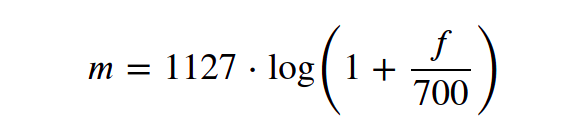

__Mel Spectrograms__:
Mel Spectrograms are spectrograms that visualize sounds on the Mel scale as opposed to the frequency domain

The basic procedure to develop MFCCs is the following:

1. Convert from Hertz to Mel Scale
2. Take logarithm of Mel representation of audio
3. Take logarithmic magnitude and use Discrete Cosine Transformation
4. This result creates a spectrum over Mel frequencies as opposed to time, thus creating MFCCs








In [9]:
def mfcc_features(signal,sample_rate):
    return np.mean(librosa.feature.mfcc(y=signal, sr=sample_rate, n_mfcc=20).T,axis=0).tolist()

In [10]:
def audio_preprocessing(wavfilepath):
    final_df = pd.DataFrame()
#     df['mfcc_features'] = ""
    for wav in os.listdir(wavfilepath):
        if '-' not in wav:
            continue
        signal, sample_rate = librosa.load(wavfilepath / wav,sr = None)
        
#         signal = removeSilence(signal)
        final_df = final_df.append(pd.DataFrame([str(mfcc_features(signal,sample_rate)),df.iloc[int(wav.split('-')[0]),4]]).transpose())
#         print(final_df)
#         df.iloc[int(wav[:-4]),26] = str(mfcc_features(signal,sample_rate))
        print(f"{wav} features extracted from it")
    
    return final_df

In [11]:
wavfilepath = Path('D:/wavAudio4MFCC/')
final_df = audio_preprocessing(wavfilepath)
final_df

1-1.wav features extracted from it
1-2.wav features extracted from it
1-3.wav features extracted from it
10-1.wav features extracted from it
10-2.wav features extracted from it
1000-1.wav features extracted from it
1000-2.wav features extracted from it
1000-3.wav features extracted from it
1000-4.wav features extracted from it
10000-1.wav features extracted from it
10000-2.wav features extracted from it
10001-1.wav features extracted from it
10001-2.wav features extracted from it
10001-3.wav features extracted from it
10001-4.wav features extracted from it
10001-5.wav features extracted from it
10003-1.wav features extracted from it
10003-2.wav features extracted from it
10003-3.wav features extracted from it
10003-4.wav features extracted from it
10004-1.wav features extracted from it
10004-2.wav features extracted from it
10004-3.wav features extracted from it
10004-4.wav features extracted from it
10004-5.wav features extracted from it
10004-6.wav features extracted from it
10004-7.

10028-18.wav features extracted from it
10028-19.wav features extracted from it
10028-2.wav features extracted from it
10028-20.wav features extracted from it
10028-21.wav features extracted from it
10028-22.wav features extracted from it
10028-23.wav features extracted from it
10028-24.wav features extracted from it
10028-25.wav features extracted from it
10028-26.wav features extracted from it
10028-27.wav features extracted from it
10028-28.wav features extracted from it
10028-29.wav features extracted from it
10028-3.wav features extracted from it
10028-30.wav features extracted from it
10028-31.wav features extracted from it
10028-32.wav features extracted from it
10028-33.wav features extracted from it
10028-34.wav features extracted from it
10028-35.wav features extracted from it
10028-36.wav features extracted from it
10028-37.wav features extracted from it
10028-38.wav features extracted from it
10028-39.wav features extracted from it
10028-4.wav features extracted from it
100

10052-2.wav features extracted from it
10052-3.wav features extracted from it
10052-4.wav features extracted from it
10052-5.wav features extracted from it
10052-6.wav features extracted from it
10052-7.wav features extracted from it
10052-8.wav features extracted from it
10052-9.wav features extracted from it
10053-1.wav features extracted from it
10053-2.wav features extracted from it
10053-3.wav features extracted from it
10053-4.wav features extracted from it
10053-5.wav features extracted from it
10053-6.wav features extracted from it
10054-1.wav features extracted from it
10054-2.wav features extracted from it
10054-3.wav features extracted from it
10054-4.wav features extracted from it
10055-1.wav features extracted from it
10055-2.wav features extracted from it
10056-1.wav features extracted from it
10056-2.wav features extracted from it
10057-1.wav features extracted from it
10057-2.wav features extracted from it
10057-3.wav features extracted from it
10057-4.wav features extr

1011-2.wav features extracted from it
1011-3.wav features extracted from it
1011-4.wav features extracted from it
1011-5.wav features extracted from it
1011-6.wav features extracted from it
1011-7.wav features extracted from it
1011-8.wav features extracted from it
1011-9.wav features extracted from it
10110-1.wav features extracted from it
10110-10.wav features extracted from it
10110-11.wav features extracted from it
10110-12.wav features extracted from it
10110-13.wav features extracted from it
10110-14.wav features extracted from it
10110-15.wav features extracted from it
10110-2.wav features extracted from it
10110-3.wav features extracted from it
10110-4.wav features extracted from it
10110-5.wav features extracted from it
10110-6.wav features extracted from it
10110-7.wav features extracted from it
10110-8.wav features extracted from it
10110-9.wav features extracted from it
10111-1.wav features extracted from it
10111-2.wav features extracted from it
10111-3.wav features extrac

10139-7.wav features extracted from it
10139-8.wav features extracted from it
10140-1.wav features extracted from it
10140-10.wav features extracted from it
10140-11.wav features extracted from it
10140-12.wav features extracted from it
10140-13.wav features extracted from it
10140-2.wav features extracted from it
10140-3.wav features extracted from it
10140-4.wav features extracted from it
10140-5.wav features extracted from it
10140-6.wav features extracted from it
10140-7.wav features extracted from it
10140-8.wav features extracted from it
10140-9.wav features extracted from it
10141-1.wav features extracted from it
10141-2.wav features extracted from it
10141-3.wav features extracted from it
10142-1.wav features extracted from it
10142-10.wav features extracted from it
10142-11.wav features extracted from it
10142-12.wav features extracted from it
10142-13.wav features extracted from it
10142-2.wav features extracted from it
10142-3.wav features extracted from it
10142-4.wav featu

10162-2.wav features extracted from it
10162-3.wav features extracted from it
10162-4.wav features extracted from it
10162-5.wav features extracted from it
10162-6.wav features extracted from it
10162-7.wav features extracted from it
10162-8.wav features extracted from it
10163-1.wav features extracted from it
10163-2.wav features extracted from it
10163-3.wav features extracted from it
10163-4.wav features extracted from it
10163-5.wav features extracted from it
10163-6.wav features extracted from it
10164-1.wav features extracted from it
10164-2.wav features extracted from it
10164-3.wav features extracted from it
10165-1.wav features extracted from it
10165-2.wav features extracted from it
10165-3.wav features extracted from it
10166-1.wav features extracted from it
10166-2.wav features extracted from it
10166-3.wav features extracted from it
10167-1.wav features extracted from it
10167-10.wav features extracted from it
10167-2.wav features extracted from it
10167-3.wav features ext

10215-1.wav features extracted from it
10215-2.wav features extracted from it
10215-3.wav features extracted from it
10215-4.wav features extracted from it
10215-5.wav features extracted from it
10215-6.wav features extracted from it
10216-1.wav features extracted from it
10216-2.wav features extracted from it
10216-3.wav features extracted from it
10216-4.wav features extracted from it
10216-5.wav features extracted from it
10216-6.wav features extracted from it
10216-7.wav features extracted from it
10216-8.wav features extracted from it
10217-1.wav features extracted from it
10217-2.wav features extracted from it
10217-3.wav features extracted from it
10217-4.wav features extracted from it
10217-5.wav features extracted from it
10218-1.wav features extracted from it
10218-2.wav features extracted from it
10218-3.wav features extracted from it
10218-4.wav features extracted from it
10219-1.wav features extracted from it
10219-2.wav features extracted from it
10219-3.wav features extr

10247-7.wav features extracted from it
10247-8.wav features extracted from it
10247-9.wav features extracted from it
10248-1.wav features extracted from it
10248-10.wav features extracted from it
10248-11.wav features extracted from it
10248-12.wav features extracted from it
10248-13.wav features extracted from it
10248-14.wav features extracted from it
10248-15.wav features extracted from it
10248-16.wav features extracted from it
10248-17.wav features extracted from it
10248-2.wav features extracted from it
10248-3.wav features extracted from it
10248-4.wav features extracted from it
10248-5.wav features extracted from it
10248-6.wav features extracted from it
10248-7.wav features extracted from it
10248-8.wav features extracted from it
10248-9.wav features extracted from it
10249-1.wav features extracted from it
10249-10.wav features extracted from it
10249-11.wav features extracted from it
10249-12.wav features extracted from it
10249-13.wav features extracted from it
10249-14.wav 

10276-1.wav features extracted from it
10276-10.wav features extracted from it
10276-11.wav features extracted from it
10276-2.wav features extracted from it
10276-3.wav features extracted from it
10276-4.wav features extracted from it
10276-5.wav features extracted from it
10276-6.wav features extracted from it
10276-7.wav features extracted from it
10276-8.wav features extracted from it
10276-9.wav features extracted from it
10277-1.wav features extracted from it
10277-2.wav features extracted from it
10277-3.wav features extracted from it
10277-4.wav features extracted from it
10277-5.wav features extracted from it
10278-1.wav features extracted from it
10278-2.wav features extracted from it
10278-3.wav features extracted from it
10278-4.wav features extracted from it
10278-5.wav features extracted from it
10279-1.wav features extracted from it
10279-10.wav features extracted from it
10279-11.wav features extracted from it
10279-12.wav features extracted from it
10279-13.wav feature

10306-5.wav features extracted from it
10306-6.wav features extracted from it
10306-7.wav features extracted from it
10306-8.wav features extracted from it
10306-9.wav features extracted from it
10307-1.wav features extracted from it
10307-2.wav features extracted from it
10307-3.wav features extracted from it
10307-4.wav features extracted from it
10307-5.wav features extracted from it
10307-6.wav features extracted from it
10307-7.wav features extracted from it
10307-8.wav features extracted from it
10308-1.wav features extracted from it
10308-10.wav features extracted from it
10308-11.wav features extracted from it
10308-12.wav features extracted from it
10308-13.wav features extracted from it
10308-14.wav features extracted from it
10308-15.wav features extracted from it
10308-16.wav features extracted from it
10308-17.wav features extracted from it
10308-18.wav features extracted from it
10308-19.wav features extracted from it
10308-2.wav features extracted from it
10308-20.wav fe

10331-31.wav features extracted from it
10331-32.wav features extracted from it
10331-33.wav features extracted from it
10331-34.wav features extracted from it
10331-35.wav features extracted from it
10331-36.wav features extracted from it
10331-37.wav features extracted from it
10331-38.wav features extracted from it
10331-39.wav features extracted from it
10331-4.wav features extracted from it
10331-40.wav features extracted from it
10331-41.wav features extracted from it
10331-42.wav features extracted from it
10331-43.wav features extracted from it
10331-44.wav features extracted from it
10331-5.wav features extracted from it
10331-6.wav features extracted from it
10331-7.wav features extracted from it
10331-8.wav features extracted from it
10331-9.wav features extracted from it
10332-1.wav features extracted from it
10332-2.wav features extracted from it
10332-3.wav features extracted from it
10332-4.wav features extracted from it
10332-5.wav features extracted from it
10333-1.wav

10356-2.wav features extracted from it
10356-3.wav features extracted from it
10356-4.wav features extracted from it
10356-5.wav features extracted from it
10356-6.wav features extracted from it
10356-7.wav features extracted from it
10356-8.wav features extracted from it
10356-9.wav features extracted from it
10357-1.wav features extracted from it
10357-10.wav features extracted from it
10357-11.wav features extracted from it
10357-12.wav features extracted from it
10357-13.wav features extracted from it
10357-14.wav features extracted from it
10357-15.wav features extracted from it
10357-16.wav features extracted from it
10357-17.wav features extracted from it
10357-18.wav features extracted from it
10357-19.wav features extracted from it
10357-2.wav features extracted from it
10357-20.wav features extracted from it
10357-21.wav features extracted from it
10357-22.wav features extracted from it
10357-23.wav features extracted from it
10357-24.wav features extracted from it
10357-25.w

10385-8.wav features extracted from it
10385-9.wav features extracted from it
10386-1.wav features extracted from it
10386-2.wav features extracted from it
10386-3.wav features extracted from it
10386-4.wav features extracted from it
10386-5.wav features extracted from it
10387-1.wav features extracted from it
10387-2.wav features extracted from it
10387-3.wav features extracted from it
10387-4.wav features extracted from it
10387-5.wav features extracted from it
10388-1.wav features extracted from it
10388-2.wav features extracted from it
10388-3.wav features extracted from it
10388-4.wav features extracted from it
10388-5.wav features extracted from it
10389-1.wav features extracted from it
10389-2.wav features extracted from it
10389-3.wav features extracted from it
10389-4.wav features extracted from it
10389-5.wav features extracted from it
10389-6.wav features extracted from it
10389-7.wav features extracted from it
10389-8.wav features extracted from it
10390-1.wav features extr

10408-6.wav features extracted from it
10409-1.wav features extracted from it
10409-2.wav features extracted from it
10409-3.wav features extracted from it
10409-4.wav features extracted from it
10409-5.wav features extracted from it
1041-1.wav features extracted from it
1041-10.wav features extracted from it
1041-2.wav features extracted from it
1041-3.wav features extracted from it
1041-4.wav features extracted from it
1041-5.wav features extracted from it
1041-6.wav features extracted from it
1041-7.wav features extracted from it
1041-8.wav features extracted from it
1041-9.wav features extracted from it
10410-1.wav features extracted from it
10410-10.wav features extracted from it
10410-11.wav features extracted from it
10410-2.wav features extracted from it
10410-3.wav features extracted from it
10410-4.wav features extracted from it
10410-5.wav features extracted from it
10410-6.wav features extracted from it
10410-7.wav features extracted from it
10410-8.wav features extracted f

10451-4.wav features extracted from it
10454-1.wav features extracted from it
10454-2.wav features extracted from it
10457-1.wav features extracted from it
10457-2.wav features extracted from it
10458-1.wav features extracted from it
10458-2.wav features extracted from it
10458-3.wav features extracted from it
10459-1.wav features extracted from it
10459-2.wav features extracted from it
10459-3.wav features extracted from it
1046-1.wav features extracted from it
1046-2.wav features extracted from it
10460-1.wav features extracted from it
10460-2.wav features extracted from it
10460-3.wav features extracted from it
10460-4.wav features extracted from it
10460-5.wav features extracted from it
10461-1.wav features extracted from it
10461-2.wav features extracted from it
10461-3.wav features extracted from it
10461-4.wav features extracted from it
10461-5.wav features extracted from it
10461-6.wav features extracted from it
10462-1.wav features extracted from it
10462-10.wav features extra

1051-2.wav features extracted from it
1051-3.wav features extracted from it
1051-4.wav features extracted from it
1051-5.wav features extracted from it
1051-6.wav features extracted from it
1051-7.wav features extracted from it
1051-8.wav features extracted from it
1051-9.wav features extracted from it
10510-1.wav features extracted from it
10510-2.wav features extracted from it
10510-3.wav features extracted from it
10510-4.wav features extracted from it
10510-5.wav features extracted from it
10510-6.wav features extracted from it
10511-1.wav features extracted from it
10511-10.wav features extracted from it
10511-2.wav features extracted from it
10511-3.wav features extracted from it
10511-4.wav features extracted from it
10511-5.wav features extracted from it
10511-6.wav features extracted from it
10511-7.wav features extracted from it
10511-8.wav features extracted from it
10511-9.wav features extracted from it
10512-1.wav features extracted from it
10512-10.wav features extracted 

10544-2.wav features extracted from it
10544-3.wav features extracted from it
10544-4.wav features extracted from it
10544-5.wav features extracted from it
10545-1.wav features extracted from it
10545-2.wav features extracted from it
10545-3.wav features extracted from it
10545-4.wav features extracted from it
10545-5.wav features extracted from it
10545-6.wav features extracted from it
10545-7.wav features extracted from it
10545-8.wav features extracted from it
10545-9.wav features extracted from it
10546-1.wav features extracted from it
10546-10.wav features extracted from it
10546-11.wav features extracted from it
10546-12.wav features extracted from it
10546-2.wav features extracted from it
10546-3.wav features extracted from it
10546-4.wav features extracted from it
10546-5.wav features extracted from it
10546-6.wav features extracted from it
10546-7.wav features extracted from it
10546-8.wav features extracted from it
10546-9.wav features extracted from it
10547-1.wav features e

10581-2.wav features extracted from it
10582-1.wav features extracted from it
10582-2.wav features extracted from it
10582-3.wav features extracted from it
10583-1.wav features extracted from it
10583-2.wav features extracted from it
10583-3.wav features extracted from it
10583-4.wav features extracted from it
10584-1.wav features extracted from it
10584-2.wav features extracted from it
10584-3.wav features extracted from it
10584-4.wav features extracted from it
10584-5.wav features extracted from it
10584-6.wav features extracted from it
10584-7.wav features extracted from it
10584-8.wav features extracted from it
10585-1.wav features extracted from it
10585-2.wav features extracted from it
10585-3.wav features extracted from it
10585-4.wav features extracted from it
10585-5.wav features extracted from it
10585-6.wav features extracted from it
10585-7.wav features extracted from it
10586-1.wav features extracted from it
10586-2.wav features extracted from it
10586-3.wav features extr

10608-5.wav features extracted from it
10608-6.wav features extracted from it
10608-7.wav features extracted from it
10608-8.wav features extracted from it
10608-9.wav features extracted from it
10609-1.wav features extracted from it
10609-10.wav features extracted from it
10609-2.wav features extracted from it
10609-3.wav features extracted from it
10609-4.wav features extracted from it
10609-5.wav features extracted from it
10609-6.wav features extracted from it
10609-7.wav features extracted from it
10609-8.wav features extracted from it
10609-9.wav features extracted from it
1061-1.wav features extracted from it
1061-10.wav features extracted from it
1061-11.wav features extracted from it
1061-12.wav features extracted from it
1061-13.wav features extracted from it
1061-14.wav features extracted from it
1061-15.wav features extracted from it
1061-16.wav features extracted from it
1061-17.wav features extracted from it
1061-18.wav features extracted from it
1061-19.wav features extr

10633-5.wav features extracted from it
10633-6.wav features extracted from it
10633-7.wav features extracted from it
10633-8.wav features extracted from it
10633-9.wav features extracted from it
10634-1.wav features extracted from it
10634-2.wav features extracted from it
10635-1.wav features extracted from it
10635-2.wav features extracted from it
10635-3.wav features extracted from it
10635-4.wav features extracted from it
10635-5.wav features extracted from it
10635-6.wav features extracted from it
10635-7.wav features extracted from it
10635-8.wav features extracted from it
10636-1.wav features extracted from it
10636-2.wav features extracted from it
10636-3.wav features extracted from it
10638-1.wav features extracted from it
10638-10.wav features extracted from it
10638-11.wav features extracted from it
10638-12.wav features extracted from it
10638-13.wav features extracted from it
10638-14.wav features extracted from it
10638-15.wav features extracted from it
10638-16.wav featur

1067-4.wav features extracted from it
1067-5.wav features extracted from it
1067-6.wav features extracted from it
1067-7.wav features extracted from it
1067-8.wav features extracted from it
1067-9.wav features extracted from it
10671-1.wav features extracted from it
10671-2.wav features extracted from it
10671-3.wav features extracted from it
10671-4.wav features extracted from it
10671-5.wav features extracted from it
10671-6.wav features extracted from it
10671-7.wav features extracted from it
10671-8.wav features extracted from it
10672-1.wav features extracted from it
10672-2.wav features extracted from it
10672-3.wav features extracted from it
10672-4.wav features extracted from it
10673-1.wav features extracted from it
10673-2.wav features extracted from it
10673-3.wav features extracted from it
10673-4.wav features extracted from it
10674-1.wav features extracted from it
10674-2.wav features extracted from it
10674-3.wav features extracted from it
10674-4.wav features extracted 

1071-2.wav features extracted from it
1071-3.wav features extracted from it
10710-1.wav features extracted from it
10710-2.wav features extracted from it
10710-3.wav features extracted from it
10711-1.wav features extracted from it
10711-10.wav features extracted from it
10711-11.wav features extracted from it
10711-12.wav features extracted from it
10711-13.wav features extracted from it
10711-14.wav features extracted from it
10711-15.wav features extracted from it
10711-2.wav features extracted from it
10711-3.wav features extracted from it
10711-4.wav features extracted from it
10711-5.wav features extracted from it
10711-6.wav features extracted from it
10711-7.wav features extracted from it
10711-8.wav features extracted from it
10711-9.wav features extracted from it
10712-1.wav features extracted from it
10712-2.wav features extracted from it
10712-3.wav features extracted from it
10712-4.wav features extracted from it
10713-1.wav features extracted from it
10713-10.wav features

10737-13.wav features extracted from it
10737-14.wav features extracted from it
10737-15.wav features extracted from it
10737-16.wav features extracted from it
10737-17.wav features extracted from it
10737-18.wav features extracted from it
10737-2.wav features extracted from it
10737-3.wav features extracted from it
10737-4.wav features extracted from it
10737-5.wav features extracted from it
10737-6.wav features extracted from it
10737-7.wav features extracted from it
10737-8.wav features extracted from it
10737-9.wav features extracted from it
10738-1.wav features extracted from it
10738-2.wav features extracted from it
10738-3.wav features extracted from it
10738-4.wav features extracted from it
10738-5.wav features extracted from it
10738-6.wav features extracted from it
10738-7.wav features extracted from it
10738-8.wav features extracted from it
10738-9.wav features extracted from it
10739-1.wav features extracted from it
10739-2.wav features extracted from it
10739-3.wav feature

10756-8.wav features extracted from it
10756-9.wav features extracted from it
10757-1.wav features extracted from it
10757-10.wav features extracted from it
10757-2.wav features extracted from it
10757-3.wav features extracted from it
10757-4.wav features extracted from it
10757-5.wav features extracted from it
10757-6.wav features extracted from it
10757-7.wav features extracted from it
10757-8.wav features extracted from it
10757-9.wav features extracted from it
10758-1.wav features extracted from it
10758-2.wav features extracted from it
10759-1.wav features extracted from it
10759-10.wav features extracted from it
10759-11.wav features extracted from it
10759-2.wav features extracted from it
10759-3.wav features extracted from it
10759-4.wav features extracted from it
10759-5.wav features extracted from it
10759-6.wav features extracted from it
10759-7.wav features extracted from it
10759-8.wav features extracted from it
10759-9.wav features extracted from it
1076-1.wav features ex

10790-1.wav features extracted from it
10790-2.wav features extracted from it
10791-1.wav features extracted from it
10791-2.wav features extracted from it
10792-1.wav features extracted from it
10792-2.wav features extracted from it
10792-3.wav features extracted from it
10792-4.wav features extracted from it
10793-1.wav features extracted from it
10793-2.wav features extracted from it
10793-3.wav features extracted from it
10793-4.wav features extracted from it
10793-5.wav features extracted from it
10793-6.wav features extracted from it
10793-7.wav features extracted from it
10794-1.wav features extracted from it
10794-2.wav features extracted from it
10794-3.wav features extracted from it
10794-4.wav features extracted from it
10794-5.wav features extracted from it
10794-6.wav features extracted from it
10794-7.wav features extracted from it
10795-1.wav features extracted from it
10795-10.wav features extracted from it
10795-11.wav features extracted from it
10795-12.wav features e

10822-5.wav features extracted from it
10822-6.wav features extracted from it
10822-7.wav features extracted from it
10822-8.wav features extracted from it
10822-9.wav features extracted from it
10823-1.wav features extracted from it
10823-2.wav features extracted from it
10823-3.wav features extracted from it
10824-1.wav features extracted from it
10824-2.wav features extracted from it
10824-3.wav features extracted from it
10825-1.wav features extracted from it
10825-2.wav features extracted from it
10825-3.wav features extracted from it
10825-4.wav features extracted from it
10825-5.wav features extracted from it
10825-6.wav features extracted from it
10825-7.wav features extracted from it
10826-1.wav features extracted from it
10826-2.wav features extracted from it
10827-1.wav features extracted from it
10827-10.wav features extracted from it
10827-2.wav features extracted from it
10827-3.wav features extracted from it
10827-4.wav features extracted from it
10827-5.wav features ext

10850-3.wav features extracted from it
10851-1.wav features extracted from it
10851-2.wav features extracted from it
10851-3.wav features extracted from it
10851-4.wav features extracted from it
10851-5.wav features extracted from it
10851-6.wav features extracted from it
10851-7.wav features extracted from it
10851-8.wav features extracted from it
10851-9.wav features extracted from it
10852-1.wav features extracted from it
10852-10.wav features extracted from it
10852-11.wav features extracted from it
10852-12.wav features extracted from it
10852-13.wav features extracted from it
10852-14.wav features extracted from it
10852-15.wav features extracted from it
10852-16.wav features extracted from it
10852-2.wav features extracted from it
10852-3.wav features extracted from it
10852-4.wav features extracted from it
10852-5.wav features extracted from it
10852-6.wav features extracted from it
10852-7.wav features extracted from it
10852-8.wav features extracted from it
10852-9.wav featur

10879-1.wav features extracted from it
10879-10.wav features extracted from it
10879-11.wav features extracted from it
10879-12.wav features extracted from it
10879-2.wav features extracted from it
10879-3.wav features extracted from it
10879-4.wav features extracted from it
10879-5.wav features extracted from it
10879-6.wav features extracted from it
10879-7.wav features extracted from it
10879-8.wav features extracted from it
10879-9.wav features extracted from it
1088-1.wav features extracted from it
1088-2.wav features extracted from it
1088-3.wav features extracted from it
10880-1.wav features extracted from it
10880-2.wav features extracted from it
10880-3.wav features extracted from it
10880-4.wav features extracted from it
10881-1.wav features extracted from it
10881-2.wav features extracted from it
10881-3.wav features extracted from it
10881-4.wav features extracted from it
10881-5.wav features extracted from it
10881-6.wav features extracted from it
10881-7.wav features extr

10942-4.wav features extracted from it
10942-5.wav features extracted from it
10942-6.wav features extracted from it
10943-1.wav features extracted from it
10943-2.wav features extracted from it
10943-3.wav features extracted from it
10943-4.wav features extracted from it
10943-5.wav features extracted from it
10943-6.wav features extracted from it
10944-1.wav features extracted from it
10944-2.wav features extracted from it
10944-3.wav features extracted from it
10944-4.wav features extracted from it
10945-1.wav features extracted from it
10945-2.wav features extracted from it
10945-3.wav features extracted from it
10945-4.wav features extracted from it
10946-1.wav features extracted from it
10946-2.wav features extracted from it
10947-1.wav features extracted from it
10947-2.wav features extracted from it
10947-3.wav features extracted from it
10948-1.wav features extracted from it
10948-2.wav features extracted from it
10948-3.wav features extracted from it
10949-1.wav features extr

10996-2.wav features extracted from it
10996-3.wav features extracted from it
10996-4.wav features extracted from it
10996-5.wav features extracted from it
10996-6.wav features extracted from it
10996-7.wav features extracted from it
10997-1.wav features extracted from it
10997-10.wav features extracted from it
10997-2.wav features extracted from it
10997-3.wav features extracted from it
10997-4.wav features extracted from it
10997-5.wav features extracted from it
10997-6.wav features extracted from it
10997-7.wav features extracted from it
10997-8.wav features extracted from it
10997-9.wav features extracted from it
10998-1.wav features extracted from it
10998-2.wav features extracted from it
10998-3.wav features extracted from it
10998-4.wav features extracted from it
10998-5.wav features extracted from it
10998-6.wav features extracted from it
10999-1.wav features extracted from it
10999-10.wav features extracted from it
10999-11.wav features extracted from it
10999-12.wav features 

11026-12.wav features extracted from it
11026-13.wav features extracted from it
11026-14.wav features extracted from it
11026-15.wav features extracted from it
11026-16.wav features extracted from it
11026-17.wav features extracted from it
11026-18.wav features extracted from it
11026-19.wav features extracted from it
11026-2.wav features extracted from it
11026-20.wav features extracted from it
11026-21.wav features extracted from it
11026-22.wav features extracted from it
11026-23.wav features extracted from it
11026-24.wav features extracted from it
11026-25.wav features extracted from it
11026-26.wav features extracted from it
11026-27.wav features extracted from it
11026-28.wav features extracted from it
11026-29.wav features extracted from it
11026-3.wav features extracted from it
11026-30.wav features extracted from it
11026-31.wav features extracted from it
11026-32.wav features extracted from it
11026-33.wav features extracted from it
11026-34.wav features extracted from it
11

11047-4.wav features extracted from it
11047-5.wav features extracted from it
11048-1.wav features extracted from it
11048-10.wav features extracted from it
11048-11.wav features extracted from it
11048-12.wav features extracted from it
11048-13.wav features extracted from it
11048-2.wav features extracted from it
11048-3.wav features extracted from it
11048-4.wav features extracted from it
11048-5.wav features extracted from it
11048-6.wav features extracted from it
11048-7.wav features extracted from it
11048-8.wav features extracted from it
11048-9.wav features extracted from it
11049-1.wav features extracted from it
11049-2.wav features extracted from it
11049-3.wav features extracted from it
1105-1.wav features extracted from it
1105-2.wav features extracted from it
1105-3.wav features extracted from it
1105-4.wav features extracted from it
1105-5.wav features extracted from it
11050-1.wav features extracted from it
11050-2.wav features extracted from it
11050-3.wav features extra

11105-6.wav features extracted from it
11105-7.wav features extracted from it
11105-8.wav features extracted from it
11105-9.wav features extracted from it
11106-1.wav features extracted from it
11106-10.wav features extracted from it
11106-2.wav features extracted from it
11106-3.wav features extracted from it
11106-4.wav features extracted from it
11106-5.wav features extracted from it
11106-6.wav features extracted from it
11106-7.wav features extracted from it
11106-8.wav features extracted from it
11106-9.wav features extracted from it
11107-1.wav features extracted from it
11107-2.wav features extracted from it
11107-3.wav features extracted from it
11107-4.wav features extracted from it
11107-5.wav features extracted from it
11107-6.wav features extracted from it
11107-7.wav features extracted from it
11107-8.wav features extracted from it
11107-9.wav features extracted from it
11108-1.wav features extracted from it
11108-2.wav features extracted from it
11108-3.wav features ext

11125-5.wav features extracted from it
11125-6.wav features extracted from it
11125-7.wav features extracted from it
11125-8.wav features extracted from it
11125-9.wav features extracted from it
11126-1.wav features extracted from it
11126-10.wav features extracted from it
11126-11.wav features extracted from it
11126-12.wav features extracted from it
11126-13.wav features extracted from it
11126-14.wav features extracted from it
11126-15.wav features extracted from it
11126-16.wav features extracted from it
11126-2.wav features extracted from it
11126-3.wav features extracted from it
11126-4.wav features extracted from it
11126-5.wav features extracted from it
11126-6.wav features extracted from it
11126-7.wav features extracted from it
11126-8.wav features extracted from it
11126-9.wav features extracted from it
11127-1.wav features extracted from it
11127-2.wav features extracted from it
11127-3.wav features extracted from it
11129-1.wav features extracted from it
11129-2.wav featur

11158-5.wav features extracted from it
11158-6.wav features extracted from it
11158-7.wav features extracted from it
11158-8.wav features extracted from it
11158-9.wav features extracted from it
11159-1.wav features extracted from it
11159-2.wav features extracted from it
11159-3.wav features extracted from it
11159-4.wav features extracted from it
11159-5.wav features extracted from it
11159-6.wav features extracted from it
1116-1.wav features extracted from it
1116-2.wav features extracted from it
1116-3.wav features extracted from it
1116-4.wav features extracted from it
1116-5.wav features extracted from it
1116-6.wav features extracted from it
1116-7.wav features extracted from it
11160-1.wav features extracted from it
11160-2.wav features extracted from it
11160-3.wav features extracted from it
11161-1.wav features extracted from it
11161-2.wav features extracted from it
11161-3.wav features extracted from it
11161-4.wav features extracted from it
11162-1.wav features extracted f

11190-5.wav features extracted from it
11191-1.wav features extracted from it
11191-10.wav features extracted from it
11191-11.wav features extracted from it
11191-12.wav features extracted from it
11191-13.wav features extracted from it
11191-14.wav features extracted from it
11191-2.wav features extracted from it
11191-3.wav features extracted from it
11191-4.wav features extracted from it
11191-5.wav features extracted from it
11191-6.wav features extracted from it
11191-7.wav features extracted from it
11191-8.wav features extracted from it
11191-9.wav features extracted from it
11192-1.wav features extracted from it
11192-2.wav features extracted from it
11193-1.wav features extracted from it
11193-2.wav features extracted from it
11194-1.wav features extracted from it
11194-10.wav features extracted from it
11194-11.wav features extracted from it
11194-12.wav features extracted from it
11194-13.wav features extracted from it
11194-14.wav features extracted from it
11194-15.wav fe

1122-6.wav features extracted from it
1122-7.wav features extracted from it
1122-8.wav features extracted from it
1122-9.wav features extracted from it
11220-1.wav features extracted from it
11220-2.wav features extracted from it
11220-3.wav features extracted from it
11220-4.wav features extracted from it
11220-5.wav features extracted from it
11221-1.wav features extracted from it
11221-2.wav features extracted from it
11221-3.wav features extracted from it
11221-4.wav features extracted from it
11221-5.wav features extracted from it
11221-6.wav features extracted from it
11221-7.wav features extracted from it
11221-8.wav features extracted from it
11222-1.wav features extracted from it
11222-10.wav features extracted from it
11222-2.wav features extracted from it
11222-3.wav features extracted from it
11222-4.wav features extracted from it
11222-5.wav features extracted from it
11222-6.wav features extracted from it
11222-7.wav features extracted from it
11222-8.wav features extract

11251-1.wav features extracted from it
11251-2.wav features extracted from it
11251-3.wav features extracted from it
11252-1.wav features extracted from it
11252-2.wav features extracted from it
11252-3.wav features extracted from it
11252-4.wav features extracted from it
11253-1.wav features extracted from it
11253-2.wav features extracted from it
11254-1.wav features extracted from it
11254-2.wav features extracted from it
11254-3.wav features extracted from it
11255-1.wav features extracted from it
11255-2.wav features extracted from it
11255-3.wav features extracted from it
11255-4.wav features extracted from it
11255-5.wav features extracted from it
11255-6.wav features extracted from it
11255-7.wav features extracted from it
11255-8.wav features extracted from it
11255-9.wav features extracted from it
11256-1.wav features extracted from it
11256-10.wav features extracted from it
11256-2.wav features extracted from it
11256-3.wav features extracted from it
11256-4.wav features ext

11295-13.wav features extracted from it
11295-14.wav features extracted from it
11295-15.wav features extracted from it
11295-16.wav features extracted from it
11295-2.wav features extracted from it
11295-3.wav features extracted from it
11295-4.wav features extracted from it
11295-5.wav features extracted from it
11295-6.wav features extracted from it
11295-7.wav features extracted from it
11295-8.wav features extracted from it
11295-9.wav features extracted from it
11296-1.wav features extracted from it
11296-2.wav features extracted from it
11296-3.wav features extracted from it
11296-4.wav features extracted from it
11296-5.wav features extracted from it
11296-6.wav features extracted from it
11296-7.wav features extracted from it
11296-8.wav features extracted from it
11296-9.wav features extracted from it
11297-1.wav features extracted from it
11297-2.wav features extracted from it
11297-3.wav features extracted from it
11297-4.wav features extracted from it
11297-5.wav features 

1140-8.wav features extracted from it
1140-9.wav features extracted from it
11400-1.wav features extracted from it
11400-10.wav features extracted from it
11400-2.wav features extracted from it
11400-3.wav features extracted from it
11400-4.wav features extracted from it
11400-5.wav features extracted from it
11400-6.wav features extracted from it
11400-7.wav features extracted from it
11400-8.wav features extracted from it
11400-9.wav features extracted from it
11401-1.wav features extracted from it
11401-2.wav features extracted from it
11401-3.wav features extracted from it
11401-4.wav features extracted from it
11402-1.wav features extracted from it
11402-2.wav features extracted from it
11402-3.wav features extracted from it
11402-4.wav features extracted from it
11403-1.wav features extracted from it
11403-2.wav features extracted from it
11404-1.wav features extracted from it
11404-2.wav features extracted from it
11404-3.wav features extracted from it
11404-4.wav features extra

1146-8.wav features extracted from it
11460-1.wav features extracted from it
11460-2.wav features extracted from it
11460-3.wav features extracted from it
11460-4.wav features extracted from it
11460-5.wav features extracted from it
11460-6.wav features extracted from it
11461-1.wav features extracted from it
11461-2.wav features extracted from it
11462-1.wav features extracted from it
11462-10.wav features extracted from it
11462-11.wav features extracted from it
11462-12.wav features extracted from it
11462-13.wav features extracted from it
11462-14.wav features extracted from it
11462-2.wav features extracted from it
11462-3.wav features extracted from it
11462-4.wav features extracted from it
11462-5.wav features extracted from it
11462-6.wav features extracted from it
11462-7.wav features extracted from it
11462-8.wav features extracted from it
11462-9.wav features extracted from it
11464-1.wav features extracted from it
11464-2.wav features extracted from it
11464-3.wav features 

11495-8.wav features extracted from it
11496-1.wav features extracted from it
11496-2.wav features extracted from it
11496-3.wav features extracted from it
11496-4.wav features extracted from it
11496-5.wav features extracted from it
11497-1.wav features extracted from it
11497-2.wav features extracted from it
11497-3.wav features extracted from it
11497-4.wav features extracted from it
11497-5.wav features extracted from it
11497-6.wav features extracted from it
11498-1.wav features extracted from it
11498-2.wav features extracted from it
11499-1.wav features extracted from it
11499-2.wav features extracted from it
11499-3.wav features extracted from it
11499-4.wav features extracted from it
11499-5.wav features extracted from it
11499-6.wav features extracted from it
115-1.wav features extracted from it
115-2.wav features extracted from it
115-3.wav features extracted from it
1150-1.wav features extracted from it
1150-2.wav features extracted from it
1150-3.wav features extracted fro

11528-4.wav features extracted from it
11528-5.wav features extracted from it
11528-6.wav features extracted from it
11528-7.wav features extracted from it
11529-1.wav features extracted from it
11529-10.wav features extracted from it
11529-11.wav features extracted from it
11529-2.wav features extracted from it
11529-3.wav features extracted from it
11529-4.wav features extracted from it
11529-5.wav features extracted from it
11529-6.wav features extracted from it
11529-7.wav features extracted from it
11529-8.wav features extracted from it
11529-9.wav features extracted from it
1153-1.wav features extracted from it
1153-10.wav features extracted from it
1153-11.wav features extracted from it
1153-2.wav features extracted from it
1153-3.wav features extracted from it
1153-4.wav features extracted from it
1153-5.wav features extracted from it
1153-6.wav features extracted from it
1153-7.wav features extracted from it
1153-8.wav features extracted from it
1153-9.wav features extracted f

11556-2.wav features extracted from it
11558-1.wav features extracted from it
11558-2.wav features extracted from it
11558-3.wav features extracted from it
11558-4.wav features extracted from it
11558-5.wav features extracted from it
11558-6.wav features extracted from it
11558-7.wav features extracted from it
11558-8.wav features extracted from it
11559-1.wav features extracted from it
11559-10.wav features extracted from it
11559-11.wav features extracted from it
11559-12.wav features extracted from it
11559-13.wav features extracted from it
11559-14.wav features extracted from it
11559-2.wav features extracted from it
11559-3.wav features extracted from it
11559-4.wav features extracted from it
11559-5.wav features extracted from it
11559-6.wav features extracted from it
11559-7.wav features extracted from it
11559-8.wav features extracted from it
11559-9.wav features extracted from it
1156-1.wav features extracted from it
1156-2.wav features extracted from it
1156-3.wav features ex

1161-1.wav features extracted from it
1161-2.wav features extracted from it
1161-3.wav features extracted from it
1161-4.wav features extracted from it
1161-5.wav features extracted from it
11621-1.wav features extracted from it
11621-10.wav features extracted from it
11621-11.wav features extracted from it
11621-12.wav features extracted from it
11621-13.wav features extracted from it
11621-14.wav features extracted from it
11621-15.wav features extracted from it
11621-16.wav features extracted from it
11621-17.wav features extracted from it
11621-18.wav features extracted from it
11621-19.wav features extracted from it
11621-2.wav features extracted from it
11621-20.wav features extracted from it
11621-21.wav features extracted from it
11621-22.wav features extracted from it
11621-23.wav features extracted from it
11621-24.wav features extracted from it
11621-25.wav features extracted from it
11621-26.wav features extracted from it
11621-27.wav features extracted from it
11621-28.wav

11651-3.wav features extracted from it
11651-4.wav features extracted from it
11651-5.wav features extracted from it
11651-6.wav features extracted from it
11651-7.wav features extracted from it
11651-8.wav features extracted from it
11651-9.wav features extracted from it
11652-1.wav features extracted from it
11652-2.wav features extracted from it
11652-3.wav features extracted from it
11652-4.wav features extracted from it
11652-5.wav features extracted from it
11652-6.wav features extracted from it
11653-1.wav features extracted from it
11653-2.wav features extracted from it
11653-3.wav features extracted from it
11653-4.wav features extracted from it
11654-1.wav features extracted from it
11654-2.wav features extracted from it
11654-3.wav features extracted from it
11654-4.wav features extracted from it
11654-5.wav features extracted from it
11654-6.wav features extracted from it
11654-7.wav features extracted from it
11657-1.wav features extracted from it
11657-2.wav features extr

11682-5.wav features extracted from it
11682-6.wav features extracted from it
11682-7.wav features extracted from it
11682-8.wav features extracted from it
11682-9.wav features extracted from it
11683-1.wav features extracted from it
11683-10.wav features extracted from it
11683-11.wav features extracted from it
11683-12.wav features extracted from it
11683-13.wav features extracted from it
11683-14.wav features extracted from it
11683-15.wav features extracted from it
11683-16.wav features extracted from it
11683-17.wav features extracted from it
11683-18.wav features extracted from it
11683-19.wav features extracted from it
11683-2.wav features extracted from it
11683-3.wav features extracted from it
11683-4.wav features extracted from it
11683-5.wav features extracted from it
11683-6.wav features extracted from it
11683-7.wav features extracted from it
11683-8.wav features extracted from it
11683-9.wav features extracted from it
11685-1.wav features extracted from it
11685-2.wav fea

11738-9.wav features extracted from it
11740-1.wav features extracted from it
11740-2.wav features extracted from it
11740-3.wav features extracted from it
11740-4.wav features extracted from it
11740-5.wav features extracted from it
11740-6.wav features extracted from it
11740-7.wav features extracted from it
11740-8.wav features extracted from it
11740-9.wav features extracted from it
11757-1.wav features extracted from it
11757-2.wav features extracted from it
11757-3.wav features extracted from it
11757-4.wav features extracted from it
11758-1.wav features extracted from it
11758-2.wav features extracted from it
11758-3.wav features extracted from it
11758-4.wav features extracted from it
11758-5.wav features extracted from it
11758-6.wav features extracted from it
11758-7.wav features extracted from it
11758-8.wav features extracted from it
11759-1.wav features extracted from it
11759-10.wav features extracted from it
11759-2.wav features extracted from it
11759-3.wav features ext

11796-18.wav features extracted from it
11796-2.wav features extracted from it
11796-3.wav features extracted from it
11796-4.wav features extracted from it
11796-5.wav features extracted from it
11796-6.wav features extracted from it
11796-7.wav features extracted from it
11796-8.wav features extracted from it
11796-9.wav features extracted from it
11797-1.wav features extracted from it
11797-2.wav features extracted from it
11797-3.wav features extracted from it
11797-4.wav features extracted from it
11798-1.wav features extracted from it
11798-2.wav features extracted from it
11799-1.wav features extracted from it
11799-2.wav features extracted from it
11799-3.wav features extracted from it
118-1.wav features extracted from it
118-2.wav features extracted from it
1180-1.wav features extracted from it
1180-2.wav features extracted from it
11800-1.wav features extracted from it
11800-10.wav features extracted from it
11800-11.wav features extracted from it
11800-12.wav features extrac

11827-1.wav features extracted from it
11827-2.wav features extracted from it
11827-3.wav features extracted from it
11827-4.wav features extracted from it
11827-5.wav features extracted from it
11828-1.wav features extracted from it
11828-2.wav features extracted from it
11828-3.wav features extracted from it
11828-4.wav features extracted from it
11829-1.wav features extracted from it
11829-10.wav features extracted from it
11829-11.wav features extracted from it
11829-12.wav features extracted from it
11829-13.wav features extracted from it
11829-14.wav features extracted from it
11829-15.wav features extracted from it
11829-16.wav features extracted from it
11829-17.wav features extracted from it
11829-2.wav features extracted from it
11829-3.wav features extracted from it
11829-4.wav features extracted from it
11829-5.wav features extracted from it
11829-6.wav features extracted from it
11829-7.wav features extracted from it
11829-8.wav features extracted from it
11829-9.wav featu

11914-25.wav features extracted from it
11914-26.wav features extracted from it
11914-27.wav features extracted from it
11914-28.wav features extracted from it
11914-29.wav features extracted from it
11914-3.wav features extracted from it
11914-30.wav features extracted from it
11914-31.wav features extracted from it
11914-32.wav features extracted from it
11914-33.wav features extracted from it
11914-34.wav features extracted from it
11914-35.wav features extracted from it
11914-36.wav features extracted from it
11914-37.wav features extracted from it
11914-4.wav features extracted from it
11914-5.wav features extracted from it
11914-6.wav features extracted from it
11914-7.wav features extracted from it
11914-8.wav features extracted from it
11914-9.wav features extracted from it
11915-1.wav features extracted from it
11915-10.wav features extracted from it
11915-11.wav features extracted from it
11915-12.wav features extracted from it
11915-13.wav features extracted from it
11915-14

11921-13.wav features extracted from it
11921-14.wav features extracted from it
11921-15.wav features extracted from it
11921-16.wav features extracted from it
11921-17.wav features extracted from it
11921-18.wav features extracted from it
11921-19.wav features extracted from it
11921-2.wav features extracted from it
11921-20.wav features extracted from it
11921-21.wav features extracted from it
11921-3.wav features extracted from it
11921-4.wav features extracted from it
11921-5.wav features extracted from it
11921-6.wav features extracted from it
11921-7.wav features extracted from it
11921-8.wav features extracted from it
11921-9.wav features extracted from it
11922-1.wav features extracted from it
11922-10.wav features extracted from it
11922-11.wav features extracted from it
11922-12.wav features extracted from it
11922-13.wav features extracted from it
11922-2.wav features extracted from it
11922-3.wav features extracted from it
11922-4.wav features extracted from it
11922-5.wav 

11947-5.wav features extracted from it
11947-6.wav features extracted from it
11947-7.wav features extracted from it
11947-8.wav features extracted from it
11947-9.wav features extracted from it
11948-1.wav features extracted from it
11948-10.wav features extracted from it
11948-2.wav features extracted from it
11948-3.wav features extracted from it
11948-4.wav features extracted from it
11948-5.wav features extracted from it
11948-6.wav features extracted from it
11948-7.wav features extracted from it
11948-8.wav features extracted from it
11948-9.wav features extracted from it
11949-1.wav features extracted from it
11949-2.wav features extracted from it
11949-3.wav features extracted from it
11949-4.wav features extracted from it
11949-5.wav features extracted from it
1195-1.wav features extracted from it
1195-2.wav features extracted from it
1195-3.wav features extracted from it
11950-1.wav features extracted from it
11950-2.wav features extracted from it
11950-3.wav features extrac

11960-96.wav features extracted from it
11960-97.wav features extracted from it
11960-98.wav features extracted from it
11960-99.wav features extracted from it
11961-1.wav features extracted from it
11961-2.wav features extracted from it
11961-3.wav features extracted from it
11961-4.wav features extracted from it
11961-5.wav features extracted from it
11961-6.wav features extracted from it
11961-7.wav features extracted from it
11961-8.wav features extracted from it
11962-1.wav features extracted from it
11962-10.wav features extracted from it
11962-11.wav features extracted from it
11962-12.wav features extracted from it
11962-13.wav features extracted from it
11962-14.wav features extracted from it
11962-2.wav features extracted from it
11962-3.wav features extracted from it
11962-4.wav features extracted from it
11962-5.wav features extracted from it
11962-6.wav features extracted from it
11962-7.wav features extracted from it
11962-8.wav features extracted from it
11962-9.wav feat

11978-6.wav features extracted from it
11978-7.wav features extracted from it
11979-1.wav features extracted from it
11979-10.wav features extracted from it
11979-2.wav features extracted from it
11979-3.wav features extracted from it
11979-4.wav features extracted from it
11979-5.wav features extracted from it
11979-6.wav features extracted from it
11979-7.wav features extracted from it
11979-8.wav features extracted from it
11979-9.wav features extracted from it
1198-1.wav features extracted from it
1198-2.wav features extracted from it
1198-3.wav features extracted from it
11980-1.wav features extracted from it
11980-10.wav features extracted from it
11980-2.wav features extracted from it
11980-3.wav features extracted from it
11980-4.wav features extracted from it
11980-5.wav features extracted from it
11980-6.wav features extracted from it
11980-7.wav features extracted from it
11980-8.wav features extracted from it
11980-9.wav features extracted from it
11981-1.wav features extra

12003-6.wav features extracted from it
12003-7.wav features extracted from it
12003-8.wav features extracted from it
12003-9.wav features extracted from it
12004-1.wav features extracted from it
12004-2.wav features extracted from it
12005-1.wav features extracted from it
12005-2.wav features extracted from it
12005-3.wav features extracted from it
12006-1.wav features extracted from it
12006-2.wav features extracted from it
12007-1.wav features extracted from it
12007-2.wav features extracted from it
12007-3.wav features extracted from it
12007-4.wav features extracted from it
12007-5.wav features extracted from it
12007-6.wav features extracted from it
12007-7.wav features extracted from it
12008-1.wav features extracted from it
12008-10.wav features extracted from it
12008-11.wav features extracted from it
12008-2.wav features extracted from it
12008-3.wav features extracted from it
12008-4.wav features extracted from it
12008-5.wav features extracted from it
12008-6.wav features ex

12067-3.wav features extracted from it
12067-4.wav features extracted from it
12067-5.wav features extracted from it
12067-6.wav features extracted from it
12067-7.wav features extracted from it
12067-8.wav features extracted from it
12067-9.wav features extracted from it
12068-1.wav features extracted from it
12068-2.wav features extracted from it
12068-3.wav features extracted from it
12068-4.wav features extracted from it
12069-1.wav features extracted from it
12069-2.wav features extracted from it
12069-3.wav features extracted from it
12069-4.wav features extracted from it
12069-5.wav features extracted from it
1207-1.wav features extracted from it
1207-10.wav features extracted from it
1207-11.wav features extracted from it
1207-12.wav features extracted from it
1207-13.wav features extracted from it
1207-14.wav features extracted from it
1207-2.wav features extracted from it
1207-3.wav features extracted from it
1207-4.wav features extracted from it
1207-5.wav features extracted

12095-5.wav features extracted from it
12095-6.wav features extracted from it
12096-1.wav features extracted from it
12096-2.wav features extracted from it
12096-3.wav features extracted from it
12096-4.wav features extracted from it
12096-5.wav features extracted from it
12096-6.wav features extracted from it
12096-7.wav features extracted from it
12096-8.wav features extracted from it
12096-9.wav features extracted from it
12097-1.wav features extracted from it
12097-10.wav features extracted from it
12097-2.wav features extracted from it
12097-3.wav features extracted from it
12097-4.wav features extracted from it
12097-5.wav features extracted from it
12097-6.wav features extracted from it
12097-7.wav features extracted from it
12097-8.wav features extracted from it
12097-9.wav features extracted from it
12098-1.wav features extracted from it
12098-2.wav features extracted from it
12098-3.wav features extracted from it
12098-4.wav features extracted from it
12098-5.wav features ext

12341-11.wav features extracted from it
12341-12.wav features extracted from it
12341-13.wav features extracted from it
12341-14.wav features extracted from it
12341-2.wav features extracted from it
12341-3.wav features extracted from it
12341-4.wav features extracted from it
12341-5.wav features extracted from it
12341-6.wav features extracted from it
12341-7.wav features extracted from it
12341-8.wav features extracted from it
12341-9.wav features extracted from it
12342-1.wav features extracted from it
12342-10.wav features extracted from it
12342-11.wav features extracted from it
12342-12.wav features extracted from it
12342-2.wav features extracted from it
12342-3.wav features extracted from it
12342-4.wav features extracted from it
12342-5.wav features extracted from it
12342-6.wav features extracted from it
12342-7.wav features extracted from it
12342-8.wav features extracted from it
12342-9.wav features extracted from it
12343-1.wav features extracted from it
12343-10.wav featu

12365-6.wav features extracted from it
12365-7.wav features extracted from it
12366-1.wav features extracted from it
12366-2.wav features extracted from it
12367-1.wav features extracted from it
12367-2.wav features extracted from it
12367-3.wav features extracted from it
12367-4.wav features extracted from it
12367-5.wav features extracted from it
12367-6.wav features extracted from it
12367-7.wav features extracted from it
12367-8.wav features extracted from it
12367-9.wav features extracted from it
12368-1.wav features extracted from it
12368-2.wav features extracted from it
12368-3.wav features extracted from it
12369-1.wav features extracted from it
12369-10.wav features extracted from it
12369-2.wav features extracted from it
12369-3.wav features extracted from it
12369-4.wav features extracted from it
12369-5.wav features extracted from it
12369-6.wav features extracted from it
12369-7.wav features extracted from it
12369-8.wav features extracted from it
12369-9.wav features ext

12394-6.wav features extracted from it
12394-7.wav features extracted from it
12394-8.wav features extracted from it
12394-9.wav features extracted from it
12395-1.wav features extracted from it
12395-2.wav features extracted from it
12395-3.wav features extracted from it
12395-4.wav features extracted from it
12395-5.wav features extracted from it
12395-6.wav features extracted from it
12396-1.wav features extracted from it
12396-10.wav features extracted from it
12396-11.wav features extracted from it
12396-12.wav features extracted from it
12396-2.wav features extracted from it
12396-3.wav features extracted from it
12396-4.wav features extracted from it
12396-5.wav features extracted from it
12396-6.wav features extracted from it
12396-7.wav features extracted from it
12396-8.wav features extracted from it
12396-9.wav features extracted from it
12398-1.wav features extracted from it
12398-2.wav features extracted from it
12398-3.wav features extracted from it
12398-4.wav features e

12419-11.wav features extracted from it
12419-12.wav features extracted from it
12419-13.wav features extracted from it
12419-14.wav features extracted from it
12419-15.wav features extracted from it
12419-16.wav features extracted from it
12419-17.wav features extracted from it
12419-2.wav features extracted from it
12419-3.wav features extracted from it
12419-4.wav features extracted from it
12419-5.wav features extracted from it
12419-6.wav features extracted from it
12419-7.wav features extracted from it
12419-8.wav features extracted from it
12419-9.wav features extracted from it
1242-1.wav features extracted from it
1242-2.wav features extracted from it
12420-1.wav features extracted from it
12420-10.wav features extracted from it
12420-11.wav features extracted from it
12420-12.wav features extracted from it
12420-13.wav features extracted from it
12420-14.wav features extracted from it
12420-15.wav features extracted from it
12420-16.wav features extracted from it
12420-17.wav 

12447-3.wav features extracted from it
12447-4.wav features extracted from it
12447-5.wav features extracted from it
12447-6.wav features extracted from it
12448-1.wav features extracted from it
12448-10.wav features extracted from it
12448-11.wav features extracted from it
12448-12.wav features extracted from it
12448-2.wav features extracted from it
12448-3.wav features extracted from it
12448-4.wav features extracted from it
12448-5.wav features extracted from it
12448-6.wav features extracted from it
12448-7.wav features extracted from it
12448-8.wav features extracted from it
12448-9.wav features extracted from it
12449-1.wav features extracted from it
12449-2.wav features extracted from it
12449-3.wav features extracted from it
12449-4.wav features extracted from it
12449-5.wav features extracted from it
12449-6.wav features extracted from it
12449-7.wav features extracted from it
1245-1.wav features extracted from it
1245-2.wav features extracted from it
1245-3.wav features extr

12475-10.wav features extracted from it
12475-11.wav features extracted from it
12475-2.wav features extracted from it
12475-3.wav features extracted from it
12475-4.wav features extracted from it
12475-5.wav features extracted from it
12475-6.wav features extracted from it
12475-7.wav features extracted from it
12475-8.wav features extracted from it
12475-9.wav features extracted from it
12476-1.wav features extracted from it
12476-10.wav features extracted from it
12476-11.wav features extracted from it
12476-12.wav features extracted from it
12476-2.wav features extracted from it
12476-3.wav features extracted from it
12476-4.wav features extracted from it
12476-5.wav features extracted from it
12476-6.wav features extracted from it
12476-7.wav features extracted from it
12476-8.wav features extracted from it
12476-9.wav features extracted from it
12477-1.wav features extracted from it
12477-2.wav features extracted from it
12477-3.wav features extracted from it
12477-4.wav features

12497-1.wav features extracted from it
12497-2.wav features extracted from it
12497-3.wav features extracted from it
12497-4.wav features extracted from it
12497-5.wav features extracted from it
12497-6.wav features extracted from it
12497-7.wav features extracted from it
12498-1.wav features extracted from it
12498-2.wav features extracted from it
12498-3.wav features extracted from it
12498-4.wav features extracted from it
12498-5.wav features extracted from it
12498-6.wav features extracted from it
12498-7.wav features extracted from it
12499-1.wav features extracted from it
12499-2.wav features extracted from it
125-1.wav features extracted from it
125-2.wav features extracted from it
1250-1.wav features extracted from it
1250-2.wav features extracted from it
12500-1.wav features extracted from it
12500-2.wav features extracted from it
12500-3.wav features extracted from it
12500-4.wav features extracted from it
12500-5.wav features extracted from it
12500-6.wav features extracted 

12553-1.wav features extracted from it
12553-2.wav features extracted from it
12553-3.wav features extracted from it
12553-4.wav features extracted from it
12554-1.wav features extracted from it
12554-10.wav features extracted from it
12554-11.wav features extracted from it
12554-12.wav features extracted from it
12554-13.wav features extracted from it
12554-2.wav features extracted from it
12554-3.wav features extracted from it
12554-4.wav features extracted from it
12554-5.wav features extracted from it
12554-6.wav features extracted from it
12554-7.wav features extracted from it
12554-8.wav features extracted from it
12554-9.wav features extracted from it
12555-1.wav features extracted from it
12555-2.wav features extracted from it
12555-3.wav features extracted from it
12558-1.wav features extracted from it
12558-2.wav features extracted from it
12558-3.wav features extracted from it
12558-4.wav features extracted from it
12558-5.wav features extracted from it
12558-6.wav features 

12588-3.wav features extracted from it
12588-4.wav features extracted from it
12589-1.wav features extracted from it
12589-10.wav features extracted from it
12589-11.wav features extracted from it
12589-12.wav features extracted from it
12589-13.wav features extracted from it
12589-14.wav features extracted from it
12589-2.wav features extracted from it
12589-3.wav features extracted from it
12589-4.wav features extracted from it
12589-5.wav features extracted from it
12589-6.wav features extracted from it
12589-7.wav features extracted from it
12589-8.wav features extracted from it
12589-9.wav features extracted from it
12590-1.wav features extracted from it
12590-2.wav features extracted from it
12590-3.wav features extracted from it
12590-4.wav features extracted from it
12590-5.wav features extracted from it
12590-6.wav features extracted from it
12590-7.wav features extracted from it
12590-8.wav features extracted from it
12591-1.wav features extracted from it
12591-2.wav features

12615-6.wav features extracted from it
12615-7.wav features extracted from it
12615-8.wav features extracted from it
12615-9.wav features extracted from it
12616-1.wav features extracted from it
12616-2.wav features extracted from it
12616-3.wav features extracted from it
12616-4.wav features extracted from it
12616-5.wav features extracted from it
12616-6.wav features extracted from it
12616-7.wav features extracted from it
12616-8.wav features extracted from it
12617-1.wav features extracted from it
12617-2.wav features extracted from it
12617-3.wav features extracted from it
12617-4.wav features extracted from it
12617-5.wav features extracted from it
12617-6.wav features extracted from it
12617-7.wav features extracted from it
12617-8.wav features extracted from it
12618-1.wav features extracted from it
12618-10.wav features extracted from it
12618-2.wav features extracted from it
12618-3.wav features extracted from it
12618-4.wav features extracted from it
12618-5.wav features ext

1265-7.wav features extracted from it
1265-8.wav features extracted from it
1265-9.wav features extracted from it
12650-1.wav features extracted from it
12650-2.wav features extracted from it
12650-3.wav features extracted from it
12650-4.wav features extracted from it
12650-5.wav features extracted from it
12650-6.wav features extracted from it
12652-1.wav features extracted from it
12652-2.wav features extracted from it
12652-3.wav features extracted from it
12652-4.wav features extracted from it
12652-5.wav features extracted from it
12652-6.wav features extracted from it
12652-7.wav features extracted from it
12653-1.wav features extracted from it
12653-2.wav features extracted from it
12653-3.wav features extracted from it
12653-4.wav features extracted from it
12653-5.wav features extracted from it
12653-6.wav features extracted from it
12653-7.wav features extracted from it
12654-1.wav features extracted from it
12654-2.wav features extracted from it
12655-1.wav features extract

12673-8.wav features extracted from it
12673-9.wav features extracted from it
12675-1.wav features extracted from it
12675-2.wav features extracted from it
12675-3.wav features extracted from it
12675-4.wav features extracted from it
12677-1.wav features extracted from it
12677-2.wav features extracted from it
12677-3.wav features extracted from it
12677-4.wav features extracted from it
12678-1.wav features extracted from it
12678-10.wav features extracted from it
12678-11.wav features extracted from it
12678-12.wav features extracted from it
12678-13.wav features extracted from it
12678-14.wav features extracted from it
12678-15.wav features extracted from it
12678-16.wav features extracted from it
12678-17.wav features extracted from it
12678-18.wav features extracted from it
12678-19.wav features extracted from it
12678-2.wav features extracted from it
12678-3.wav features extracted from it
12678-4.wav features extracted from it
12678-5.wav features extracted from it
12678-6.wav fea

12701-1.wav features extracted from it
12701-10.wav features extracted from it
12701-11.wav features extracted from it
12701-12.wav features extracted from it
12701-13.wav features extracted from it
12701-14.wav features extracted from it
12701-15.wav features extracted from it
12701-16.wav features extracted from it
12701-17.wav features extracted from it
12701-18.wav features extracted from it
12701-19.wav features extracted from it
12701-2.wav features extracted from it
12701-3.wav features extracted from it
12701-4.wav features extracted from it
12701-5.wav features extracted from it
12701-6.wav features extracted from it
12701-7.wav features extracted from it
12701-8.wav features extracted from it
12701-9.wav features extracted from it
12702-1.wav features extracted from it
12702-10.wav features extracted from it
12702-11.wav features extracted from it
12702-12.wav features extracted from it
12702-13.wav features extracted from it
12702-14.wav features extracted from it
12702-15.w

12715-33.wav features extracted from it
12715-34.wav features extracted from it
12715-35.wav features extracted from it
12715-36.wav features extracted from it
12715-37.wav features extracted from it
12715-38.wav features extracted from it
12715-39.wav features extracted from it
12715-4.wav features extracted from it
12715-40.wav features extracted from it
12715-41.wav features extracted from it
12715-42.wav features extracted from it
12715-43.wav features extracted from it
12715-44.wav features extracted from it
12715-45.wav features extracted from it
12715-46.wav features extracted from it
12715-47.wav features extracted from it
12715-48.wav features extracted from it
12715-49.wav features extracted from it
12715-5.wav features extracted from it
12715-50.wav features extracted from it
12715-51.wav features extracted from it
12715-52.wav features extracted from it
12715-53.wav features extracted from it
12715-6.wav features extracted from it
12715-7.wav features extracted from it
1271

12736-2.wav features extracted from it
12737-1.wav features extracted from it
12737-2.wav features extracted from it
12737-3.wav features extracted from it
12737-4.wav features extracted from it
12737-5.wav features extracted from it
12737-6.wav features extracted from it
12737-7.wav features extracted from it
12737-8.wav features extracted from it
12738-1.wav features extracted from it
12738-2.wav features extracted from it
1274-1.wav features extracted from it
1274-2.wav features extracted from it
1274-3.wav features extracted from it
1274-4.wav features extracted from it
1274-5.wav features extracted from it
1274-6.wav features extracted from it
1274-7.wav features extracted from it
1274-8.wav features extracted from it
1274-9.wav features extracted from it
12740-1.wav features extracted from it
12740-2.wav features extracted from it
12740-3.wav features extracted from it
12740-4.wav features extracted from it
12740-5.wav features extracted from it
12740-6.wav features extracted fro

12787-14.wav features extracted from it
12787-15.wav features extracted from it
12787-16.wav features extracted from it
12787-17.wav features extracted from it
12787-18.wav features extracted from it
12787-19.wav features extracted from it
12787-2.wav features extracted from it
12787-20.wav features extracted from it
12787-3.wav features extracted from it
12787-4.wav features extracted from it
12787-5.wav features extracted from it
12787-6.wav features extracted from it
12787-7.wav features extracted from it
12787-8.wav features extracted from it
12787-9.wav features extracted from it
12788-1.wav features extracted from it
12788-10.wav features extracted from it
12788-11.wav features extracted from it
12788-12.wav features extracted from it
12788-13.wav features extracted from it
12788-14.wav features extracted from it
12788-15.wav features extracted from it
12788-16.wav features extracted from it
12788-17.wav features extracted from it
12788-18.wav features extracted from it
12788-2.w

12851-17.wav features extracted from it
12851-18.wav features extracted from it
12851-19.wav features extracted from it
12851-2.wav features extracted from it
12851-20.wav features extracted from it
12851-21.wav features extracted from it
12851-22.wav features extracted from it
12851-23.wav features extracted from it
12851-24.wav features extracted from it
12851-25.wav features extracted from it
12851-26.wav features extracted from it
12851-27.wav features extracted from it
12851-28.wav features extracted from it
12851-29.wav features extracted from it
12851-3.wav features extracted from it
12851-30.wav features extracted from it
12851-31.wav features extracted from it
12851-32.wav features extracted from it
12851-33.wav features extracted from it
12851-34.wav features extracted from it
12851-35.wav features extracted from it
12851-36.wav features extracted from it
12851-37.wav features extracted from it
12851-38.wav features extracted from it
12851-39.wav features extracted from it
12

12875-4.wav features extracted from it
12875-5.wav features extracted from it
12876-1.wav features extracted from it
12876-2.wav features extracted from it
12876-3.wav features extracted from it
12876-4.wav features extracted from it
12876-5.wav features extracted from it
12876-6.wav features extracted from it
12876-7.wav features extracted from it
12876-8.wav features extracted from it
12877-1.wav features extracted from it
12877-2.wav features extracted from it
12877-3.wav features extracted from it
12877-4.wav features extracted from it
12877-5.wav features extracted from it
12877-6.wav features extracted from it
12877-7.wav features extracted from it
12877-8.wav features extracted from it
12877-9.wav features extracted from it
12878-1.wav features extracted from it
12878-2.wav features extracted from it
12878-3.wav features extracted from it
12878-4.wav features extracted from it
12878-5.wav features extracted from it
12878-6.wav features extracted from it
12878-7.wav features extr

12933-3.wav features extracted from it
12933-4.wav features extracted from it
12933-5.wav features extracted from it
12933-6.wav features extracted from it
12933-7.wav features extracted from it
12933-8.wav features extracted from it
12933-9.wav features extracted from it
12934-1.wav features extracted from it
12934-10.wav features extracted from it
12934-11.wav features extracted from it
12934-12.wav features extracted from it
12934-13.wav features extracted from it
12934-14.wav features extracted from it
12934-2.wav features extracted from it
12934-3.wav features extracted from it
12934-4.wav features extracted from it
12934-5.wav features extracted from it
12934-6.wav features extracted from it
12934-7.wav features extracted from it
12934-8.wav features extracted from it
12934-9.wav features extracted from it
12935-1.wav features extracted from it
12935-2.wav features extracted from it
12935-3.wav features extracted from it
12935-4.wav features extracted from it
12936-1.wav features

12953-1.wav features extracted from it
12953-2.wav features extracted from it
12953-3.wav features extracted from it
12953-4.wav features extracted from it
12953-5.wav features extracted from it
12954-1.wav features extracted from it
12954-2.wav features extracted from it
12955-1.wav features extracted from it
12955-10.wav features extracted from it
12955-2.wav features extracted from it
12955-3.wav features extracted from it
12955-4.wav features extracted from it
12955-5.wav features extracted from it
12955-6.wav features extracted from it
12955-7.wav features extracted from it
12955-8.wav features extracted from it
12955-9.wav features extracted from it
12956-1.wav features extracted from it
12956-2.wav features extracted from it
12956-3.wav features extracted from it
12956-4.wav features extracted from it
12956-5.wav features extracted from it
12956-6.wav features extracted from it
12956-7.wav features extracted from it
12956-8.wav features extracted from it
12956-9.wav features ext

12984-16.wav features extracted from it
12984-17.wav features extracted from it
12984-18.wav features extracted from it
12984-19.wav features extracted from it
12984-2.wav features extracted from it
12984-20.wav features extracted from it
12984-3.wav features extracted from it
12984-4.wav features extracted from it
12984-5.wav features extracted from it
12984-6.wav features extracted from it
12984-7.wav features extracted from it
12984-8.wav features extracted from it
12984-9.wav features extracted from it
12985-1.wav features extracted from it
12985-10.wav features extracted from it
12985-11.wav features extracted from it
12985-12.wav features extracted from it
12985-13.wav features extracted from it
12985-14.wav features extracted from it
12985-15.wav features extracted from it
12985-16.wav features extracted from it
12985-17.wav features extracted from it
12985-18.wav features extracted from it
12985-19.wav features extracted from it
12985-2.wav features extracted from it
12985-20.w

13009-6.wav features extracted from it
13009-7.wav features extracted from it
13009-8.wav features extracted from it
13009-9.wav features extracted from it
1301-1.wav features extracted from it
1301-2.wav features extracted from it
1301-3.wav features extracted from it
13010-1.wav features extracted from it
13010-10.wav features extracted from it
13010-2.wav features extracted from it
13010-3.wav features extracted from it
13010-4.wav features extracted from it
13010-5.wav features extracted from it
13010-6.wav features extracted from it
13010-7.wav features extracted from it
13010-8.wav features extracted from it
13010-9.wav features extracted from it
13012-1.wav features extracted from it
13012-2.wav features extracted from it
13012-3.wav features extracted from it
13012-4.wav features extracted from it
13012-5.wav features extracted from it
13013-1.wav features extracted from it
13013-10.wav features extracted from it
13013-11.wav features extracted from it
13013-2.wav features extr

13055-2.wav features extracted from it
13055-3.wav features extracted from it
13055-4.wav features extracted from it
13055-5.wav features extracted from it
13055-6.wav features extracted from it
13055-7.wav features extracted from it
13056-1.wav features extracted from it
13056-2.wav features extracted from it
13056-3.wav features extracted from it
13056-4.wav features extracted from it
13057-1.wav features extracted from it
13057-10.wav features extracted from it
13057-11.wav features extracted from it
13057-12.wav features extracted from it
13057-13.wav features extracted from it
13057-14.wav features extracted from it
13057-15.wav features extracted from it
13057-16.wav features extracted from it
13057-17.wav features extracted from it
13057-18.wav features extracted from it
13057-2.wav features extracted from it
13057-3.wav features extracted from it
13057-4.wav features extracted from it
13057-5.wav features extracted from it
13057-6.wav features extracted from it
13057-7.wav feat

13075-5.wav features extracted from it
13075-6.wav features extracted from it
13075-7.wav features extracted from it
13075-8.wav features extracted from it
13075-9.wav features extracted from it
13076-1.wav features extracted from it
13076-2.wav features extracted from it
13077-1.wav features extracted from it
13077-2.wav features extracted from it
13078-1.wav features extracted from it
13078-2.wav features extracted from it
13078-3.wav features extracted from it
13078-4.wav features extracted from it
13078-5.wav features extracted from it
13078-6.wav features extracted from it
1308-1.wav features extracted from it
1308-2.wav features extracted from it
1308-3.wav features extracted from it
1308-4.wav features extracted from it
1308-5.wav features extracted from it
1308-6.wav features extracted from it
1308-7.wav features extracted from it
1308-8.wav features extracted from it
13080-1.wav features extracted from it
13080-2.wav features extracted from it
13080-3.wav features extracted fr

13115-1.wav features extracted from it
13115-2.wav features extracted from it
13116-1.wav features extracted from it
13116-2.wav features extracted from it
13116-3.wav features extracted from it
13116-4.wav features extracted from it
13117-1.wav features extracted from it
13117-2.wav features extracted from it
13118-1.wav features extracted from it
13118-10.wav features extracted from it
13118-11.wav features extracted from it
13118-12.wav features extracted from it
13118-13.wav features extracted from it
13118-14.wav features extracted from it
13118-15.wav features extracted from it
13118-16.wav features extracted from it
13118-17.wav features extracted from it
13118-18.wav features extracted from it
13118-19.wav features extracted from it
13118-2.wav features extracted from it
13118-20.wav features extracted from it
13118-21.wav features extracted from it
13118-22.wav features extracted from it
13118-23.wav features extracted from it
13118-24.wav features extracted from it
13118-25.w

13159-39.wav features extracted from it
13159-4.wav features extracted from it
13159-40.wav features extracted from it
13159-41.wav features extracted from it
13159-42.wav features extracted from it
13159-43.wav features extracted from it
13159-44.wav features extracted from it
13159-45.wav features extracted from it
13159-46.wav features extracted from it
13159-47.wav features extracted from it
13159-48.wav features extracted from it
13159-49.wav features extracted from it
13159-5.wav features extracted from it
13159-50.wav features extracted from it
13159-51.wav features extracted from it
13159-52.wav features extracted from it
13159-53.wav features extracted from it
13159-54.wav features extracted from it
13159-55.wav features extracted from it
13159-56.wav features extracted from it
13159-57.wav features extracted from it
13159-58.wav features extracted from it
13159-59.wav features extracted from it
13159-6.wav features extracted from it
13159-60.wav features extracted from it
131

13183-9.wav features extracted from it
13184-1.wav features extracted from it
13184-10.wav features extracted from it
13184-2.wav features extracted from it
13184-3.wav features extracted from it
13184-4.wav features extracted from it
13184-5.wav features extracted from it
13184-6.wav features extracted from it
13184-7.wav features extracted from it
13184-8.wav features extracted from it
13184-9.wav features extracted from it
13185-1.wav features extracted from it
13185-2.wav features extracted from it
13185-3.wav features extracted from it
13185-4.wav features extracted from it
13185-5.wav features extracted from it
13185-6.wav features extracted from it
13185-7.wav features extracted from it
13185-8.wav features extracted from it
13186-1.wav features extracted from it
13186-2.wav features extracted from it
13186-3.wav features extracted from it
13186-4.wav features extracted from it
13186-5.wav features extracted from it
13186-6.wav features extracted from it
13187-1.wav features ext

1321-7.wav features extracted from it
1321-8.wav features extracted from it
1321-9.wav features extracted from it
13210-1.wav features extracted from it
13210-10.wav features extracted from it
13210-11.wav features extracted from it
13210-12.wav features extracted from it
13210-13.wav features extracted from it
13210-14.wav features extracted from it
13210-15.wav features extracted from it
13210-16.wav features extracted from it
13210-17.wav features extracted from it
13210-18.wav features extracted from it
13210-19.wav features extracted from it
13210-2.wav features extracted from it
13210-3.wav features extracted from it
13210-4.wav features extracted from it
13210-5.wav features extracted from it
13210-6.wav features extracted from it
13210-7.wav features extracted from it
13210-8.wav features extracted from it
13210-9.wav features extracted from it
13211-1.wav features extracted from it
13211-10.wav features extracted from it
13211-11.wav features extracted from it
13211-12.wav fea

13241-4.wav features extracted from it
13241-5.wav features extracted from it
13241-6.wav features extracted from it
13241-7.wav features extracted from it
13242-1.wav features extracted from it
13242-10.wav features extracted from it
13242-11.wav features extracted from it
13242-12.wav features extracted from it
13242-13.wav features extracted from it
13242-14.wav features extracted from it
13242-2.wav features extracted from it
13242-3.wav features extracted from it
13242-4.wav features extracted from it
13242-5.wav features extracted from it
13242-6.wav features extracted from it
13242-7.wav features extracted from it
13242-8.wav features extracted from it
13242-9.wav features extracted from it
13243-1.wav features extracted from it
13243-2.wav features extracted from it
13243-3.wav features extracted from it
13243-4.wav features extracted from it
13243-5.wav features extracted from it
13243-6.wav features extracted from it
13244-1.wav features extracted from it
13244-2.wav features

13282-12.wav features extracted from it
13282-13.wav features extracted from it
13282-14.wav features extracted from it
13282-15.wav features extracted from it
13282-16.wav features extracted from it
13282-17.wav features extracted from it
13282-18.wav features extracted from it
13282-19.wav features extracted from it
13282-2.wav features extracted from it
13282-20.wav features extracted from it
13282-21.wav features extracted from it
13282-22.wav features extracted from it
13282-3.wav features extracted from it
13282-4.wav features extracted from it
13282-5.wav features extracted from it
13282-6.wav features extracted from it
13282-7.wav features extracted from it
13282-8.wav features extracted from it
13282-9.wav features extracted from it
13283-1.wav features extracted from it
13283-2.wav features extracted from it
13283-3.wav features extracted from it
13283-4.wav features extracted from it
13283-5.wav features extracted from it
13283-6.wav features extracted from it
13284-1.wav fe

13317-12.wav features extracted from it
13317-13.wav features extracted from it
13317-14.wav features extracted from it
13317-15.wav features extracted from it
13317-16.wav features extracted from it
13317-17.wav features extracted from it
13317-2.wav features extracted from it
13317-3.wav features extracted from it
13317-4.wav features extracted from it
13317-5.wav features extracted from it
13317-6.wav features extracted from it
13317-7.wav features extracted from it
13317-8.wav features extracted from it
13317-9.wav features extracted from it
13318-1.wav features extracted from it
13318-2.wav features extracted from it
13318-3.wav features extracted from it
13318-4.wav features extracted from it
13318-5.wav features extracted from it
13318-6.wav features extracted from it
13319-1.wav features extracted from it
13319-2.wav features extracted from it
13319-3.wav features extracted from it
1332-1.wav features extracted from it
1332-2.wav features extracted from it
1332-3.wav features e

13359-6.wav features extracted from it
13360-1.wav features extracted from it
13360-2.wav features extracted from it
13360-3.wav features extracted from it
13360-4.wav features extracted from it
13360-5.wav features extracted from it
13361-1.wav features extracted from it
13361-10.wav features extracted from it
13361-11.wav features extracted from it
13361-12.wav features extracted from it
13361-13.wav features extracted from it
13361-14.wav features extracted from it
13361-15.wav features extracted from it
13361-16.wav features extracted from it
13361-17.wav features extracted from it
13361-18.wav features extracted from it
13361-19.wav features extracted from it
13361-2.wav features extracted from it
13361-20.wav features extracted from it
13361-21.wav features extracted from it
13361-22.wav features extracted from it
13361-23.wav features extracted from it
13361-24.wav features extracted from it
13361-25.wav features extracted from it
13361-26.wav features extracted from it
13361-3.

13384-53.wav features extracted from it
13384-54.wav features extracted from it
13384-55.wav features extracted from it
13384-56.wav features extracted from it
13384-57.wav features extracted from it
13384-58.wav features extracted from it
13384-59.wav features extracted from it
13384-6.wav features extracted from it
13384-60.wav features extracted from it
13384-61.wav features extracted from it
13384-62.wav features extracted from it
13384-63.wav features extracted from it
13384-64.wav features extracted from it
13384-65.wav features extracted from it
13384-66.wav features extracted from it
13384-67.wav features extracted from it
13384-68.wav features extracted from it
13384-69.wav features extracted from it
13384-7.wav features extracted from it
13384-70.wav features extracted from it
13384-71.wav features extracted from it
13384-72.wav features extracted from it
13384-8.wav features extracted from it
13384-9.wav features extracted from it
13386-1.wav features extracted from it
13386

13421-5.wav features extracted from it
13421-6.wav features extracted from it
13421-7.wav features extracted from it
13421-8.wav features extracted from it
13421-9.wav features extracted from it
13422-1.wav features extracted from it
13422-10.wav features extracted from it
13422-2.wav features extracted from it
13422-3.wav features extracted from it
13422-4.wav features extracted from it
13422-5.wav features extracted from it
13422-6.wav features extracted from it
13422-7.wav features extracted from it
13422-8.wav features extracted from it
13422-9.wav features extracted from it
13423-1.wav features extracted from it
13423-2.wav features extracted from it
13423-3.wav features extracted from it
13423-4.wav features extracted from it
13423-5.wav features extracted from it
13423-6.wav features extracted from it
13423-7.wav features extracted from it
13424-1.wav features extracted from it
13424-2.wav features extracted from it
13424-3.wav features extracted from it
13424-4.wav features ext

13474-4.wav features extracted from it
13474-5.wav features extracted from it
13474-6.wav features extracted from it
13475-1.wav features extracted from it
13475-2.wav features extracted from it
13475-3.wav features extracted from it
13475-4.wav features extracted from it
13475-5.wav features extracted from it
13475-6.wav features extracted from it
13476-1.wav features extracted from it
13476-2.wav features extracted from it
13477-1.wav features extracted from it
13477-2.wav features extracted from it
13477-3.wav features extracted from it
13477-4.wav features extracted from it
13477-5.wav features extracted from it
13477-6.wav features extracted from it
13478-1.wav features extracted from it
13478-2.wav features extracted from it
13479-1.wav features extracted from it
13479-2.wav features extracted from it
13479-3.wav features extracted from it
13479-4.wav features extracted from it
13479-5.wav features extracted from it
13479-6.wav features extracted from it
13479-7.wav features extr

13510-6.wav features extracted from it
13510-7.wav features extracted from it
13510-8.wav features extracted from it
13510-9.wav features extracted from it
13511-1.wav features extracted from it
13511-2.wav features extracted from it
13511-3.wav features extracted from it
13513-1.wav features extracted from it
13513-2.wav features extracted from it
13513-3.wav features extracted from it
13513-4.wav features extracted from it
13513-5.wav features extracted from it
13513-6.wav features extracted from it
13513-7.wav features extracted from it
13513-8.wav features extracted from it
13514-1.wav features extracted from it
13514-2.wav features extracted from it
13514-3.wav features extracted from it
13514-4.wav features extracted from it
13515-1.wav features extracted from it
13515-2.wav features extracted from it
13515-3.wav features extracted from it
13515-4.wav features extracted from it
13515-5.wav features extracted from it
13515-6.wav features extracted from it
13516-1.wav features extr

13545-9.wav features extracted from it
13546-1.wav features extracted from it
13546-10.wav features extracted from it
13546-11.wav features extracted from it
13546-2.wav features extracted from it
13546-3.wav features extracted from it
13546-4.wav features extracted from it
13546-5.wav features extracted from it
13546-6.wav features extracted from it
13546-7.wav features extracted from it
13546-8.wav features extracted from it
13546-9.wav features extracted from it
13547-1.wav features extracted from it
13547-2.wav features extracted from it
13547-3.wav features extracted from it
13547-4.wav features extracted from it
13548-1.wav features extracted from it
13548-2.wav features extracted from it
13549-1.wav features extracted from it
13549-2.wav features extracted from it
1355-1.wav features extracted from it
1355-2.wav features extracted from it
1355-3.wav features extracted from it
1355-4.wav features extracted from it
1355-5.wav features extracted from it
13550-1.wav features extract

1358-3.wav features extracted from it
1358-4.wav features extracted from it
13580-1.wav features extracted from it
13580-2.wav features extracted from it
13580-3.wav features extracted from it
13580-4.wav features extracted from it
13580-5.wav features extracted from it
13580-6.wav features extracted from it
13580-7.wav features extracted from it
13581-1.wav features extracted from it
13581-10.wav features extracted from it
13581-11.wav features extracted from it
13581-12.wav features extracted from it
13581-2.wav features extracted from it
13581-3.wav features extracted from it
13581-4.wav features extracted from it
13581-5.wav features extracted from it
13581-6.wav features extracted from it
13581-7.wav features extracted from it
13581-8.wav features extracted from it
13581-9.wav features extracted from it
13582-1.wav features extracted from it
13582-2.wav features extracted from it
13582-3.wav features extracted from it
13582-4.wav features extracted from it
13582-5.wav features ext

13620-1.wav features extracted from it
13620-2.wav features extracted from it
13620-3.wav features extracted from it
13621-1.wav features extracted from it
13621-10.wav features extracted from it
13621-11.wav features extracted from it
13621-12.wav features extracted from it
13621-13.wav features extracted from it
13621-2.wav features extracted from it
13621-3.wav features extracted from it
13621-4.wav features extracted from it
13621-5.wav features extracted from it
13621-6.wav features extracted from it
13621-7.wav features extracted from it
13621-8.wav features extracted from it
13621-9.wav features extracted from it
13622-1.wav features extracted from it
13622-2.wav features extracted from it
13622-3.wav features extracted from it
13622-4.wav features extracted from it
13622-5.wav features extracted from it
13622-6.wav features extracted from it
13622-7.wav features extracted from it
13622-8.wav features extracted from it
13622-9.wav features extracted from it
13623-1.wav features 

13643-3.wav features extracted from it
13643-4.wav features extracted from it
13643-5.wav features extracted from it
13643-6.wav features extracted from it
13643-7.wav features extracted from it
13643-8.wav features extracted from it
13643-9.wav features extracted from it
13644-1.wav features extracted from it
13644-10.wav features extracted from it
13644-11.wav features extracted from it
13644-12.wav features extracted from it
13644-13.wav features extracted from it
13644-14.wav features extracted from it
13644-15.wav features extracted from it
13644-16.wav features extracted from it
13644-17.wav features extracted from it
13644-18.wav features extracted from it
13644-19.wav features extracted from it
13644-2.wav features extracted from it
13644-20.wav features extracted from it
13644-21.wav features extracted from it
13644-22.wav features extracted from it
13644-23.wav features extracted from it
13644-24.wav features extracted from it
13644-25.wav features extracted from it
13644-26.

13676-5.wav features extracted from it
13677-1.wav features extracted from it
13677-2.wav features extracted from it
13677-3.wav features extracted from it
13679-1.wav features extracted from it
13679-2.wav features extracted from it
13679-3.wav features extracted from it
13679-4.wav features extracted from it
13679-5.wav features extracted from it
13679-6.wav features extracted from it
1368-1.wav features extracted from it
1368-2.wav features extracted from it
1368-3.wav features extracted from it
1368-4.wav features extracted from it
13680-1.wav features extracted from it
13680-2.wav features extracted from it
13680-3.wav features extracted from it
13680-4.wav features extracted from it
13680-5.wav features extracted from it
13680-6.wav features extracted from it
13680-7.wav features extracted from it
13681-1.wav features extracted from it
13681-2.wav features extracted from it
13681-3.wav features extracted from it
13681-4.wav features extracted from it
13681-5.wav features extracte

13710-8.wav features extracted from it
13710-9.wav features extracted from it
13711-1.wav features extracted from it
13711-10.wav features extracted from it
13711-11.wav features extracted from it
13711-12.wav features extracted from it
13711-13.wav features extracted from it
13711-14.wav features extracted from it
13711-15.wav features extracted from it
13711-16.wav features extracted from it
13711-17.wav features extracted from it
13711-18.wav features extracted from it
13711-19.wav features extracted from it
13711-2.wav features extracted from it
13711-20.wav features extracted from it
13711-21.wav features extracted from it
13711-22.wav features extracted from it
13711-23.wav features extracted from it
13711-24.wav features extracted from it
13711-25.wav features extracted from it
13711-26.wav features extracted from it
13711-27.wav features extracted from it
13711-28.wav features extracted from it
13711-29.wav features extracted from it
13711-3.wav features extracted from it
13711

13742-1.wav features extracted from it
13742-2.wav features extracted from it
13742-3.wav features extracted from it
13742-4.wav features extracted from it
13742-5.wav features extracted from it
13742-6.wav features extracted from it
13742-7.wav features extracted from it
13743-1.wav features extracted from it
13743-2.wav features extracted from it
13743-3.wav features extracted from it
13743-4.wav features extracted from it
13743-5.wav features extracted from it
13743-6.wav features extracted from it
13744-1.wav features extracted from it
13744-2.wav features extracted from it
13745-1.wav features extracted from it
13745-2.wav features extracted from it
13747-1.wav features extracted from it
13747-2.wav features extracted from it
13747-3.wav features extracted from it
13747-4.wav features extracted from it
13749-1.wav features extracted from it
13749-10.wav features extracted from it
13749-11.wav features extracted from it
13749-12.wav features extracted from it
13749-2.wav features e

1379-13.wav features extracted from it
1379-14.wav features extracted from it
1379-15.wav features extracted from it
1379-16.wav features extracted from it
1379-17.wav features extracted from it
1379-18.wav features extracted from it
1379-19.wav features extracted from it
1379-2.wav features extracted from it
1379-20.wav features extracted from it
1379-21.wav features extracted from it
1379-3.wav features extracted from it
1379-4.wav features extracted from it
1379-5.wav features extracted from it
1379-6.wav features extracted from it
1379-7.wav features extracted from it
1379-8.wav features extracted from it
1379-9.wav features extracted from it
13791-1.wav features extracted from it
13791-2.wav features extracted from it
13791-3.wav features extracted from it
13791-4.wav features extracted from it
13792-1.wav features extracted from it
13792-10.wav features extracted from it
13792-11.wav features extracted from it
13792-2.wav features extracted from it
13792-3.wav features extracted 

13825-19.wav features extracted from it
13825-2.wav features extracted from it
13825-20.wav features extracted from it
13825-21.wav features extracted from it
13825-22.wav features extracted from it
13825-23.wav features extracted from it
13825-24.wav features extracted from it
13825-25.wav features extracted from it
13825-3.wav features extracted from it
13825-4.wav features extracted from it
13825-5.wav features extracted from it
13825-6.wav features extracted from it
13825-7.wav features extracted from it
13825-8.wav features extracted from it
13825-9.wav features extracted from it
13826-1.wav features extracted from it
13826-2.wav features extracted from it
13826-3.wav features extracted from it
13827-1.wav features extracted from it
13827-2.wav features extracted from it
13827-3.wav features extracted from it
13828-1.wav features extracted from it
13828-2.wav features extracted from it
13828-3.wav features extracted from it
13828-4.wav features extracted from it
13828-5.wav featur

1388-44.wav features extracted from it
1388-45.wav features extracted from it
1388-5.wav features extracted from it
1388-6.wav features extracted from it
1388-7.wav features extracted from it
1388-8.wav features extracted from it
1388-9.wav features extracted from it
13880-1.wav features extracted from it
13880-2.wav features extracted from it
13880-3.wav features extracted from it
13880-4.wav features extracted from it
13880-5.wav features extracted from it
13880-6.wav features extracted from it
13881-1.wav features extracted from it
13881-2.wav features extracted from it
13881-3.wav features extracted from it
13881-4.wav features extracted from it
13881-5.wav features extracted from it
13882-1.wav features extracted from it
13882-2.wav features extracted from it
13882-3.wav features extracted from it
13883-1.wav features extracted from it
13883-2.wav features extracted from it
13883-3.wav features extracted from it
13883-4.wav features extracted from it
13884-1.wav features extracted

13903-5.wav features extracted from it
13903-6.wav features extracted from it
13905-1.wav features extracted from it
13905-10.wav features extracted from it
13905-11.wav features extracted from it
13905-12.wav features extracted from it
13905-13.wav features extracted from it
13905-2.wav features extracted from it
13905-3.wav features extracted from it
13905-4.wav features extracted from it
13905-5.wav features extracted from it
13905-6.wav features extracted from it
13905-7.wav features extracted from it
13905-8.wav features extracted from it
13905-9.wav features extracted from it
13907-1.wav features extracted from it
13907-2.wav features extracted from it
13907-3.wav features extracted from it
13907-4.wav features extracted from it
13908-1.wav features extracted from it
13908-2.wav features extracted from it
13909-1.wav features extracted from it
13909-2.wav features extracted from it
1391-1.wav features extracted from it
1391-2.wav features extracted from it
1391-3.wav features ext

13943-3.wav features extracted from it
13944-1.wav features extracted from it
13944-2.wav features extracted from it
13945-1.wav features extracted from it
13945-10.wav features extracted from it
13945-11.wav features extracted from it
13945-12.wav features extracted from it
13945-2.wav features extracted from it
13945-3.wav features extracted from it
13945-4.wav features extracted from it
13945-5.wav features extracted from it
13945-6.wav features extracted from it
13945-7.wav features extracted from it
13945-8.wav features extracted from it
13945-9.wav features extracted from it
13946-1.wav features extracted from it
13946-2.wav features extracted from it
13946-3.wav features extracted from it
13946-4.wav features extracted from it
13946-5.wav features extracted from it
13946-6.wav features extracted from it
13946-7.wav features extracted from it
13947-1.wav features extracted from it
13947-2.wav features extracted from it
13948-1.wav features extracted from it
13948-2.wav features e

140-28.wav features extracted from it
140-29.wav features extracted from it
140-3.wav features extracted from it
140-30.wav features extracted from it
140-31.wav features extracted from it
140-32.wav features extracted from it
140-33.wav features extracted from it
140-34.wav features extracted from it
140-35.wav features extracted from it
140-36.wav features extracted from it
140-37.wav features extracted from it
140-38.wav features extracted from it
140-39.wav features extracted from it
140-4.wav features extracted from it
140-40.wav features extracted from it
140-41.wav features extracted from it
140-42.wav features extracted from it
140-43.wav features extracted from it
140-44.wav features extracted from it
140-45.wav features extracted from it
140-46.wav features extracted from it
140-47.wav features extracted from it
140-48.wav features extracted from it
140-49.wav features extracted from it
140-5.wav features extracted from it
140-50.wav features extracted from it
140-51.wav feat

14025-2.wav features extracted from it
14025-3.wav features extracted from it
14025-4.wav features extracted from it
14026-1.wav features extracted from it
14026-2.wav features extracted from it
14026-3.wav features extracted from it
14027-1.wav features extracted from it
14027-2.wav features extracted from it
14027-3.wav features extracted from it
14028-1.wav features extracted from it
14028-10.wav features extracted from it
14028-11.wav features extracted from it
14028-12.wav features extracted from it
14028-13.wav features extracted from it
14028-14.wav features extracted from it
14028-15.wav features extracted from it
14028-16.wav features extracted from it
14028-17.wav features extracted from it
14028-18.wav features extracted from it
14028-19.wav features extracted from it
14028-2.wav features extracted from it
14028-20.wav features extracted from it
14028-3.wav features extracted from it
14028-4.wav features extracted from it
14028-5.wav features extracted from it
14028-6.wav fe

14126-1.wav features extracted from it
14126-2.wav features extracted from it
14126-3.wav features extracted from it
14126-4.wav features extracted from it
14126-5.wav features extracted from it
14126-6.wav features extracted from it
14126-7.wav features extracted from it
14126-8.wav features extracted from it
14129-1.wav features extracted from it
14129-2.wav features extracted from it
14129-3.wav features extracted from it
14129-4.wav features extracted from it
1413-1.wav features extracted from it
1413-2.wav features extracted from it
1413-3.wav features extracted from it
1413-4.wav features extracted from it
1413-5.wav features extracted from it
1413-6.wav features extracted from it
1413-7.wav features extracted from it
1413-8.wav features extracted from it
1413-9.wav features extracted from it
14130-1.wav features extracted from it
14130-10.wav features extracted from it
14130-2.wav features extracted from it
14130-3.wav features extracted from it
14130-4.wav features extracted fr

142-38.wav features extracted from it
142-39.wav features extracted from it
142-4.wav features extracted from it
142-40.wav features extracted from it
142-41.wav features extracted from it
142-42.wav features extracted from it
142-43.wav features extracted from it
142-44.wav features extracted from it
142-45.wav features extracted from it
142-46.wav features extracted from it
142-47.wav features extracted from it
142-5.wav features extracted from it
142-6.wav features extracted from it
142-7.wav features extracted from it
142-8.wav features extracted from it
142-9.wav features extracted from it
1420-1.wav features extracted from it
1420-2.wav features extracted from it
14200-1.wav features extracted from it
14200-10.wav features extracted from it
14200-11.wav features extracted from it
14200-12.wav features extracted from it
14200-13.wav features extracted from it
14200-14.wav features extracted from it
14200-15.wav features extracted from it
14200-16.wav features extracted from it
142

14233-3.wav features extracted from it
14233-4.wav features extracted from it
14233-5.wav features extracted from it
14233-6.wav features extracted from it
14233-7.wav features extracted from it
14233-8.wav features extracted from it
14233-9.wav features extracted from it
14234-1.wav features extracted from it
14234-2.wav features extracted from it
14234-3.wav features extracted from it
14235-1.wav features extracted from it
14235-10.wav features extracted from it
14235-11.wav features extracted from it
14235-2.wav features extracted from it
14235-3.wav features extracted from it
14235-4.wav features extracted from it
14235-5.wav features extracted from it
14235-6.wav features extracted from it
14235-7.wav features extracted from it
14235-8.wav features extracted from it
14235-9.wav features extracted from it
14243-1.wav features extracted from it
14243-2.wav features extracted from it
14243-3.wav features extracted from it
14243-4.wav features extracted from it
14243-5.wav features ex

14286-27.wav features extracted from it
14286-3.wav features extracted from it
14286-4.wav features extracted from it
14286-5.wav features extracted from it
14286-6.wav features extracted from it
14286-7.wav features extracted from it
14286-8.wav features extracted from it
14286-9.wav features extracted from it
14288-1.wav features extracted from it
14288-2.wav features extracted from it
14288-3.wav features extracted from it
14288-4.wav features extracted from it
1429-1.wav features extracted from it
1429-2.wav features extracted from it
1429-3.wav features extracted from it
14290-1.wav features extracted from it
14290-2.wav features extracted from it
14290-3.wav features extracted from it
14290-4.wav features extracted from it
14291-1.wav features extracted from it
14291-2.wav features extracted from it
14291-3.wav features extracted from it
14292-1.wav features extracted from it
14292-2.wav features extracted from it
14292-3.wav features extracted from it
14292-4.wav features extrac

14330-1.wav features extracted from it
14330-2.wav features extracted from it
14330-3.wav features extracted from it
14330-4.wav features extracted from it
14330-5.wav features extracted from it
14330-6.wav features extracted from it
14330-7.wav features extracted from it
14331-1.wav features extracted from it
14331-2.wav features extracted from it
14332-1.wav features extracted from it
14332-2.wav features extracted from it
14332-3.wav features extracted from it
14332-4.wav features extracted from it
14332-5.wav features extracted from it
14332-6.wav features extracted from it
14332-7.wav features extracted from it
14332-8.wav features extracted from it
14333-1.wav features extracted from it
14333-2.wav features extracted from it
14333-3.wav features extracted from it
14335-1.wav features extracted from it
14335-2.wav features extracted from it
14335-3.wav features extracted from it
14335-4.wav features extracted from it
14335-5.wav features extracted from it
14335-6.wav features extr

14364-8.wav features extracted from it
14364-9.wav features extracted from it
14365-1.wav features extracted from it
14365-10.wav features extracted from it
14365-11.wav features extracted from it
14365-12.wav features extracted from it
14365-13.wav features extracted from it
14365-14.wav features extracted from it
14365-15.wav features extracted from it
14365-16.wav features extracted from it
14365-17.wav features extracted from it
14365-18.wav features extracted from it
14365-19.wav features extracted from it
14365-2.wav features extracted from it
14365-20.wav features extracted from it
14365-21.wav features extracted from it
14365-22.wav features extracted from it
14365-23.wav features extracted from it
14365-24.wav features extracted from it
14365-25.wav features extracted from it
14365-26.wav features extracted from it
14365-27.wav features extracted from it
14365-28.wav features extracted from it
14365-29.wav features extracted from it
14365-3.wav features extracted from it
14365

14384-13.wav features extracted from it
14384-14.wav features extracted from it
14384-15.wav features extracted from it
14384-16.wav features extracted from it
14384-17.wav features extracted from it
14384-2.wav features extracted from it
14384-3.wav features extracted from it
14384-4.wav features extracted from it
14384-5.wav features extracted from it
14384-6.wav features extracted from it
14384-7.wav features extracted from it
14384-8.wav features extracted from it
14384-9.wav features extracted from it
14385-1.wav features extracted from it
14385-10.wav features extracted from it
14385-11.wav features extracted from it
14385-12.wav features extracted from it
14385-13.wav features extracted from it
14385-14.wav features extracted from it
14385-15.wav features extracted from it
14385-2.wav features extracted from it
14385-3.wav features extracted from it
14385-4.wav features extracted from it
14385-5.wav features extracted from it
14385-6.wav features extracted from it
14385-7.wav fe

14410-8.wav features extracted from it
14411-1.wav features extracted from it
14411-2.wav features extracted from it
14412-1.wav features extracted from it
14412-10.wav features extracted from it
14412-11.wav features extracted from it
14412-12.wav features extracted from it
14412-13.wav features extracted from it
14412-14.wav features extracted from it
14412-15.wav features extracted from it
14412-16.wav features extracted from it
14412-17.wav features extracted from it
14412-18.wav features extracted from it
14412-19.wav features extracted from it
14412-2.wav features extracted from it
14412-20.wav features extracted from it
14412-21.wav features extracted from it
14412-22.wav features extracted from it
14412-23.wav features extracted from it
14412-24.wav features extracted from it
14412-25.wav features extracted from it
14412-26.wav features extracted from it
14412-27.wav features extracted from it
14412-28.wav features extracted from it
14412-29.wav features extracted from it
14412

14449-3.wav features extracted from it
14449-4.wav features extracted from it
14449-5.wav features extracted from it
14449-6.wav features extracted from it
14449-7.wav features extracted from it
14449-8.wav features extracted from it
14449-9.wav features extracted from it
1445-1.wav features extracted from it
1445-2.wav features extracted from it
1445-3.wav features extracted from it
1445-4.wav features extracted from it
14451-1.wav features extracted from it
14451-10.wav features extracted from it
14451-11.wav features extracted from it
14451-12.wav features extracted from it
14451-2.wav features extracted from it
14451-3.wav features extracted from it
14451-4.wav features extracted from it
14451-5.wav features extracted from it
14451-6.wav features extracted from it
14451-7.wav features extracted from it
14451-8.wav features extracted from it
14451-9.wav features extracted from it
14452-1.wav features extracted from it
14452-2.wav features extracted from it
14453-1.wav features extra

14476-3.wav features extracted from it
14476-4.wav features extracted from it
14477-1.wav features extracted from it
14477-2.wav features extracted from it
14477-3.wav features extracted from it
14477-4.wav features extracted from it
14477-5.wav features extracted from it
14477-6.wav features extracted from it
14477-7.wav features extracted from it
14478-1.wav features extracted from it
14478-2.wav features extracted from it
14479-1.wav features extracted from it
14479-2.wav features extracted from it
14479-3.wav features extracted from it
14479-4.wav features extracted from it
14480-1.wav features extracted from it
14480-2.wav features extracted from it
14480-3.wav features extracted from it
14480-4.wav features extracted from it
14480-5.wav features extracted from it
14481-1.wav features extracted from it
14481-2.wav features extracted from it
14482-1.wav features extracted from it
14482-2.wav features extracted from it
14482-3.wav features extracted from it
14482-4.wav features extr

14516-19.wav features extracted from it
14516-2.wav features extracted from it
14516-20.wav features extracted from it
14516-21.wav features extracted from it
14516-22.wav features extracted from it
14516-23.wav features extracted from it
14516-24.wav features extracted from it
14516-25.wav features extracted from it
14516-3.wav features extracted from it
14516-4.wav features extracted from it
14516-5.wav features extracted from it
14516-6.wav features extracted from it
14516-7.wav features extracted from it
14516-8.wav features extracted from it
14516-9.wav features extracted from it
14518-1.wav features extracted from it
14518-2.wav features extracted from it
14518-3.wav features extracted from it
14518-4.wav features extracted from it
14518-5.wav features extracted from it
14518-6.wav features extracted from it
14518-7.wav features extracted from it
14519-1.wav features extracted from it
14519-2.wav features extracted from it
14519-3.wav features extracted from it
14519-4.wav featur

14526-16.wav features extracted from it
14526-17.wav features extracted from it
14526-18.wav features extracted from it
14526-19.wav features extracted from it
14526-2.wav features extracted from it
14526-20.wav features extracted from it
14526-21.wav features extracted from it
14526-22.wav features extracted from it
14526-23.wav features extracted from it
14526-24.wav features extracted from it
14526-25.wav features extracted from it
14526-26.wav features extracted from it
14526-27.wav features extracted from it
14526-28.wav features extracted from it
14526-29.wav features extracted from it
14526-3.wav features extracted from it
14526-30.wav features extracted from it
14526-31.wav features extracted from it
14526-32.wav features extracted from it
14526-33.wav features extracted from it
14526-4.wav features extracted from it
14526-5.wav features extracted from it
14526-6.wav features extracted from it
14526-7.wav features extracted from it
14526-8.wav features extracted from it
14526-9

14537-10.wav features extracted from it
14537-11.wav features extracted from it
14537-12.wav features extracted from it
14537-2.wav features extracted from it
14537-3.wav features extracted from it
14537-4.wav features extracted from it
14537-5.wav features extracted from it
14537-6.wav features extracted from it
14537-7.wav features extracted from it
14537-8.wav features extracted from it
14537-9.wav features extracted from it
14538-1.wav features extracted from it
14538-10.wav features extracted from it
14538-11.wav features extracted from it
14538-12.wav features extracted from it
14538-13.wav features extracted from it
14538-14.wav features extracted from it
14538-15.wav features extracted from it
14538-16.wav features extracted from it
14538-17.wav features extracted from it
14538-18.wav features extracted from it
14538-19.wav features extracted from it
14538-2.wav features extracted from it
14538-20.wav features extracted from it
14538-21.wav features extracted from it
14538-22.w

14556-8.wav features extracted from it
14556-9.wav features extracted from it
14557-1.wav features extracted from it
14557-10.wav features extracted from it
14557-11.wav features extracted from it
14557-12.wav features extracted from it
14557-2.wav features extracted from it
14557-3.wav features extracted from it
14557-4.wav features extracted from it
14557-5.wav features extracted from it
14557-6.wav features extracted from it
14557-7.wav features extracted from it
14557-8.wav features extracted from it
14557-9.wav features extracted from it
14558-1.wav features extracted from it
14558-2.wav features extracted from it
14558-3.wav features extracted from it
14558-4.wav features extracted from it
14558-5.wav features extracted from it
14559-1.wav features extracted from it
14559-10.wav features extracted from it
14559-11.wav features extracted from it
14559-12.wav features extracted from it
14559-13.wav features extracted from it
14559-14.wav features extracted from it
14559-15.wav feat

14580-3.wav features extracted from it
14580-4.wav features extracted from it
14580-5.wav features extracted from it
14580-6.wav features extracted from it
14580-7.wav features extracted from it
14580-8.wav features extracted from it
14580-9.wav features extracted from it
14581-1.wav features extracted from it
14581-2.wav features extracted from it
14581-3.wav features extracted from it
14581-4.wav features extracted from it
14581-5.wav features extracted from it
14581-6.wav features extracted from it
14581-7.wav features extracted from it
14584-1.wav features extracted from it
14584-10.wav features extracted from it
14584-2.wav features extracted from it
14584-3.wav features extracted from it
14584-4.wav features extracted from it
14584-5.wav features extracted from it
14584-6.wav features extracted from it
14584-7.wav features extracted from it
14584-8.wav features extracted from it
14584-9.wav features extracted from it
14585-1.wav features extracted from it
14585-2.wav features ext

14689-1.wav features extracted from it
14689-2.wav features extracted from it
14689-3.wav features extracted from it
14689-4.wav features extracted from it
14690-1.wav features extracted from it
14690-2.wav features extracted from it
14691-1.wav features extracted from it
14691-2.wav features extracted from it
14694-1.wav features extracted from it
14694-2.wav features extracted from it
14695-1.wav features extracted from it
14695-2.wav features extracted from it
14695-3.wav features extracted from it
14696-1.wav features extracted from it
14696-10.wav features extracted from it
14696-11.wav features extracted from it
14696-12.wav features extracted from it
14696-2.wav features extracted from it
14696-3.wav features extracted from it
14696-4.wav features extracted from it
14696-5.wav features extracted from it
14696-6.wav features extracted from it
14696-7.wav features extracted from it
14696-8.wav features extracted from it
14696-9.wav features extracted from it
14697-1.wav features e

14712-34.wav features extracted from it
14712-35.wav features extracted from it
14712-36.wav features extracted from it
14712-37.wav features extracted from it
14712-38.wav features extracted from it
14712-39.wav features extracted from it
14712-4.wav features extracted from it
14712-40.wav features extracted from it
14712-41.wav features extracted from it
14712-42.wav features extracted from it
14712-43.wav features extracted from it
14712-44.wav features extracted from it
14712-45.wav features extracted from it
14712-46.wav features extracted from it
14712-5.wav features extracted from it
14712-6.wav features extracted from it
14712-7.wav features extracted from it
14712-8.wav features extracted from it
14712-9.wav features extracted from it
14713-1.wav features extracted from it
14713-2.wav features extracted from it
14713-3.wav features extracted from it
14713-4.wav features extracted from it
14713-5.wav features extracted from it
14713-6.wav features extracted from it
14714-1.wav 

14728-1.wav features extracted from it
14728-2.wav features extracted from it
14729-1.wav features extracted from it
14729-2.wav features extracted from it
14729-3.wav features extracted from it
1473-1.wav features extracted from it
1473-10.wav features extracted from it
1473-11.wav features extracted from it
1473-12.wav features extracted from it
1473-13.wav features extracted from it
1473-14.wav features extracted from it
1473-2.wav features extracted from it
1473-3.wav features extracted from it
1473-4.wav features extracted from it
1473-5.wav features extracted from it
1473-6.wav features extracted from it
1473-7.wav features extracted from it
1473-8.wav features extracted from it
1473-9.wav features extracted from it
14730-1.wav features extracted from it
14730-2.wav features extracted from it
14730-3.wav features extracted from it
14730-4.wav features extracted from it
14730-5.wav features extracted from it
14731-1.wav features extracted from it
14731-2.wav features extracted fro

14750-1.wav features extracted from it
14750-2.wav features extracted from it
14753-1.wav features extracted from it
14753-10.wav features extracted from it
14753-11.wav features extracted from it
14753-12.wav features extracted from it
14753-2.wav features extracted from it
14753-3.wav features extracted from it
14753-4.wav features extracted from it
14753-5.wav features extracted from it
14753-6.wav features extracted from it
14753-7.wav features extracted from it
14753-8.wav features extracted from it
14753-9.wav features extracted from it
14754-1.wav features extracted from it
14754-2.wav features extracted from it
14754-3.wav features extracted from it
14755-1.wav features extracted from it
14755-2.wav features extracted from it
14755-3.wav features extracted from it
14756-1.wav features extracted from it
14756-2.wav features extracted from it
14756-3.wav features extracted from it
14757-1.wav features extracted from it
14757-10.wav features extracted from it
14757-2.wav features 

14789-1.wav features extracted from it
14789-2.wav features extracted from it
14789-3.wav features extracted from it
14790-1.wav features extracted from it
14790-2.wav features extracted from it
14790-3.wav features extracted from it
14792-1.wav features extracted from it
14792-10.wav features extracted from it
14792-2.wav features extracted from it
14792-3.wav features extracted from it
14792-4.wav features extracted from it
14792-5.wav features extracted from it
14792-6.wav features extracted from it
14792-7.wav features extracted from it
14792-8.wav features extracted from it
14792-9.wav features extracted from it
14795-1.wav features extracted from it
14795-10.wav features extracted from it
14795-11.wav features extracted from it
14795-12.wav features extracted from it
14795-13.wav features extracted from it
14795-14.wav features extracted from it
14795-15.wav features extracted from it
14795-16.wav features extracted from it
14795-17.wav features extracted from it
14795-18.wav fea

14805-9.wav features extracted from it
14806-1.wav features extracted from it
14806-10.wav features extracted from it
14806-11.wav features extracted from it
14806-12.wav features extracted from it
14806-13.wav features extracted from it
14806-2.wav features extracted from it
14806-3.wav features extracted from it
14806-4.wav features extracted from it
14806-5.wav features extracted from it
14806-6.wav features extracted from it
14806-7.wav features extracted from it
14806-8.wav features extracted from it
14806-9.wav features extracted from it
14807-1.wav features extracted from it
14807-2.wav features extracted from it
14807-3.wav features extracted from it
14807-4.wav features extracted from it
14807-5.wav features extracted from it
14807-6.wav features extracted from it
14807-7.wav features extracted from it
14807-8.wav features extracted from it
14808-1.wav features extracted from it
14808-10.wav features extracted from it
14808-11.wav features extracted from it
14808-12.wav featur

14831-6.wav features extracted from it
14831-7.wav features extracted from it
14831-8.wav features extracted from it
14832-1.wav features extracted from it
14832-2.wav features extracted from it
14832-3.wav features extracted from it
14832-4.wav features extracted from it
14833-1.wav features extracted from it
14833-2.wav features extracted from it
14833-3.wav features extracted from it
14833-4.wav features extracted from it
14834-1.wav features extracted from it
14834-2.wav features extracted from it
14834-3.wav features extracted from it
14834-4.wav features extracted from it
14834-5.wav features extracted from it
14834-6.wav features extracted from it
14834-7.wav features extracted from it
14834-8.wav features extracted from it
14834-9.wav features extracted from it
14835-1.wav features extracted from it
14835-2.wav features extracted from it
14837-1.wav features extracted from it
14837-10.wav features extracted from it
14837-11.wav features extracted from it
14837-2.wav features ex

14858-2.wav features extracted from it
14858-3.wav features extracted from it
14860-1.wav features extracted from it
14860-2.wav features extracted from it
14863-1.wav features extracted from it
14863-2.wav features extracted from it
14864-1.wav features extracted from it
14864-2.wav features extracted from it
14864-3.wav features extracted from it
14864-4.wav features extracted from it
14864-5.wav features extracted from it
14864-6.wav features extracted from it
14867-1.wav features extracted from it
14867-2.wav features extracted from it
14869-1.wav features extracted from it
14869-2.wav features extracted from it
14869-3.wav features extracted from it
14870-1.wav features extracted from it
14870-10.wav features extracted from it
14870-2.wav features extracted from it
14870-3.wav features extracted from it
14870-4.wav features extracted from it
14870-5.wav features extracted from it
14870-6.wav features extracted from it
14870-7.wav features extracted from it
14870-8.wav features ext

14891-30.wav features extracted from it
14891-31.wav features extracted from it
14891-32.wav features extracted from it
14891-33.wav features extracted from it
14891-34.wav features extracted from it
14891-35.wav features extracted from it
14891-36.wav features extracted from it
14891-37.wav features extracted from it
14891-38.wav features extracted from it
14891-39.wav features extracted from it
14891-4.wav features extracted from it
14891-40.wav features extracted from it
14891-41.wav features extracted from it
14891-5.wav features extracted from it
14891-6.wav features extracted from it
14891-7.wav features extracted from it
14891-8.wav features extracted from it
14891-9.wav features extracted from it
14892-1.wav features extracted from it
14892-2.wav features extracted from it
14892-3.wav features extracted from it
14893-1.wav features extracted from it
14893-2.wav features extracted from it
14893-3.wav features extracted from it
14894-1.wav features extracted from it
14894-2.wav f

14932-12.wav features extracted from it
14932-13.wav features extracted from it
14932-14.wav features extracted from it
14932-2.wav features extracted from it
14932-3.wav features extracted from it
14932-4.wav features extracted from it
14932-5.wav features extracted from it
14932-6.wav features extracted from it
14932-7.wav features extracted from it
14932-8.wav features extracted from it
14932-9.wav features extracted from it
14933-1.wav features extracted from it
14933-2.wav features extracted from it
14936-1.wav features extracted from it
14936-2.wav features extracted from it
14936-3.wav features extracted from it
14936-4.wav features extracted from it
14936-5.wav features extracted from it
14936-6.wav features extracted from it
14936-7.wav features extracted from it
14937-1.wav features extracted from it
14937-2.wav features extracted from it
14937-3.wav features extracted from it
14937-4.wav features extracted from it
14937-5.wav features extracted from it
14937-6.wav features e

1605-9.wav features extracted from it
1606-1.wav features extracted from it
1606-2.wav features extracted from it
1606-3.wav features extracted from it
1608-1.wav features extracted from it
1608-2.wav features extracted from it
1609-1.wav features extracted from it
1609-2.wav features extracted from it
1610-1.wav features extracted from it
1610-2.wav features extracted from it
1610-3.wav features extracted from it
1610-4.wav features extracted from it
1610-5.wav features extracted from it
1610-6.wav features extracted from it
1610-7.wav features extracted from it
1610-8.wav features extracted from it
1610-9.wav features extracted from it
1611-1.wav features extracted from it
1611-2.wav features extracted from it
1617-1.wav features extracted from it
1617-2.wav features extracted from it
1618-1.wav features extracted from it
1618-2.wav features extracted from it
162-1.wav features extracted from it
162-2.wav features extracted from it
162-3.wav features extracted from it
162-4.wav featu

1671-27.wav features extracted from it
1671-28.wav features extracted from it
1671-29.wav features extracted from it
1671-3.wav features extracted from it
1671-30.wav features extracted from it
1671-31.wav features extracted from it
1671-32.wav features extracted from it
1671-33.wav features extracted from it
1671-34.wav features extracted from it
1671-35.wav features extracted from it
1671-36.wav features extracted from it
1671-37.wav features extracted from it
1671-38.wav features extracted from it
1671-39.wav features extracted from it
1671-4.wav features extracted from it
1671-40.wav features extracted from it
1671-41.wav features extracted from it
1671-42.wav features extracted from it
1671-43.wav features extracted from it
1671-44.wav features extracted from it
1671-45.wav features extracted from it
1671-46.wav features extracted from it
1671-47.wav features extracted from it
1671-48.wav features extracted from it
1671-49.wav features extracted from it
1671-5.wav features extract

171-1.wav features extracted from it
171-2.wav features extracted from it
1710-1.wav features extracted from it
1710-2.wav features extracted from it
1711-1.wav features extracted from it
1711-2.wav features extracted from it
1712-1.wav features extracted from it
1712-2.wav features extracted from it
1712-3.wav features extracted from it
1712-4.wav features extracted from it
1712-5.wav features extracted from it
1712-6.wav features extracted from it
1713-1.wav features extracted from it
1713-2.wav features extracted from it
1713-3.wav features extracted from it
1713-4.wav features extracted from it
1713-5.wav features extracted from it
1713-6.wav features extracted from it
1715-1.wav features extracted from it
1715-2.wav features extracted from it
1715-3.wav features extracted from it
1716-1.wav features extracted from it
1716-2.wav features extracted from it
1716-3.wav features extracted from it
1716-4.wav features extracted from it
1717-1.wav features extracted from it
1717-2.wav fea

1760-12.wav features extracted from it
1760-2.wav features extracted from it
1760-3.wav features extracted from it
1760-4.wav features extracted from it
1760-5.wav features extracted from it
1760-6.wav features extracted from it
1760-7.wav features extracted from it
1760-8.wav features extracted from it
1760-9.wav features extracted from it
1761-1.wav features extracted from it
1761-10.wav features extracted from it
1761-11.wav features extracted from it
1761-12.wav features extracted from it
1761-13.wav features extracted from it
1761-14.wav features extracted from it
1761-15.wav features extracted from it
1761-16.wav features extracted from it
1761-2.wav features extracted from it
1761-3.wav features extracted from it
1761-4.wav features extracted from it
1761-5.wav features extracted from it
1761-6.wav features extracted from it
1761-7.wav features extracted from it
1761-8.wav features extracted from it
1761-9.wav features extracted from it
1762-1.wav features extracted from it
1762

1790-10.wav features extracted from it
1790-11.wav features extracted from it
1790-12.wav features extracted from it
1790-13.wav features extracted from it
1790-14.wav features extracted from it
1790-15.wav features extracted from it
1790-16.wav features extracted from it
1790-2.wav features extracted from it
1790-3.wav features extracted from it
1790-4.wav features extracted from it
1790-5.wav features extracted from it
1790-6.wav features extracted from it
1790-7.wav features extracted from it
1790-8.wav features extracted from it
1790-9.wav features extracted from it
1791-1.wav features extracted from it
1791-2.wav features extracted from it
1791-3.wav features extracted from it
1791-4.wav features extracted from it
1793-1.wav features extracted from it
1793-10.wav features extracted from it
1793-11.wav features extracted from it
1793-12.wav features extracted from it
1793-13.wav features extracted from it
1793-2.wav features extracted from it
1793-3.wav features extracted from it
1

1822-9.wav features extracted from it
1823-1.wav features extracted from it
1823-2.wav features extracted from it
1823-3.wav features extracted from it
1825-1.wav features extracted from it
1825-10.wav features extracted from it
1825-11.wav features extracted from it
1825-2.wav features extracted from it
1825-3.wav features extracted from it
1825-4.wav features extracted from it
1825-5.wav features extracted from it
1825-6.wav features extracted from it
1825-7.wav features extracted from it
1825-8.wav features extracted from it
1825-9.wav features extracted from it
1826-1.wav features extracted from it
1826-10.wav features extracted from it
1826-11.wav features extracted from it
1826-12.wav features extracted from it
1826-13.wav features extracted from it
1826-2.wav features extracted from it
1826-3.wav features extracted from it
1826-4.wav features extracted from it
1826-5.wav features extracted from it
1826-6.wav features extracted from it
1826-7.wav features extracted from it
1826-8

1876-1.wav features extracted from it
1876-2.wav features extracted from it
1876-3.wav features extracted from it
1876-4.wav features extracted from it
1877-1.wav features extracted from it
1877-2.wav features extracted from it
1877-3.wav features extracted from it
1877-4.wav features extracted from it
1877-5.wav features extracted from it
1879-1.wav features extracted from it
1879-2.wav features extracted from it
1879-3.wav features extracted from it
1879-4.wav features extracted from it
1879-5.wav features extracted from it
1879-6.wav features extracted from it
1879-7.wav features extracted from it
188-1.wav features extracted from it
188-2.wav features extracted from it
188-3.wav features extracted from it
1881-1.wav features extracted from it
1881-2.wav features extracted from it
1881-3.wav features extracted from it
1881-4.wav features extracted from it
1882-1.wav features extracted from it
1882-2.wav features extracted from it
1882-3.wav features extracted from it
1882-4.wav feat

1912-18.wav features extracted from it
1912-19.wav features extracted from it
1912-2.wav features extracted from it
1912-20.wav features extracted from it
1912-3.wav features extracted from it
1912-4.wav features extracted from it
1912-5.wav features extracted from it
1912-6.wav features extracted from it
1912-7.wav features extracted from it
1912-8.wav features extracted from it
1912-9.wav features extracted from it
1913-1.wav features extracted from it
1913-2.wav features extracted from it
1913-3.wav features extracted from it
1913-4.wav features extracted from it
1913-5.wav features extracted from it
1913-6.wav features extracted from it
1913-7.wav features extracted from it
1913-8.wav features extracted from it
1914-1.wav features extracted from it
1914-2.wav features extracted from it
1914-3.wav features extracted from it
1915-1.wav features extracted from it
1915-10.wav features extracted from it
1915-11.wav features extracted from it
1915-2.wav features extracted from it
1915-3.

1951-6.wav features extracted from it
1951-7.wav features extracted from it
1951-8.wav features extracted from it
1952-1.wav features extracted from it
1952-2.wav features extracted from it
1952-3.wav features extracted from it
1952-4.wav features extracted from it
1953-1.wav features extracted from it
1953-10.wav features extracted from it
1953-11.wav features extracted from it
1953-12.wav features extracted from it
1953-13.wav features extracted from it
1953-14.wav features extracted from it
1953-15.wav features extracted from it
1953-16.wav features extracted from it
1953-17.wav features extracted from it
1953-18.wav features extracted from it
1953-19.wav features extracted from it
1953-2.wav features extracted from it
1953-20.wav features extracted from it
1953-21.wav features extracted from it
1953-22.wav features extracted from it
1953-3.wav features extracted from it
1953-4.wav features extracted from it
1953-5.wav features extracted from it
1953-6.wav features extracted from it

1972-7.wav features extracted from it
1972-8.wav features extracted from it
1972-9.wav features extracted from it
1973-1.wav features extracted from it
1973-10.wav features extracted from it
1973-11.wav features extracted from it
1973-12.wav features extracted from it
1973-13.wav features extracted from it
1973-14.wav features extracted from it
1973-15.wav features extracted from it
1973-16.wav features extracted from it
1973-17.wav features extracted from it
1973-2.wav features extracted from it
1973-3.wav features extracted from it
1973-4.wav features extracted from it
1973-5.wav features extracted from it
1973-6.wav features extracted from it
1973-7.wav features extracted from it
1973-8.wav features extracted from it
1973-9.wav features extracted from it
1974-1.wav features extracted from it
1974-2.wav features extracted from it
1974-3.wav features extracted from it
1974-4.wav features extracted from it
1974-5.wav features extracted from it
1974-6.wav features extracted from it
1974

2007-2.wav features extracted from it
2007-3.wav features extracted from it
2007-4.wav features extracted from it
2007-5.wav features extracted from it
2007-6.wav features extracted from it
2007-7.wav features extracted from it
2007-8.wav features extracted from it
2007-9.wav features extracted from it
2008-1.wav features extracted from it
2008-10.wav features extracted from it
2008-11.wav features extracted from it
2008-12.wav features extracted from it
2008-13.wav features extracted from it
2008-14.wav features extracted from it
2008-15.wav features extracted from it
2008-16.wav features extracted from it
2008-17.wav features extracted from it
2008-18.wav features extracted from it
2008-19.wav features extracted from it
2008-2.wav features extracted from it
2008-20.wav features extracted from it
2008-3.wav features extracted from it
2008-4.wav features extracted from it
2008-5.wav features extracted from it
2008-6.wav features extracted from it
2008-7.wav features extracted from it
2

2035-1.wav features extracted from it
2035-2.wav features extracted from it
2035-3.wav features extracted from it
2035-4.wav features extracted from it
2035-5.wav features extracted from it
2035-6.wav features extracted from it
2036-1.wav features extracted from it
2036-10.wav features extracted from it
2036-2.wav features extracted from it
2036-3.wav features extracted from it
2036-4.wav features extracted from it
2036-5.wav features extracted from it
2036-6.wav features extracted from it
2036-7.wav features extracted from it
2036-8.wav features extracted from it
2036-9.wav features extracted from it
2037-1.wav features extracted from it
2037-10.wav features extracted from it
2037-2.wav features extracted from it
2037-3.wav features extracted from it
2037-4.wav features extracted from it
2037-5.wav features extracted from it
2037-6.wav features extracted from it
2037-7.wav features extracted from it
2037-8.wav features extracted from it
2037-9.wav features extracted from it
2038-1.wav

2067-8.wav features extracted from it
2068-1.wav features extracted from it
2068-2.wav features extracted from it
2068-3.wav features extracted from it
2068-4.wav features extracted from it
2069-1.wav features extracted from it
2069-2.wav features extracted from it
2069-3.wav features extracted from it
2069-4.wav features extracted from it
2070-1.wav features extracted from it
2070-2.wav features extracted from it
2070-3.wav features extracted from it
2070-4.wav features extracted from it
2070-5.wav features extracted from it
2070-6.wav features extracted from it
2070-7.wav features extracted from it
2070-8.wav features extracted from it
2071-1.wav features extracted from it
2071-2.wav features extracted from it
2071-3.wav features extracted from it
2071-4.wav features extracted from it
2072-1.wav features extracted from it
2072-10.wav features extracted from it
2072-11.wav features extracted from it
2072-12.wav features extracted from it
2072-13.wav features extracted from it
2072-14.

2092-4.wav features extracted from it
2092-5.wav features extracted from it
2092-6.wav features extracted from it
2092-7.wav features extracted from it
2093-1.wav features extracted from it
2093-2.wav features extracted from it
2093-3.wav features extracted from it
2093-4.wav features extracted from it
2093-5.wav features extracted from it
2093-6.wav features extracted from it
2093-7.wav features extracted from it
2093-8.wav features extracted from it
2094-1.wav features extracted from it
2094-2.wav features extracted from it
2094-3.wav features extracted from it
2094-4.wav features extracted from it
2094-5.wav features extracted from it
2097-1.wav features extracted from it
2097-2.wav features extracted from it
2097-3.wav features extracted from it
2097-4.wav features extracted from it
2098-1.wav features extracted from it
2098-2.wav features extracted from it
2098-3.wav features extracted from it
2098-4.wav features extracted from it
2099-1.wav features extracted from it
2099-2.wav f

2123-10.wav features extracted from it
2123-2.wav features extracted from it
2123-3.wav features extracted from it
2123-4.wav features extracted from it
2123-5.wav features extracted from it
2123-6.wav features extracted from it
2123-7.wav features extracted from it
2123-8.wav features extracted from it
2123-9.wav features extracted from it
2124-1.wav features extracted from it
2124-2.wav features extracted from it
2124-3.wav features extracted from it
2125-1.wav features extracted from it
2125-2.wav features extracted from it
2125-3.wav features extracted from it
2125-4.wav features extracted from it
2125-5.wav features extracted from it
2125-6.wav features extracted from it
2126-1.wav features extracted from it
2126-10.wav features extracted from it
2126-11.wav features extracted from it
2126-12.wav features extracted from it
2126-2.wav features extracted from it
2126-3.wav features extracted from it
2126-4.wav features extracted from it
2126-5.wav features extracted from it
2126-6.w

2143-4.wav features extracted from it
2143-5.wav features extracted from it
2144-1.wav features extracted from it
2144-2.wav features extracted from it
2145-1.wav features extracted from it
2145-2.wav features extracted from it
2145-3.wav features extracted from it
2145-4.wav features extracted from it
2145-5.wav features extracted from it
2146-1.wav features extracted from it
2146-10.wav features extracted from it
2146-11.wav features extracted from it
2146-12.wav features extracted from it
2146-13.wav features extracted from it
2146-14.wav features extracted from it
2146-2.wav features extracted from it
2146-3.wav features extracted from it
2146-4.wav features extracted from it
2146-5.wav features extracted from it
2146-6.wav features extracted from it
2146-7.wav features extracted from it
2146-8.wav features extracted from it
2146-9.wav features extracted from it
2147-1.wav features extracted from it
2147-2.wav features extracted from it
2147-3.wav features extracted from it
2147-4.

2174-16.wav features extracted from it
2174-17.wav features extracted from it
2174-18.wav features extracted from it
2174-19.wav features extracted from it
2174-2.wav features extracted from it
2174-3.wav features extracted from it
2174-4.wav features extracted from it
2174-5.wav features extracted from it
2174-6.wav features extracted from it
2174-7.wav features extracted from it
2174-8.wav features extracted from it
2174-9.wav features extracted from it
2175-1.wav features extracted from it
2175-10.wav features extracted from it
2175-11.wav features extracted from it
2175-2.wav features extracted from it
2175-3.wav features extracted from it
2175-4.wav features extracted from it
2175-5.wav features extracted from it
2175-6.wav features extracted from it
2175-7.wav features extracted from it
2175-8.wav features extracted from it
2175-9.wav features extracted from it
2176-1.wav features extracted from it
2176-2.wav features extracted from it
2176-3.wav features extracted from it
2176-4

2219-2.wav features extracted from it
2219-3.wav features extracted from it
2219-4.wav features extracted from it
222-1.wav features extracted from it
222-2.wav features extracted from it
222-3.wav features extracted from it
222-4.wav features extracted from it
222-5.wav features extracted from it
222-6.wav features extracted from it
222-7.wav features extracted from it
2220-1.wav features extracted from it
2220-2.wav features extracted from it
2221-1.wav features extracted from it
2221-2.wav features extracted from it
2221-3.wav features extracted from it
2222-1.wav features extracted from it
2222-2.wav features extracted from it
2222-3.wav features extracted from it
2222-4.wav features extracted from it
2222-5.wav features extracted from it
2222-6.wav features extracted from it
2222-7.wav features extracted from it
2223-1.wav features extracted from it
2223-10.wav features extracted from it
2223-11.wav features extracted from it
2223-12.wav features extracted from it
2223-2.wav featu

2250-21.wav features extracted from it
2250-22.wav features extracted from it
2250-23.wav features extracted from it
2250-24.wav features extracted from it
2250-25.wav features extracted from it
2250-26.wav features extracted from it
2250-27.wav features extracted from it
2250-28.wav features extracted from it
2250-29.wav features extracted from it
2250-3.wav features extracted from it
2250-30.wav features extracted from it
2250-31.wav features extracted from it
2250-32.wav features extracted from it
2250-33.wav features extracted from it
2250-34.wav features extracted from it
2250-35.wav features extracted from it
2250-36.wav features extracted from it
2250-37.wav features extracted from it
2250-38.wav features extracted from it
2250-39.wav features extracted from it
2250-4.wav features extracted from it
2250-40.wav features extracted from it
2250-41.wav features extracted from it
2250-42.wav features extracted from it
2250-43.wav features extracted from it
2250-44.wav features extrac

2289-2.wav features extracted from it
2289-3.wav features extracted from it
2289-4.wav features extracted from it
2289-5.wav features extracted from it
2289-6.wav features extracted from it
2289-7.wav features extracted from it
2289-8.wav features extracted from it
2289-9.wav features extracted from it
2290-1.wav features extracted from it
2290-2.wav features extracted from it
2290-3.wav features extracted from it
2290-4.wav features extracted from it
2290-5.wav features extracted from it
2290-6.wav features extracted from it
2290-7.wav features extracted from it
2290-8.wav features extracted from it
2290-9.wav features extracted from it
2291-1.wav features extracted from it
2291-2.wav features extracted from it
2291-3.wav features extracted from it
2291-4.wav features extracted from it
2291-5.wav features extracted from it
2291-6.wav features extracted from it
2291-7.wav features extracted from it
2291-8.wav features extracted from it
2291-9.wav features extracted from it
2292-1.wav f

2340-7.wav features extracted from it
2340-8.wav features extracted from it
2340-9.wav features extracted from it
2341-1.wav features extracted from it
2341-10.wav features extracted from it
2341-11.wav features extracted from it
2341-12.wav features extracted from it
2341-13.wav features extracted from it
2341-14.wav features extracted from it
2341-15.wav features extracted from it
2341-16.wav features extracted from it
2341-17.wav features extracted from it
2341-18.wav features extracted from it
2341-19.wav features extracted from it
2341-2.wav features extracted from it
2341-20.wav features extracted from it
2341-21.wav features extracted from it
2341-22.wav features extracted from it
2341-23.wav features extracted from it
2341-3.wav features extracted from it
2341-4.wav features extracted from it
2341-5.wav features extracted from it
2341-6.wav features extracted from it
2341-7.wav features extracted from it
2341-8.wav features extracted from it
2341-9.wav features extracted from i

2367-1.wav features extracted from it
2367-10.wav features extracted from it
2367-11.wav features extracted from it
2367-12.wav features extracted from it
2367-2.wav features extracted from it
2367-3.wav features extracted from it
2367-4.wav features extracted from it
2367-5.wav features extracted from it
2367-6.wav features extracted from it
2367-7.wav features extracted from it
2367-8.wav features extracted from it
2367-9.wav features extracted from it
2368-1.wav features extracted from it
2368-10.wav features extracted from it
2368-11.wav features extracted from it
2368-12.wav features extracted from it
2368-13.wav features extracted from it
2368-14.wav features extracted from it
2368-15.wav features extracted from it
2368-16.wav features extracted from it
2368-17.wav features extracted from it
2368-18.wav features extracted from it
2368-19.wav features extracted from it
2368-2.wav features extracted from it
2368-20.wav features extracted from it
2368-21.wav features extracted from 

2402-8.wav features extracted from it
2402-9.wav features extracted from it
2403-1.wav features extracted from it
2403-10.wav features extracted from it
2403-11.wav features extracted from it
2403-12.wav features extracted from it
2403-13.wav features extracted from it
2403-14.wav features extracted from it
2403-2.wav features extracted from it
2403-3.wav features extracted from it
2403-4.wav features extracted from it
2403-5.wav features extracted from it
2403-6.wav features extracted from it
2403-7.wav features extracted from it
2403-8.wav features extracted from it
2403-9.wav features extracted from it
2404-1.wav features extracted from it
2404-10.wav features extracted from it
2404-11.wav features extracted from it
2404-12.wav features extracted from it
2404-13.wav features extracted from it
2404-14.wav features extracted from it
2404-15.wav features extracted from it
2404-2.wav features extracted from it
2404-3.wav features extracted from it
2404-4.wav features extracted from it
2

2419-7.wav features extracted from it
2419-8.wav features extracted from it
2419-9.wav features extracted from it
2420-1.wav features extracted from it
2420-2.wav features extracted from it
2420-3.wav features extracted from it
2420-4.wav features extracted from it
2420-5.wav features extracted from it
2421-1.wav features extracted from it
2421-2.wav features extracted from it
2422-1.wav features extracted from it
2422-2.wav features extracted from it
2422-3.wav features extracted from it
2422-4.wav features extracted from it
2422-5.wav features extracted from it
2424-1.wav features extracted from it
2424-2.wav features extracted from it
2424-3.wav features extracted from it
2424-4.wav features extracted from it
2424-5.wav features extracted from it
2424-6.wav features extracted from it
2425-1.wav features extracted from it
2425-2.wav features extracted from it
2425-3.wav features extracted from it
2425-4.wav features extracted from it
2425-5.wav features extracted from it
2425-6.wav f

2446-1.wav features extracted from it
2446-10.wav features extracted from it
2446-11.wav features extracted from it
2446-12.wav features extracted from it
2446-13.wav features extracted from it
2446-14.wav features extracted from it
2446-15.wav features extracted from it
2446-2.wav features extracted from it
2446-3.wav features extracted from it
2446-4.wav features extracted from it
2446-5.wav features extracted from it
2446-6.wav features extracted from it
2446-7.wav features extracted from it
2446-8.wav features extracted from it
2446-9.wav features extracted from it
2447-1.wav features extracted from it
2447-10.wav features extracted from it
2447-11.wav features extracted from it
2447-12.wav features extracted from it
2447-13.wav features extracted from it
2447-14.wav features extracted from it
2447-2.wav features extracted from it
2447-3.wav features extracted from it
2447-4.wav features extracted from it
2447-5.wav features extracted from it
2447-6.wav features extracted from it
2

2482-21.wav features extracted from it
2482-22.wav features extracted from it
2482-23.wav features extracted from it
2482-24.wav features extracted from it
2482-25.wav features extracted from it
2482-26.wav features extracted from it
2482-27.wav features extracted from it
2482-28.wav features extracted from it
2482-29.wav features extracted from it
2482-3.wav features extracted from it
2482-30.wav features extracted from it
2482-31.wav features extracted from it
2482-32.wav features extracted from it
2482-33.wav features extracted from it
2482-34.wav features extracted from it
2482-35.wav features extracted from it
2482-36.wav features extracted from it
2482-4.wav features extracted from it
2482-5.wav features extracted from it
2482-6.wav features extracted from it
2482-7.wav features extracted from it
2482-8.wav features extracted from it
2482-9.wav features extracted from it
2483-1.wav features extracted from it
2483-2.wav features extracted from it
2483-3.wav features extracted from

2525-6.wav features extracted from it
2526-1.wav features extracted from it
2526-2.wav features extracted from it
2526-3.wav features extracted from it
2526-4.wav features extracted from it
2526-5.wav features extracted from it
2526-6.wav features extracted from it
2527-1.wav features extracted from it
2527-2.wav features extracted from it
2528-1.wav features extracted from it
2528-2.wav features extracted from it
2528-3.wav features extracted from it
2528-4.wav features extracted from it
2528-5.wav features extracted from it
2528-6.wav features extracted from it
2528-7.wav features extracted from it
2528-8.wav features extracted from it
2528-9.wav features extracted from it
2529-1.wav features extracted from it
2529-2.wav features extracted from it
2529-3.wav features extracted from it
2529-4.wav features extracted from it
2529-5.wav features extracted from it
253-1.wav features extracted from it
253-2.wav features extracted from it
253-3.wav features extracted from it
2530-1.wav feat

2552-2.wav features extracted from it
2552-3.wav features extracted from it
2552-4.wav features extracted from it
2553-1.wav features extracted from it
2553-2.wav features extracted from it
2553-3.wav features extracted from it
2553-4.wav features extracted from it
2553-5.wav features extracted from it
2553-6.wav features extracted from it
2555-1.wav features extracted from it
2555-2.wav features extracted from it
2555-3.wav features extracted from it
2557-1.wav features extracted from it
2557-2.wav features extracted from it
2558-1.wav features extracted from it
2558-2.wav features extracted from it
2558-3.wav features extracted from it
2558-4.wav features extracted from it
2558-5.wav features extracted from it
2559-1.wav features extracted from it
2559-2.wav features extracted from it
2559-3.wav features extracted from it
2559-4.wav features extracted from it
2559-5.wav features extracted from it
2559-6.wav features extracted from it
2559-7.wav features extracted from it
256-1.wav fe

2584-12.wav features extracted from it
2584-13.wav features extracted from it
2584-14.wav features extracted from it
2584-15.wav features extracted from it
2584-16.wav features extracted from it
2584-2.wav features extracted from it
2584-3.wav features extracted from it
2584-4.wav features extracted from it
2584-5.wav features extracted from it
2584-6.wav features extracted from it
2584-7.wav features extracted from it
2584-8.wav features extracted from it
2584-9.wav features extracted from it
2585-1.wav features extracted from it
2585-10.wav features extracted from it
2585-11.wav features extracted from it
2585-12.wav features extracted from it
2585-13.wav features extracted from it
2585-14.wav features extracted from it
2585-2.wav features extracted from it
2585-3.wav features extracted from it
2585-4.wav features extracted from it
2585-5.wav features extracted from it
2585-6.wav features extracted from it
2585-7.wav features extracted from it
2585-8.wav features extracted from it
25

261-1.wav features extracted from it
261-2.wav features extracted from it
261-3.wav features extracted from it
261-4.wav features extracted from it
261-5.wav features extracted from it
261-6.wav features extracted from it
261-7.wav features extracted from it
261-8.wav features extracted from it
261-9.wav features extracted from it
2610-1.wav features extracted from it
2610-2.wav features extracted from it
2610-3.wav features extracted from it
2610-4.wav features extracted from it
2611-1.wav features extracted from it
2611-2.wav features extracted from it
2611-3.wav features extracted from it
2611-4.wav features extracted from it
2611-5.wav features extracted from it
2611-6.wav features extracted from it
2611-7.wav features extracted from it
2612-1.wav features extracted from it
2612-10.wav features extracted from it
2612-2.wav features extracted from it
2612-3.wav features extracted from it
2612-4.wav features extracted from it
2612-5.wav features extracted from it
2612-6.wav features 

2634-19.wav features extracted from it
2634-2.wav features extracted from it
2634-3.wav features extracted from it
2634-4.wav features extracted from it
2634-5.wav features extracted from it
2634-6.wav features extracted from it
2634-7.wav features extracted from it
2634-8.wav features extracted from it
2634-9.wav features extracted from it
2635-1.wav features extracted from it
2635-2.wav features extracted from it
2635-3.wav features extracted from it
2635-4.wav features extracted from it
2635-5.wav features extracted from it
2635-6.wav features extracted from it
2636-1.wav features extracted from it
2636-2.wav features extracted from it
2636-3.wav features extracted from it
2636-4.wav features extracted from it
2636-5.wav features extracted from it
2636-6.wav features extracted from it
2636-7.wav features extracted from it
2636-8.wav features extracted from it
2638-1.wav features extracted from it
2638-2.wav features extracted from it
2638-3.wav features extracted from it
2639-1.wav 

2662-10.wav features extracted from it
2662-11.wav features extracted from it
2662-12.wav features extracted from it
2662-13.wav features extracted from it
2662-14.wav features extracted from it
2662-2.wav features extracted from it
2662-3.wav features extracted from it
2662-4.wav features extracted from it
2662-5.wav features extracted from it
2662-6.wav features extracted from it
2662-7.wav features extracted from it
2662-8.wav features extracted from it
2662-9.wav features extracted from it
2663-1.wav features extracted from it
2663-2.wav features extracted from it
2663-3.wav features extracted from it
2663-4.wav features extracted from it
2663-5.wav features extracted from it
2663-6.wav features extracted from it
2664-1.wav features extracted from it
2664-2.wav features extracted from it
2664-3.wav features extracted from it
2664-4.wav features extracted from it
2664-5.wav features extracted from it
2664-6.wav features extracted from it
2664-7.wav features extracted from it
2664-8.

2690-4.wav features extracted from it
2690-5.wav features extracted from it
2690-6.wav features extracted from it
2690-7.wav features extracted from it
2690-8.wav features extracted from it
2690-9.wav features extracted from it
2691-1.wav features extracted from it
2691-2.wav features extracted from it
2691-3.wav features extracted from it
2691-4.wav features extracted from it
2691-5.wav features extracted from it
2691-6.wav features extracted from it
2691-7.wav features extracted from it
2691-8.wav features extracted from it
2692-1.wav features extracted from it
2692-2.wav features extracted from it
2692-3.wav features extracted from it
2692-4.wav features extracted from it
2692-5.wav features extracted from it
2693-1.wav features extracted from it
2693-2.wav features extracted from it
2693-3.wav features extracted from it
2693-4.wav features extracted from it
2693-5.wav features extracted from it
2693-6.wav features extracted from it
2693-7.wav features extracted from it
2693-8.wav f

2718-20.wav features extracted from it
2718-21.wav features extracted from it
2718-3.wav features extracted from it
2718-4.wav features extracted from it
2718-5.wav features extracted from it
2718-6.wav features extracted from it
2718-7.wav features extracted from it
2718-8.wav features extracted from it
2718-9.wav features extracted from it
2720-1.wav features extracted from it
2720-10.wav features extracted from it
2720-11.wav features extracted from it
2720-12.wav features extracted from it
2720-2.wav features extracted from it
2720-3.wav features extracted from it
2720-4.wav features extracted from it
2720-5.wav features extracted from it
2720-6.wav features extracted from it
2720-7.wav features extracted from it
2720-8.wav features extracted from it
2720-9.wav features extracted from it
2721-1.wav features extracted from it
2721-2.wav features extracted from it
2721-3.wav features extracted from it
2721-4.wav features extracted from it
2721-5.wav features extracted from it
2721-6.

2749-3.wav features extracted from it
2749-4.wav features extracted from it
2749-5.wav features extracted from it
2749-6.wav features extracted from it
2749-7.wav features extracted from it
2749-8.wav features extracted from it
2749-9.wav features extracted from it
275-1.wav features extracted from it
275-2.wav features extracted from it
2754-1.wav features extracted from it
2754-10.wav features extracted from it
2754-11.wav features extracted from it
2754-12.wav features extracted from it
2754-13.wav features extracted from it
2754-14.wav features extracted from it
2754-15.wav features extracted from it
2754-16.wav features extracted from it
2754-17.wav features extracted from it
2754-18.wav features extracted from it
2754-19.wav features extracted from it
2754-2.wav features extracted from it
2754-20.wav features extracted from it
2754-21.wav features extracted from it
2754-22.wav features extracted from it
2754-3.wav features extracted from it
2754-4.wav features extracted from it
2

2771-4.wav features extracted from it
2771-5.wav features extracted from it
2771-6.wav features extracted from it
2771-7.wav features extracted from it
2771-8.wav features extracted from it
2771-9.wav features extracted from it
2774-1.wav features extracted from it
2774-2.wav features extracted from it
2774-3.wav features extracted from it
2776-1.wav features extracted from it
2776-10.wav features extracted from it
2776-11.wav features extracted from it
2776-12.wav features extracted from it
2776-13.wav features extracted from it
2776-14.wav features extracted from it
2776-15.wav features extracted from it
2776-2.wav features extracted from it
2776-3.wav features extracted from it
2776-4.wav features extracted from it
2776-5.wav features extracted from it
2776-6.wav features extracted from it
2776-7.wav features extracted from it
2776-8.wav features extracted from it
2776-9.wav features extracted from it
2777-1.wav features extracted from it
2777-2.wav features extracted from it
2777-3

2804-3.wav features extracted from it
2804-4.wav features extracted from it
2804-5.wav features extracted from it
2806-1.wav features extracted from it
2806-10.wav features extracted from it
2806-11.wav features extracted from it
2806-12.wav features extracted from it
2806-13.wav features extracted from it
2806-14.wav features extracted from it
2806-15.wav features extracted from it
2806-16.wav features extracted from it
2806-17.wav features extracted from it
2806-18.wav features extracted from it
2806-19.wav features extracted from it
2806-2.wav features extracted from it
2806-3.wav features extracted from it
2806-4.wav features extracted from it
2806-5.wav features extracted from it
2806-6.wav features extracted from it
2806-7.wav features extracted from it
2806-8.wav features extracted from it
2806-9.wav features extracted from it
2807-1.wav features extracted from it
2807-2.wav features extracted from it
2807-3.wav features extracted from it
2807-4.wav features extracted from it
28

2859-3.wav features extracted from it
2859-4.wav features extracted from it
2859-5.wav features extracted from it
2859-6.wav features extracted from it
2859-7.wav features extracted from it
286-1.wav features extracted from it
286-10.wav features extracted from it
286-11.wav features extracted from it
286-12.wav features extracted from it
286-13.wav features extracted from it
286-14.wav features extracted from it
286-15.wav features extracted from it
286-16.wav features extracted from it
286-17.wav features extracted from it
286-18.wav features extracted from it
286-19.wav features extracted from it
286-2.wav features extracted from it
286-20.wav features extracted from it
286-21.wav features extracted from it
286-3.wav features extracted from it
286-4.wav features extracted from it
286-5.wav features extracted from it
286-6.wav features extracted from it
286-7.wav features extracted from it
286-8.wav features extracted from it
286-9.wav features extracted from it
2860-1.wav features e

2887-10.wav features extracted from it
2887-2.wav features extracted from it
2887-3.wav features extracted from it
2887-4.wav features extracted from it
2887-5.wav features extracted from it
2887-6.wav features extracted from it
2887-7.wav features extracted from it
2887-8.wav features extracted from it
2887-9.wav features extracted from it
2888-1.wav features extracted from it
2888-10.wav features extracted from it
2888-11.wav features extracted from it
2888-12.wav features extracted from it
2888-13.wav features extracted from it
2888-14.wav features extracted from it
2888-2.wav features extracted from it
2888-3.wav features extracted from it
2888-4.wav features extracted from it
2888-5.wav features extracted from it
2888-6.wav features extracted from it
2888-7.wav features extracted from it
2888-8.wav features extracted from it
2888-9.wav features extracted from it
2889-1.wav features extracted from it
2889-2.wav features extracted from it
2889-3.wav features extracted from it
2889-4

2910-9.wav features extracted from it
2911-1.wav features extracted from it
2911-2.wav features extracted from it
2911-3.wav features extracted from it
2911-4.wav features extracted from it
2911-5.wav features extracted from it
2912-1.wav features extracted from it
2912-10.wav features extracted from it
2912-11.wav features extracted from it
2912-12.wav features extracted from it
2912-13.wav features extracted from it
2912-14.wav features extracted from it
2912-15.wav features extracted from it
2912-16.wav features extracted from it
2912-17.wav features extracted from it
2912-18.wav features extracted from it
2912-19.wav features extracted from it
2912-2.wav features extracted from it
2912-20.wav features extracted from it
2912-21.wav features extracted from it
2912-22.wav features extracted from it
2912-23.wav features extracted from it
2912-24.wav features extracted from it
2912-25.wav features extracted from it
2912-26.wav features extracted from it
2912-27.wav features extracted fr

2954-9.wav features extracted from it
2958-1.wav features extracted from it
2958-2.wav features extracted from it
2958-3.wav features extracted from it
2958-4.wav features extracted from it
2959-1.wav features extracted from it
2959-2.wav features extracted from it
296-1.wav features extracted from it
296-2.wav features extracted from it
296-3.wav features extracted from it
296-4.wav features extracted from it
2960-1.wav features extracted from it
2960-2.wav features extracted from it
2963-1.wav features extracted from it
2963-2.wav features extracted from it
2964-1.wav features extracted from it
2964-2.wav features extracted from it
2965-1.wav features extracted from it
2965-2.wav features extracted from it
2965-3.wav features extracted from it
2965-4.wav features extracted from it
2965-5.wav features extracted from it
2965-6.wav features extracted from it
2965-7.wav features extracted from it
2966-1.wav features extracted from it
2966-2.wav features extracted from it
2966-3.wav featu

2987-15.wav features extracted from it
2987-16.wav features extracted from it
2987-17.wav features extracted from it
2987-18.wav features extracted from it
2987-19.wav features extracted from it
2987-2.wav features extracted from it
2987-20.wav features extracted from it
2987-21.wav features extracted from it
2987-22.wav features extracted from it
2987-23.wav features extracted from it
2987-24.wav features extracted from it
2987-25.wav features extracted from it
2987-26.wav features extracted from it
2987-27.wav features extracted from it
2987-28.wav features extracted from it
2987-29.wav features extracted from it
2987-3.wav features extracted from it
2987-30.wav features extracted from it
2987-31.wav features extracted from it
2987-32.wav features extracted from it
2987-33.wav features extracted from it
2987-34.wav features extracted from it
2987-35.wav features extracted from it
2987-36.wav features extracted from it
2987-37.wav features extracted from it
2987-38.wav features extrac

3008-8.wav features extracted from it
3008-9.wav features extracted from it
3009-1.wav features extracted from it
3009-2.wav features extracted from it
3009-3.wav features extracted from it
3009-4.wav features extracted from it
3009-5.wav features extracted from it
301-1.wav features extracted from it
301-10.wav features extracted from it
301-11.wav features extracted from it
301-12.wav features extracted from it
301-13.wav features extracted from it
301-14.wav features extracted from it
301-15.wav features extracted from it
301-16.wav features extracted from it
301-17.wav features extracted from it
301-18.wav features extracted from it
301-19.wav features extracted from it
301-2.wav features extracted from it
301-3.wav features extracted from it
301-4.wav features extracted from it
301-5.wav features extracted from it
301-6.wav features extracted from it
301-7.wav features extracted from it
301-8.wav features extracted from it
301-9.wav features extracted from it
3011-1.wav features e

3033-10.wav features extracted from it
3033-11.wav features extracted from it
3033-2.wav features extracted from it
3033-3.wav features extracted from it
3033-4.wav features extracted from it
3033-5.wav features extracted from it
3033-6.wav features extracted from it
3033-7.wav features extracted from it
3033-8.wav features extracted from it
3033-9.wav features extracted from it
3034-1.wav features extracted from it
3034-2.wav features extracted from it
3035-1.wav features extracted from it
3035-2.wav features extracted from it
3035-3.wav features extracted from it
3036-1.wav features extracted from it
3036-2.wav features extracted from it
3036-3.wav features extracted from it
3037-1.wav features extracted from it
3037-2.wav features extracted from it
3037-3.wav features extracted from it
3039-1.wav features extracted from it
3039-10.wav features extracted from it
3039-11.wav features extracted from it
3039-12.wav features extracted from it
3039-13.wav features extracted from it
3039-1

3063-7.wav features extracted from it
3064-1.wav features extracted from it
3064-2.wav features extracted from it
3064-3.wav features extracted from it
3064-4.wav features extracted from it
3064-5.wav features extracted from it
3064-6.wav features extracted from it
3064-7.wav features extracted from it
3066-1.wav features extracted from it
3066-10.wav features extracted from it
3066-11.wav features extracted from it
3066-12.wav features extracted from it
3066-13.wav features extracted from it
3066-14.wav features extracted from it
3066-15.wav features extracted from it
3066-16.wav features extracted from it
3066-17.wav features extracted from it
3066-18.wav features extracted from it
3066-19.wav features extracted from it
3066-2.wav features extracted from it
3066-20.wav features extracted from it
3066-21.wav features extracted from it
3066-22.wav features extracted from it
3066-23.wav features extracted from it
3066-24.wav features extracted from it
3066-3.wav features extracted from 

3094-1.wav features extracted from it
3094-10.wav features extracted from it
3094-11.wav features extracted from it
3094-2.wav features extracted from it
3094-3.wav features extracted from it
3094-4.wav features extracted from it
3094-5.wav features extracted from it
3094-6.wav features extracted from it
3094-7.wav features extracted from it
3094-8.wav features extracted from it
3094-9.wav features extracted from it
3095-1.wav features extracted from it
3095-10.wav features extracted from it
3095-11.wav features extracted from it
3095-12.wav features extracted from it
3095-13.wav features extracted from it
3095-14.wav features extracted from it
3095-15.wav features extracted from it
3095-16.wav features extracted from it
3095-2.wav features extracted from it
3095-3.wav features extracted from it
3095-4.wav features extracted from it
3095-5.wav features extracted from it
3095-6.wav features extracted from it
3095-7.wav features extracted from it
3095-8.wav features extracted from it
309

3120-2.wav features extracted from it
3120-3.wav features extracted from it
3120-4.wav features extracted from it
3120-5.wav features extracted from it
3120-6.wav features extracted from it
3120-7.wav features extracted from it
3120-8.wav features extracted from it
3120-9.wav features extracted from it
3121-1.wav features extracted from it
3121-2.wav features extracted from it
3121-3.wav features extracted from it
3122-1.wav features extracted from it
3122-2.wav features extracted from it
3122-3.wav features extracted from it
3122-4.wav features extracted from it
3122-5.wav features extracted from it
3122-6.wav features extracted from it
3123-1.wav features extracted from it
3123-2.wav features extracted from it
3123-3.wav features extracted from it
3124-1.wav features extracted from it
3124-2.wav features extracted from it
3124-3.wav features extracted from it
3124-4.wav features extracted from it
3124-5.wav features extracted from it
3124-6.wav features extracted from it
3125-1.wav f

3180-7.wav features extracted from it
3181-1.wav features extracted from it
3181-2.wav features extracted from it
3181-3.wav features extracted from it
3181-4.wav features extracted from it
3181-5.wav features extracted from it
3181-6.wav features extracted from it
3181-7.wav features extracted from it
3181-8.wav features extracted from it
3182-1.wav features extracted from it
3182-10.wav features extracted from it
3182-11.wav features extracted from it
3182-12.wav features extracted from it
3182-2.wav features extracted from it
3182-3.wav features extracted from it
3182-4.wav features extracted from it
3182-5.wav features extracted from it
3182-6.wav features extracted from it
3182-7.wav features extracted from it
3182-8.wav features extracted from it
3182-9.wav features extracted from it
3183-1.wav features extracted from it
3183-2.wav features extracted from it
3183-3.wav features extracted from it
3183-4.wav features extracted from it
3183-5.wav features extracted from it
3183-6.wa

320-6.wav features extracted from it
320-7.wav features extracted from it
320-8.wav features extracted from it
320-9.wav features extracted from it
3200-1.wav features extracted from it
3200-2.wav features extracted from it
3200-3.wav features extracted from it
3200-4.wav features extracted from it
3201-1.wav features extracted from it
3201-10.wav features extracted from it
3201-2.wav features extracted from it
3201-3.wav features extracted from it
3201-4.wav features extracted from it
3201-5.wav features extracted from it
3201-6.wav features extracted from it
3201-7.wav features extracted from it
3201-8.wav features extracted from it
3201-9.wav features extracted from it
3202-1.wav features extracted from it
3202-10.wav features extracted from it
3202-11.wav features extracted from it
3202-12.wav features extracted from it
3202-2.wav features extracted from it
3202-3.wav features extracted from it
3202-4.wav features extracted from it
3202-5.wav features extracted from it
3202-6.wav f

3237-5.wav features extracted from it
3238-1.wav features extracted from it
3238-10.wav features extracted from it
3238-11.wav features extracted from it
3238-12.wav features extracted from it
3238-13.wav features extracted from it
3238-14.wav features extracted from it
3238-15.wav features extracted from it
3238-16.wav features extracted from it
3238-17.wav features extracted from it
3238-18.wav features extracted from it
3238-19.wav features extracted from it
3238-2.wav features extracted from it
3238-20.wav features extracted from it
3238-21.wav features extracted from it
3238-22.wav features extracted from it
3238-23.wav features extracted from it
3238-24.wav features extracted from it
3238-3.wav features extracted from it
3238-4.wav features extracted from it
3238-5.wav features extracted from it
3238-6.wav features extracted from it
3238-7.wav features extracted from it
3238-8.wav features extracted from it
3238-9.wav features extracted from it
3239-1.wav features extracted from 

3263-7.wav features extracted from it
3263-8.wav features extracted from it
3263-9.wav features extracted from it
3264-1.wav features extracted from it
3264-2.wav features extracted from it
3264-3.wav features extracted from it
3265-1.wav features extracted from it
3265-10.wav features extracted from it
3265-11.wav features extracted from it
3265-12.wav features extracted from it
3265-13.wav features extracted from it
3265-14.wav features extracted from it
3265-15.wav features extracted from it
3265-16.wav features extracted from it
3265-17.wav features extracted from it
3265-18.wav features extracted from it
3265-19.wav features extracted from it
3265-2.wav features extracted from it
3265-20.wav features extracted from it
3265-21.wav features extracted from it
3265-3.wav features extracted from it
3265-4.wav features extracted from it
3265-5.wav features extracted from it
3265-6.wav features extracted from it
3265-7.wav features extracted from it
3265-8.wav features extracted from it


3297-7.wav features extracted from it
3297-8.wav features extracted from it
3297-9.wav features extracted from it
3298-1.wav features extracted from it
3298-2.wav features extracted from it
3298-3.wav features extracted from it
3298-4.wav features extracted from it
3298-5.wav features extracted from it
3298-6.wav features extracted from it
3298-7.wav features extracted from it
3298-8.wav features extracted from it
3299-1.wav features extracted from it
3299-2.wav features extracted from it
3299-3.wav features extracted from it
330-1.wav features extracted from it
330-2.wav features extracted from it
330-3.wav features extracted from it
3300-1.wav features extracted from it
3300-2.wav features extracted from it
3300-3.wav features extracted from it
3300-4.wav features extracted from it
3301-1.wav features extracted from it
3301-2.wav features extracted from it
3301-3.wav features extracted from it
3306-1.wav features extracted from it
3306-2.wav features extracted from it
3306-3.wav feat

3346-6.wav features extracted from it
3347-1.wav features extracted from it
3347-2.wav features extracted from it
3347-3.wav features extracted from it
3347-4.wav features extracted from it
3347-5.wav features extracted from it
3348-1.wav features extracted from it
3348-2.wav features extracted from it
3348-3.wav features extracted from it
3348-4.wav features extracted from it
3348-5.wav features extracted from it
3348-6.wav features extracted from it
3349-1.wav features extracted from it
3349-2.wav features extracted from it
3349-3.wav features extracted from it
3349-4.wav features extracted from it
3349-5.wav features extracted from it
3349-6.wav features extracted from it
3349-7.wav features extracted from it
3349-8.wav features extracted from it
335-1.wav features extracted from it
335-2.wav features extracted from it
335-3.wav features extracted from it
335-4.wav features extracted from it
335-5.wav features extracted from it
335-6.wav features extracted from it
335-7.wav features

3384-8.wav features extracted from it
3384-9.wav features extracted from it
3385-1.wav features extracted from it
3385-2.wav features extracted from it
3386-1.wav features extracted from it
3386-2.wav features extracted from it
3386-3.wav features extracted from it
3386-4.wav features extracted from it
3386-5.wav features extracted from it
3387-1.wav features extracted from it
3387-2.wav features extracted from it
3387-3.wav features extracted from it
3387-4.wav features extracted from it
3387-5.wav features extracted from it
3387-6.wav features extracted from it
3388-1.wav features extracted from it
3388-10.wav features extracted from it
3388-11.wav features extracted from it
3388-12.wav features extracted from it
3388-2.wav features extracted from it
3388-3.wav features extracted from it
3388-4.wav features extracted from it
3388-5.wav features extracted from it
3388-6.wav features extracted from it
3388-7.wav features extracted from it
3388-8.wav features extracted from it
3388-9.wa

3420-1.wav features extracted from it
3420-10.wav features extracted from it
3420-11.wav features extracted from it
3420-12.wav features extracted from it
3420-2.wav features extracted from it
3420-3.wav features extracted from it
3420-4.wav features extracted from it
3420-5.wav features extracted from it
3420-6.wav features extracted from it
3420-7.wav features extracted from it
3420-8.wav features extracted from it
3420-9.wav features extracted from it
3421-1.wav features extracted from it
3421-10.wav features extracted from it
3421-11.wav features extracted from it
3421-12.wav features extracted from it
3421-2.wav features extracted from it
3421-3.wav features extracted from it
3421-4.wav features extracted from it
3421-5.wav features extracted from it
3421-6.wav features extracted from it
3421-7.wav features extracted from it
3421-8.wav features extracted from it
3421-9.wav features extracted from it
3422-1.wav features extracted from it
3422-2.wav features extracted from it
3422-3

3462-11.wav features extracted from it
3462-12.wav features extracted from it
3462-2.wav features extracted from it
3462-3.wav features extracted from it
3462-4.wav features extracted from it
3462-5.wav features extracted from it
3462-6.wav features extracted from it
3462-7.wav features extracted from it
3462-8.wav features extracted from it
3462-9.wav features extracted from it
3463-1.wav features extracted from it
3463-2.wav features extracted from it
3465-1.wav features extracted from it
3465-2.wav features extracted from it
3465-3.wav features extracted from it
3465-4.wav features extracted from it
3465-5.wav features extracted from it
3465-6.wav features extracted from it
3466-1.wav features extracted from it
3466-2.wav features extracted from it
3466-3.wav features extracted from it
3466-4.wav features extracted from it
3467-1.wav features extracted from it
3467-2.wav features extracted from it
3467-3.wav features extracted from it
3467-4.wav features extracted from it
3468-1.wav

3497-3.wav features extracted from it
3498-1.wav features extracted from it
3498-2.wav features extracted from it
3498-3.wav features extracted from it
3499-1.wav features extracted from it
3499-10.wav features extracted from it
3499-11.wav features extracted from it
3499-2.wav features extracted from it
3499-3.wav features extracted from it
3499-4.wav features extracted from it
3499-5.wav features extracted from it
3499-6.wav features extracted from it
3499-7.wav features extracted from it
3499-8.wav features extracted from it
3499-9.wav features extracted from it
35-1.wav features extracted from it
35-10.wav features extracted from it
35-11.wav features extracted from it
35-12.wav features extracted from it
35-13.wav features extracted from it
35-14.wav features extracted from it
35-15.wav features extracted from it
35-16.wav features extracted from it
35-17.wav features extracted from it
35-2.wav features extracted from it
35-3.wav features extracted from it
35-4.wav features extrac

3538-8.wav features extracted from it
3538-9.wav features extracted from it
3539-1.wav features extracted from it
3539-2.wav features extracted from it
3539-3.wav features extracted from it
354-1.wav features extracted from it
354-2.wav features extracted from it
3542-1.wav features extracted from it
3542-2.wav features extracted from it
3543-1.wav features extracted from it
3543-2.wav features extracted from it
3545-1.wav features extracted from it
3545-2.wav features extracted from it
3545-3.wav features extracted from it
3546-1.wav features extracted from it
3546-2.wav features extracted from it
3548-1.wav features extracted from it
3548-2.wav features extracted from it
3548-3.wav features extracted from it
3549-1.wav features extracted from it
3549-2.wav features extracted from it
355-1.wav features extracted from it
355-10.wav features extracted from it
355-11.wav features extracted from it
355-2.wav features extracted from it
355-3.wav features extracted from it
355-4.wav feature

3655-6.wav features extracted from it
3655-7.wav features extracted from it
3655-8.wav features extracted from it
3655-9.wav features extracted from it
3656-1.wav features extracted from it
3656-2.wav features extracted from it
3657-1.wav features extracted from it
3657-2.wav features extracted from it
3657-3.wav features extracted from it
3657-4.wav features extracted from it
3658-1.wav features extracted from it
3658-10.wav features extracted from it
3658-11.wav features extracted from it
3658-12.wav features extracted from it
3658-13.wav features extracted from it
3658-14.wav features extracted from it
3658-15.wav features extracted from it
3658-16.wav features extracted from it
3658-17.wav features extracted from it
3658-18.wav features extracted from it
3658-19.wav features extracted from it
3658-2.wav features extracted from it
3658-20.wav features extracted from it
3658-21.wav features extracted from it
3658-22.wav features extracted from it
3658-23.wav features extracted from i

3700-1.wav features extracted from it
3700-2.wav features extracted from it
3700-3.wav features extracted from it
3700-4.wav features extracted from it
3700-5.wav features extracted from it
3700-6.wav features extracted from it
3700-7.wav features extracted from it
3701-1.wav features extracted from it
3701-2.wav features extracted from it
3701-3.wav features extracted from it
3701-4.wav features extracted from it
3701-5.wav features extracted from it
3701-6.wav features extracted from it
3701-7.wav features extracted from it
3701-8.wav features extracted from it
3701-9.wav features extracted from it
3702-1.wav features extracted from it
3702-2.wav features extracted from it
3702-3.wav features extracted from it
3705-1.wav features extracted from it
3705-2.wav features extracted from it
3705-3.wav features extracted from it
3705-4.wav features extracted from it
3705-5.wav features extracted from it
3705-6.wav features extracted from it
3705-7.wav features extracted from it
3705-8.wav f

3742-2.wav features extracted from it
3742-3.wav features extracted from it
3742-4.wav features extracted from it
3744-1.wav features extracted from it
3744-2.wav features extracted from it
3744-3.wav features extracted from it
3744-4.wav features extracted from it
3745-1.wav features extracted from it
3745-2.wav features extracted from it
3745-3.wav features extracted from it
3745-4.wav features extracted from it
3745-5.wav features extracted from it
3745-6.wav features extracted from it
3745-7.wav features extracted from it
3745-8.wav features extracted from it
3746-1.wav features extracted from it
3746-2.wav features extracted from it
3746-3.wav features extracted from it
3746-4.wav features extracted from it
3746-5.wav features extracted from it
3746-6.wav features extracted from it
3746-7.wav features extracted from it
3747-1.wav features extracted from it
3747-10.wav features extracted from it
3747-11.wav features extracted from it
3747-12.wav features extracted from it
3747-13.w

3768-5.wav features extracted from it
3768-6.wav features extracted from it
3768-7.wav features extracted from it
3769-1.wav features extracted from it
3769-2.wav features extracted from it
3769-3.wav features extracted from it
3769-4.wav features extracted from it
377-1.wav features extracted from it
377-2.wav features extracted from it
377-3.wav features extracted from it
377-4.wav features extracted from it
3770-1.wav features extracted from it
3770-2.wav features extracted from it
3771-1.wav features extracted from it
3771-10.wav features extracted from it
3771-11.wav features extracted from it
3771-12.wav features extracted from it
3771-13.wav features extracted from it
3771-14.wav features extracted from it
3771-15.wav features extracted from it
3771-16.wav features extracted from it
3771-17.wav features extracted from it
3771-18.wav features extracted from it
3771-19.wav features extracted from it
3771-2.wav features extracted from it
3771-3.wav features extracted from it
3771-4

3820-1.wav features extracted from it
3820-2.wav features extracted from it
3820-3.wav features extracted from it
3820-4.wav features extracted from it
3820-5.wav features extracted from it
3820-6.wav features extracted from it
3820-7.wav features extracted from it
3820-8.wav features extracted from it
3821-1.wav features extracted from it
3821-10.wav features extracted from it
3821-11.wav features extracted from it
3821-12.wav features extracted from it
3821-13.wav features extracted from it
3821-14.wav features extracted from it
3821-15.wav features extracted from it
3821-16.wav features extracted from it
3821-17.wav features extracted from it
3821-18.wav features extracted from it
3821-19.wav features extracted from it
3821-2.wav features extracted from it
3821-20.wav features extracted from it
3821-21.wav features extracted from it
3821-22.wav features extracted from it
3821-23.wav features extracted from it
3821-24.wav features extracted from it
3821-3.wav features extracted from 

3849-3.wav features extracted from it
3849-4.wav features extracted from it
3849-5.wav features extracted from it
3849-6.wav features extracted from it
3849-7.wav features extracted from it
3849-8.wav features extracted from it
3849-9.wav features extracted from it
3850-1.wav features extracted from it
3850-2.wav features extracted from it
3850-3.wav features extracted from it
3851-1.wav features extracted from it
3851-2.wav features extracted from it
3851-3.wav features extracted from it
3852-1.wav features extracted from it
3852-2.wav features extracted from it
3852-3.wav features extracted from it
3853-1.wav features extracted from it
3853-2.wav features extracted from it
3854-1.wav features extracted from it
3854-2.wav features extracted from it
3854-3.wav features extracted from it
3854-4.wav features extracted from it
3855-1.wav features extracted from it
3855-2.wav features extracted from it
3856-1.wav features extracted from it
3856-10.wav features extracted from it
3856-11.wav

3874-10.wav features extracted from it
3874-11.wav features extracted from it
3874-12.wav features extracted from it
3874-13.wav features extracted from it
3874-14.wav features extracted from it
3874-15.wav features extracted from it
3874-16.wav features extracted from it
3874-17.wav features extracted from it
3874-18.wav features extracted from it
3874-19.wav features extracted from it
3874-2.wav features extracted from it
3874-3.wav features extracted from it
3874-4.wav features extracted from it
3874-5.wav features extracted from it
3874-6.wav features extracted from it
3874-7.wav features extracted from it
3874-8.wav features extracted from it
3874-9.wav features extracted from it
3875-1.wav features extracted from it
3875-10.wav features extracted from it
3875-11.wav features extracted from it
3875-2.wav features extracted from it
3875-3.wav features extracted from it
3875-4.wav features extracted from it
3875-5.wav features extracted from it
3875-6.wav features extracted from it


3912-1.wav features extracted from it
3912-10.wav features extracted from it
3912-11.wav features extracted from it
3912-12.wav features extracted from it
3912-2.wav features extracted from it
3912-3.wav features extracted from it
3912-4.wav features extracted from it
3912-5.wav features extracted from it
3912-6.wav features extracted from it
3912-7.wav features extracted from it
3912-8.wav features extracted from it
3912-9.wav features extracted from it
3913-1.wav features extracted from it
3913-2.wav features extracted from it
3913-3.wav features extracted from it
3913-4.wav features extracted from it
3913-5.wav features extracted from it
3913-6.wav features extracted from it
3913-7.wav features extracted from it
3913-8.wav features extracted from it
3914-1.wav features extracted from it
3914-2.wav features extracted from it
3914-3.wav features extracted from it
3914-4.wav features extracted from it
3914-5.wav features extracted from it
3914-6.wav features extracted from it
3914-7.wa

3943-13.wav features extracted from it
3943-14.wav features extracted from it
3943-2.wav features extracted from it
3943-3.wav features extracted from it
3943-4.wav features extracted from it
3943-5.wav features extracted from it
3943-6.wav features extracted from it
3943-7.wav features extracted from it
3943-8.wav features extracted from it
3943-9.wav features extracted from it
3944-1.wav features extracted from it
3944-10.wav features extracted from it
3944-11.wav features extracted from it
3944-12.wav features extracted from it
3944-13.wav features extracted from it
3944-14.wav features extracted from it
3944-15.wav features extracted from it
3944-16.wav features extracted from it
3944-17.wav features extracted from it
3944-18.wav features extracted from it
3944-19.wav features extracted from it
3944-2.wav features extracted from it
3944-20.wav features extracted from it
3944-21.wav features extracted from it
3944-3.wav features extracted from it
3944-4.wav features extracted from i

3969-7.wav features extracted from it
3969-8.wav features extracted from it
3969-9.wav features extracted from it
397-1.wav features extracted from it
397-2.wav features extracted from it
397-3.wav features extracted from it
3970-1.wav features extracted from it
3970-2.wav features extracted from it
3971-1.wav features extracted from it
3971-2.wav features extracted from it
3971-3.wav features extracted from it
3972-1.wav features extracted from it
3972-2.wav features extracted from it
3972-3.wav features extracted from it
3972-4.wav features extracted from it
3972-5.wav features extracted from it
3973-1.wav features extracted from it
3973-2.wav features extracted from it
3973-3.wav features extracted from it
3973-4.wav features extracted from it
3973-5.wav features extracted from it
3974-1.wav features extracted from it
3974-2.wav features extracted from it
3974-3.wav features extracted from it
3974-4.wav features extracted from it
3974-5.wav features extracted from it
3976-1.wav feat

4006-1.wav features extracted from it
4006-2.wav features extracted from it
4007-1.wav features extracted from it
4007-2.wav features extracted from it
4007-3.wav features extracted from it
4007-4.wav features extracted from it
4008-1.wav features extracted from it
4008-2.wav features extracted from it
4009-1.wav features extracted from it
4009-2.wav features extracted from it
4009-3.wav features extracted from it
4009-4.wav features extracted from it
4009-5.wav features extracted from it
4009-6.wav features extracted from it
401-1.wav features extracted from it
401-2.wav features extracted from it
401-3.wav features extracted from it
401-4.wav features extracted from it
401-5.wav features extracted from it
401-6.wav features extracted from it
401-7.wav features extracted from it
401-8.wav features extracted from it
401-9.wav features extracted from it
4010-1.wav features extracted from it
4010-2.wav features extracted from it
4011-1.wav features extracted from it
4011-2.wav features e

4033-3.wav features extracted from it
4033-4.wav features extracted from it
4033-5.wav features extracted from it
4033-6.wav features extracted from it
4033-7.wav features extracted from it
4033-8.wav features extracted from it
4033-9.wav features extracted from it
4034-1.wav features extracted from it
4034-2.wav features extracted from it
4034-3.wav features extracted from it
4034-4.wav features extracted from it
4034-5.wav features extracted from it
4034-6.wav features extracted from it
4034-7.wav features extracted from it
4034-8.wav features extracted from it
4034-9.wav features extracted from it
4035-1.wav features extracted from it
4035-10.wav features extracted from it
4035-11.wav features extracted from it
4035-12.wav features extracted from it
4035-13.wav features extracted from it
4035-14.wav features extracted from it
4035-15.wav features extracted from it
4035-16.wav features extracted from it
4035-17.wav features extracted from it
4035-18.wav features extracted from it
403

4058-2.wav features extracted from it
4058-3.wav features extracted from it
4058-4.wav features extracted from it
4058-5.wav features extracted from it
4059-1.wav features extracted from it
4059-2.wav features extracted from it
406-1.wav features extracted from it
406-10.wav features extracted from it
406-11.wav features extracted from it
406-12.wav features extracted from it
406-13.wav features extracted from it
406-14.wav features extracted from it
406-15.wav features extracted from it
406-16.wav features extracted from it
406-17.wav features extracted from it
406-18.wav features extracted from it
406-19.wav features extracted from it
406-2.wav features extracted from it
406-3.wav features extracted from it
406-4.wav features extracted from it
406-5.wav features extracted from it
406-6.wav features extracted from it
406-7.wav features extracted from it
406-8.wav features extracted from it
406-9.wav features extracted from it
4060-1.wav features extracted from it
4060-2.wav features e

4115-1.wav features extracted from it
4115-2.wav features extracted from it
4115-3.wav features extracted from it
4116-1.wav features extracted from it
4116-2.wav features extracted from it
4116-3.wav features extracted from it
4116-4.wav features extracted from it
4116-5.wav features extracted from it
4117-1.wav features extracted from it
4117-2.wav features extracted from it
4117-3.wav features extracted from it
4117-4.wav features extracted from it
4118-1.wav features extracted from it
4118-2.wav features extracted from it
4118-3.wav features extracted from it
4118-4.wav features extracted from it
4118-5.wav features extracted from it
4118-6.wav features extracted from it
4118-7.wav features extracted from it
4118-8.wav features extracted from it
412-1.wav features extracted from it
412-10.wav features extracted from it
412-11.wav features extracted from it
412-12.wav features extracted from it
412-13.wav features extracted from it
412-2.wav features extracted from it
412-3.wav feat

4150-8.wav features extracted from it
4151-1.wav features extracted from it
4151-2.wav features extracted from it
4151-3.wav features extracted from it
4151-4.wav features extracted from it
4151-5.wav features extracted from it
4151-6.wav features extracted from it
4151-7.wav features extracted from it
4151-8.wav features extracted from it
4151-9.wav features extracted from it
4152-1.wav features extracted from it
4152-2.wav features extracted from it
4152-3.wav features extracted from it
4153-1.wav features extracted from it
4153-2.wav features extracted from it
4153-3.wav features extracted from it
4153-4.wav features extracted from it
4153-5.wav features extracted from it
4153-6.wav features extracted from it
4154-1.wav features extracted from it
4154-2.wav features extracted from it
4154-3.wav features extracted from it
4154-4.wav features extracted from it
4154-5.wav features extracted from it
4154-6.wav features extracted from it
4154-7.wav features extracted from it
4155-1.wav f

423-5.wav features extracted from it
423-6.wav features extracted from it
423-7.wav features extracted from it
4230-1.wav features extracted from it
4230-2.wav features extracted from it
4231-1.wav features extracted from it
4231-2.wav features extracted from it
4232-1.wav features extracted from it
4232-10.wav features extracted from it
4232-11.wav features extracted from it
4232-12.wav features extracted from it
4232-13.wav features extracted from it
4232-14.wav features extracted from it
4232-2.wav features extracted from it
4232-3.wav features extracted from it
4232-4.wav features extracted from it
4232-5.wav features extracted from it
4232-6.wav features extracted from it
4232-7.wav features extracted from it
4232-8.wav features extracted from it
4232-9.wav features extracted from it
4233-1.wav features extracted from it
4233-2.wav features extracted from it
4233-3.wav features extracted from it
4233-4.wav features extracted from it
4233-5.wav features extracted from it
4233-6.wav

4268-2.wav features extracted from it
4268-3.wav features extracted from it
4268-4.wav features extracted from it
4269-1.wav features extracted from it
4269-10.wav features extracted from it
4269-11.wav features extracted from it
4269-12.wav features extracted from it
4269-2.wav features extracted from it
4269-3.wav features extracted from it
4269-4.wav features extracted from it
4269-5.wav features extracted from it
4269-6.wav features extracted from it
4269-7.wav features extracted from it
4269-8.wav features extracted from it
4269-9.wav features extracted from it
4270-1.wav features extracted from it
4270-2.wav features extracted from it
4270-3.wav features extracted from it
4270-4.wav features extracted from it
4270-5.wav features extracted from it
4271-1.wav features extracted from it
4271-2.wav features extracted from it
4274-1.wav features extracted from it
4274-2.wav features extracted from it
4274-3.wav features extracted from it
4274-4.wav features extracted from it
4274-5.wa

4300-16.wav features extracted from it
4300-17.wav features extracted from it
4300-18.wav features extracted from it
4300-19.wav features extracted from it
4300-2.wav features extracted from it
4300-20.wav features extracted from it
4300-21.wav features extracted from it
4300-22.wav features extracted from it
4300-23.wav features extracted from it
4300-24.wav features extracted from it
4300-3.wav features extracted from it
4300-4.wav features extracted from it
4300-5.wav features extracted from it
4300-6.wav features extracted from it
4300-7.wav features extracted from it
4300-8.wav features extracted from it
4300-9.wav features extracted from it
4301-1.wav features extracted from it
4301-10.wav features extracted from it
4301-11.wav features extracted from it
4301-12.wav features extracted from it
4301-13.wav features extracted from it
4301-14.wav features extracted from it
4301-15.wav features extracted from it
4301-16.wav features extracted from it
4301-17.wav features extracted fro

4330-16.wav features extracted from it
4330-17.wav features extracted from it
4330-18.wav features extracted from it
4330-19.wav features extracted from it
4330-2.wav features extracted from it
4330-3.wav features extracted from it
4330-4.wav features extracted from it
4330-5.wav features extracted from it
4330-6.wav features extracted from it
4330-7.wav features extracted from it
4330-8.wav features extracted from it
4330-9.wav features extracted from it
4331-1.wav features extracted from it
4331-10.wav features extracted from it
4331-2.wav features extracted from it
4331-3.wav features extracted from it
4331-4.wav features extracted from it
4331-5.wav features extracted from it
4331-6.wav features extracted from it
4331-7.wav features extracted from it
4331-8.wav features extracted from it
4331-9.wav features extracted from it
4332-1.wav features extracted from it
4332-2.wav features extracted from it
4332-3.wav features extracted from it
4332-4.wav features extracted from it
4332-5.

4350-6.wav features extracted from it
4350-7.wav features extracted from it
4351-1.wav features extracted from it
4351-10.wav features extracted from it
4351-11.wav features extracted from it
4351-12.wav features extracted from it
4351-13.wav features extracted from it
4351-14.wav features extracted from it
4351-15.wav features extracted from it
4351-16.wav features extracted from it
4351-17.wav features extracted from it
4351-18.wav features extracted from it
4351-19.wav features extracted from it
4351-2.wav features extracted from it
4351-20.wav features extracted from it
4351-21.wav features extracted from it
4351-22.wav features extracted from it
4351-23.wav features extracted from it
4351-24.wav features extracted from it
4351-25.wav features extracted from it
4351-26.wav features extracted from it
4351-27.wav features extracted from it
4351-28.wav features extracted from it
4351-29.wav features extracted from it
4351-3.wav features extracted from it
4351-30.wav features extracted

4419-4.wav features extracted from it
4419-5.wav features extracted from it
4419-6.wav features extracted from it
4419-7.wav features extracted from it
442-1.wav features extracted from it
442-2.wav features extracted from it
442-3.wav features extracted from it
442-4.wav features extracted from it
4421-1.wav features extracted from it
4421-2.wav features extracted from it
4421-3.wav features extracted from it
4421-4.wav features extracted from it
4421-5.wav features extracted from it
4421-6.wav features extracted from it
4422-1.wav features extracted from it
4422-2.wav features extracted from it
4422-3.wav features extracted from it
4422-4.wav features extracted from it
4422-5.wav features extracted from it
4424-1.wav features extracted from it
4424-2.wav features extracted from it
4426-1.wav features extracted from it
4426-2.wav features extracted from it
4426-3.wav features extracted from it
4427-1.wav features extracted from it
4427-2.wav features extracted from it
4429-1.wav featu

4510-3.wav features extracted from it
4510-4.wav features extracted from it
4510-5.wav features extracted from it
4510-6.wav features extracted from it
4510-7.wav features extracted from it
4512-1.wav features extracted from it
4512-2.wav features extracted from it
4513-1.wav features extracted from it
4513-2.wav features extracted from it
4513-3.wav features extracted from it
4513-4.wav features extracted from it
4514-1.wav features extracted from it
4514-2.wav features extracted from it
4514-3.wav features extracted from it
4514-4.wav features extracted from it
4514-5.wav features extracted from it
4514-6.wav features extracted from it
4514-7.wav features extracted from it
4514-8.wav features extracted from it
4514-9.wav features extracted from it
4515-1.wav features extracted from it
4515-10.wav features extracted from it
4515-11.wav features extracted from it
4515-12.wav features extracted from it
4515-13.wav features extracted from it
4515-14.wav features extracted from it
4515-15

4564-10.wav features extracted from it
4564-2.wav features extracted from it
4564-3.wav features extracted from it
4564-4.wav features extracted from it
4564-5.wav features extracted from it
4564-6.wav features extracted from it
4564-7.wav features extracted from it
4564-8.wav features extracted from it
4564-9.wav features extracted from it
4566-1.wav features extracted from it
4566-2.wav features extracted from it
4566-3.wav features extracted from it
4566-4.wav features extracted from it
4566-5.wav features extracted from it
4566-6.wav features extracted from it
4566-7.wav features extracted from it
4568-1.wav features extracted from it
4568-2.wav features extracted from it
4568-3.wav features extracted from it
4568-4.wav features extracted from it
4568-5.wav features extracted from it
4568-6.wav features extracted from it
4568-7.wav features extracted from it
4568-8.wav features extracted from it
4569-1.wav features extracted from it
4569-2.wav features extracted from it
4569-3.wav 

46-7.wav features extracted from it
46-8.wav features extracted from it
460-1.wav features extracted from it
460-2.wav features extracted from it
460-3.wav features extracted from it
460-4.wav features extracted from it
460-5.wav features extracted from it
4600-1.wav features extracted from it
4600-2.wav features extracted from it
4600-3.wav features extracted from it
4600-4.wav features extracted from it
4601-1.wav features extracted from it
4601-2.wav features extracted from it
4601-3.wav features extracted from it
4601-4.wav features extracted from it
4601-5.wav features extracted from it
4601-6.wav features extracted from it
4601-7.wav features extracted from it
4601-8.wav features extracted from it
4601-9.wav features extracted from it
4602-1.wav features extracted from it
4602-2.wav features extracted from it
4602-3.wav features extracted from it
4603-1.wav features extracted from it
4603-10.wav features extracted from it
4603-11.wav features extracted from it
4603-12.wav feature

4626-1.wav features extracted from it
4626-2.wav features extracted from it
4626-3.wav features extracted from it
4626-4.wav features extracted from it
4627-1.wav features extracted from it
4627-10.wav features extracted from it
4627-11.wav features extracted from it
4627-2.wav features extracted from it
4627-3.wav features extracted from it
4627-4.wav features extracted from it
4627-5.wav features extracted from it
4627-6.wav features extracted from it
4627-7.wav features extracted from it
4627-8.wav features extracted from it
4627-9.wav features extracted from it
4628-1.wav features extracted from it
4628-2.wav features extracted from it
4628-3.wav features extracted from it
4629-1.wav features extracted from it
4629-2.wav features extracted from it
4629-3.wav features extracted from it
4629-4.wav features extracted from it
463-1.wav features extracted from it
463-10.wav features extracted from it
463-2.wav features extracted from it
463-3.wav features extracted from it
463-4.wav fea

4665-6.wav features extracted from it
4665-7.wav features extracted from it
4665-8.wav features extracted from it
4665-9.wav features extracted from it
4666-1.wav features extracted from it
4666-2.wav features extracted from it
4666-3.wav features extracted from it
4666-4.wav features extracted from it
4666-5.wav features extracted from it
4666-6.wav features extracted from it
4667-1.wav features extracted from it
4667-2.wav features extracted from it
4667-3.wav features extracted from it
4667-4.wav features extracted from it
4668-1.wav features extracted from it
4668-2.wav features extracted from it
4668-3.wav features extracted from it
4669-1.wav features extracted from it
4669-2.wav features extracted from it
4669-3.wav features extracted from it
467-1.wav features extracted from it
467-2.wav features extracted from it
467-3.wav features extracted from it
467-4.wav features extracted from it
467-5.wav features extracted from it
467-6.wav features extracted from it
4670-1.wav feature

4749-3.wav features extracted from it
4749-4.wav features extracted from it
4749-5.wav features extracted from it
4749-6.wav features extracted from it
4749-7.wav features extracted from it
4750-1.wav features extracted from it
4750-10.wav features extracted from it
4750-11.wav features extracted from it
4750-12.wav features extracted from it
4750-13.wav features extracted from it
4750-14.wav features extracted from it
4750-15.wav features extracted from it
4750-16.wav features extracted from it
4750-2.wav features extracted from it
4750-3.wav features extracted from it
4750-4.wav features extracted from it
4750-5.wav features extracted from it
4750-6.wav features extracted from it
4750-7.wav features extracted from it
4750-8.wav features extracted from it
4750-9.wav features extracted from it
4752-1.wav features extracted from it
4752-2.wav features extracted from it
4752-3.wav features extracted from it
4752-4.wav features extracted from it
4752-5.wav features extracted from it
4753-

4833-2.wav features extracted from it
4833-3.wav features extracted from it
4834-1.wav features extracted from it
4834-2.wav features extracted from it
4834-3.wav features extracted from it
4834-4.wav features extracted from it
4834-5.wav features extracted from it
4834-6.wav features extracted from it
4834-7.wav features extracted from it
4834-8.wav features extracted from it
4838-1.wav features extracted from it
4838-2.wav features extracted from it
4838-3.wav features extracted from it
4838-4.wav features extracted from it
4838-5.wav features extracted from it
484-1.wav features extracted from it
484-10.wav features extracted from it
484-11.wav features extracted from it
484-12.wav features extracted from it
484-13.wav features extracted from it
484-14.wav features extracted from it
484-15.wav features extracted from it
484-16.wav features extracted from it
484-17.wav features extracted from it
484-18.wav features extracted from it
484-19.wav features extracted from it
484-2.wav fea

4875-12.wav features extracted from it
4875-13.wav features extracted from it
4875-14.wav features extracted from it
4875-15.wav features extracted from it
4875-2.wav features extracted from it
4875-3.wav features extracted from it
4875-4.wav features extracted from it
4875-5.wav features extracted from it
4875-6.wav features extracted from it
4875-7.wav features extracted from it
4875-8.wav features extracted from it
4875-9.wav features extracted from it
4877-1.wav features extracted from it
4877-2.wav features extracted from it
4877-3.wav features extracted from it
4877-4.wav features extracted from it
4877-5.wav features extracted from it
4877-6.wav features extracted from it
4877-7.wav features extracted from it
4877-8.wav features extracted from it
4877-9.wav features extracted from it
4878-1.wav features extracted from it
4878-2.wav features extracted from it
4878-3.wav features extracted from it
4878-4.wav features extracted from it
4878-5.wav features extracted from it
4878-6.w

4909-7.wav features extracted from it
4909-8.wav features extracted from it
4909-9.wav features extracted from it
491-1.wav features extracted from it
491-2.wav features extracted from it
491-3.wav features extracted from it
491-4.wav features extracted from it
491-5.wav features extracted from it
491-6.wav features extracted from it
491-7.wav features extracted from it
491-8.wav features extracted from it
4910-1.wav features extracted from it
4910-2.wav features extracted from it
4910-3.wav features extracted from it
4910-4.wav features extracted from it
4910-5.wav features extracted from it
4911-1.wav features extracted from it
4911-2.wav features extracted from it
4911-3.wav features extracted from it
4911-4.wav features extracted from it
4911-5.wav features extracted from it
4911-6.wav features extracted from it
4912-1.wav features extracted from it
4912-2.wav features extracted from it
4912-3.wav features extracted from it
4912-4.wav features extracted from it
4913-1.wav features 

4935-30.wav features extracted from it
4935-31.wav features extracted from it
4935-32.wav features extracted from it
4935-33.wav features extracted from it
4935-34.wav features extracted from it
4935-35.wav features extracted from it
4935-36.wav features extracted from it
4935-37.wav features extracted from it
4935-38.wav features extracted from it
4935-4.wav features extracted from it
4935-5.wav features extracted from it
4935-6.wav features extracted from it
4935-7.wav features extracted from it
4935-8.wav features extracted from it
4935-9.wav features extracted from it
4936-1.wav features extracted from it
4936-2.wav features extracted from it
4936-3.wav features extracted from it
4936-4.wav features extracted from it
4936-5.wav features extracted from it
4936-6.wav features extracted from it
4936-7.wav features extracted from it
4937-1.wav features extracted from it
4937-2.wav features extracted from it
4937-3.wav features extracted from it
4937-4.wav features extracted from it
493

4969-2.wav features extracted from it
4969-3.wav features extracted from it
4969-4.wav features extracted from it
497-1.wav features extracted from it
497-2.wav features extracted from it
497-3.wav features extracted from it
497-4.wav features extracted from it
4970-1.wav features extracted from it
4970-2.wav features extracted from it
4970-3.wav features extracted from it
4970-4.wav features extracted from it
4970-5.wav features extracted from it
4970-6.wav features extracted from it
4972-1.wav features extracted from it
4972-2.wav features extracted from it
4972-3.wav features extracted from it
4972-4.wav features extracted from it
4974-1.wav features extracted from it
4974-10.wav features extracted from it
4974-2.wav features extracted from it
4974-3.wav features extracted from it
4974-4.wav features extracted from it
4974-5.wav features extracted from it
4974-6.wav features extracted from it
4974-7.wav features extracted from it
4974-8.wav features extracted from it
4974-9.wav feat

5004-3.wav features extracted from it
5004-4.wav features extracted from it
5004-5.wav features extracted from it
5004-6.wav features extracted from it
5004-7.wav features extracted from it
5004-8.wav features extracted from it
5004-9.wav features extracted from it
5005-1.wav features extracted from it
5005-2.wav features extracted from it
5005-3.wav features extracted from it
5005-4.wav features extracted from it
5005-5.wav features extracted from it
5006-1.wav features extracted from it
5006-2.wav features extracted from it
5006-3.wav features extracted from it
5006-4.wav features extracted from it
5006-5.wav features extracted from it
5006-6.wav features extracted from it
5007-1.wav features extracted from it
5007-10.wav features extracted from it
5007-11.wav features extracted from it
5007-12.wav features extracted from it
5007-2.wav features extracted from it
5007-3.wav features extracted from it
5007-4.wav features extracted from it
5007-5.wav features extracted from it
5007-6.wa

5038-1.wav features extracted from it
5038-10.wav features extracted from it
5038-11.wav features extracted from it
5038-12.wav features extracted from it
5038-13.wav features extracted from it
5038-14.wav features extracted from it
5038-2.wav features extracted from it
5038-3.wav features extracted from it
5038-4.wav features extracted from it
5038-5.wav features extracted from it
5038-6.wav features extracted from it
5038-7.wav features extracted from it
5038-8.wav features extracted from it
5038-9.wav features extracted from it
504-1.wav features extracted from it
504-10.wav features extracted from it
504-11.wav features extracted from it
504-12.wav features extracted from it
504-2.wav features extracted from it
504-3.wav features extracted from it
504-4.wav features extracted from it
504-5.wav features extracted from it
504-6.wav features extracted from it
504-7.wav features extracted from it
504-8.wav features extracted from it
504-9.wav features extracted from it
5040-1.wav featu

5115-3.wav features extracted from it
5115-4.wav features extracted from it
5115-5.wav features extracted from it
5115-6.wav features extracted from it
5115-7.wav features extracted from it
5116-1.wav features extracted from it
5116-2.wav features extracted from it
5116-3.wav features extracted from it
5116-4.wav features extracted from it
5116-5.wav features extracted from it
5116-6.wav features extracted from it
5116-7.wav features extracted from it
5116-8.wav features extracted from it
5116-9.wav features extracted from it
5117-1.wav features extracted from it
5117-2.wav features extracted from it
5118-1.wav features extracted from it
5118-2.wav features extracted from it
5118-3.wav features extracted from it
5118-4.wav features extracted from it
5119-1.wav features extracted from it
5119-2.wav features extracted from it
512-1.wav features extracted from it
512-2.wav features extracted from it
512-3.wav features extracted from it
512-4.wav features extracted from it
5120-1.wav featu

5157-10.wav features extracted from it
5157-11.wav features extracted from it
5157-2.wav features extracted from it
5157-3.wav features extracted from it
5157-4.wav features extracted from it
5157-5.wav features extracted from it
5157-6.wav features extracted from it
5157-7.wav features extracted from it
5157-8.wav features extracted from it
5157-9.wav features extracted from it
5158-1.wav features extracted from it
5158-2.wav features extracted from it
5158-3.wav features extracted from it
5158-4.wav features extracted from it
5158-5.wav features extracted from it
5158-6.wav features extracted from it
5159-1.wav features extracted from it
5159-2.wav features extracted from it
5159-3.wav features extracted from it
5159-4.wav features extracted from it
5159-5.wav features extracted from it
516-1.wav features extracted from it
516-2.wav features extracted from it
516-3.wav features extracted from it
516-4.wav features extracted from it
516-5.wav features extracted from it
516-6.wav featu

5194-13.wav features extracted from it
5194-14.wav features extracted from it
5194-2.wav features extracted from it
5194-3.wav features extracted from it
5194-4.wav features extracted from it
5194-5.wav features extracted from it
5194-6.wav features extracted from it
5194-7.wav features extracted from it
5194-8.wav features extracted from it
5194-9.wav features extracted from it
5195-1.wav features extracted from it
5195-2.wav features extracted from it
5195-3.wav features extracted from it
5195-4.wav features extracted from it
5195-5.wav features extracted from it
5195-6.wav features extracted from it
5196-1.wav features extracted from it
5196-2.wav features extracted from it
5196-3.wav features extracted from it
5196-4.wav features extracted from it
5196-5.wav features extracted from it
5197-1.wav features extracted from it
5197-2.wav features extracted from it
5198-1.wav features extracted from it
5198-2.wav features extracted from it
5198-3.wav features extracted from it
5198-4.wav

5228-16.wav features extracted from it
5228-17.wav features extracted from it
5228-18.wav features extracted from it
5228-19.wav features extracted from it
5228-2.wav features extracted from it
5228-20.wav features extracted from it
5228-21.wav features extracted from it
5228-22.wav features extracted from it
5228-23.wav features extracted from it
5228-24.wav features extracted from it
5228-25.wav features extracted from it
5228-26.wav features extracted from it
5228-27.wav features extracted from it
5228-28.wav features extracted from it
5228-29.wav features extracted from it
5228-3.wav features extracted from it
5228-30.wav features extracted from it
5228-31.wav features extracted from it
5228-32.wav features extracted from it
5228-4.wav features extracted from it
5228-5.wav features extracted from it
5228-6.wav features extracted from it
5228-7.wav features extracted from it
5228-8.wav features extracted from it
5228-9.wav features extracted from it
5229-1.wav features extracted fro

526-7.wav features extracted from it
526-8.wav features extracted from it
5260-1.wav features extracted from it
5260-2.wav features extracted from it
5260-3.wav features extracted from it
5260-4.wav features extracted from it
5261-1.wav features extracted from it
5261-2.wav features extracted from it
5262-1.wav features extracted from it
5262-2.wav features extracted from it
5262-3.wav features extracted from it
5263-1.wav features extracted from it
5263-2.wav features extracted from it
5264-1.wav features extracted from it
5264-2.wav features extracted from it
5265-1.wav features extracted from it
5265-2.wav features extracted from it
5265-3.wav features extracted from it
5266-1.wav features extracted from it
5266-2.wav features extracted from it
5266-3.wav features extracted from it
5266-4.wav features extracted from it
5267-1.wav features extracted from it
5267-2.wav features extracted from it
5267-3.wav features extracted from it
5267-4.wav features extracted from it
5267-5.wav fea

530-20.wav features extracted from it
530-21.wav features extracted from it
530-22.wav features extracted from it
530-23.wav features extracted from it
530-24.wav features extracted from it
530-25.wav features extracted from it
530-26.wav features extracted from it
530-27.wav features extracted from it
530-28.wav features extracted from it
530-29.wav features extracted from it
530-3.wav features extracted from it
530-30.wav features extracted from it
530-31.wav features extracted from it
530-32.wav features extracted from it
530-33.wav features extracted from it
530-34.wav features extracted from it
530-35.wav features extracted from it
530-36.wav features extracted from it
530-37.wav features extracted from it
530-38.wav features extracted from it
530-39.wav features extracted from it
530-4.wav features extracted from it
530-40.wav features extracted from it
530-41.wav features extracted from it
530-42.wav features extracted from it
530-43.wav features extracted from it
530-44.wav fea

536-15.wav features extracted from it
536-2.wav features extracted from it
536-3.wav features extracted from it
536-4.wav features extracted from it
536-5.wav features extracted from it
536-6.wav features extracted from it
536-7.wav features extracted from it
536-8.wav features extracted from it
536-9.wav features extracted from it
5360-1.wav features extracted from it
5360-2.wav features extracted from it
5360-3.wav features extracted from it
5360-4.wav features extracted from it
5361-1.wav features extracted from it
5361-2.wav features extracted from it
5361-3.wav features extracted from it
5361-4.wav features extracted from it
5362-1.wav features extracted from it
5362-2.wav features extracted from it
5362-3.wav features extracted from it
5362-4.wav features extracted from it
5362-5.wav features extracted from it
5362-6.wav features extracted from it
5363-1.wav features extracted from it
5363-2.wav features extracted from it
5363-3.wav features extracted from it
5364-1.wav features 

5386-1.wav features extracted from it
5386-2.wav features extracted from it
5386-3.wav features extracted from it
5386-4.wav features extracted from it
5387-1.wav features extracted from it
5387-2.wav features extracted from it
5387-3.wav features extracted from it
5387-4.wav features extracted from it
5388-1.wav features extracted from it
5388-2.wav features extracted from it
5389-1.wav features extracted from it
5389-2.wav features extracted from it
5389-3.wav features extracted from it
5389-4.wav features extracted from it
5389-5.wav features extracted from it
5389-6.wav features extracted from it
5389-7.wav features extracted from it
539-1.wav features extracted from it
539-10.wav features extracted from it
539-11.wav features extracted from it
539-12.wav features extracted from it
539-13.wav features extracted from it
539-14.wav features extracted from it
539-15.wav features extracted from it
539-16.wav features extracted from it
539-17.wav features extracted from it
539-18.wav fe

5412-7.wav features extracted from it
5412-8.wav features extracted from it
5413-1.wav features extracted from it
5413-2.wav features extracted from it
5413-3.wav features extracted from it
5414-1.wav features extracted from it
5414-2.wav features extracted from it
5414-3.wav features extracted from it
5414-4.wav features extracted from it
5414-5.wav features extracted from it
5414-6.wav features extracted from it
5414-7.wav features extracted from it
5414-8.wav features extracted from it
5415-1.wav features extracted from it
5415-10.wav features extracted from it
5415-11.wav features extracted from it
5415-12.wav features extracted from it
5415-13.wav features extracted from it
5415-14.wav features extracted from it
5415-15.wav features extracted from it
5415-16.wav features extracted from it
5415-17.wav features extracted from it
5415-18.wav features extracted from it
5415-19.wav features extracted from it
5415-2.wav features extracted from it
5415-3.wav features extracted from it
54

5435-7.wav features extracted from it
5435-8.wav features extracted from it
5435-9.wav features extracted from it
5436-1.wav features extracted from it
5436-2.wav features extracted from it
5436-3.wav features extracted from it
5436-4.wav features extracted from it
5436-5.wav features extracted from it
5437-1.wav features extracted from it
5437-2.wav features extracted from it
5437-3.wav features extracted from it
5437-4.wav features extracted from it
5437-5.wav features extracted from it
5437-6.wav features extracted from it
5437-7.wav features extracted from it
5437-8.wav features extracted from it
5438-1.wav features extracted from it
5438-10.wav features extracted from it
5438-11.wav features extracted from it
5438-12.wav features extracted from it
5438-13.wav features extracted from it
5438-14.wav features extracted from it
5438-15.wav features extracted from it
5438-16.wav features extracted from it
5438-17.wav features extracted from it
5438-18.wav features extracted from it
543

546-3.wav features extracted from it
546-4.wav features extracted from it
546-5.wav features extracted from it
546-6.wav features extracted from it
547-1.wav features extracted from it
547-2.wav features extracted from it
547-3.wav features extracted from it
5475-1.wav features extracted from it
5475-10.wav features extracted from it
5475-11.wav features extracted from it
5475-12.wav features extracted from it
5475-13.wav features extracted from it
5475-14.wav features extracted from it
5475-15.wav features extracted from it
5475-16.wav features extracted from it
5475-2.wav features extracted from it
5475-3.wav features extracted from it
5475-4.wav features extracted from it
5475-5.wav features extracted from it
5475-6.wav features extracted from it
5475-7.wav features extracted from it
5475-8.wav features extracted from it
5475-9.wav features extracted from it
5476-1.wav features extracted from it
5476-2.wav features extracted from it
5476-3.wav features extracted from it
5476-4.wav f

5504-8.wav features extracted from it
5504-9.wav features extracted from it
5505-1.wav features extracted from it
5505-10.wav features extracted from it
5505-11.wav features extracted from it
5505-12.wav features extracted from it
5505-13.wav features extracted from it
5505-14.wav features extracted from it
5505-15.wav features extracted from it
5505-16.wav features extracted from it
5505-17.wav features extracted from it
5505-18.wav features extracted from it
5505-19.wav features extracted from it
5505-2.wav features extracted from it
5505-20.wav features extracted from it
5505-21.wav features extracted from it
5505-22.wav features extracted from it
5505-3.wav features extracted from it
5505-4.wav features extracted from it
5505-5.wav features extracted from it
5505-6.wav features extracted from it
5505-7.wav features extracted from it
5505-8.wav features extracted from it
5505-9.wav features extracted from it
5506-1.wav features extracted from it
5506-10.wav features extracted from i

5569-3.wav features extracted from it
5569-4.wav features extracted from it
5569-5.wav features extracted from it
5569-6.wav features extracted from it
5571-1.wav features extracted from it
5571-2.wav features extracted from it
5571-3.wav features extracted from it
5572-1.wav features extracted from it
5572-2.wav features extracted from it
5572-3.wav features extracted from it
5572-4.wav features extracted from it
5572-5.wav features extracted from it
5572-6.wav features extracted from it
5572-7.wav features extracted from it
5572-8.wav features extracted from it
5572-9.wav features extracted from it
5573-1.wav features extracted from it
5573-2.wav features extracted from it
5573-3.wav features extracted from it
5573-4.wav features extracted from it
5573-5.wav features extracted from it
5573-6.wav features extracted from it
5573-7.wav features extracted from it
5574-1.wav features extracted from it
5574-2.wav features extracted from it
5574-3.wav features extracted from it
5575-1.wav f

5593-10.wav features extracted from it
5593-11.wav features extracted from it
5593-12.wav features extracted from it
5593-13.wav features extracted from it
5593-14.wav features extracted from it
5593-15.wav features extracted from it
5593-16.wav features extracted from it
5593-17.wav features extracted from it
5593-2.wav features extracted from it
5593-3.wav features extracted from it
5593-4.wav features extracted from it
5593-5.wav features extracted from it
5593-6.wav features extracted from it
5593-7.wav features extracted from it
5593-8.wav features extracted from it
5593-9.wav features extracted from it
5594-1.wav features extracted from it
5594-10.wav features extracted from it
5594-11.wav features extracted from it
5594-12.wav features extracted from it
5594-13.wav features extracted from it
5594-14.wav features extracted from it
5594-15.wav features extracted from it
5594-2.wav features extracted from it
5594-3.wav features extracted from it
5594-4.wav features extracted from i

5616-7.wav features extracted from it
5616-8.wav features extracted from it
5616-9.wav features extracted from it
5617-1.wav features extracted from it
5617-10.wav features extracted from it
5617-11.wav features extracted from it
5617-12.wav features extracted from it
5617-13.wav features extracted from it
5617-14.wav features extracted from it
5617-15.wav features extracted from it
5617-16.wav features extracted from it
5617-17.wav features extracted from it
5617-18.wav features extracted from it
5617-19.wav features extracted from it
5617-2.wav features extracted from it
5617-20.wav features extracted from it
5617-21.wav features extracted from it
5617-22.wav features extracted from it
5617-23.wav features extracted from it
5617-24.wav features extracted from it
5617-3.wav features extracted from it
5617-4.wav features extracted from it
5617-5.wav features extracted from it
5617-6.wav features extracted from it
5617-7.wav features extracted from it
5617-8.wav features extracted from 

5636-2.wav features extracted from it
5637-1.wav features extracted from it
5637-10.wav features extracted from it
5637-11.wav features extracted from it
5637-12.wav features extracted from it
5637-2.wav features extracted from it
5637-3.wav features extracted from it
5637-4.wav features extracted from it
5637-5.wav features extracted from it
5637-6.wav features extracted from it
5637-7.wav features extracted from it
5637-8.wav features extracted from it
5637-9.wav features extracted from it
5639-1.wav features extracted from it
5639-10.wav features extracted from it
5639-11.wav features extracted from it
5639-12.wav features extracted from it
5639-13.wav features extracted from it
5639-14.wav features extracted from it
5639-15.wav features extracted from it
5639-16.wav features extracted from it
5639-17.wav features extracted from it
5639-18.wav features extracted from it
5639-2.wav features extracted from it
5639-3.wav features extracted from it
5639-4.wav features extracted from it


5666-28.wav features extracted from it
5666-29.wav features extracted from it
5666-3.wav features extracted from it
5666-30.wav features extracted from it
5666-31.wav features extracted from it
5666-32.wav features extracted from it
5666-33.wav features extracted from it
5666-34.wav features extracted from it
5666-35.wav features extracted from it
5666-36.wav features extracted from it
5666-4.wav features extracted from it
5666-5.wav features extracted from it
5666-6.wav features extracted from it
5666-7.wav features extracted from it
5666-8.wav features extracted from it
5666-9.wav features extracted from it
5667-1.wav features extracted from it
5667-10.wav features extracted from it
5667-11.wav features extracted from it
5667-12.wav features extracted from it
5667-13.wav features extracted from it
5667-14.wav features extracted from it
5667-15.wav features extracted from it
5667-16.wav features extracted from it
5667-17.wav features extracted from it
5667-2.wav features extracted fro

5687-2.wav features extracted from it
5687-3.wav features extracted from it
5687-4.wav features extracted from it
5687-5.wav features extracted from it
5687-6.wav features extracted from it
5687-7.wav features extracted from it
5687-8.wav features extracted from it
5687-9.wav features extracted from it
5688-1.wav features extracted from it
5688-2.wav features extracted from it
5688-3.wav features extracted from it
5688-4.wav features extracted from it
5688-5.wav features extracted from it
5688-6.wav features extracted from it
5688-7.wav features extracted from it
5688-8.wav features extracted from it
5688-9.wav features extracted from it
5689-1.wav features extracted from it
5689-10.wav features extracted from it
5689-11.wav features extracted from it
5689-12.wav features extracted from it
5689-13.wav features extracted from it
5689-14.wav features extracted from it
5689-15.wav features extracted from it
5689-2.wav features extracted from it
5689-3.wav features extracted from it
5689-4

5715-9.wav features extracted from it
5716-1.wav features extracted from it
5716-2.wav features extracted from it
5716-3.wav features extracted from it
5716-4.wav features extracted from it
5717-1.wav features extracted from it
5717-2.wav features extracted from it
5717-3.wav features extracted from it
5717-4.wav features extracted from it
5717-5.wav features extracted from it
5717-6.wav features extracted from it
5717-7.wav features extracted from it
5718-1.wav features extracted from it
5718-2.wav features extracted from it
5718-3.wav features extracted from it
5719-1.wav features extracted from it
5719-2.wav features extracted from it
5719-3.wav features extracted from it
572-1.wav features extracted from it
572-2.wav features extracted from it
5720-1.wav features extracted from it
5720-2.wav features extracted from it
5720-3.wav features extracted from it
5723-1.wav features extracted from it
5723-2.wav features extracted from it
5723-3.wav features extracted from it
5723-4.wav fea

5748-2.wav features extracted from it
5748-3.wav features extracted from it
5748-4.wav features extracted from it
5748-5.wav features extracted from it
5748-6.wav features extracted from it
5748-7.wav features extracted from it
5748-8.wav features extracted from it
5748-9.wav features extracted from it
5749-1.wav features extracted from it
5749-10.wav features extracted from it
5749-11.wav features extracted from it
5749-12.wav features extracted from it
5749-13.wav features extracted from it
5749-14.wav features extracted from it
5749-15.wav features extracted from it
5749-16.wav features extracted from it
5749-17.wav features extracted from it
5749-18.wav features extracted from it
5749-19.wav features extracted from it
5749-2.wav features extracted from it
5749-20.wav features extracted from it
5749-21.wav features extracted from it
5749-22.wav features extracted from it
5749-23.wav features extracted from it
5749-24.wav features extracted from it
5749-25.wav features extracted from

5769-4.wav features extracted from it
5770-1.wav features extracted from it
5770-2.wav features extracted from it
5770-3.wav features extracted from it
5770-4.wav features extracted from it
5770-5.wav features extracted from it
5770-6.wav features extracted from it
5770-7.wav features extracted from it
5770-8.wav features extracted from it
5770-9.wav features extracted from it
5771-1.wav features extracted from it
5771-10.wav features extracted from it
5771-11.wav features extracted from it
5771-12.wav features extracted from it
5771-13.wav features extracted from it
5771-14.wav features extracted from it
5771-15.wav features extracted from it
5771-16.wav features extracted from it
5771-17.wav features extracted from it
5771-18.wav features extracted from it
5771-19.wav features extracted from it
5771-2.wav features extracted from it
5771-20.wav features extracted from it
5771-21.wav features extracted from it
5771-22.wav features extracted from it
5771-3.wav features extracted from it

5820-4.wav features extracted from it
5821-1.wav features extracted from it
5821-2.wav features extracted from it
5821-3.wav features extracted from it
5821-4.wav features extracted from it
5821-5.wav features extracted from it
5821-6.wav features extracted from it
5821-7.wav features extracted from it
5822-1.wav features extracted from it
5822-10.wav features extracted from it
5822-11.wav features extracted from it
5822-12.wav features extracted from it
5822-2.wav features extracted from it
5822-3.wav features extracted from it
5822-4.wav features extracted from it
5822-5.wav features extracted from it
5822-6.wav features extracted from it
5822-7.wav features extracted from it
5822-8.wav features extracted from it
5822-9.wav features extracted from it
5823-1.wav features extracted from it
5823-2.wav features extracted from it
5823-3.wav features extracted from it
5823-4.wav features extracted from it
5823-5.wav features extracted from it
5823-6.wav features extracted from it
5823-7.wa

5840-4.wav features extracted from it
5840-5.wav features extracted from it
5840-6.wav features extracted from it
5841-1.wav features extracted from it
5841-2.wav features extracted from it
5841-3.wav features extracted from it
5842-1.wav features extracted from it
5842-2.wav features extracted from it
5842-3.wav features extracted from it
5842-4.wav features extracted from it
5842-5.wav features extracted from it
5843-1.wav features extracted from it
5843-2.wav features extracted from it
5844-1.wav features extracted from it
5844-10.wav features extracted from it
5844-11.wav features extracted from it
5844-12.wav features extracted from it
5844-2.wav features extracted from it
5844-3.wav features extracted from it
5844-4.wav features extracted from it
5844-5.wav features extracted from it
5844-6.wav features extracted from it
5844-7.wav features extracted from it
5844-8.wav features extracted from it
5844-9.wav features extracted from it
5845-1.wav features extracted from it
5845-10.w

5863-3.wav features extracted from it
5864-1.wav features extracted from it
5864-2.wav features extracted from it
5864-3.wav features extracted from it
5864-4.wav features extracted from it
5864-5.wav features extracted from it
5865-1.wav features extracted from it
5865-2.wav features extracted from it
5865-3.wav features extracted from it
5866-1.wav features extracted from it
5866-2.wav features extracted from it
5866-3.wav features extracted from it
5867-1.wav features extracted from it
5867-2.wav features extracted from it
5867-3.wav features extracted from it
5867-4.wav features extracted from it
5867-5.wav features extracted from it
5867-6.wav features extracted from it
5868-1.wav features extracted from it
5868-2.wav features extracted from it
5868-3.wav features extracted from it
5868-4.wav features extracted from it
5870-1.wav features extracted from it
5870-10.wav features extracted from it
5870-11.wav features extracted from it
5870-12.wav features extracted from it
5870-13.w

589-10.wav features extracted from it
589-11.wav features extracted from it
589-12.wav features extracted from it
589-13.wav features extracted from it
589-14.wav features extracted from it
589-15.wav features extracted from it
589-16.wav features extracted from it
589-17.wav features extracted from it
589-18.wav features extracted from it
589-19.wav features extracted from it
589-2.wav features extracted from it
589-20.wav features extracted from it
589-21.wav features extracted from it
589-22.wav features extracted from it
589-23.wav features extracted from it
589-24.wav features extracted from it
589-25.wav features extracted from it
589-26.wav features extracted from it
589-27.wav features extracted from it
589-28.wav features extracted from it
589-29.wav features extracted from it
589-3.wav features extracted from it
589-30.wav features extracted from it
589-4.wav features extracted from it
589-5.wav features extracted from it
589-6.wav features extracted from it
589-7.wav feature

5972-12.wav features extracted from it
5972-13.wav features extracted from it
5972-14.wav features extracted from it
5972-15.wav features extracted from it
5972-16.wav features extracted from it
5972-2.wav features extracted from it
5972-3.wav features extracted from it
5972-4.wav features extracted from it
5972-5.wav features extracted from it
5972-6.wav features extracted from it
5972-7.wav features extracted from it
5972-8.wav features extracted from it
5972-9.wav features extracted from it
5978-1.wav features extracted from it
5978-2.wav features extracted from it
5978-3.wav features extracted from it
5978-4.wav features extracted from it
5978-5.wav features extracted from it
598-1.wav features extracted from it
598-2.wav features extracted from it
5982-1.wav features extracted from it
5982-2.wav features extracted from it
5987-1.wav features extracted from it
5987-2.wav features extracted from it
5987-3.wav features extracted from it
5988-1.wav features extracted from it
5988-10.w

6010-6.wav features extracted from it
6010-7.wav features extracted from it
6010-8.wav features extracted from it
6010-9.wav features extracted from it
6011-1.wav features extracted from it
6011-2.wav features extracted from it
6014-1.wav features extracted from it
6014-10.wav features extracted from it
6014-11.wav features extracted from it
6014-12.wav features extracted from it
6014-13.wav features extracted from it
6014-2.wav features extracted from it
6014-3.wav features extracted from it
6014-4.wav features extracted from it
6014-5.wav features extracted from it
6014-6.wav features extracted from it
6014-7.wav features extracted from it
6014-8.wav features extracted from it
6014-9.wav features extracted from it
6015-1.wav features extracted from it
6015-2.wav features extracted from it
6015-3.wav features extracted from it
6015-4.wav features extracted from it
6015-5.wav features extracted from it
6015-6.wav features extracted from it
6015-7.wav features extracted from it
6016-1.w

6037-2.wav features extracted from it
6037-3.wav features extracted from it
6037-4.wav features extracted from it
6037-5.wav features extracted from it
6037-6.wav features extracted from it
6037-7.wav features extracted from it
6037-8.wav features extracted from it
6037-9.wav features extracted from it
6038-1.wav features extracted from it
6038-2.wav features extracted from it
6039-1.wav features extracted from it
6039-2.wav features extracted from it
604-1.wav features extracted from it
604-2.wav features extracted from it
6040-1.wav features extracted from it
6040-2.wav features extracted from it
6040-3.wav features extracted from it
6041-1.wav features extracted from it
6041-2.wav features extracted from it
6041-3.wav features extracted from it
6041-4.wav features extracted from it
6041-5.wav features extracted from it
6042-1.wav features extracted from it
6042-2.wav features extracted from it
6042-3.wav features extracted from it
6043-1.wav features extracted from it
6043-2.wav fea

6098-6.wav features extracted from it
6098-7.wav features extracted from it
6098-8.wav features extracted from it
6098-9.wav features extracted from it
6099-1.wav features extracted from it
6099-10.wav features extracted from it
6099-2.wav features extracted from it
6099-3.wav features extracted from it
6099-4.wav features extracted from it
6099-5.wav features extracted from it
6099-6.wav features extracted from it
6099-7.wav features extracted from it
6099-8.wav features extracted from it
6099-9.wav features extracted from it
6100-1.wav features extracted from it
6100-2.wav features extracted from it
6101-1.wav features extracted from it
6101-2.wav features extracted from it
6101-3.wav features extracted from it
6102-1.wav features extracted from it
6102-2.wav features extracted from it
6102-3.wav features extracted from it
6102-4.wav features extracted from it
6102-5.wav features extracted from it
6102-6.wav features extracted from it
6102-7.wav features extracted from it
6103-1.wav 

6122-2.wav features extracted from it
6122-3.wav features extracted from it
6122-4.wav features extracted from it
6122-5.wav features extracted from it
6122-6.wav features extracted from it
6124-1.wav features extracted from it
6124-2.wav features extracted from it
6124-3.wav features extracted from it
6125-1.wav features extracted from it
6125-2.wav features extracted from it
6125-3.wav features extracted from it
6126-1.wav features extracted from it
6126-2.wav features extracted from it
6126-3.wav features extracted from it
6127-1.wav features extracted from it
6127-2.wav features extracted from it
6127-3.wav features extracted from it
6127-4.wav features extracted from it
6127-5.wav features extracted from it
6127-6.wav features extracted from it
6127-7.wav features extracted from it
6127-8.wav features extracted from it
6128-1.wav features extracted from it
6128-2.wav features extracted from it
6128-3.wav features extracted from it
6128-4.wav features extracted from it
6128-5.wav f

6190-6.wav features extracted from it
6190-7.wav features extracted from it
6190-8.wav features extracted from it
6190-9.wav features extracted from it
6191-1.wav features extracted from it
6191-2.wav features extracted from it
6191-3.wav features extracted from it
6191-4.wav features extracted from it
6191-5.wav features extracted from it
6191-6.wav features extracted from it
6192-1.wav features extracted from it
6192-2.wav features extracted from it
6192-3.wav features extracted from it
6192-4.wav features extracted from it
6192-5.wav features extracted from it
6193-1.wav features extracted from it
6193-2.wav features extracted from it
6193-3.wav features extracted from it
6193-4.wav features extracted from it
6193-5.wav features extracted from it
6193-6.wav features extracted from it
6193-7.wav features extracted from it
6193-8.wav features extracted from it
6195-1.wav features extracted from it
6195-2.wav features extracted from it
6195-3.wav features extracted from it
6195-4.wav f

6223-5.wav features extracted from it
6224-1.wav features extracted from it
6224-2.wav features extracted from it
6225-1.wav features extracted from it
6225-2.wav features extracted from it
6225-3.wav features extracted from it
6225-4.wav features extracted from it
6225-5.wav features extracted from it
6225-6.wav features extracted from it
6225-7.wav features extracted from it
6225-8.wav features extracted from it
6226-1.wav features extracted from it
6226-10.wav features extracted from it
6226-11.wav features extracted from it
6226-12.wav features extracted from it
6226-2.wav features extracted from it
6226-3.wav features extracted from it
6226-4.wav features extracted from it
6226-5.wav features extracted from it
6226-6.wav features extracted from it
6226-7.wav features extracted from it
6226-8.wav features extracted from it
6226-9.wav features extracted from it
6227-1.wav features extracted from it
6227-2.wav features extracted from it
6227-3.wav features extracted from it
6227-4.wa

6247-3.wav features extracted from it
6247-4.wav features extracted from it
6247-5.wav features extracted from it
6248-1.wav features extracted from it
6248-2.wav features extracted from it
6249-1.wav features extracted from it
6249-2.wav features extracted from it
6249-3.wav features extracted from it
6249-4.wav features extracted from it
6249-5.wav features extracted from it
6249-6.wav features extracted from it
6249-7.wav features extracted from it
6249-8.wav features extracted from it
6249-9.wav features extracted from it
625-1.wav features extracted from it
625-2.wav features extracted from it
6250-1.wav features extracted from it
6250-10.wav features extracted from it
6250-11.wav features extracted from it
6250-12.wav features extracted from it
6250-2.wav features extracted from it
6250-3.wav features extracted from it
6250-4.wav features extracted from it
6250-5.wav features extracted from it
6250-6.wav features extracted from it
6250-7.wav features extracted from it
6250-8.wav 

6282-3.wav features extracted from it
6282-4.wav features extracted from it
6282-5.wav features extracted from it
6282-6.wav features extracted from it
6282-7.wav features extracted from it
6282-8.wav features extracted from it
6282-9.wav features extracted from it
6283-1.wav features extracted from it
6283-10.wav features extracted from it
6283-11.wav features extracted from it
6283-12.wav features extracted from it
6283-13.wav features extracted from it
6283-14.wav features extracted from it
6283-15.wav features extracted from it
6283-16.wav features extracted from it
6283-17.wav features extracted from it
6283-2.wav features extracted from it
6283-3.wav features extracted from it
6283-4.wav features extracted from it
6283-5.wav features extracted from it
6283-6.wav features extracted from it
6283-7.wav features extracted from it
6283-8.wav features extracted from it
6283-9.wav features extracted from it
6284-1.wav features extracted from it
6284-2.wav features extracted from it
6284

6313-3.wav features extracted from it
6313-4.wav features extracted from it
6313-5.wav features extracted from it
6313-6.wav features extracted from it
6313-7.wav features extracted from it
6313-8.wav features extracted from it
6313-9.wav features extracted from it
6314-1.wav features extracted from it
6314-2.wav features extracted from it
6314-3.wav features extracted from it
6314-4.wav features extracted from it
6314-5.wav features extracted from it
6314-6.wav features extracted from it
6314-7.wav features extracted from it
6314-8.wav features extracted from it
6315-1.wav features extracted from it
6315-10.wav features extracted from it
6315-11.wav features extracted from it
6315-2.wav features extracted from it
6315-3.wav features extracted from it
6315-4.wav features extracted from it
6315-5.wav features extracted from it
6315-6.wav features extracted from it
6315-7.wav features extracted from it
6315-8.wav features extracted from it
6315-9.wav features extracted from it
6317-1.wav

6357-1.wav features extracted from it
6357-2.wav features extracted from it
6357-3.wav features extracted from it
6357-4.wav features extracted from it
6357-5.wav features extracted from it
6359-1.wav features extracted from it
6359-2.wav features extracted from it
6360-1.wav features extracted from it
6360-2.wav features extracted from it
6360-3.wav features extracted from it
6360-4.wav features extracted from it
6360-5.wav features extracted from it
6360-6.wav features extracted from it
6360-7.wav features extracted from it
6360-8.wav features extracted from it
6360-9.wav features extracted from it
6361-1.wav features extracted from it
6361-10.wav features extracted from it
6361-11.wav features extracted from it
6361-12.wav features extracted from it
6361-13.wav features extracted from it
6361-14.wav features extracted from it
6361-15.wav features extracted from it
6361-16.wav features extracted from it
6361-17.wav features extracted from it
6361-18.wav features extracted from it
636

6387-19.wav features extracted from it
6387-2.wav features extracted from it
6387-20.wav features extracted from it
6387-21.wav features extracted from it
6387-22.wav features extracted from it
6387-23.wav features extracted from it
6387-3.wav features extracted from it
6387-4.wav features extracted from it
6387-5.wav features extracted from it
6387-6.wav features extracted from it
6387-7.wav features extracted from it
6387-8.wav features extracted from it
6387-9.wav features extracted from it
6388-1.wav features extracted from it
6388-10.wav features extracted from it
6388-11.wav features extracted from it
6388-12.wav features extracted from it
6388-2.wav features extracted from it
6388-3.wav features extracted from it
6388-4.wav features extracted from it
6388-5.wav features extracted from it
6388-6.wav features extracted from it
6388-7.wav features extracted from it
6388-8.wav features extracted from it
6388-9.wav features extracted from it
6389-1.wav features extracted from it
6389

6405-3.wav features extracted from it
6406-1.wav features extracted from it
6406-2.wav features extracted from it
6406-3.wav features extracted from it
6406-4.wav features extracted from it
6408-1.wav features extracted from it
6408-2.wav features extracted from it
6408-3.wav features extracted from it
6408-4.wav features extracted from it
6408-5.wav features extracted from it
6408-6.wav features extracted from it
6408-7.wav features extracted from it
6408-8.wav features extracted from it
6408-9.wav features extracted from it
6409-1.wav features extracted from it
6409-2.wav features extracted from it
6409-3.wav features extracted from it
641-1.wav features extracted from it
641-2.wav features extracted from it
641-3.wav features extracted from it
641-4.wav features extracted from it
641-5.wav features extracted from it
6411-1.wav features extracted from it
6411-2.wav features extracted from it
6413-1.wav features extracted from it
6413-10.wav features extracted from it
6413-11.wav feat

6431-10.wav features extracted from it
6431-11.wav features extracted from it
6431-12.wav features extracted from it
6431-13.wav features extracted from it
6431-14.wav features extracted from it
6431-15.wav features extracted from it
6431-16.wav features extracted from it
6431-17.wav features extracted from it
6431-18.wav features extracted from it
6431-19.wav features extracted from it
6431-2.wav features extracted from it
6431-20.wav features extracted from it
6431-21.wav features extracted from it
6431-22.wav features extracted from it
6431-23.wav features extracted from it
6431-24.wav features extracted from it
6431-25.wav features extracted from it
6431-26.wav features extracted from it
6431-27.wav features extracted from it
6431-28.wav features extracted from it
6431-29.wav features extracted from it
6431-3.wav features extracted from it
6431-30.wav features extracted from it
6431-4.wav features extracted from it
6431-5.wav features extracted from it
6431-6.wav features extracted

6461-11.wav features extracted from it
6461-12.wav features extracted from it
6461-2.wav features extracted from it
6461-3.wav features extracted from it
6461-4.wav features extracted from it
6461-5.wav features extracted from it
6461-6.wav features extracted from it
6461-7.wav features extracted from it
6461-8.wav features extracted from it
6461-9.wav features extracted from it
6462-1.wav features extracted from it
6462-2.wav features extracted from it
6462-3.wav features extracted from it
6462-4.wav features extracted from it
6462-5.wav features extracted from it
6462-6.wav features extracted from it
6462-7.wav features extracted from it
6462-8.wav features extracted from it
6463-1.wav features extracted from it
6463-10.wav features extracted from it
6463-11.wav features extracted from it
6463-12.wav features extracted from it
6463-13.wav features extracted from it
6463-14.wav features extracted from it
6463-15.wav features extracted from it
6463-16.wav features extracted from it
646

6493-15.wav features extracted from it
6493-16.wav features extracted from it
6493-2.wav features extracted from it
6493-3.wav features extracted from it
6493-4.wav features extracted from it
6493-5.wav features extracted from it
6493-6.wav features extracted from it
6493-7.wav features extracted from it
6493-8.wav features extracted from it
6493-9.wav features extracted from it
6494-1.wav features extracted from it
6494-2.wav features extracted from it
6494-3.wav features extracted from it
6494-4.wav features extracted from it
6494-5.wav features extracted from it
6495-1.wav features extracted from it
6495-2.wav features extracted from it
6495-3.wav features extracted from it
6496-1.wav features extracted from it
6496-10.wav features extracted from it
6496-11.wav features extracted from it
6496-12.wav features extracted from it
6496-13.wav features extracted from it
6496-2.wav features extracted from it
6496-3.wav features extracted from it
6496-4.wav features extracted from it
6496-5

6531-15.wav features extracted from it
6531-16.wav features extracted from it
6531-17.wav features extracted from it
6531-18.wav features extracted from it
6531-2.wav features extracted from it
6531-3.wav features extracted from it
6531-4.wav features extracted from it
6531-5.wav features extracted from it
6531-6.wav features extracted from it
6531-7.wav features extracted from it
6531-8.wav features extracted from it
6531-9.wav features extracted from it
6532-1.wav features extracted from it
6532-2.wav features extracted from it
6533-1.wav features extracted from it
6533-2.wav features extracted from it
6533-3.wav features extracted from it
6533-4.wav features extracted from it
6534-1.wav features extracted from it
6534-2.wav features extracted from it
6535-1.wav features extracted from it
6535-2.wav features extracted from it
6535-3.wav features extracted from it
6535-4.wav features extracted from it
6536-1.wav features extracted from it
6536-10.wav features extracted from it
6536-2.

6559-1.wav features extracted from it
6559-2.wav features extracted from it
6559-3.wav features extracted from it
6559-4.wav features extracted from it
6559-5.wav features extracted from it
6559-6.wav features extracted from it
6559-7.wav features extracted from it
6559-8.wav features extracted from it
656-1.wav features extracted from it
656-2.wav features extracted from it
656-3.wav features extracted from it
656-4.wav features extracted from it
6560-1.wav features extracted from it
6560-10.wav features extracted from it
6560-11.wav features extracted from it
6560-12.wav features extracted from it
6560-2.wav features extracted from it
6560-3.wav features extracted from it
6560-4.wav features extracted from it
6560-5.wav features extracted from it
6560-6.wav features extracted from it
6560-7.wav features extracted from it
6560-8.wav features extracted from it
6560-9.wav features extracted from it
6561-1.wav features extracted from it
6561-2.wav features extracted from it
6561-3.wav fe

6588-5.wav features extracted from it
6588-6.wav features extracted from it
6588-7.wav features extracted from it
6588-8.wav features extracted from it
6588-9.wav features extracted from it
6589-1.wav features extracted from it
6589-10.wav features extracted from it
6589-11.wav features extracted from it
6589-12.wav features extracted from it
6589-2.wav features extracted from it
6589-3.wav features extracted from it
6589-4.wav features extracted from it
6589-5.wav features extracted from it
6589-6.wav features extracted from it
6589-7.wav features extracted from it
6589-8.wav features extracted from it
6589-9.wav features extracted from it
6590-1.wav features extracted from it
6590-10.wav features extracted from it
6590-2.wav features extracted from it
6590-3.wav features extracted from it
6590-4.wav features extracted from it
6590-5.wav features extracted from it
6590-6.wav features extracted from it
6590-7.wav features extracted from it
6590-8.wav features extracted from it
6590-9.w

6626-10.wav features extracted from it
6626-11.wav features extracted from it
6626-12.wav features extracted from it
6626-13.wav features extracted from it
6626-14.wav features extracted from it
6626-2.wav features extracted from it
6626-3.wav features extracted from it
6626-4.wav features extracted from it
6626-5.wav features extracted from it
6626-6.wav features extracted from it
6626-7.wav features extracted from it
6626-8.wav features extracted from it
6626-9.wav features extracted from it
6627-1.wav features extracted from it
6627-10.wav features extracted from it
6627-11.wav features extracted from it
6627-12.wav features extracted from it
6627-13.wav features extracted from it
6627-14.wav features extracted from it
6627-15.wav features extracted from it
6627-16.wav features extracted from it
6627-17.wav features extracted from it
6627-18.wav features extracted from it
6627-19.wav features extracted from it
6627-2.wav features extracted from it
6627-3.wav features extracted from 

6662-15.wav features extracted from it
6662-2.wav features extracted from it
6662-3.wav features extracted from it
6662-4.wav features extracted from it
6662-5.wav features extracted from it
6662-6.wav features extracted from it
6662-7.wav features extracted from it
6662-8.wav features extracted from it
6662-9.wav features extracted from it
6663-1.wav features extracted from it
6663-2.wav features extracted from it
6663-3.wav features extracted from it
6663-4.wav features extracted from it
6663-5.wav features extracted from it
6664-1.wav features extracted from it
6664-2.wav features extracted from it
6664-3.wav features extracted from it
6664-4.wav features extracted from it
6664-5.wav features extracted from it
6664-6.wav features extracted from it
6664-7.wav features extracted from it
6664-8.wav features extracted from it
6664-9.wav features extracted from it
6667-1.wav features extracted from it
6667-2.wav features extracted from it
6667-3.wav features extracted from it
6667-4.wav 

6701-4.wav features extracted from it
6701-5.wav features extracted from it
6701-6.wav features extracted from it
6701-7.wav features extracted from it
6701-8.wav features extracted from it
6701-9.wav features extracted from it
6702-1.wav features extracted from it
6702-10.wav features extracted from it
6702-11.wav features extracted from it
6702-12.wav features extracted from it
6702-2.wav features extracted from it
6702-3.wav features extracted from it
6702-4.wav features extracted from it
6702-5.wav features extracted from it
6702-6.wav features extracted from it
6702-7.wav features extracted from it
6702-8.wav features extracted from it
6702-9.wav features extracted from it
6703-1.wav features extracted from it
6703-10.wav features extracted from it
6703-11.wav features extracted from it
6703-12.wav features extracted from it
6703-13.wav features extracted from it
6703-14.wav features extracted from it
6703-15.wav features extracted from it
6703-16.wav features extracted from it
67

6730-2.wav features extracted from it
6730-3.wav features extracted from it
6730-4.wav features extracted from it
6730-5.wav features extracted from it
6730-6.wav features extracted from it
6730-7.wav features extracted from it
6730-8.wav features extracted from it
6730-9.wav features extracted from it
6731-1.wav features extracted from it
6731-2.wav features extracted from it
6731-3.wav features extracted from it
6731-4.wav features extracted from it
6731-5.wav features extracted from it
6731-6.wav features extracted from it
6731-7.wav features extracted from it
6732-1.wav features extracted from it
6732-2.wav features extracted from it
6732-3.wav features extracted from it
6732-4.wav features extracted from it
6732-5.wav features extracted from it
6733-1.wav features extracted from it
6733-2.wav features extracted from it
6733-3.wav features extracted from it
6733-4.wav features extracted from it
6734-1.wav features extracted from it
6734-2.wav features extracted from it
6734-3.wav f

6765-2.wav features extracted from it
6766-1.wav features extracted from it
6766-2.wav features extracted from it
6768-1.wav features extracted from it
6768-2.wav features extracted from it
6768-3.wav features extracted from it
6768-4.wav features extracted from it
6768-5.wav features extracted from it
6769-1.wav features extracted from it
6769-2.wav features extracted from it
6769-3.wav features extracted from it
6769-4.wav features extracted from it
6769-5.wav features extracted from it
6769-6.wav features extracted from it
6769-7.wav features extracted from it
6770-1.wav features extracted from it
6770-2.wav features extracted from it
6770-3.wav features extracted from it
6770-4.wav features extracted from it
6770-5.wav features extracted from it
6771-1.wav features extracted from it
6771-10.wav features extracted from it
6771-11.wav features extracted from it
6771-12.wav features extracted from it
6771-2.wav features extracted from it
6771-3.wav features extracted from it
6771-4.wa

6805-6.wav features extracted from it
6805-7.wav features extracted from it
6805-8.wav features extracted from it
6805-9.wav features extracted from it
6806-1.wav features extracted from it
6806-2.wav features extracted from it
6806-3.wav features extracted from it
6806-4.wav features extracted from it
6806-5.wav features extracted from it
6806-6.wav features extracted from it
6806-7.wav features extracted from it
6807-1.wav features extracted from it
6807-2.wav features extracted from it
6807-3.wav features extracted from it
6808-1.wav features extracted from it
6808-2.wav features extracted from it
6808-3.wav features extracted from it
6808-4.wav features extracted from it
6808-5.wav features extracted from it
6808-6.wav features extracted from it
6808-7.wav features extracted from it
6808-8.wav features extracted from it
6809-1.wav features extracted from it
6809-2.wav features extracted from it
6809-3.wav features extracted from it
6809-4.wav features extracted from it
6809-5.wav f

6832-1.wav features extracted from it
6832-2.wav features extracted from it
6832-3.wav features extracted from it
6832-4.wav features extracted from it
6832-5.wav features extracted from it
6832-6.wav features extracted from it
6832-7.wav features extracted from it
6832-8.wav features extracted from it
6832-9.wav features extracted from it
6833-1.wav features extracted from it
6833-10.wav features extracted from it
6833-11.wav features extracted from it
6833-12.wav features extracted from it
6833-13.wav features extracted from it
6833-14.wav features extracted from it
6833-15.wav features extracted from it
6833-16.wav features extracted from it
6833-2.wav features extracted from it
6833-3.wav features extracted from it
6833-4.wav features extracted from it
6833-5.wav features extracted from it
6833-6.wav features extracted from it
6833-7.wav features extracted from it
6833-8.wav features extracted from it
6833-9.wav features extracted from it
6834-1.wav features extracted from it
6834-

6860-1.wav features extracted from it
6860-2.wav features extracted from it
6860-3.wav features extracted from it
6860-4.wav features extracted from it
6860-5.wav features extracted from it
6860-6.wav features extracted from it
6861-1.wav features extracted from it
6861-2.wav features extracted from it
6861-3.wav features extracted from it
6862-1.wav features extracted from it
6862-10.wav features extracted from it
6862-2.wav features extracted from it
6862-3.wav features extracted from it
6862-4.wav features extracted from it
6862-5.wav features extracted from it
6862-6.wav features extracted from it
6862-7.wav features extracted from it
6862-8.wav features extracted from it
6862-9.wav features extracted from it
6863-1.wav features extracted from it
6863-2.wav features extracted from it
6863-3.wav features extracted from it
6864-1.wav features extracted from it
6864-2.wav features extracted from it
6864-3.wav features extracted from it
6864-4.wav features extracted from it
6864-5.wav 

6882-10.wav features extracted from it
6882-11.wav features extracted from it
6882-12.wav features extracted from it
6882-13.wav features extracted from it
6882-14.wav features extracted from it
6882-15.wav features extracted from it
6882-16.wav features extracted from it
6882-2.wav features extracted from it
6882-3.wav features extracted from it
6882-4.wav features extracted from it
6882-5.wav features extracted from it
6882-6.wav features extracted from it
6882-7.wav features extracted from it
6882-8.wav features extracted from it
6882-9.wav features extracted from it
6883-1.wav features extracted from it
6883-10.wav features extracted from it
6883-11.wav features extracted from it
6883-12.wav features extracted from it
6883-13.wav features extracted from it
6883-14.wav features extracted from it
6883-2.wav features extracted from it
6883-3.wav features extracted from it
6883-4.wav features extracted from it
6883-5.wav features extracted from it
6883-6.wav features extracted from it


6907-1.wav features extracted from it
6907-2.wav features extracted from it
6907-3.wav features extracted from it
6907-4.wav features extracted from it
6907-5.wav features extracted from it
6907-6.wav features extracted from it
6907-7.wav features extracted from it
6907-8.wav features extracted from it
6907-9.wav features extracted from it
6909-1.wav features extracted from it
6909-10.wav features extracted from it
6909-11.wav features extracted from it
6909-12.wav features extracted from it
6909-13.wav features extracted from it
6909-14.wav features extracted from it
6909-15.wav features extracted from it
6909-16.wav features extracted from it
6909-17.wav features extracted from it
6909-18.wav features extracted from it
6909-19.wav features extracted from it
6909-2.wav features extracted from it
6909-20.wav features extracted from it
6909-21.wav features extracted from it
6909-22.wav features extracted from it
6909-23.wav features extracted from it
6909-24.wav features extracted from 

693-17.wav features extracted from it
693-18.wav features extracted from it
693-19.wav features extracted from it
693-2.wav features extracted from it
693-20.wav features extracted from it
693-21.wav features extracted from it
693-22.wav features extracted from it
693-23.wav features extracted from it
693-3.wav features extracted from it
693-4.wav features extracted from it
693-5.wav features extracted from it
693-6.wav features extracted from it
693-7.wav features extracted from it
693-8.wav features extracted from it
693-9.wav features extracted from it
6930-1.wav features extracted from it
6930-10.wav features extracted from it
6930-11.wav features extracted from it
6930-12.wav features extracted from it
6930-13.wav features extracted from it
6930-2.wav features extracted from it
6930-3.wav features extracted from it
6930-4.wav features extracted from it
6930-5.wav features extracted from it
6930-6.wav features extracted from it
6930-7.wav features extracted from it
6930-8.wav featu

6978-3.wav features extracted from it
6978-4.wav features extracted from it
6978-5.wav features extracted from it
6978-6.wav features extracted from it
6978-7.wav features extracted from it
6978-8.wav features extracted from it
6978-9.wav features extracted from it
6979-1.wav features extracted from it
6979-2.wav features extracted from it
6979-3.wav features extracted from it
6979-4.wav features extracted from it
6979-5.wav features extracted from it
6979-6.wav features extracted from it
6979-7.wav features extracted from it
6979-8.wav features extracted from it
6979-9.wav features extracted from it
698-1.wav features extracted from it
698-2.wav features extracted from it
698-3.wav features extracted from it
698-4.wav features extracted from it
698-5.wav features extracted from it
698-6.wav features extracted from it
698-7.wav features extracted from it
6981-1.wav features extracted from it
6981-2.wav features extracted from it
6981-3.wav features extracted from it
6982-1.wav features

7006-7.wav features extracted from it
7007-1.wav features extracted from it
7007-2.wav features extracted from it
7007-3.wav features extracted from it
7008-1.wav features extracted from it
7008-2.wav features extracted from it
7009-1.wav features extracted from it
7009-2.wav features extracted from it
7009-3.wav features extracted from it
7009-4.wav features extracted from it
7009-5.wav features extracted from it
7009-6.wav features extracted from it
701-1.wav features extracted from it
701-10.wav features extracted from it
701-11.wav features extracted from it
701-12.wav features extracted from it
701-2.wav features extracted from it
701-3.wav features extracted from it
701-4.wav features extracted from it
701-5.wav features extracted from it
701-6.wav features extracted from it
701-7.wav features extracted from it
701-8.wav features extracted from it
701-9.wav features extracted from it
7010-1.wav features extracted from it
7010-2.wav features extracted from it
7010-3.wav features e

7085-11.wav features extracted from it
7085-12.wav features extracted from it
7085-13.wav features extracted from it
7085-14.wav features extracted from it
7085-15.wav features extracted from it
7085-16.wav features extracted from it
7085-17.wav features extracted from it
7085-18.wav features extracted from it
7085-19.wav features extracted from it
7085-2.wav features extracted from it
7085-20.wav features extracted from it
7085-21.wav features extracted from it
7085-22.wav features extracted from it
7085-23.wav features extracted from it
7085-3.wav features extracted from it
7085-4.wav features extracted from it
7085-5.wav features extracted from it
7085-6.wav features extracted from it
7085-7.wav features extracted from it
7085-8.wav features extracted from it
7085-9.wav features extracted from it
7086-1.wav features extracted from it
7086-2.wav features extracted from it
7086-3.wav features extracted from it
7086-4.wav features extracted from it
7086-5.wav features extracted from it

7113-14.wav features extracted from it
7113-15.wav features extracted from it
7113-16.wav features extracted from it
7113-17.wav features extracted from it
7113-18.wav features extracted from it
7113-19.wav features extracted from it
7113-2.wav features extracted from it
7113-20.wav features extracted from it
7113-21.wav features extracted from it
7113-22.wav features extracted from it
7113-23.wav features extracted from it
7113-24.wav features extracted from it
7113-25.wav features extracted from it
7113-3.wav features extracted from it
7113-4.wav features extracted from it
7113-5.wav features extracted from it
7113-6.wav features extracted from it
7113-7.wav features extracted from it
7113-8.wav features extracted from it
7113-9.wav features extracted from it
7114-1.wav features extracted from it
7114-2.wav features extracted from it
7114-3.wav features extracted from it
7114-4.wav features extracted from it
7114-5.wav features extracted from it
7114-6.wav features extracted from it


7137-4.wav features extracted from it
7137-5.wav features extracted from it
7137-6.wav features extracted from it
7137-7.wav features extracted from it
7137-8.wav features extracted from it
7137-9.wav features extracted from it
7138-1.wav features extracted from it
7138-10.wav features extracted from it
7138-11.wav features extracted from it
7138-12.wav features extracted from it
7138-13.wav features extracted from it
7138-14.wav features extracted from it
7138-15.wav features extracted from it
7138-2.wav features extracted from it
7138-3.wav features extracted from it
7138-4.wav features extracted from it
7138-5.wav features extracted from it
7138-6.wav features extracted from it
7138-7.wav features extracted from it
7138-8.wav features extracted from it
7138-9.wav features extracted from it
7139-1.wav features extracted from it
7139-10.wav features extracted from it
7139-11.wav features extracted from it
7139-2.wav features extracted from it
7139-3.wav features extracted from it
7139

7173-5.wav features extracted from it
7173-6.wav features extracted from it
7173-7.wav features extracted from it
7173-8.wav features extracted from it
7173-9.wav features extracted from it
7174-1.wav features extracted from it
7174-2.wav features extracted from it
7174-3.wav features extracted from it
7174-4.wav features extracted from it
7174-5.wav features extracted from it
7175-1.wav features extracted from it
7175-10.wav features extracted from it
7175-11.wav features extracted from it
7175-12.wav features extracted from it
7175-13.wav features extracted from it
7175-14.wav features extracted from it
7175-15.wav features extracted from it
7175-16.wav features extracted from it
7175-2.wav features extracted from it
7175-3.wav features extracted from it
7175-4.wav features extracted from it
7175-5.wav features extracted from it
7175-6.wav features extracted from it
7175-7.wav features extracted from it
7175-8.wav features extracted from it
7175-9.wav features extracted from it
7176-

7226-3.wav features extracted from it
7226-4.wav features extracted from it
7226-5.wav features extracted from it
7226-6.wav features extracted from it
7226-7.wav features extracted from it
7226-8.wav features extracted from it
7226-9.wav features extracted from it
7228-1.wav features extracted from it
7228-10.wav features extracted from it
7228-2.wav features extracted from it
7228-3.wav features extracted from it
7228-4.wav features extracted from it
7228-5.wav features extracted from it
7228-6.wav features extracted from it
7228-7.wav features extracted from it
7228-8.wav features extracted from it
7228-9.wav features extracted from it
7229-1.wav features extracted from it
7229-2.wav features extracted from it
7229-3.wav features extracted from it
7229-4.wav features extracted from it
7230-1.wav features extracted from it
7230-2.wav features extracted from it
7230-3.wav features extracted from it
7230-4.wav features extracted from it
7230-5.wav features extracted from it
7230-6.wav 

7258-16.wav features extracted from it
7258-17.wav features extracted from it
7258-18.wav features extracted from it
7258-19.wav features extracted from it
7258-2.wav features extracted from it
7258-20.wav features extracted from it
7258-21.wav features extracted from it
7258-22.wav features extracted from it
7258-3.wav features extracted from it
7258-4.wav features extracted from it
7258-5.wav features extracted from it
7258-6.wav features extracted from it
7258-7.wav features extracted from it
7258-8.wav features extracted from it
7258-9.wav features extracted from it
7259-1.wav features extracted from it
7259-2.wav features extracted from it
7259-3.wav features extracted from it
7259-4.wav features extracted from it
7261-1.wav features extracted from it
7261-2.wav features extracted from it
7262-1.wav features extracted from it
7262-2.wav features extracted from it
7262-3.wav features extracted from it
7263-1.wav features extracted from it
7263-2.wav features extracted from it
7263-

7292-9.wav features extracted from it
7293-1.wav features extracted from it
7293-10.wav features extracted from it
7293-11.wav features extracted from it
7293-12.wav features extracted from it
7293-13.wav features extracted from it
7293-14.wav features extracted from it
7293-15.wav features extracted from it
7293-2.wav features extracted from it
7293-3.wav features extracted from it
7293-4.wav features extracted from it
7293-5.wav features extracted from it
7293-6.wav features extracted from it
7293-7.wav features extracted from it
7293-8.wav features extracted from it
7293-9.wav features extracted from it
7295-1.wav features extracted from it
7295-2.wav features extracted from it
7295-3.wav features extracted from it
7295-4.wav features extracted from it
7295-5.wav features extracted from it
7295-6.wav features extracted from it
7295-7.wav features extracted from it
7295-8.wav features extracted from it
7296-1.wav features extracted from it
7296-2.wav features extracted from it
7296-3

7331-14.wav features extracted from it
7331-15.wav features extracted from it
7331-16.wav features extracted from it
7331-17.wav features extracted from it
7331-18.wav features extracted from it
7331-19.wav features extracted from it
7331-2.wav features extracted from it
7331-3.wav features extracted from it
7331-4.wav features extracted from it
7331-5.wav features extracted from it
7331-6.wav features extracted from it
7331-7.wav features extracted from it
7331-8.wav features extracted from it
7331-9.wav features extracted from it
7333-1.wav features extracted from it
7333-2.wav features extracted from it
7333-3.wav features extracted from it
7333-4.wav features extracted from it
7333-5.wav features extracted from it
7333-6.wav features extracted from it
7333-7.wav features extracted from it
7334-1.wav features extracted from it
7334-2.wav features extracted from it
7334-3.wav features extracted from it
7335-1.wav features extracted from it
7335-2.wav features extracted from it
7337-1

7386-1.wav features extracted from it
7386-10.wav features extracted from it
7386-2.wav features extracted from it
7386-3.wav features extracted from it
7386-4.wav features extracted from it
7386-5.wav features extracted from it
7386-6.wav features extracted from it
7386-7.wav features extracted from it
7386-8.wav features extracted from it
7386-9.wav features extracted from it
7387-1.wav features extracted from it
7387-10.wav features extracted from it
7387-11.wav features extracted from it
7387-12.wav features extracted from it
7387-13.wav features extracted from it
7387-14.wav features extracted from it
7387-2.wav features extracted from it
7387-3.wav features extracted from it
7387-4.wav features extracted from it
7387-5.wav features extracted from it
7387-6.wav features extracted from it
7387-7.wav features extracted from it
7387-8.wav features extracted from it
7387-9.wav features extracted from it
7388-1.wav features extracted from it
7388-2.wav features extracted from it
7388-3

7424-1.wav features extracted from it
7424-2.wav features extracted from it
7425-1.wav features extracted from it
7425-2.wav features extracted from it
7426-1.wav features extracted from it
7426-2.wav features extracted from it
7427-1.wav features extracted from it
7427-10.wav features extracted from it
7427-11.wav features extracted from it
7427-12.wav features extracted from it
7427-13.wav features extracted from it
7427-14.wav features extracted from it
7427-15.wav features extracted from it
7427-16.wav features extracted from it
7427-17.wav features extracted from it
7427-18.wav features extracted from it
7427-19.wav features extracted from it
7427-2.wav features extracted from it
7427-20.wav features extracted from it
7427-21.wav features extracted from it
7427-22.wav features extracted from it
7427-23.wav features extracted from it
7427-3.wav features extracted from it
7427-4.wav features extracted from it
7427-5.wav features extracted from it
7427-6.wav features extracted from i

7461-1.wav features extracted from it
7461-2.wav features extracted from it
7461-3.wav features extracted from it
7461-4.wav features extracted from it
7461-5.wav features extracted from it
7461-6.wav features extracted from it
7461-7.wav features extracted from it
7462-1.wav features extracted from it
7462-2.wav features extracted from it
7462-3.wav features extracted from it
7462-4.wav features extracted from it
7462-5.wav features extracted from it
7462-6.wav features extracted from it
7463-1.wav features extracted from it
7463-2.wav features extracted from it
7463-3.wav features extracted from it
7464-1.wav features extracted from it
7464-2.wav features extracted from it
7464-3.wav features extracted from it
7464-4.wav features extracted from it
7465-1.wav features extracted from it
7465-2.wav features extracted from it
7466-1.wav features extracted from it
7466-2.wav features extracted from it
7466-3.wav features extracted from it
7466-4.wav features extracted from it
7467-1.wav f

7511-2.wav features extracted from it
7512-1.wav features extracted from it
7512-2.wav features extracted from it
7512-3.wav features extracted from it
7513-1.wav features extracted from it
7513-2.wav features extracted from it
7513-3.wav features extracted from it
7513-4.wav features extracted from it
7513-5.wav features extracted from it
7513-6.wav features extracted from it
7513-7.wav features extracted from it
7515-1.wav features extracted from it
7515-2.wav features extracted from it
7515-3.wav features extracted from it
7515-4.wav features extracted from it
7515-5.wav features extracted from it
7515-6.wav features extracted from it
7515-7.wav features extracted from it
7515-8.wav features extracted from it
7515-9.wav features extracted from it
7516-1.wav features extracted from it
7516-2.wav features extracted from it
7516-3.wav features extracted from it
7517-1.wav features extracted from it
7517-2.wav features extracted from it
7517-3.wav features extracted from it
7518-1.wav f

7562-1.wav features extracted from it
7562-2.wav features extracted from it
7563-1.wav features extracted from it
7563-10.wav features extracted from it
7563-11.wav features extracted from it
7563-12.wav features extracted from it
7563-13.wav features extracted from it
7563-14.wav features extracted from it
7563-15.wav features extracted from it
7563-16.wav features extracted from it
7563-17.wav features extracted from it
7563-18.wav features extracted from it
7563-19.wav features extracted from it
7563-2.wav features extracted from it
7563-20.wav features extracted from it
7563-21.wav features extracted from it
7563-22.wav features extracted from it
7563-23.wav features extracted from it
7563-24.wav features extracted from it
7563-25.wav features extracted from it
7563-26.wav features extracted from it
7563-27.wav features extracted from it
7563-28.wav features extracted from it
7563-29.wav features extracted from it
7563-3.wav features extracted from it
7563-4.wav features extracted 

7583-1.wav features extracted from it
7583-2.wav features extracted from it
7583-3.wav features extracted from it
7584-1.wav features extracted from it
7584-2.wav features extracted from it
7584-3.wav features extracted from it
7584-4.wav features extracted from it
7584-5.wav features extracted from it
7584-6.wav features extracted from it
7585-1.wav features extracted from it
7585-2.wav features extracted from it
7585-3.wav features extracted from it
7586-1.wav features extracted from it
7586-10.wav features extracted from it
7586-11.wav features extracted from it
7586-12.wav features extracted from it
7586-13.wav features extracted from it
7586-2.wav features extracted from it
7586-3.wav features extracted from it
7586-4.wav features extracted from it
7586-5.wav features extracted from it
7586-6.wav features extracted from it
7586-7.wav features extracted from it
7586-8.wav features extracted from it
7586-9.wav features extracted from it
7587-1.wav features extracted from it
7587-10.

7616-3.wav features extracted from it
7616-4.wav features extracted from it
7616-5.wav features extracted from it
7616-6.wav features extracted from it
7616-7.wav features extracted from it
7616-8.wav features extracted from it
7616-9.wav features extracted from it
7617-1.wav features extracted from it
7617-2.wav features extracted from it
7617-3.wav features extracted from it
7618-1.wav features extracted from it
7618-2.wav features extracted from it
7618-3.wav features extracted from it
7618-4.wav features extracted from it
7618-5.wav features extracted from it
7618-6.wav features extracted from it
7618-7.wav features extracted from it
7618-8.wav features extracted from it
7619-1.wav features extracted from it
7619-2.wav features extracted from it
7619-3.wav features extracted from it
7619-4.wav features extracted from it
7619-5.wav features extracted from it
7619-6.wav features extracted from it
7619-7.wav features extracted from it
7619-8.wav features extracted from it
7620-1.wav f

7651-1.wav features extracted from it
7651-2.wav features extracted from it
7651-3.wav features extracted from it
7651-4.wav features extracted from it
7652-1.wav features extracted from it
7652-2.wav features extracted from it
7652-3.wav features extracted from it
7652-4.wav features extracted from it
7652-5.wav features extracted from it
7652-6.wav features extracted from it
7652-7.wav features extracted from it
7653-1.wav features extracted from it
7653-2.wav features extracted from it
7653-3.wav features extracted from it
7653-4.wav features extracted from it
7654-1.wav features extracted from it
7654-2.wav features extracted from it
7656-1.wav features extracted from it
7656-2.wav features extracted from it
7657-1.wav features extracted from it
7657-2.wav features extracted from it
7657-3.wav features extracted from it
7657-4.wav features extracted from it
7657-5.wav features extracted from it
7657-6.wav features extracted from it
7657-7.wav features extracted from it
7658-1.wav f

7674-8.wav features extracted from it
7674-9.wav features extracted from it
7676-1.wav features extracted from it
7676-2.wav features extracted from it
7676-3.wav features extracted from it
7677-1.wav features extracted from it
7677-10.wav features extracted from it
7677-11.wav features extracted from it
7677-12.wav features extracted from it
7677-13.wav features extracted from it
7677-14.wav features extracted from it
7677-15.wav features extracted from it
7677-2.wav features extracted from it
7677-3.wav features extracted from it
7677-4.wav features extracted from it
7677-5.wav features extracted from it
7677-6.wav features extracted from it
7677-7.wav features extracted from it
7677-8.wav features extracted from it
7677-9.wav features extracted from it
7678-1.wav features extracted from it
7678-2.wav features extracted from it
7678-3.wav features extracted from it
7679-1.wav features extracted from it
7679-2.wav features extracted from it
7679-3.wav features extracted from it
7679-4

7701-6.wav features extracted from it
7701-7.wav features extracted from it
7701-8.wav features extracted from it
7701-9.wav features extracted from it
7702-1.wav features extracted from it
7702-2.wav features extracted from it
7702-3.wav features extracted from it
7703-1.wav features extracted from it
7703-10.wav features extracted from it
7703-11.wav features extracted from it
7703-2.wav features extracted from it
7703-3.wav features extracted from it
7703-4.wav features extracted from it
7703-5.wav features extracted from it
7703-6.wav features extracted from it
7703-7.wav features extracted from it
7703-8.wav features extracted from it
7703-9.wav features extracted from it
7704-1.wav features extracted from it
7704-2.wav features extracted from it
7704-3.wav features extracted from it
7704-4.wav features extracted from it
7705-1.wav features extracted from it
7705-2.wav features extracted from it
7705-3.wav features extracted from it
7705-4.wav features extracted from it
7706-1.wav

7726-13.wav features extracted from it
7726-14.wav features extracted from it
7726-15.wav features extracted from it
7726-16.wav features extracted from it
7726-17.wav features extracted from it
7726-2.wav features extracted from it
7726-3.wav features extracted from it
7726-4.wav features extracted from it
7726-5.wav features extracted from it
7726-6.wav features extracted from it
7726-7.wav features extracted from it
7726-8.wav features extracted from it
7726-9.wav features extracted from it
7727-1.wav features extracted from it
7727-2.wav features extracted from it
7727-3.wav features extracted from it
7727-4.wav features extracted from it
7728-1.wav features extracted from it
7728-2.wav features extracted from it
7728-3.wav features extracted from it
7728-4.wav features extracted from it
7728-5.wav features extracted from it
773-1.wav features extracted from it
773-2.wav features extracted from it
773-3.wav features extracted from it
7730-1.wav features extracted from it
7730-2.wav

7756-8.wav features extracted from it
7756-9.wav features extracted from it
7757-1.wav features extracted from it
7757-2.wav features extracted from it
7757-3.wav features extracted from it
7757-4.wav features extracted from it
7757-5.wav features extracted from it
7758-1.wav features extracted from it
7758-2.wav features extracted from it
7758-3.wav features extracted from it
7758-4.wav features extracted from it
7758-5.wav features extracted from it
7758-6.wav features extracted from it
7758-7.wav features extracted from it
7758-8.wav features extracted from it
7758-9.wav features extracted from it
7759-1.wav features extracted from it
7759-10.wav features extracted from it
7759-2.wav features extracted from it
7759-3.wav features extracted from it
7759-4.wav features extracted from it
7759-5.wav features extracted from it
7759-6.wav features extracted from it
7759-7.wav features extracted from it
7759-8.wav features extracted from it
7759-9.wav features extracted from it
7760-1.wav 

7820-12.wav features extracted from it
7820-2.wav features extracted from it
7820-3.wav features extracted from it
7820-4.wav features extracted from it
7820-5.wav features extracted from it
7820-6.wav features extracted from it
7820-7.wav features extracted from it
7820-8.wav features extracted from it
7820-9.wav features extracted from it
7821-1.wav features extracted from it
7821-2.wav features extracted from it
7821-3.wav features extracted from it
7821-4.wav features extracted from it
7822-1.wav features extracted from it
7822-2.wav features extracted from it
7823-1.wav features extracted from it
7823-2.wav features extracted from it
7823-3.wav features extracted from it
7823-4.wav features extracted from it
7823-5.wav features extracted from it
7823-6.wav features extracted from it
7823-7.wav features extracted from it
7823-8.wav features extracted from it
7824-1.wav features extracted from it
7824-10.wav features extracted from it
7824-11.wav features extracted from it
7824-12.w

7894-2.wav features extracted from it
7894-3.wav features extracted from it
7894-4.wav features extracted from it
7894-5.wav features extracted from it
7895-1.wav features extracted from it
7895-2.wav features extracted from it
7895-3.wav features extracted from it
7895-4.wav features extracted from it
7895-5.wav features extracted from it
7896-1.wav features extracted from it
7896-2.wav features extracted from it
7896-3.wav features extracted from it
7896-4.wav features extracted from it
7896-5.wav features extracted from it
7896-6.wav features extracted from it
7896-7.wav features extracted from it
7898-1.wav features extracted from it
7898-2.wav features extracted from it
7899-1.wav features extracted from it
7899-2.wav features extracted from it
7899-3.wav features extracted from it
7899-4.wav features extracted from it
79-1.wav features extracted from it
79-2.wav features extracted from it
79-3.wav features extracted from it
790-1.wav features extracted from it
790-2.wav features 

7925-4.wav features extracted from it
7926-1.wav features extracted from it
7926-2.wav features extracted from it
7926-3.wav features extracted from it
7926-4.wav features extracted from it
7926-5.wav features extracted from it
7926-6.wav features extracted from it
7927-1.wav features extracted from it
7927-2.wav features extracted from it
7927-3.wav features extracted from it
7927-4.wav features extracted from it
7928-1.wav features extracted from it
7928-10.wav features extracted from it
7928-11.wav features extracted from it
7928-12.wav features extracted from it
7928-13.wav features extracted from it
7928-14.wav features extracted from it
7928-15.wav features extracted from it
7928-16.wav features extracted from it
7928-17.wav features extracted from it
7928-18.wav features extracted from it
7928-19.wav features extracted from it
7928-2.wav features extracted from it
7928-20.wav features extracted from it
7928-21.wav features extracted from it
7928-22.wav features extracted from it

7958-1.wav features extracted from it
7958-10.wav features extracted from it
7958-11.wav features extracted from it
7958-12.wav features extracted from it
7958-13.wav features extracted from it
7958-14.wav features extracted from it
7958-2.wav features extracted from it
7958-3.wav features extracted from it
7958-4.wav features extracted from it
7958-5.wav features extracted from it
7958-6.wav features extracted from it
7958-7.wav features extracted from it
7958-8.wav features extracted from it
7958-9.wav features extracted from it
7959-1.wav features extracted from it
7959-2.wav features extracted from it
7959-3.wav features extracted from it
7959-4.wav features extracted from it
7960-1.wav features extracted from it
7960-2.wav features extracted from it
7960-3.wav features extracted from it
7960-4.wav features extracted from it
7960-5.wav features extracted from it
7960-6.wav features extracted from it
7960-7.wav features extracted from it
7961-1.wav features extracted from it
7961-2.

7997-1.wav features extracted from it
7997-10.wav features extracted from it
7997-11.wav features extracted from it
7997-12.wav features extracted from it
7997-13.wav features extracted from it
7997-14.wav features extracted from it
7997-15.wav features extracted from it
7997-16.wav features extracted from it
7997-17.wav features extracted from it
7997-18.wav features extracted from it
7997-19.wav features extracted from it
7997-2.wav features extracted from it
7997-20.wav features extracted from it
7997-3.wav features extracted from it
7997-4.wav features extracted from it
7997-5.wav features extracted from it
7997-6.wav features extracted from it
7997-7.wav features extracted from it
7997-8.wav features extracted from it
7997-9.wav features extracted from it
7998-1.wav features extracted from it
7998-2.wav features extracted from it
7998-3.wav features extracted from it
7998-4.wav features extracted from it
7998-5.wav features extracted from it
7999-1.wav features extracted from it
7

8037-1.wav features extracted from it
8037-2.wav features extracted from it
8037-3.wav features extracted from it
8039-1.wav features extracted from it
8039-2.wav features extracted from it
8039-3.wav features extracted from it
804-1.wav features extracted from it
804-2.wav features extracted from it
804-3.wav features extracted from it
8041-1.wav features extracted from it
8041-10.wav features extracted from it
8041-11.wav features extracted from it
8041-12.wav features extracted from it
8041-13.wav features extracted from it
8041-2.wav features extracted from it
8041-3.wav features extracted from it
8041-4.wav features extracted from it
8041-5.wav features extracted from it
8041-6.wav features extracted from it
8041-7.wav features extracted from it
8041-8.wav features extracted from it
8041-9.wav features extracted from it
8042-1.wav features extracted from it
8042-10.wav features extracted from it
8042-11.wav features extracted from it
8042-12.wav features extracted from it
8042-13.

8077-7.wav features extracted from it
8077-8.wav features extracted from it
8078-1.wav features extracted from it
8078-10.wav features extracted from it
8078-11.wav features extracted from it
8078-12.wav features extracted from it
8078-13.wav features extracted from it
8078-14.wav features extracted from it
8078-15.wav features extracted from it
8078-2.wav features extracted from it
8078-3.wav features extracted from it
8078-4.wav features extracted from it
8078-5.wav features extracted from it
8078-6.wav features extracted from it
8078-7.wav features extracted from it
8078-8.wav features extracted from it
8078-9.wav features extracted from it
8079-1.wav features extracted from it
8079-2.wav features extracted from it
808-1.wav features extracted from it
808-2.wav features extracted from it
808-3.wav features extracted from it
808-4.wav features extracted from it
808-5.wav features extracted from it
8080-1.wav features extracted from it
8080-2.wav features extracted from it
8080-3.wav 

8100-1.wav features extracted from it
8100-10.wav features extracted from it
8100-11.wav features extracted from it
8100-12.wav features extracted from it
8100-13.wav features extracted from it
8100-14.wav features extracted from it
8100-15.wav features extracted from it
8100-16.wav features extracted from it
8100-17.wav features extracted from it
8100-18.wav features extracted from it
8100-19.wav features extracted from it
8100-2.wav features extracted from it
8100-20.wav features extracted from it
8100-21.wav features extracted from it
8100-22.wav features extracted from it
8100-23.wav features extracted from it
8100-24.wav features extracted from it
8100-25.wav features extracted from it
8100-26.wav features extracted from it
8100-27.wav features extracted from it
8100-28.wav features extracted from it
8100-29.wav features extracted from it
8100-3.wav features extracted from it
8100-30.wav features extracted from it
8100-31.wav features extracted from it
8100-32.wav features extract

8120-38.wav features extracted from it
8120-4.wav features extracted from it
8120-5.wav features extracted from it
8120-6.wav features extracted from it
8120-7.wav features extracted from it
8120-8.wav features extracted from it
8120-9.wav features extracted from it
8121-1.wav features extracted from it
8121-10.wav features extracted from it
8121-11.wav features extracted from it
8121-12.wav features extracted from it
8121-13.wav features extracted from it
8121-14.wav features extracted from it
8121-15.wav features extracted from it
8121-16.wav features extracted from it
8121-17.wav features extracted from it
8121-18.wav features extracted from it
8121-19.wav features extracted from it
8121-2.wav features extracted from it
8121-20.wav features extracted from it
8121-3.wav features extracted from it
8121-4.wav features extracted from it
8121-5.wav features extracted from it
8121-6.wav features extracted from it
8121-7.wav features extracted from it
8121-8.wav features extracted from it


8148-9.wav features extracted from it
815-1.wav features extracted from it
815-2.wav features extracted from it
8150-1.wav features extracted from it
8150-2.wav features extracted from it
8150-3.wav features extracted from it
8150-4.wav features extracted from it
8153-1.wav features extracted from it
8153-2.wav features extracted from it
8153-3.wav features extracted from it
8153-4.wav features extracted from it
8153-5.wav features extracted from it
8153-6.wav features extracted from it
8154-1.wav features extracted from it
8154-2.wav features extracted from it
8154-3.wav features extracted from it
8154-4.wav features extracted from it
8154-5.wav features extracted from it
8154-6.wav features extracted from it
8155-1.wav features extracted from it
8155-2.wav features extracted from it
8155-3.wav features extracted from it
8155-4.wav features extracted from it
8155-5.wav features extracted from it
8155-6.wav features extracted from it
8155-7.wav features extracted from it
8155-8.wav fea

8180-1.wav features extracted from it
8180-2.wav features extracted from it
8180-3.wav features extracted from it
8180-4.wav features extracted from it
8180-5.wav features extracted from it
8180-6.wav features extracted from it
8180-7.wav features extracted from it
8182-1.wav features extracted from it
8182-2.wav features extracted from it
8182-3.wav features extracted from it
8183-1.wav features extracted from it
8183-2.wav features extracted from it
8183-3.wav features extracted from it
8183-4.wav features extracted from it
8184-1.wav features extracted from it
8184-2.wav features extracted from it
8184-3.wav features extracted from it
8185-1.wav features extracted from it
8185-2.wav features extracted from it
8185-3.wav features extracted from it
8187-1.wav features extracted from it
8187-2.wav features extracted from it
8187-3.wav features extracted from it
8188-1.wav features extracted from it
8188-2.wav features extracted from it
8188-3.wav features extracted from it
8188-4.wav f

8215-3.wav features extracted from it
8215-4.wav features extracted from it
8215-5.wav features extracted from it
8219-1.wav features extracted from it
8219-2.wav features extracted from it
822-1.wav features extracted from it
822-10.wav features extracted from it
822-11.wav features extracted from it
822-12.wav features extracted from it
822-2.wav features extracted from it
822-3.wav features extracted from it
822-4.wav features extracted from it
822-5.wav features extracted from it
822-6.wav features extracted from it
822-7.wav features extracted from it
822-8.wav features extracted from it
822-9.wav features extracted from it
8220-1.wav features extracted from it
8220-2.wav features extracted from it
8222-1.wav features extracted from it
8222-2.wav features extracted from it
8222-3.wav features extracted from it
8222-4.wav features extracted from it
8222-5.wav features extracted from it
8223-1.wav features extracted from it
8223-2.wav features extracted from it
8223-3.wav features e

825-2.wav features extracted from it
825-3.wav features extracted from it
825-4.wav features extracted from it
825-5.wav features extracted from it
825-6.wav features extracted from it
825-7.wav features extracted from it
825-8.wav features extracted from it
825-9.wav features extracted from it
8250-1.wav features extracted from it
8250-2.wav features extracted from it
8250-3.wav features extracted from it
8250-4.wav features extracted from it
8250-5.wav features extracted from it
8251-1.wav features extracted from it
8251-2.wav features extracted from it
8251-3.wav features extracted from it
8251-4.wav features extracted from it
8251-5.wav features extracted from it
8252-1.wav features extracted from it
8252-2.wav features extracted from it
8253-1.wav features extracted from it
8253-2.wav features extracted from it
8254-1.wav features extracted from it
8254-2.wav features extracted from it
8254-3.wav features extracted from it
8254-4.wav features extracted from it
8254-5.wav features 

8328-21.wav features extracted from it
8328-22.wav features extracted from it
8328-3.wav features extracted from it
8328-4.wav features extracted from it
8328-5.wav features extracted from it
8328-6.wav features extracted from it
8328-7.wav features extracted from it
8328-8.wav features extracted from it
8328-9.wav features extracted from it
8331-1.wav features extracted from it
8331-2.wav features extracted from it
8331-3.wav features extracted from it
8332-1.wav features extracted from it
8332-2.wav features extracted from it
8332-3.wav features extracted from it
8332-4.wav features extracted from it
8333-1.wav features extracted from it
8333-2.wav features extracted from it
8333-3.wav features extracted from it
8334-1.wav features extracted from it
8334-2.wav features extracted from it
8334-3.wav features extracted from it
8334-4.wav features extracted from it
8334-5.wav features extracted from it
8334-6.wav features extracted from it
8336-1.wav features extracted from it
8336-2.wav

8376-7.wav features extracted from it
8376-8.wav features extracted from it
8376-9.wav features extracted from it
8377-1.wav features extracted from it
8377-2.wav features extracted from it
8377-3.wav features extracted from it
8377-4.wav features extracted from it
8377-5.wav features extracted from it
8377-6.wav features extracted from it
8379-1.wav features extracted from it
8379-10.wav features extracted from it
8379-2.wav features extracted from it
8379-3.wav features extracted from it
8379-4.wav features extracted from it
8379-5.wav features extracted from it
8379-6.wav features extracted from it
8379-7.wav features extracted from it
8379-8.wav features extracted from it
8379-9.wav features extracted from it
838-1.wav features extracted from it
838-2.wav features extracted from it
838-3.wav features extracted from it
838-4.wav features extracted from it
838-5.wav features extracted from it
838-6.wav features extracted from it
8380-1.wav features extracted from it
8380-10.wav featu

8403-6.wav features extracted from it
8403-7.wav features extracted from it
8403-8.wav features extracted from it
8403-9.wav features extracted from it
8404-1.wav features extracted from it
8404-10.wav features extracted from it
8404-11.wav features extracted from it
8404-12.wav features extracted from it
8404-13.wav features extracted from it
8404-14.wav features extracted from it
8404-15.wav features extracted from it
8404-16.wav features extracted from it
8404-17.wav features extracted from it
8404-18.wav features extracted from it
8404-2.wav features extracted from it
8404-3.wav features extracted from it
8404-4.wav features extracted from it
8404-5.wav features extracted from it
8404-6.wav features extracted from it
8404-7.wav features extracted from it
8404-8.wav features extracted from it
8404-9.wav features extracted from it
8405-1.wav features extracted from it
8405-10.wav features extracted from it
8405-2.wav features extracted from it
8405-3.wav features extracted from it
84

8431-1.wav features extracted from it
8431-10.wav features extracted from it
8431-11.wav features extracted from it
8431-12.wav features extracted from it
8431-13.wav features extracted from it
8431-14.wav features extracted from it
8431-15.wav features extracted from it
8431-16.wav features extracted from it
8431-2.wav features extracted from it
8431-3.wav features extracted from it
8431-4.wav features extracted from it
8431-5.wav features extracted from it
8431-6.wav features extracted from it
8431-7.wav features extracted from it
8431-8.wav features extracted from it
8431-9.wav features extracted from it
8432-1.wav features extracted from it
8432-2.wav features extracted from it
8432-3.wav features extracted from it
8432-4.wav features extracted from it
8432-5.wav features extracted from it
8433-1.wav features extracted from it
8433-2.wav features extracted from it
8433-3.wav features extracted from it
8433-4.wav features extracted from it
8433-5.wav features extracted from it
8434-

8462-12.wav features extracted from it
8462-2.wav features extracted from it
8462-3.wav features extracted from it
8462-4.wav features extracted from it
8462-5.wav features extracted from it
8462-6.wav features extracted from it
8462-7.wav features extracted from it
8462-8.wav features extracted from it
8462-9.wav features extracted from it
8463-1.wav features extracted from it
8463-2.wav features extracted from it
8463-3.wav features extracted from it
8463-4.wav features extracted from it
8463-5.wav features extracted from it
8463-6.wav features extracted from it
8464-1.wav features extracted from it
8464-2.wav features extracted from it
8464-3.wav features extracted from it
8464-4.wav features extracted from it
8464-5.wav features extracted from it
8464-6.wav features extracted from it
8464-7.wav features extracted from it
8464-8.wav features extracted from it
8464-9.wav features extracted from it
8465-1.wav features extracted from it
8465-10.wav features extracted from it
8465-2.wav

8486-1.wav features extracted from it
8486-2.wav features extracted from it
8487-1.wav features extracted from it
8487-2.wav features extracted from it
8488-1.wav features extracted from it
8488-2.wav features extracted from it
8488-3.wav features extracted from it
8488-4.wav features extracted from it
8488-5.wav features extracted from it
8488-6.wav features extracted from it
849-1.wav features extracted from it
849-2.wav features extracted from it
8491-1.wav features extracted from it
8491-2.wav features extracted from it
8493-1.wav features extracted from it
8493-10.wav features extracted from it
8493-11.wav features extracted from it
8493-12.wav features extracted from it
8493-13.wav features extracted from it
8493-2.wav features extracted from it
8493-3.wav features extracted from it
8493-4.wav features extracted from it
8493-5.wav features extracted from it
8493-6.wav features extracted from it
8493-7.wav features extracted from it
8493-8.wav features extracted from it
8493-9.wav

8532-27.wav features extracted from it
8532-28.wav features extracted from it
8532-29.wav features extracted from it
8532-3.wav features extracted from it
8532-30.wav features extracted from it
8532-31.wav features extracted from it
8532-32.wav features extracted from it
8532-33.wav features extracted from it
8532-34.wav features extracted from it
8532-35.wav features extracted from it
8532-36.wav features extracted from it
8532-37.wav features extracted from it
8532-38.wav features extracted from it
8532-39.wav features extracted from it
8532-4.wav features extracted from it
8532-40.wav features extracted from it
8532-41.wav features extracted from it
8532-42.wav features extracted from it
8532-43.wav features extracted from it
8532-44.wav features extracted from it
8532-45.wav features extracted from it
8532-46.wav features extracted from it
8532-47.wav features extracted from it
8532-48.wav features extracted from it
8532-49.wav features extracted from it
8532-5.wav features extract

8550-2.wav features extracted from it
8550-3.wav features extracted from it
8551-1.wav features extracted from it
8551-2.wav features extracted from it
8551-3.wav features extracted from it
8551-4.wav features extracted from it
8555-1.wav features extracted from it
8555-2.wav features extracted from it
8555-3.wav features extracted from it
8557-1.wav features extracted from it
8557-2.wav features extracted from it
8557-3.wav features extracted from it
8557-4.wav features extracted from it
8557-5.wav features extracted from it
8557-6.wav features extracted from it
8557-7.wav features extracted from it
8558-1.wav features extracted from it
8558-2.wav features extracted from it
8559-1.wav features extracted from it
8559-2.wav features extracted from it
856-1.wav features extracted from it
856-2.wav features extracted from it
856-3.wav features extracted from it
856-4.wav features extracted from it
856-5.wav features extracted from it
856-6.wav features extracted from it
856-7.wav features

8588-2.wav features extracted from it
8588-3.wav features extracted from it
8588-4.wav features extracted from it
8588-5.wav features extracted from it
8588-6.wav features extracted from it
8588-7.wav features extracted from it
8588-8.wav features extracted from it
8588-9.wav features extracted from it
8589-1.wav features extracted from it
8589-2.wav features extracted from it
8589-3.wav features extracted from it
8590-1.wav features extracted from it
8590-2.wav features extracted from it
8590-3.wav features extracted from it
8590-4.wav features extracted from it
8590-5.wav features extracted from it
8590-6.wav features extracted from it
8590-7.wav features extracted from it
8590-8.wav features extracted from it
8591-1.wav features extracted from it
8591-2.wav features extracted from it
8591-3.wav features extracted from it
8591-4.wav features extracted from it
8592-1.wav features extracted from it
8592-2.wav features extracted from it
8592-3.wav features extracted from it
8592-4.wav f

8628-5.wav features extracted from it
8629-1.wav features extracted from it
8629-2.wav features extracted from it
8629-3.wav features extracted from it
8629-4.wav features extracted from it
863-1.wav features extracted from it
863-2.wav features extracted from it
863-3.wav features extracted from it
863-4.wav features extracted from it
863-5.wav features extracted from it
8630-1.wav features extracted from it
8630-2.wav features extracted from it
8630-3.wav features extracted from it
8631-1.wav features extracted from it
8631-2.wav features extracted from it
8632-1.wav features extracted from it
8632-2.wav features extracted from it
8632-3.wav features extracted from it
8632-4.wav features extracted from it
8636-1.wav features extracted from it
8636-2.wav features extracted from it
8636-3.wav features extracted from it
8638-1.wav features extracted from it
8638-2.wav features extracted from it
8638-3.wav features extracted from it
8638-4.wav features extracted from it
8638-5.wav featur

8670-13.wav features extracted from it
8670-14.wav features extracted from it
8670-15.wav features extracted from it
8670-16.wav features extracted from it
8670-17.wav features extracted from it
8670-18.wav features extracted from it
8670-19.wav features extracted from it
8670-2.wav features extracted from it
8670-20.wav features extracted from it
8670-21.wav features extracted from it
8670-22.wav features extracted from it
8670-23.wav features extracted from it
8670-24.wav features extracted from it
8670-25.wav features extracted from it
8670-26.wav features extracted from it
8670-27.wav features extracted from it
8670-28.wav features extracted from it
8670-29.wav features extracted from it
8670-3.wav features extracted from it
8670-30.wav features extracted from it
8670-31.wav features extracted from it
8670-32.wav features extracted from it
8670-33.wav features extracted from it
8670-34.wav features extracted from it
8670-35.wav features extracted from it
8670-4.wav features extract

8702-1.wav features extracted from it
8702-2.wav features extracted from it
8702-3.wav features extracted from it
8702-4.wav features extracted from it
8702-5.wav features extracted from it
8702-6.wav features extracted from it
8702-7.wav features extracted from it
8703-1.wav features extracted from it
8703-2.wav features extracted from it
8703-3.wav features extracted from it
8703-4.wav features extracted from it
8703-5.wav features extracted from it
8703-6.wav features extracted from it
8703-7.wav features extracted from it
8703-8.wav features extracted from it
8704-1.wav features extracted from it
8704-2.wav features extracted from it
8704-3.wav features extracted from it
8704-4.wav features extracted from it
8704-5.wav features extracted from it
8705-1.wav features extracted from it
8705-2.wav features extracted from it
8705-3.wav features extracted from it
8705-4.wav features extracted from it
8705-5.wav features extracted from it
8705-6.wav features extracted from it
8705-7.wav f

8729-7.wav features extracted from it
8729-8.wav features extracted from it
8730-1.wav features extracted from it
8730-2.wav features extracted from it
8730-3.wav features extracted from it
8730-4.wav features extracted from it
8730-5.wav features extracted from it
8731-1.wav features extracted from it
8731-2.wav features extracted from it
8731-3.wav features extracted from it
8731-4.wav features extracted from it
8731-5.wav features extracted from it
8731-6.wav features extracted from it
8732-1.wav features extracted from it
8732-2.wav features extracted from it
8732-3.wav features extracted from it
8732-4.wav features extracted from it
8733-1.wav features extracted from it
8733-10.wav features extracted from it
8733-11.wav features extracted from it
8733-12.wav features extracted from it
8733-13.wav features extracted from it
8733-14.wav features extracted from it
8733-2.wav features extracted from it
8733-3.wav features extracted from it
8733-4.wav features extracted from it
8733-5.

8754-2.wav features extracted from it
8754-3.wav features extracted from it
8754-4.wav features extracted from it
8755-1.wav features extracted from it
8755-10.wav features extracted from it
8755-11.wav features extracted from it
8755-2.wav features extracted from it
8755-3.wav features extracted from it
8755-4.wav features extracted from it
8755-5.wav features extracted from it
8755-6.wav features extracted from it
8755-7.wav features extracted from it
8755-8.wav features extracted from it
8755-9.wav features extracted from it
8756-1.wav features extracted from it
8756-2.wav features extracted from it
8756-3.wav features extracted from it
8756-4.wav features extracted from it
8756-5.wav features extracted from it
8756-6.wav features extracted from it
8756-7.wav features extracted from it
8757-1.wav features extracted from it
8757-2.wav features extracted from it
8758-1.wav features extracted from it
8758-10.wav features extracted from it
8758-11.wav features extracted from it
8758-12.

8780-1.wav features extracted from it
8780-2.wav features extracted from it
8780-3.wav features extracted from it
8780-4.wav features extracted from it
8780-5.wav features extracted from it
8780-6.wav features extracted from it
8781-1.wav features extracted from it
8781-2.wav features extracted from it
8781-3.wav features extracted from it
8781-4.wav features extracted from it
8781-5.wav features extracted from it
8781-6.wav features extracted from it
8781-7.wav features extracted from it
8781-8.wav features extracted from it
8781-9.wav features extracted from it
8782-1.wav features extracted from it
8782-10.wav features extracted from it
8782-2.wav features extracted from it
8782-3.wav features extracted from it
8782-4.wav features extracted from it
8782-5.wav features extracted from it
8782-6.wav features extracted from it
8782-7.wav features extracted from it
8782-8.wav features extracted from it
8782-9.wav features extracted from it
8783-1.wav features extracted from it
8783-2.wav 

8815-5.wav features extracted from it
8815-6.wav features extracted from it
8815-7.wav features extracted from it
8815-8.wav features extracted from it
8815-9.wav features extracted from it
8817-1.wav features extracted from it
8817-2.wav features extracted from it
8817-3.wav features extracted from it
8817-4.wav features extracted from it
8817-5.wav features extracted from it
8817-6.wav features extracted from it
8822-1.wav features extracted from it
8822-2.wav features extracted from it
8822-3.wav features extracted from it
8823-1.wav features extracted from it
8823-2.wav features extracted from it
8823-3.wav features extracted from it
8824-1.wav features extracted from it
8824-2.wav features extracted from it
8824-3.wav features extracted from it
8825-1.wav features extracted from it
8825-2.wav features extracted from it
8825-3.wav features extracted from it
8825-4.wav features extracted from it
8825-5.wav features extracted from it
8825-6.wav features extracted from it
8825-7.wav f

8896-5.wav features extracted from it
8896-6.wav features extracted from it
8896-7.wav features extracted from it
8896-8.wav features extracted from it
8897-1.wav features extracted from it
8897-10.wav features extracted from it
8897-11.wav features extracted from it
8897-12.wav features extracted from it
8897-13.wav features extracted from it
8897-2.wav features extracted from it
8897-3.wav features extracted from it
8897-4.wav features extracted from it
8897-5.wav features extracted from it
8897-6.wav features extracted from it
8897-7.wav features extracted from it
8897-8.wav features extracted from it
8897-9.wav features extracted from it
8898-1.wav features extracted from it
8898-2.wav features extracted from it
8898-3.wav features extracted from it
8898-4.wav features extracted from it
8899-1.wav features extracted from it
8899-2.wav features extracted from it
8899-3.wav features extracted from it
8899-4.wav features extracted from it
8899-5.wav features extracted from it
89-1.wav

8922-4.wav features extracted from it
8922-5.wav features extracted from it
8922-6.wav features extracted from it
8922-7.wav features extracted from it
8922-8.wav features extracted from it
8923-1.wav features extracted from it
8923-2.wav features extracted from it
8923-3.wav features extracted from it
8924-1.wav features extracted from it
8924-2.wav features extracted from it
8925-1.wav features extracted from it
8925-2.wav features extracted from it
8925-3.wav features extracted from it
8925-4.wav features extracted from it
8925-5.wav features extracted from it
8925-6.wav features extracted from it
8925-7.wav features extracted from it
8925-8.wav features extracted from it
8926-1.wav features extracted from it
8926-2.wav features extracted from it
8926-3.wav features extracted from it
8926-4.wav features extracted from it
8927-1.wav features extracted from it
8927-2.wav features extracted from it
8927-3.wav features extracted from it
8927-4.wav features extracted from it
8929-1.wav f

8963-7.wav features extracted from it
8964-1.wav features extracted from it
8964-2.wav features extracted from it
8964-3.wav features extracted from it
8964-4.wav features extracted from it
8964-5.wav features extracted from it
8964-6.wav features extracted from it
8964-7.wav features extracted from it
8964-8.wav features extracted from it
8965-1.wav features extracted from it
8965-10.wav features extracted from it
8965-11.wav features extracted from it
8965-12.wav features extracted from it
8965-13.wav features extracted from it
8965-2.wav features extracted from it
8965-3.wav features extracted from it
8965-4.wav features extracted from it
8965-5.wav features extracted from it
8965-6.wav features extracted from it
8965-7.wav features extracted from it
8965-8.wav features extracted from it
8965-9.wav features extracted from it
8966-1.wav features extracted from it
8966-2.wav features extracted from it
8966-3.wav features extracted from it
8966-4.wav features extracted from it
8966-5.w

9011-6.wav features extracted from it
9011-7.wav features extracted from it
9011-8.wav features extracted from it
9011-9.wav features extracted from it
9012-1.wav features extracted from it
9012-2.wav features extracted from it
9013-1.wav features extracted from it
9013-2.wav features extracted from it
9013-3.wav features extracted from it
9013-4.wav features extracted from it
9013-5.wav features extracted from it
9014-1.wav features extracted from it
9014-2.wav features extracted from it
9016-1.wav features extracted from it
9016-2.wav features extracted from it
9016-3.wav features extracted from it
9016-4.wav features extracted from it
9016-5.wav features extracted from it
9016-6.wav features extracted from it
9017-1.wav features extracted from it
9017-2.wav features extracted from it
9017-3.wav features extracted from it
9017-4.wav features extracted from it
9018-1.wav features extracted from it
9018-2.wav features extracted from it
9018-3.wav features extracted from it
9018-4.wav f

9057-4.wav features extracted from it
9057-5.wav features extracted from it
9057-6.wav features extracted from it
9057-7.wav features extracted from it
9058-1.wav features extracted from it
9058-10.wav features extracted from it
9058-11.wav features extracted from it
9058-12.wav features extracted from it
9058-13.wav features extracted from it
9058-14.wav features extracted from it
9058-15.wav features extracted from it
9058-2.wav features extracted from it
9058-3.wav features extracted from it
9058-4.wav features extracted from it
9058-5.wav features extracted from it
9058-6.wav features extracted from it
9058-7.wav features extracted from it
9058-8.wav features extracted from it
9058-9.wav features extracted from it
9059-1.wav features extracted from it
9059-2.wav features extracted from it
9059-3.wav features extracted from it
906-1.wav features extracted from it
906-2.wav features extracted from it
906-3.wav features extracted from it
906-4.wav features extracted from it
906-5.wav 

9088-1.wav features extracted from it
9088-10.wav features extracted from it
9088-11.wav features extracted from it
9088-12.wav features extracted from it
9088-2.wav features extracted from it
9088-3.wav features extracted from it
9088-4.wav features extracted from it
9088-5.wav features extracted from it
9088-6.wav features extracted from it
9088-7.wav features extracted from it
9088-8.wav features extracted from it
9088-9.wav features extracted from it
9089-1.wav features extracted from it
9089-2.wav features extracted from it
9089-3.wav features extracted from it
9089-4.wav features extracted from it
909-1.wav features extracted from it
909-2.wav features extracted from it
9090-1.wav features extracted from it
9090-10.wav features extracted from it
9090-11.wav features extracted from it
9090-12.wav features extracted from it
9090-2.wav features extracted from it
9090-3.wav features extracted from it
9090-4.wav features extracted from it
9090-5.wav features extracted from it
9090-6.w

9119-3.wav features extracted from it
9119-4.wav features extracted from it
9120-1.wav features extracted from it
9120-2.wav features extracted from it
9120-3.wav features extracted from it
9120-4.wav features extracted from it
9121-1.wav features extracted from it
9121-2.wav features extracted from it
9121-3.wav features extracted from it
9121-4.wav features extracted from it
9122-1.wav features extracted from it
9122-10.wav features extracted from it
9122-11.wav features extracted from it
9122-12.wav features extracted from it
9122-13.wav features extracted from it
9122-14.wav features extracted from it
9122-15.wav features extracted from it
9122-16.wav features extracted from it
9122-17.wav features extracted from it
9122-18.wav features extracted from it
9122-19.wav features extracted from it
9122-2.wav features extracted from it
9122-20.wav features extracted from it
9122-21.wav features extracted from it
9122-22.wav features extracted from it
9122-23.wav features extracted from i

9155-1.wav features extracted from it
9155-2.wav features extracted from it
9155-3.wav features extracted from it
9155-4.wav features extracted from it
9155-5.wav features extracted from it
9155-6.wav features extracted from it
9155-7.wav features extracted from it
9155-8.wav features extracted from it
9155-9.wav features extracted from it
9156-1.wav features extracted from it
9156-2.wav features extracted from it
9156-3.wav features extracted from it
9156-4.wav features extracted from it
9156-5.wav features extracted from it
9156-6.wav features extracted from it
9156-7.wav features extracted from it
9156-8.wav features extracted from it
9157-1.wav features extracted from it
9157-10.wav features extracted from it
9157-11.wav features extracted from it
9157-2.wav features extracted from it
9157-3.wav features extracted from it
9157-4.wav features extracted from it
9157-5.wav features extracted from it
9157-6.wav features extracted from it
9157-7.wav features extracted from it
9157-8.wav

9191-6.wav features extracted from it
9191-7.wav features extracted from it
9191-8.wav features extracted from it
9191-9.wav features extracted from it
9192-1.wav features extracted from it
9192-2.wav features extracted from it
9192-3.wav features extracted from it
9192-4.wav features extracted from it
9193-1.wav features extracted from it
9193-2.wav features extracted from it
9193-3.wav features extracted from it
9196-1.wav features extracted from it
9196-10.wav features extracted from it
9196-11.wav features extracted from it
9196-2.wav features extracted from it
9196-3.wav features extracted from it
9196-4.wav features extracted from it
9196-5.wav features extracted from it
9196-6.wav features extracted from it
9196-7.wav features extracted from it
9196-8.wav features extracted from it
9196-9.wav features extracted from it
9197-1.wav features extracted from it
9197-2.wav features extracted from it
9197-3.wav features extracted from it
9197-4.wav features extracted from it
9197-5.wav

9281-4.wav features extracted from it
9282-1.wav features extracted from it
9282-2.wav features extracted from it
9282-3.wav features extracted from it
9282-4.wav features extracted from it
9283-1.wav features extracted from it
9283-2.wav features extracted from it
9283-3.wav features extracted from it
9283-4.wav features extracted from it
9284-1.wav features extracted from it
9284-2.wav features extracted from it
9285-1.wav features extracted from it
9285-2.wav features extracted from it
9285-3.wav features extracted from it
9285-4.wav features extracted from it
9285-5.wav features extracted from it
9285-6.wav features extracted from it
9285-7.wav features extracted from it
9285-8.wav features extracted from it
9285-9.wav features extracted from it
9286-1.wav features extracted from it
9286-2.wav features extracted from it
9286-3.wav features extracted from it
9287-1.wav features extracted from it
9287-2.wav features extracted from it
9287-3.wav features extracted from it
9287-4.wav f

9315-8.wav features extracted from it
9315-9.wav features extracted from it
9316-1.wav features extracted from it
9316-10.wav features extracted from it
9316-11.wav features extracted from it
9316-12.wav features extracted from it
9316-2.wav features extracted from it
9316-3.wav features extracted from it
9316-4.wav features extracted from it
9316-5.wav features extracted from it
9316-6.wav features extracted from it
9316-7.wav features extracted from it
9316-8.wav features extracted from it
9316-9.wav features extracted from it
9317-1.wav features extracted from it
9317-10.wav features extracted from it
9317-11.wav features extracted from it
9317-12.wav features extracted from it
9317-13.wav features extracted from it
9317-14.wav features extracted from it
9317-15.wav features extracted from it
9317-16.wav features extracted from it
9317-17.wav features extracted from it
9317-18.wav features extracted from it
9317-19.wav features extracted from it
9317-2.wav features extracted from it

9341-11.wav features extracted from it
9341-12.wav features extracted from it
9341-2.wav features extracted from it
9341-3.wav features extracted from it
9341-4.wav features extracted from it
9341-5.wav features extracted from it
9341-6.wav features extracted from it
9341-7.wav features extracted from it
9341-8.wav features extracted from it
9341-9.wav features extracted from it
9343-1.wav features extracted from it
9343-2.wav features extracted from it
9344-1.wav features extracted from it
9344-10.wav features extracted from it
9344-11.wav features extracted from it
9344-2.wav features extracted from it
9344-3.wav features extracted from it
9344-4.wav features extracted from it
9344-5.wav features extracted from it
9344-6.wav features extracted from it
9344-7.wav features extracted from it
9344-8.wav features extracted from it
9344-9.wav features extracted from it
9345-1.wav features extracted from it
9345-2.wav features extracted from it
9345-3.wav features extracted from it
9345-4.w

9367-5.wav features extracted from it
9367-6.wav features extracted from it
9367-7.wav features extracted from it
9367-8.wav features extracted from it
9367-9.wav features extracted from it
9368-1.wav features extracted from it
9368-10.wav features extracted from it
9368-11.wav features extracted from it
9368-12.wav features extracted from it
9368-13.wav features extracted from it
9368-14.wav features extracted from it
9368-15.wav features extracted from it
9368-2.wav features extracted from it
9368-3.wav features extracted from it
9368-4.wav features extracted from it
9368-5.wav features extracted from it
9368-6.wav features extracted from it
9368-7.wav features extracted from it
9368-8.wav features extracted from it
9368-9.wav features extracted from it
9369-1.wav features extracted from it
9369-2.wav features extracted from it
9369-3.wav features extracted from it
9369-4.wav features extracted from it
9369-5.wav features extracted from it
9369-6.wav features extracted from it
9369-7

9397-10.wav features extracted from it
9397-11.wav features extracted from it
9397-2.wav features extracted from it
9397-3.wav features extracted from it
9397-4.wav features extracted from it
9397-5.wav features extracted from it
9397-6.wav features extracted from it
9397-7.wav features extracted from it
9397-8.wav features extracted from it
9397-9.wav features extracted from it
9398-1.wav features extracted from it
9398-10.wav features extracted from it
9398-11.wav features extracted from it
9398-2.wav features extracted from it
9398-3.wav features extracted from it
9398-4.wav features extracted from it
9398-5.wav features extracted from it
9398-6.wav features extracted from it
9398-7.wav features extracted from it
9398-8.wav features extracted from it
9398-9.wav features extracted from it
9399-1.wav features extracted from it
9399-10.wav features extracted from it
9399-11.wav features extracted from it
9399-12.wav features extracted from it
9399-2.wav features extracted from it
9399-

9426-11.wav features extracted from it
9426-2.wav features extracted from it
9426-3.wav features extracted from it
9426-4.wav features extracted from it
9426-5.wav features extracted from it
9426-6.wav features extracted from it
9426-7.wav features extracted from it
9426-8.wav features extracted from it
9426-9.wav features extracted from it
9427-1.wav features extracted from it
9427-2.wav features extracted from it
9427-3.wav features extracted from it
9427-4.wav features extracted from it
9428-1.wav features extracted from it
9428-2.wav features extracted from it
9428-3.wav features extracted from it
9429-1.wav features extracted from it
9429-2.wav features extracted from it
9429-3.wav features extracted from it
9429-4.wav features extracted from it
9429-5.wav features extracted from it
943-1.wav features extracted from it
943-2.wav features extracted from it
943-3.wav features extracted from it
9430-1.wav features extracted from it
9430-2.wav features extracted from it
9430-3.wav fea

9467-7.wav features extracted from it
9467-8.wav features extracted from it
9467-9.wav features extracted from it
9468-1.wav features extracted from it
9468-2.wav features extracted from it
9468-3.wav features extracted from it
9468-4.wav features extracted from it
9468-5.wav features extracted from it
9468-6.wav features extracted from it
9468-7.wav features extracted from it
9468-8.wav features extracted from it
9468-9.wav features extracted from it
9469-1.wav features extracted from it
9469-2.wav features extracted from it
9469-3.wav features extracted from it
947-1.wav features extracted from it
947-10.wav features extracted from it
947-11.wav features extracted from it
947-12.wav features extracted from it
947-13.wav features extracted from it
947-2.wav features extracted from it
947-3.wav features extracted from it
947-4.wav features extracted from it
947-5.wav features extracted from it
947-6.wav features extracted from it
947-7.wav features extracted from it
947-8.wav features 

9527-2.wav features extracted from it
9527-3.wav features extracted from it
9527-4.wav features extracted from it
9527-5.wav features extracted from it
9527-6.wav features extracted from it
9527-7.wav features extracted from it
9527-8.wav features extracted from it
9527-9.wav features extracted from it
9528-1.wav features extracted from it
9528-2.wav features extracted from it
9528-3.wav features extracted from it
9528-4.wav features extracted from it
9528-5.wav features extracted from it
9528-6.wav features extracted from it
9529-1.wav features extracted from it
9529-2.wav features extracted from it
9529-3.wav features extracted from it
9529-4.wav features extracted from it
9529-5.wav features extracted from it
953-1.wav features extracted from it
953-10.wav features extracted from it
953-2.wav features extracted from it
953-3.wav features extracted from it
953-4.wav features extracted from it
953-5.wav features extracted from it
953-6.wav features extracted from it
953-7.wav features

9554-10.wav features extracted from it
9554-11.wav features extracted from it
9554-12.wav features extracted from it
9554-2.wav features extracted from it
9554-3.wav features extracted from it
9554-4.wav features extracted from it
9554-5.wav features extracted from it
9554-6.wav features extracted from it
9554-7.wav features extracted from it
9554-8.wav features extracted from it
9554-9.wav features extracted from it
9555-1.wav features extracted from it
9555-10.wav features extracted from it
9555-11.wav features extracted from it
9555-2.wav features extracted from it
9555-3.wav features extracted from it
9555-4.wav features extracted from it
9555-5.wav features extracted from it
9555-6.wav features extracted from it
9555-7.wav features extracted from it
9555-8.wav features extracted from it
9555-9.wav features extracted from it
9556-1.wav features extracted from it
9556-2.wav features extracted from it
9556-3.wav features extracted from it
9556-4.wav features extracted from it
9556-5.

9582-12.wav features extracted from it
9582-2.wav features extracted from it
9582-3.wav features extracted from it
9582-4.wav features extracted from it
9582-5.wav features extracted from it
9582-6.wav features extracted from it
9582-7.wav features extracted from it
9582-8.wav features extracted from it
9582-9.wav features extracted from it
9583-1.wav features extracted from it
9583-2.wav features extracted from it
9583-3.wav features extracted from it
9583-4.wav features extracted from it
9583-5.wav features extracted from it
9583-6.wav features extracted from it
9584-1.wav features extracted from it
9584-2.wav features extracted from it
9584-3.wav features extracted from it
9585-1.wav features extracted from it
9585-2.wav features extracted from it
9585-3.wav features extracted from it
9585-4.wav features extracted from it
9585-5.wav features extracted from it
9585-6.wav features extracted from it
9585-7.wav features extracted from it
9585-8.wav features extracted from it
9587-1.wav 

9607-3.wav features extracted from it
9607-4.wav features extracted from it
9608-1.wav features extracted from it
9608-10.wav features extracted from it
9608-11.wav features extracted from it
9608-2.wav features extracted from it
9608-3.wav features extracted from it
9608-4.wav features extracted from it
9608-5.wav features extracted from it
9608-6.wav features extracted from it
9608-7.wav features extracted from it
9608-8.wav features extracted from it
9608-9.wav features extracted from it
9609-1.wav features extracted from it
9609-2.wav features extracted from it
9609-3.wav features extracted from it
9609-4.wav features extracted from it
961-1.wav features extracted from it
961-2.wav features extracted from it
9611-1.wav features extracted from it
9611-2.wav features extracted from it
9611-3.wav features extracted from it
9611-4.wav features extracted from it
9611-5.wav features extracted from it
9611-6.wav features extracted from it
9611-7.wav features extracted from it
9611-8.wav f

9642-6.wav features extracted from it
9642-7.wav features extracted from it
9642-8.wav features extracted from it
9642-9.wav features extracted from it
9644-1.wav features extracted from it
9644-10.wav features extracted from it
9644-2.wav features extracted from it
9644-3.wav features extracted from it
9644-4.wav features extracted from it
9644-5.wav features extracted from it
9644-6.wav features extracted from it
9644-7.wav features extracted from it
9644-8.wav features extracted from it
9644-9.wav features extracted from it
9645-1.wav features extracted from it
9645-10.wav features extracted from it
9645-11.wav features extracted from it
9645-12.wav features extracted from it
9645-13.wav features extracted from it
9645-14.wav features extracted from it
9645-15.wav features extracted from it
9645-16.wav features extracted from it
9645-17.wav features extracted from it
9645-18.wav features extracted from it
9645-19.wav features extracted from it
9645-2.wav features extracted from it
9

9715-9.wav features extracted from it
9717-1.wav features extracted from it
9717-2.wav features extracted from it
9717-3.wav features extracted from it
9718-1.wav features extracted from it
9718-2.wav features extracted from it
9718-3.wav features extracted from it
972-1.wav features extracted from it
972-2.wav features extracted from it
972-3.wav features extracted from it
972-4.wav features extracted from it
972-5.wav features extracted from it
972-6.wav features extracted from it
972-7.wav features extracted from it
9720-1.wav features extracted from it
9720-2.wav features extracted from it
9720-3.wav features extracted from it
9720-4.wav features extracted from it
9720-5.wav features extracted from it
9720-6.wav features extracted from it
9720-7.wav features extracted from it
9721-1.wav features extracted from it
9721-2.wav features extracted from it
9722-1.wav features extracted from it
9722-2.wav features extracted from it
9722-3.wav features extracted from it
9722-4.wav features

9765-8.wav features extracted from it
9765-9.wav features extracted from it
9766-1.wav features extracted from it
9766-2.wav features extracted from it
9767-1.wav features extracted from it
9767-2.wav features extracted from it
9768-1.wav features extracted from it
9768-2.wav features extracted from it
9769-1.wav features extracted from it
9769-2.wav features extracted from it
9769-3.wav features extracted from it
977-1.wav features extracted from it
977-2.wav features extracted from it
977-3.wav features extracted from it
9770-1.wav features extracted from it
9770-2.wav features extracted from it
9770-3.wav features extracted from it
9770-4.wav features extracted from it
9770-5.wav features extracted from it
9770-6.wav features extracted from it
9770-7.wav features extracted from it
9771-1.wav features extracted from it
9771-10.wav features extracted from it
9771-11.wav features extracted from it
9771-12.wav features extracted from it
9771-13.wav features extracted from it
9771-14.wav

9809-34.wav features extracted from it
9809-35.wav features extracted from it
9809-36.wav features extracted from it
9809-37.wav features extracted from it
9809-38.wav features extracted from it
9809-39.wav features extracted from it
9809-4.wav features extracted from it
9809-40.wav features extracted from it
9809-41.wav features extracted from it
9809-5.wav features extracted from it
9809-6.wav features extracted from it
9809-7.wav features extracted from it
9809-8.wav features extracted from it
9809-9.wav features extracted from it
981-1.wav features extracted from it
981-2.wav features extracted from it
9810-1.wav features extracted from it
9810-2.wav features extracted from it
9810-3.wav features extracted from it
9810-4.wav features extracted from it
9810-5.wav features extracted from it
9810-6.wav features extracted from it
9810-7.wav features extracted from it
9810-8.wav features extracted from it
9810-9.wav features extracted from it
9811-1.wav features extracted from it
9811-1

9839-5.wav features extracted from it
9839-6.wav features extracted from it
9839-7.wav features extracted from it
9839-8.wav features extracted from it
9839-9.wav features extracted from it
984-1.wav features extracted from it
984-2.wav features extracted from it
9840-1.wav features extracted from it
9840-2.wav features extracted from it
9840-3.wav features extracted from it
9840-4.wav features extracted from it
9840-5.wav features extracted from it
9840-6.wav features extracted from it
9840-7.wav features extracted from it
9840-8.wav features extracted from it
9841-1.wav features extracted from it
9841-2.wav features extracted from it
9841-3.wav features extracted from it
9842-1.wav features extracted from it
9842-10.wav features extracted from it
9842-11.wav features extracted from it
9842-12.wav features extracted from it
9842-13.wav features extracted from it
9842-14.wav features extracted from it
9842-15.wav features extracted from it
9842-16.wav features extracted from it
9842-2.

9873-1.wav features extracted from it
9873-2.wav features extracted from it
9873-3.wav features extracted from it
9874-1.wav features extracted from it
9874-2.wav features extracted from it
9874-3.wav features extracted from it
9874-4.wav features extracted from it
9874-5.wav features extracted from it
9874-6.wav features extracted from it
9874-7.wav features extracted from it
9875-1.wav features extracted from it
9875-2.wav features extracted from it
9876-1.wav features extracted from it
9876-10.wav features extracted from it
9876-11.wav features extracted from it
9876-12.wav features extracted from it
9876-2.wav features extracted from it
9876-3.wav features extracted from it
9876-4.wav features extracted from it
9876-5.wav features extracted from it
9876-6.wav features extracted from it
9876-7.wav features extracted from it
9876-8.wav features extracted from it
9876-9.wav features extracted from it
9877-1.wav features extracted from it
9877-2.wav features extracted from it
9877-3.wa

9896-8.wav features extracted from it
9897-1.wav features extracted from it
9897-2.wav features extracted from it
9897-3.wav features extracted from it
9897-4.wav features extracted from it
9897-5.wav features extracted from it
9897-6.wav features extracted from it
9897-7.wav features extracted from it
9897-8.wav features extracted from it
9898-1.wav features extracted from it
9898-2.wav features extracted from it
9899-1.wav features extracted from it
9899-10.wav features extracted from it
9899-11.wav features extracted from it
9899-12.wav features extracted from it
9899-13.wav features extracted from it
9899-2.wav features extracted from it
9899-3.wav features extracted from it
9899-4.wav features extracted from it
9899-5.wav features extracted from it
9899-6.wav features extracted from it
9899-7.wav features extracted from it
9899-8.wav features extracted from it
9899-9.wav features extracted from it
99-1.wav features extracted from it
99-10.wav features extracted from it
99-11.wav f

9949-1.wav features extracted from it
9949-10.wav features extracted from it
9949-11.wav features extracted from it
9949-12.wav features extracted from it
9949-13.wav features extracted from it
9949-2.wav features extracted from it
9949-3.wav features extracted from it
9949-4.wav features extracted from it
9949-5.wav features extracted from it
9949-6.wav features extracted from it
9949-7.wav features extracted from it
9949-8.wav features extracted from it
9949-9.wav features extracted from it
995-1.wav features extracted from it
995-2.wav features extracted from it
995-3.wav features extracted from it
995-4.wav features extracted from it
9950-1.wav features extracted from it
9950-2.wav features extracted from it
9950-3.wav features extracted from it
9950-4.wav features extracted from it
9950-5.wav features extracted from it
9950-6.wav features extracted from it
9950-7.wav features extracted from it
9951-1.wav features extracted from it
9951-2.wav features extracted from it
9951-3.wav f

9974-10.wav features extracted from it
9974-11.wav features extracted from it
9974-12.wav features extracted from it
9974-13.wav features extracted from it
9974-14.wav features extracted from it
9974-15.wav features extracted from it
9974-16.wav features extracted from it
9974-17.wav features extracted from it
9974-2.wav features extracted from it
9974-3.wav features extracted from it
9974-4.wav features extracted from it
9974-5.wav features extracted from it
9974-6.wav features extracted from it
9974-7.wav features extracted from it
9974-8.wav features extracted from it
9974-9.wav features extracted from it
9975-1.wav features extracted from it
9975-2.wav features extracted from it
9976-1.wav features extracted from it
9976-2.wav features extracted from it
9976-3.wav features extracted from it
9976-4.wav features extracted from it
9976-5.wav features extracted from it
9976-6.wav features extracted from it
9976-7.wav features extracted from it
9977-1.wav features extracted from it
9977

,0,1
0,"[-478.98785400390625, -5.317674160003662, -138...",Lesser Whistling Duck
0,"[-466.31170654296875, -16.434288024902344, -12...",Lesser Whistling Duck
0,"[-557.6153564453125, 36.71305847167969, -147.3...",Lesser Whistling Duck
0,"[-240.60414123535156, 103.24729919433594, -75....",Lesser Whistling Duck
0,"[-247.12562561035156, 99.1120376586914, -76.65...",Lesser Whistling Duck
...,...,...
0,"[-313.5557861328125, 33.120121002197266, -64.9...",Spot-throated Babbler
0,"[-301.09100341796875, 33.47810363769531, -70.0...",Spot-throated Babbler
0,"[-298.920166015625, 28.002161026000977, -63.30...",Spot-throated Babbler
0,"[-65.145263671875, 132.76226806640625, -17.157...",Spot-throated Babbler


In [12]:
print(final_df)

                                                    0                      1
0   [-478.98785400390625, -5.317674160003662, -138...  Lesser Whistling Duck
0   [-466.31170654296875, -16.434288024902344, -12...  Lesser Whistling Duck
0   [-557.6153564453125, 36.71305847167969, -147.3...  Lesser Whistling Duck
0   [-240.60414123535156, 103.24729919433594, -75....  Lesser Whistling Duck
0   [-247.12562561035156, 99.1120376586914, -76.65...  Lesser Whistling Duck
..                                                ...                    ...
0   [-313.5557861328125, 33.120121002197266, -64.9...  Spot-throated Babbler
0   [-301.09100341796875, 33.47810363769531, -70.0...  Spot-throated Babbler
0   [-298.920166015625, 28.002161026000977, -63.30...  Spot-throated Babbler
0   [-65.145263671875, 132.76226806640625, -17.157...  Spot-throated Babbler
0   [-72.81248474121094, 133.4319610595703, -17.37...  Spot-throated Babbler

[87586 rows x 2 columns]


In [13]:
final_df.index = range(final_df.shape[0])

In [14]:
final_df.columns = ['MFCC_Features','Bird']

In [15]:
final_df

,MFCC_Features,Bird
0,"[-478.98785400390625, -5.317674160003662, -138...",Lesser Whistling Duck
1,"[-466.31170654296875, -16.434288024902344, -12...",Lesser Whistling Duck
2,"[-557.6153564453125, 36.71305847167969, -147.3...",Lesser Whistling Duck
3,"[-240.60414123535156, 103.24729919433594, -75....",Lesser Whistling Duck
4,"[-247.12562561035156, 99.1120376586914, -76.65...",Lesser Whistling Duck
...,...,...
87581,"[-313.5557861328125, 33.120121002197266, -64.9...",Spot-throated Babbler
87582,"[-301.09100341796875, 33.47810363769531, -70.0...",Spot-throated Babbler
87583,"[-298.920166015625, 28.002161026000977, -63.30...",Spot-throated Babbler
87584,"[-65.145263671875, 132.76226806640625, -17.157...",Spot-throated Babbler


In [16]:
final_df.to_csv('C://Users//91836//Documents//Bird_Sound_Recognition//20_mfcc_features_extracted.csv',index=False)

In [17]:
fin_df = final_df.copy()

In [130]:
(fin_df.Bird.value_counts() > 10).sum()

752

In [18]:
data = pd.DataFrame()
for index in range(final_df.shape[0]):
#     if(type(df.mfcc_features.iloc[index]) == list or type(df.mfcc_features.iloc[index]) == float or len(df.iloc[index,26]) == 0):
#         print(index)
#         continue
    print(index,'final_df')
    data = data.append(pd.DataFrame([ float(feature.strip().replace('[','').replace(']','')) for feature in final_df.iloc[index,0].split(',')] + [final_df.iloc[index,1]]).transpose())

0 final_df
1 final_df
2 final_df
3 final_df
4 final_df
5 final_df
6 final_df
7 final_df
8 final_df
9 final_df
10 final_df
11 final_df
12 final_df
13 final_df
14 final_df
15 final_df
16 final_df
17 final_df
18 final_df
19 final_df
20 final_df
21 final_df
22 final_df
23 final_df
24 final_df
25 final_df
26 final_df
27 final_df
28 final_df
29 final_df
30 final_df
31 final_df
32 final_df
33 final_df
34 final_df
35 final_df
36 final_df
37 final_df
38 final_df
39 final_df
40 final_df
41 final_df
42 final_df
43 final_df
44 final_df
45 final_df
46 final_df
47 final_df
48 final_df
49 final_df
50 final_df
51 final_df
52 final_df
53 final_df
54 final_df
55 final_df
56 final_df
57 final_df
58 final_df
59 final_df
60 final_df
61 final_df
62 final_df
63 final_df
64 final_df
65 final_df
66 final_df
67 final_df
68 final_df
69 final_df
70 final_df
71 final_df
72 final_df
73 final_df
74 final_df
75 final_df
76 final_df
77 final_df
78 final_df
79 final_df
80 final_df
81 final_df
82 final_df
83 final_df
84

789 final_df
790 final_df
791 final_df
792 final_df
793 final_df
794 final_df
795 final_df
796 final_df
797 final_df
798 final_df
799 final_df
800 final_df
801 final_df
802 final_df
803 final_df
804 final_df
805 final_df
806 final_df
807 final_df
808 final_df
809 final_df
810 final_df
811 final_df
812 final_df
813 final_df
814 final_df
815 final_df
816 final_df
817 final_df
818 final_df
819 final_df
820 final_df
821 final_df
822 final_df
823 final_df
824 final_df
825 final_df
826 final_df
827 final_df
828 final_df
829 final_df
830 final_df
831 final_df
832 final_df
833 final_df
834 final_df
835 final_df
836 final_df
837 final_df
838 final_df
839 final_df
840 final_df
841 final_df
842 final_df
843 final_df
844 final_df
845 final_df
846 final_df
847 final_df
848 final_df
849 final_df
850 final_df
851 final_df
852 final_df
853 final_df
854 final_df
855 final_df
856 final_df
857 final_df
858 final_df
859 final_df
860 final_df
861 final_df
862 final_df
863 final_df
864 final_df
865 final_df

1510 final_df
1511 final_df
1512 final_df
1513 final_df
1514 final_df
1515 final_df
1516 final_df
1517 final_df
1518 final_df
1519 final_df
1520 final_df
1521 final_df
1522 final_df
1523 final_df
1524 final_df
1525 final_df
1526 final_df
1527 final_df
1528 final_df
1529 final_df
1530 final_df
1531 final_df
1532 final_df
1533 final_df
1534 final_df
1535 final_df
1536 final_df
1537 final_df
1538 final_df
1539 final_df
1540 final_df
1541 final_df
1542 final_df
1543 final_df
1544 final_df
1545 final_df
1546 final_df
1547 final_df
1548 final_df
1549 final_df
1550 final_df
1551 final_df
1552 final_df
1553 final_df
1554 final_df
1555 final_df
1556 final_df
1557 final_df
1558 final_df
1559 final_df
1560 final_df
1561 final_df
1562 final_df
1563 final_df
1564 final_df
1565 final_df
1566 final_df
1567 final_df
1568 final_df
1569 final_df
1570 final_df
1571 final_df
1572 final_df
1573 final_df
1574 final_df
1575 final_df
1576 final_df
1577 final_df
1578 final_df
1579 final_df
1580 final_df
1581 f

2123 final_df
2124 final_df
2125 final_df
2126 final_df
2127 final_df
2128 final_df
2129 final_df
2130 final_df
2131 final_df
2132 final_df
2133 final_df
2134 final_df
2135 final_df
2136 final_df
2137 final_df
2138 final_df
2139 final_df
2140 final_df
2141 final_df
2142 final_df
2143 final_df
2144 final_df
2145 final_df
2146 final_df
2147 final_df
2148 final_df
2149 final_df
2150 final_df
2151 final_df
2152 final_df
2153 final_df
2154 final_df
2155 final_df
2156 final_df
2157 final_df
2158 final_df
2159 final_df
2160 final_df
2161 final_df
2162 final_df
2163 final_df
2164 final_df
2165 final_df
2166 final_df
2167 final_df
2168 final_df
2169 final_df
2170 final_df
2171 final_df
2172 final_df
2173 final_df
2174 final_df
2175 final_df
2176 final_df
2177 final_df
2178 final_df
2179 final_df
2180 final_df
2181 final_df
2182 final_df
2183 final_df
2184 final_df
2185 final_df
2186 final_df
2187 final_df
2188 final_df
2189 final_df
2190 final_df
2191 final_df
2192 final_df
2193 final_df
2194 f

2790 final_df
2791 final_df
2792 final_df
2793 final_df
2794 final_df
2795 final_df
2796 final_df
2797 final_df
2798 final_df
2799 final_df
2800 final_df
2801 final_df
2802 final_df
2803 final_df
2804 final_df
2805 final_df
2806 final_df
2807 final_df
2808 final_df
2809 final_df
2810 final_df
2811 final_df
2812 final_df
2813 final_df
2814 final_df
2815 final_df
2816 final_df
2817 final_df
2818 final_df
2819 final_df
2820 final_df
2821 final_df
2822 final_df
2823 final_df
2824 final_df
2825 final_df
2826 final_df
2827 final_df
2828 final_df
2829 final_df
2830 final_df
2831 final_df
2832 final_df
2833 final_df
2834 final_df
2835 final_df
2836 final_df
2837 final_df
2838 final_df
2839 final_df
2840 final_df
2841 final_df
2842 final_df
2843 final_df
2844 final_df
2845 final_df
2846 final_df
2847 final_df
2848 final_df
2849 final_df
2850 final_df
2851 final_df
2852 final_df
2853 final_df
2854 final_df
2855 final_df
2856 final_df
2857 final_df
2858 final_df
2859 final_df
2860 final_df
2861 f

3446 final_df
3447 final_df
3448 final_df
3449 final_df
3450 final_df
3451 final_df
3452 final_df
3453 final_df
3454 final_df
3455 final_df
3456 final_df
3457 final_df
3458 final_df
3459 final_df
3460 final_df
3461 final_df
3462 final_df
3463 final_df
3464 final_df
3465 final_df
3466 final_df
3467 final_df
3468 final_df
3469 final_df
3470 final_df
3471 final_df
3472 final_df
3473 final_df
3474 final_df
3475 final_df
3476 final_df
3477 final_df
3478 final_df
3479 final_df
3480 final_df
3481 final_df
3482 final_df
3483 final_df
3484 final_df
3485 final_df
3486 final_df
3487 final_df
3488 final_df
3489 final_df
3490 final_df
3491 final_df
3492 final_df
3493 final_df
3494 final_df
3495 final_df
3496 final_df
3497 final_df
3498 final_df
3499 final_df
3500 final_df
3501 final_df
3502 final_df
3503 final_df
3504 final_df
3505 final_df
3506 final_df
3507 final_df
3508 final_df
3509 final_df
3510 final_df
3511 final_df
3512 final_df
3513 final_df
3514 final_df
3515 final_df
3516 final_df
3517 f

4099 final_df
4100 final_df
4101 final_df
4102 final_df
4103 final_df
4104 final_df
4105 final_df
4106 final_df
4107 final_df
4108 final_df
4109 final_df
4110 final_df
4111 final_df
4112 final_df
4113 final_df
4114 final_df
4115 final_df
4116 final_df
4117 final_df
4118 final_df
4119 final_df
4120 final_df
4121 final_df
4122 final_df
4123 final_df
4124 final_df
4125 final_df
4126 final_df
4127 final_df
4128 final_df
4129 final_df
4130 final_df
4131 final_df
4132 final_df
4133 final_df
4134 final_df
4135 final_df
4136 final_df
4137 final_df
4138 final_df
4139 final_df
4140 final_df
4141 final_df
4142 final_df
4143 final_df
4144 final_df
4145 final_df
4146 final_df
4147 final_df
4148 final_df
4149 final_df
4150 final_df
4151 final_df
4152 final_df
4153 final_df
4154 final_df
4155 final_df
4156 final_df
4157 final_df
4158 final_df
4159 final_df
4160 final_df
4161 final_df
4162 final_df
4163 final_df
4164 final_df
4165 final_df
4166 final_df
4167 final_df
4168 final_df
4169 final_df
4170 f

4722 final_df
4723 final_df
4724 final_df
4725 final_df
4726 final_df
4727 final_df
4728 final_df
4729 final_df
4730 final_df
4731 final_df
4732 final_df
4733 final_df
4734 final_df
4735 final_df
4736 final_df
4737 final_df
4738 final_df
4739 final_df
4740 final_df
4741 final_df
4742 final_df
4743 final_df
4744 final_df
4745 final_df
4746 final_df
4747 final_df
4748 final_df
4749 final_df
4750 final_df
4751 final_df
4752 final_df
4753 final_df
4754 final_df
4755 final_df
4756 final_df
4757 final_df
4758 final_df
4759 final_df
4760 final_df
4761 final_df
4762 final_df
4763 final_df
4764 final_df
4765 final_df
4766 final_df
4767 final_df
4768 final_df
4769 final_df
4770 final_df
4771 final_df
4772 final_df
4773 final_df
4774 final_df
4775 final_df
4776 final_df
4777 final_df
4778 final_df
4779 final_df
4780 final_df
4781 final_df
4782 final_df
4783 final_df
4784 final_df
4785 final_df
4786 final_df
4787 final_df
4788 final_df
4789 final_df
4790 final_df
4791 final_df
4792 final_df
4793 f

5348 final_df
5349 final_df
5350 final_df
5351 final_df
5352 final_df
5353 final_df
5354 final_df
5355 final_df
5356 final_df
5357 final_df
5358 final_df
5359 final_df
5360 final_df
5361 final_df
5362 final_df
5363 final_df
5364 final_df
5365 final_df
5366 final_df
5367 final_df
5368 final_df
5369 final_df
5370 final_df
5371 final_df
5372 final_df
5373 final_df
5374 final_df
5375 final_df
5376 final_df
5377 final_df
5378 final_df
5379 final_df
5380 final_df
5381 final_df
5382 final_df
5383 final_df
5384 final_df
5385 final_df
5386 final_df
5387 final_df
5388 final_df
5389 final_df
5390 final_df
5391 final_df
5392 final_df
5393 final_df
5394 final_df
5395 final_df
5396 final_df
5397 final_df
5398 final_df
5399 final_df
5400 final_df
5401 final_df
5402 final_df
5403 final_df
5404 final_df
5405 final_df
5406 final_df
5407 final_df
5408 final_df
5409 final_df
5410 final_df
5411 final_df
5412 final_df
5413 final_df
5414 final_df
5415 final_df
5416 final_df
5417 final_df
5418 final_df
5419 f

5944 final_df
5945 final_df
5946 final_df
5947 final_df
5948 final_df
5949 final_df
5950 final_df
5951 final_df
5952 final_df
5953 final_df
5954 final_df
5955 final_df
5956 final_df
5957 final_df
5958 final_df
5959 final_df
5960 final_df
5961 final_df
5962 final_df
5963 final_df
5964 final_df
5965 final_df
5966 final_df
5967 final_df
5968 final_df
5969 final_df
5970 final_df
5971 final_df
5972 final_df
5973 final_df
5974 final_df
5975 final_df
5976 final_df
5977 final_df
5978 final_df
5979 final_df
5980 final_df
5981 final_df
5982 final_df
5983 final_df
5984 final_df
5985 final_df
5986 final_df
5987 final_df
5988 final_df
5989 final_df
5990 final_df
5991 final_df
5992 final_df
5993 final_df
5994 final_df
5995 final_df
5996 final_df
5997 final_df
5998 final_df
5999 final_df
6000 final_df
6001 final_df
6002 final_df
6003 final_df
6004 final_df
6005 final_df
6006 final_df
6007 final_df
6008 final_df
6009 final_df
6010 final_df
6011 final_df
6012 final_df
6013 final_df
6014 final_df
6015 f

6580 final_df
6581 final_df
6582 final_df
6583 final_df
6584 final_df
6585 final_df
6586 final_df
6587 final_df
6588 final_df
6589 final_df
6590 final_df
6591 final_df
6592 final_df
6593 final_df
6594 final_df
6595 final_df
6596 final_df
6597 final_df
6598 final_df
6599 final_df
6600 final_df
6601 final_df
6602 final_df
6603 final_df
6604 final_df
6605 final_df
6606 final_df
6607 final_df
6608 final_df
6609 final_df
6610 final_df
6611 final_df
6612 final_df
6613 final_df
6614 final_df
6615 final_df
6616 final_df
6617 final_df
6618 final_df
6619 final_df
6620 final_df
6621 final_df
6622 final_df
6623 final_df
6624 final_df
6625 final_df
6626 final_df
6627 final_df
6628 final_df
6629 final_df
6630 final_df
6631 final_df
6632 final_df
6633 final_df
6634 final_df
6635 final_df
6636 final_df
6637 final_df
6638 final_df
6639 final_df
6640 final_df
6641 final_df
6642 final_df
6643 final_df
6644 final_df
6645 final_df
6646 final_df
6647 final_df
6648 final_df
6649 final_df
6650 final_df
6651 f

7171 final_df
7172 final_df
7173 final_df
7174 final_df
7175 final_df
7176 final_df
7177 final_df
7178 final_df
7179 final_df
7180 final_df
7181 final_df
7182 final_df
7183 final_df
7184 final_df
7185 final_df
7186 final_df
7187 final_df
7188 final_df
7189 final_df
7190 final_df
7191 final_df
7192 final_df
7193 final_df
7194 final_df
7195 final_df
7196 final_df
7197 final_df
7198 final_df
7199 final_df
7200 final_df
7201 final_df
7202 final_df
7203 final_df
7204 final_df
7205 final_df
7206 final_df
7207 final_df
7208 final_df
7209 final_df
7210 final_df
7211 final_df
7212 final_df
7213 final_df
7214 final_df
7215 final_df
7216 final_df
7217 final_df
7218 final_df
7219 final_df
7220 final_df
7221 final_df
7222 final_df
7223 final_df
7224 final_df
7225 final_df
7226 final_df
7227 final_df
7228 final_df
7229 final_df
7230 final_df
7231 final_df
7232 final_df
7233 final_df
7234 final_df
7235 final_df
7236 final_df
7237 final_df
7238 final_df
7239 final_df
7240 final_df
7241 final_df
7242 f

7769 final_df
7770 final_df
7771 final_df
7772 final_df
7773 final_df
7774 final_df
7775 final_df
7776 final_df
7777 final_df
7778 final_df
7779 final_df
7780 final_df
7781 final_df
7782 final_df
7783 final_df
7784 final_df
7785 final_df
7786 final_df
7787 final_df
7788 final_df
7789 final_df
7790 final_df
7791 final_df
7792 final_df
7793 final_df
7794 final_df
7795 final_df
7796 final_df
7797 final_df
7798 final_df
7799 final_df
7800 final_df
7801 final_df
7802 final_df
7803 final_df
7804 final_df
7805 final_df
7806 final_df
7807 final_df
7808 final_df
7809 final_df
7810 final_df
7811 final_df
7812 final_df
7813 final_df
7814 final_df
7815 final_df
7816 final_df
7817 final_df
7818 final_df
7819 final_df
7820 final_df
7821 final_df
7822 final_df
7823 final_df
7824 final_df
7825 final_df
7826 final_df
7827 final_df
7828 final_df
7829 final_df
7830 final_df
7831 final_df
7832 final_df
7833 final_df
7834 final_df
7835 final_df
7836 final_df
7837 final_df
7838 final_df
7839 final_df
7840 f

8393 final_df
8394 final_df
8395 final_df
8396 final_df
8397 final_df
8398 final_df
8399 final_df
8400 final_df
8401 final_df
8402 final_df
8403 final_df
8404 final_df
8405 final_df
8406 final_df
8407 final_df
8408 final_df
8409 final_df
8410 final_df
8411 final_df
8412 final_df
8413 final_df
8414 final_df
8415 final_df
8416 final_df
8417 final_df
8418 final_df
8419 final_df
8420 final_df
8421 final_df
8422 final_df
8423 final_df
8424 final_df
8425 final_df
8426 final_df
8427 final_df
8428 final_df
8429 final_df
8430 final_df
8431 final_df
8432 final_df
8433 final_df
8434 final_df
8435 final_df
8436 final_df
8437 final_df
8438 final_df
8439 final_df
8440 final_df
8441 final_df
8442 final_df
8443 final_df
8444 final_df
8445 final_df
8446 final_df
8447 final_df
8448 final_df
8449 final_df
8450 final_df
8451 final_df
8452 final_df
8453 final_df
8454 final_df
8455 final_df
8456 final_df
8457 final_df
8458 final_df
8459 final_df
8460 final_df
8461 final_df
8462 final_df
8463 final_df
8464 f

8987 final_df
8988 final_df
8989 final_df
8990 final_df
8991 final_df
8992 final_df
8993 final_df
8994 final_df
8995 final_df
8996 final_df
8997 final_df
8998 final_df
8999 final_df
9000 final_df
9001 final_df
9002 final_df
9003 final_df
9004 final_df
9005 final_df
9006 final_df
9007 final_df
9008 final_df
9009 final_df
9010 final_df
9011 final_df
9012 final_df
9013 final_df
9014 final_df
9015 final_df
9016 final_df
9017 final_df
9018 final_df
9019 final_df
9020 final_df
9021 final_df
9022 final_df
9023 final_df
9024 final_df
9025 final_df
9026 final_df
9027 final_df
9028 final_df
9029 final_df
9030 final_df
9031 final_df
9032 final_df
9033 final_df
9034 final_df
9035 final_df
9036 final_df
9037 final_df
9038 final_df
9039 final_df
9040 final_df
9041 final_df
9042 final_df
9043 final_df
9044 final_df
9045 final_df
9046 final_df
9047 final_df
9048 final_df
9049 final_df
9050 final_df
9051 final_df
9052 final_df
9053 final_df
9054 final_df
9055 final_df
9056 final_df
9057 final_df
9058 f

9601 final_df
9602 final_df
9603 final_df
9604 final_df
9605 final_df
9606 final_df
9607 final_df
9608 final_df
9609 final_df
9610 final_df
9611 final_df
9612 final_df
9613 final_df
9614 final_df
9615 final_df
9616 final_df
9617 final_df
9618 final_df
9619 final_df
9620 final_df
9621 final_df
9622 final_df
9623 final_df
9624 final_df
9625 final_df
9626 final_df
9627 final_df
9628 final_df
9629 final_df
9630 final_df
9631 final_df
9632 final_df
9633 final_df
9634 final_df
9635 final_df
9636 final_df
9637 final_df
9638 final_df
9639 final_df
9640 final_df
9641 final_df
9642 final_df
9643 final_df
9644 final_df
9645 final_df
9646 final_df
9647 final_df
9648 final_df
9649 final_df
9650 final_df
9651 final_df
9652 final_df
9653 final_df
9654 final_df
9655 final_df
9656 final_df
9657 final_df
9658 final_df
9659 final_df
9660 final_df
9661 final_df
9662 final_df
9663 final_df
9664 final_df
9665 final_df
9666 final_df
9667 final_df
9668 final_df
9669 final_df
9670 final_df
9671 final_df
9672 f

10205 final_df
10206 final_df
10207 final_df
10208 final_df
10209 final_df
10210 final_df
10211 final_df
10212 final_df
10213 final_df
10214 final_df
10215 final_df
10216 final_df
10217 final_df
10218 final_df
10219 final_df
10220 final_df
10221 final_df
10222 final_df
10223 final_df
10224 final_df
10225 final_df
10226 final_df
10227 final_df
10228 final_df
10229 final_df
10230 final_df
10231 final_df
10232 final_df
10233 final_df
10234 final_df
10235 final_df
10236 final_df
10237 final_df
10238 final_df
10239 final_df
10240 final_df
10241 final_df
10242 final_df
10243 final_df
10244 final_df
10245 final_df
10246 final_df
10247 final_df
10248 final_df
10249 final_df
10250 final_df
10251 final_df
10252 final_df
10253 final_df
10254 final_df
10255 final_df
10256 final_df
10257 final_df
10258 final_df
10259 final_df
10260 final_df
10261 final_df
10262 final_df
10263 final_df
10264 final_df
10265 final_df
10266 final_df
10267 final_df
10268 final_df
10269 final_df
10270 final_df
10271 fina

10779 final_df
10780 final_df
10781 final_df
10782 final_df
10783 final_df
10784 final_df
10785 final_df
10786 final_df
10787 final_df
10788 final_df
10789 final_df
10790 final_df
10791 final_df
10792 final_df
10793 final_df
10794 final_df
10795 final_df
10796 final_df
10797 final_df
10798 final_df
10799 final_df
10800 final_df
10801 final_df
10802 final_df
10803 final_df
10804 final_df
10805 final_df
10806 final_df
10807 final_df
10808 final_df
10809 final_df
10810 final_df
10811 final_df
10812 final_df
10813 final_df
10814 final_df
10815 final_df
10816 final_df
10817 final_df
10818 final_df
10819 final_df
10820 final_df
10821 final_df
10822 final_df
10823 final_df
10824 final_df
10825 final_df
10826 final_df
10827 final_df
10828 final_df
10829 final_df
10830 final_df
10831 final_df
10832 final_df
10833 final_df
10834 final_df
10835 final_df
10836 final_df
10837 final_df
10838 final_df
10839 final_df
10840 final_df
10841 final_df
10842 final_df
10843 final_df
10844 final_df
10845 fina

11348 final_df
11349 final_df
11350 final_df
11351 final_df
11352 final_df
11353 final_df
11354 final_df
11355 final_df
11356 final_df
11357 final_df
11358 final_df
11359 final_df
11360 final_df
11361 final_df
11362 final_df
11363 final_df
11364 final_df
11365 final_df
11366 final_df
11367 final_df
11368 final_df
11369 final_df
11370 final_df
11371 final_df
11372 final_df
11373 final_df
11374 final_df
11375 final_df
11376 final_df
11377 final_df
11378 final_df
11379 final_df
11380 final_df
11381 final_df
11382 final_df
11383 final_df
11384 final_df
11385 final_df
11386 final_df
11387 final_df
11388 final_df
11389 final_df
11390 final_df
11391 final_df
11392 final_df
11393 final_df
11394 final_df
11395 final_df
11396 final_df
11397 final_df
11398 final_df
11399 final_df
11400 final_df
11401 final_df
11402 final_df
11403 final_df
11404 final_df
11405 final_df
11406 final_df
11407 final_df
11408 final_df
11409 final_df
11410 final_df
11411 final_df
11412 final_df
11413 final_df
11414 fina

11904 final_df
11905 final_df
11906 final_df
11907 final_df
11908 final_df
11909 final_df
11910 final_df
11911 final_df
11912 final_df
11913 final_df
11914 final_df
11915 final_df
11916 final_df
11917 final_df
11918 final_df
11919 final_df
11920 final_df
11921 final_df
11922 final_df
11923 final_df
11924 final_df
11925 final_df
11926 final_df
11927 final_df
11928 final_df
11929 final_df
11930 final_df
11931 final_df
11932 final_df
11933 final_df
11934 final_df
11935 final_df
11936 final_df
11937 final_df
11938 final_df
11939 final_df
11940 final_df
11941 final_df
11942 final_df
11943 final_df
11944 final_df
11945 final_df
11946 final_df
11947 final_df
11948 final_df
11949 final_df
11950 final_df
11951 final_df
11952 final_df
11953 final_df
11954 final_df
11955 final_df
11956 final_df
11957 final_df
11958 final_df
11959 final_df
11960 final_df
11961 final_df
11962 final_df
11963 final_df
11964 final_df
11965 final_df
11966 final_df
11967 final_df
11968 final_df
11969 final_df
11970 fina

12464 final_df
12465 final_df
12466 final_df
12467 final_df
12468 final_df
12469 final_df
12470 final_df
12471 final_df
12472 final_df
12473 final_df
12474 final_df
12475 final_df
12476 final_df
12477 final_df
12478 final_df
12479 final_df
12480 final_df
12481 final_df
12482 final_df
12483 final_df
12484 final_df
12485 final_df
12486 final_df
12487 final_df
12488 final_df
12489 final_df
12490 final_df
12491 final_df
12492 final_df
12493 final_df
12494 final_df
12495 final_df
12496 final_df
12497 final_df
12498 final_df
12499 final_df
12500 final_df
12501 final_df
12502 final_df
12503 final_df
12504 final_df
12505 final_df
12506 final_df
12507 final_df
12508 final_df
12509 final_df
12510 final_df
12511 final_df
12512 final_df
12513 final_df
12514 final_df
12515 final_df
12516 final_df
12517 final_df
12518 final_df
12519 final_df
12520 final_df
12521 final_df
12522 final_df
12523 final_df
12524 final_df
12525 final_df
12526 final_df
12527 final_df
12528 final_df
12529 final_df
12530 fina

13022 final_df
13023 final_df
13024 final_df
13025 final_df
13026 final_df
13027 final_df
13028 final_df
13029 final_df
13030 final_df
13031 final_df
13032 final_df
13033 final_df
13034 final_df
13035 final_df
13036 final_df
13037 final_df
13038 final_df
13039 final_df
13040 final_df
13041 final_df
13042 final_df
13043 final_df
13044 final_df
13045 final_df
13046 final_df
13047 final_df
13048 final_df
13049 final_df
13050 final_df
13051 final_df
13052 final_df
13053 final_df
13054 final_df
13055 final_df
13056 final_df
13057 final_df
13058 final_df
13059 final_df
13060 final_df
13061 final_df
13062 final_df
13063 final_df
13064 final_df
13065 final_df
13066 final_df
13067 final_df
13068 final_df
13069 final_df
13070 final_df
13071 final_df
13072 final_df
13073 final_df
13074 final_df
13075 final_df
13076 final_df
13077 final_df
13078 final_df
13079 final_df
13080 final_df
13081 final_df
13082 final_df
13083 final_df
13084 final_df
13085 final_df
13086 final_df
13087 final_df
13088 fina

13587 final_df
13588 final_df
13589 final_df
13590 final_df
13591 final_df
13592 final_df
13593 final_df
13594 final_df
13595 final_df
13596 final_df
13597 final_df
13598 final_df
13599 final_df
13600 final_df
13601 final_df
13602 final_df
13603 final_df
13604 final_df
13605 final_df
13606 final_df
13607 final_df
13608 final_df
13609 final_df
13610 final_df
13611 final_df
13612 final_df
13613 final_df
13614 final_df
13615 final_df
13616 final_df
13617 final_df
13618 final_df
13619 final_df
13620 final_df
13621 final_df
13622 final_df
13623 final_df
13624 final_df
13625 final_df
13626 final_df
13627 final_df
13628 final_df
13629 final_df
13630 final_df
13631 final_df
13632 final_df
13633 final_df
13634 final_df
13635 final_df
13636 final_df
13637 final_df
13638 final_df
13639 final_df
13640 final_df
13641 final_df
13642 final_df
13643 final_df
13644 final_df
13645 final_df
13646 final_df
13647 final_df
13648 final_df
13649 final_df
13650 final_df
13651 final_df
13652 final_df
13653 fina

14139 final_df
14140 final_df
14141 final_df
14142 final_df
14143 final_df
14144 final_df
14145 final_df
14146 final_df
14147 final_df
14148 final_df
14149 final_df
14150 final_df
14151 final_df
14152 final_df
14153 final_df
14154 final_df
14155 final_df
14156 final_df
14157 final_df
14158 final_df
14159 final_df
14160 final_df
14161 final_df
14162 final_df
14163 final_df
14164 final_df
14165 final_df
14166 final_df
14167 final_df
14168 final_df
14169 final_df
14170 final_df
14171 final_df
14172 final_df
14173 final_df
14174 final_df
14175 final_df
14176 final_df
14177 final_df
14178 final_df
14179 final_df
14180 final_df
14181 final_df
14182 final_df
14183 final_df
14184 final_df
14185 final_df
14186 final_df
14187 final_df
14188 final_df
14189 final_df
14190 final_df
14191 final_df
14192 final_df
14193 final_df
14194 final_df
14195 final_df
14196 final_df
14197 final_df
14198 final_df
14199 final_df
14200 final_df
14201 final_df
14202 final_df
14203 final_df
14204 final_df
14205 fina

14689 final_df
14690 final_df
14691 final_df
14692 final_df
14693 final_df
14694 final_df
14695 final_df
14696 final_df
14697 final_df
14698 final_df
14699 final_df
14700 final_df
14701 final_df
14702 final_df
14703 final_df
14704 final_df
14705 final_df
14706 final_df
14707 final_df
14708 final_df
14709 final_df
14710 final_df
14711 final_df
14712 final_df
14713 final_df
14714 final_df
14715 final_df
14716 final_df
14717 final_df
14718 final_df
14719 final_df
14720 final_df
14721 final_df
14722 final_df
14723 final_df
14724 final_df
14725 final_df
14726 final_df
14727 final_df
14728 final_df
14729 final_df
14730 final_df
14731 final_df
14732 final_df
14733 final_df
14734 final_df
14735 final_df
14736 final_df
14737 final_df
14738 final_df
14739 final_df
14740 final_df
14741 final_df
14742 final_df
14743 final_df
14744 final_df
14745 final_df
14746 final_df
14747 final_df
14748 final_df
14749 final_df
14750 final_df
14751 final_df
14752 final_df
14753 final_df
14754 final_df
14755 fina

15248 final_df
15249 final_df
15250 final_df
15251 final_df
15252 final_df
15253 final_df
15254 final_df
15255 final_df
15256 final_df
15257 final_df
15258 final_df
15259 final_df
15260 final_df
15261 final_df
15262 final_df
15263 final_df
15264 final_df
15265 final_df
15266 final_df
15267 final_df
15268 final_df
15269 final_df
15270 final_df
15271 final_df
15272 final_df
15273 final_df
15274 final_df
15275 final_df
15276 final_df
15277 final_df
15278 final_df
15279 final_df
15280 final_df
15281 final_df
15282 final_df
15283 final_df
15284 final_df
15285 final_df
15286 final_df
15287 final_df
15288 final_df
15289 final_df
15290 final_df
15291 final_df
15292 final_df
15293 final_df
15294 final_df
15295 final_df
15296 final_df
15297 final_df
15298 final_df
15299 final_df
15300 final_df
15301 final_df
15302 final_df
15303 final_df
15304 final_df
15305 final_df
15306 final_df
15307 final_df
15308 final_df
15309 final_df
15310 final_df
15311 final_df
15312 final_df
15313 final_df
15314 fina

15801 final_df
15802 final_df
15803 final_df
15804 final_df
15805 final_df
15806 final_df
15807 final_df
15808 final_df
15809 final_df
15810 final_df
15811 final_df
15812 final_df
15813 final_df
15814 final_df
15815 final_df
15816 final_df
15817 final_df
15818 final_df
15819 final_df
15820 final_df
15821 final_df
15822 final_df
15823 final_df
15824 final_df
15825 final_df
15826 final_df
15827 final_df
15828 final_df
15829 final_df
15830 final_df
15831 final_df
15832 final_df
15833 final_df
15834 final_df
15835 final_df
15836 final_df
15837 final_df
15838 final_df
15839 final_df
15840 final_df
15841 final_df
15842 final_df
15843 final_df
15844 final_df
15845 final_df
15846 final_df
15847 final_df
15848 final_df
15849 final_df
15850 final_df
15851 final_df
15852 final_df
15853 final_df
15854 final_df
15855 final_df
15856 final_df
15857 final_df
15858 final_df
15859 final_df
15860 final_df
15861 final_df
15862 final_df
15863 final_df
15864 final_df
15865 final_df
15866 final_df
15867 fina

16899 final_df
16900 final_df
16901 final_df
16902 final_df
16903 final_df
16904 final_df
16905 final_df
16906 final_df
16907 final_df
16908 final_df
16909 final_df
16910 final_df
16911 final_df
16912 final_df
16913 final_df
16914 final_df
16915 final_df
16916 final_df
16917 final_df
16918 final_df
16919 final_df
16920 final_df
16921 final_df
16922 final_df
16923 final_df
16924 final_df
16925 final_df
16926 final_df
16927 final_df
16928 final_df
16929 final_df
16930 final_df
16931 final_df
16932 final_df
16933 final_df
16934 final_df
16935 final_df
16936 final_df
16937 final_df
16938 final_df
16939 final_df
16940 final_df
16941 final_df
16942 final_df
16943 final_df
16944 final_df
16945 final_df
16946 final_df
16947 final_df
16948 final_df
16949 final_df
16950 final_df
16951 final_df
16952 final_df
16953 final_df
16954 final_df
16955 final_df
16956 final_df
16957 final_df
16958 final_df
16959 final_df
16960 final_df
16961 final_df
16962 final_df
16963 final_df
16964 final_df
16965 fina

18001 final_df
18002 final_df
18003 final_df
18004 final_df
18005 final_df
18006 final_df
18007 final_df
18008 final_df
18009 final_df
18010 final_df
18011 final_df
18012 final_df
18013 final_df
18014 final_df
18015 final_df
18016 final_df
18017 final_df
18018 final_df
18019 final_df
18020 final_df
18021 final_df
18022 final_df
18023 final_df
18024 final_df
18025 final_df
18026 final_df
18027 final_df
18028 final_df
18029 final_df
18030 final_df
18031 final_df
18032 final_df
18033 final_df
18034 final_df
18035 final_df
18036 final_df
18037 final_df
18038 final_df
18039 final_df
18040 final_df
18041 final_df
18042 final_df
18043 final_df
18044 final_df
18045 final_df
18046 final_df
18047 final_df
18048 final_df
18049 final_df
18050 final_df
18051 final_df
18052 final_df
18053 final_df
18054 final_df
18055 final_df
18056 final_df
18057 final_df
18058 final_df
18059 final_df
18060 final_df
18061 final_df
18062 final_df
18063 final_df
18064 final_df
18065 final_df
18066 final_df
18067 fina

18553 final_df
18554 final_df
18555 final_df
18556 final_df
18557 final_df
18558 final_df
18559 final_df
18560 final_df
18561 final_df
18562 final_df
18563 final_df
18564 final_df
18565 final_df
18566 final_df
18567 final_df
18568 final_df
18569 final_df
18570 final_df
18571 final_df
18572 final_df
18573 final_df
18574 final_df
18575 final_df
18576 final_df
18577 final_df
18578 final_df
18579 final_df
18580 final_df
18581 final_df
18582 final_df
18583 final_df
18584 final_df
18585 final_df
18586 final_df
18587 final_df
18588 final_df
18589 final_df
18590 final_df
18591 final_df
18592 final_df
18593 final_df
18594 final_df
18595 final_df
18596 final_df
18597 final_df
18598 final_df
18599 final_df
18600 final_df
18601 final_df
18602 final_df
18603 final_df
18604 final_df
18605 final_df
18606 final_df
18607 final_df
18608 final_df
18609 final_df
18610 final_df
18611 final_df
18612 final_df
18613 final_df
18614 final_df
18615 final_df
18616 final_df
18617 final_df
18618 final_df
18619 fina

19109 final_df
19110 final_df
19111 final_df
19112 final_df
19113 final_df
19114 final_df
19115 final_df
19116 final_df
19117 final_df
19118 final_df
19119 final_df
19120 final_df
19121 final_df
19122 final_df
19123 final_df
19124 final_df
19125 final_df
19126 final_df
19127 final_df
19128 final_df
19129 final_df
19130 final_df
19131 final_df
19132 final_df
19133 final_df
19134 final_df
19135 final_df
19136 final_df
19137 final_df
19138 final_df
19139 final_df
19140 final_df
19141 final_df
19142 final_df
19143 final_df
19144 final_df
19145 final_df
19146 final_df
19147 final_df
19148 final_df
19149 final_df
19150 final_df
19151 final_df
19152 final_df
19153 final_df
19154 final_df
19155 final_df
19156 final_df
19157 final_df
19158 final_df
19159 final_df
19160 final_df
19161 final_df
19162 final_df
19163 final_df
19164 final_df
19165 final_df
19166 final_df
19167 final_df
19168 final_df
19169 final_df
19170 final_df
19171 final_df
19172 final_df
19173 final_df
19174 final_df
19175 fina

19672 final_df
19673 final_df
19674 final_df
19675 final_df
19676 final_df
19677 final_df
19678 final_df
19679 final_df
19680 final_df
19681 final_df
19682 final_df
19683 final_df
19684 final_df
19685 final_df
19686 final_df
19687 final_df
19688 final_df
19689 final_df
19690 final_df
19691 final_df
19692 final_df
19693 final_df
19694 final_df
19695 final_df
19696 final_df
19697 final_df
19698 final_df
19699 final_df
19700 final_df
19701 final_df
19702 final_df
19703 final_df
19704 final_df
19705 final_df
19706 final_df
19707 final_df
19708 final_df
19709 final_df
19710 final_df
19711 final_df
19712 final_df
19713 final_df
19714 final_df
19715 final_df
19716 final_df
19717 final_df
19718 final_df
19719 final_df
19720 final_df
19721 final_df
19722 final_df
19723 final_df
19724 final_df
19725 final_df
19726 final_df
19727 final_df
19728 final_df
19729 final_df
19730 final_df
19731 final_df
19732 final_df
19733 final_df
19734 final_df
19735 final_df
19736 final_df
19737 final_df
19738 fina

20226 final_df
20227 final_df
20228 final_df
20229 final_df
20230 final_df
20231 final_df
20232 final_df
20233 final_df
20234 final_df
20235 final_df
20236 final_df
20237 final_df
20238 final_df
20239 final_df
20240 final_df
20241 final_df
20242 final_df
20243 final_df
20244 final_df
20245 final_df
20246 final_df
20247 final_df
20248 final_df
20249 final_df
20250 final_df
20251 final_df
20252 final_df
20253 final_df
20254 final_df
20255 final_df
20256 final_df
20257 final_df
20258 final_df
20259 final_df
20260 final_df
20261 final_df
20262 final_df
20263 final_df
20264 final_df
20265 final_df
20266 final_df
20267 final_df
20268 final_df
20269 final_df
20270 final_df
20271 final_df
20272 final_df
20273 final_df
20274 final_df
20275 final_df
20276 final_df
20277 final_df
20278 final_df
20279 final_df
20280 final_df
20281 final_df
20282 final_df
20283 final_df
20284 final_df
20285 final_df
20286 final_df
20287 final_df
20288 final_df
20289 final_df
20290 final_df
20291 final_df
20292 fina

20781 final_df
20782 final_df
20783 final_df
20784 final_df
20785 final_df
20786 final_df
20787 final_df
20788 final_df
20789 final_df
20790 final_df
20791 final_df
20792 final_df
20793 final_df
20794 final_df
20795 final_df
20796 final_df
20797 final_df
20798 final_df
20799 final_df
20800 final_df
20801 final_df
20802 final_df
20803 final_df
20804 final_df
20805 final_df
20806 final_df
20807 final_df
20808 final_df
20809 final_df
20810 final_df
20811 final_df
20812 final_df
20813 final_df
20814 final_df
20815 final_df
20816 final_df
20817 final_df
20818 final_df
20819 final_df
20820 final_df
20821 final_df
20822 final_df
20823 final_df
20824 final_df
20825 final_df
20826 final_df
20827 final_df
20828 final_df
20829 final_df
20830 final_df
20831 final_df
20832 final_df
20833 final_df
20834 final_df
20835 final_df
20836 final_df
20837 final_df
20838 final_df
20839 final_df
20840 final_df
20841 final_df
20842 final_df
20843 final_df
20844 final_df
20845 final_df
20846 final_df
20847 fina

21334 final_df
21335 final_df
21336 final_df
21337 final_df
21338 final_df
21339 final_df
21340 final_df
21341 final_df
21342 final_df
21343 final_df
21344 final_df
21345 final_df
21346 final_df
21347 final_df
21348 final_df
21349 final_df
21350 final_df
21351 final_df
21352 final_df
21353 final_df
21354 final_df
21355 final_df
21356 final_df
21357 final_df
21358 final_df
21359 final_df
21360 final_df
21361 final_df
21362 final_df
21363 final_df
21364 final_df
21365 final_df
21366 final_df
21367 final_df
21368 final_df
21369 final_df
21370 final_df
21371 final_df
21372 final_df
21373 final_df
21374 final_df
21375 final_df
21376 final_df
21377 final_df
21378 final_df
21379 final_df
21380 final_df
21381 final_df
21382 final_df
21383 final_df
21384 final_df
21385 final_df
21386 final_df
21387 final_df
21388 final_df
21389 final_df
21390 final_df
21391 final_df
21392 final_df
21393 final_df
21394 final_df
21395 final_df
21396 final_df
21397 final_df
21398 final_df
21399 final_df
21400 fina

22431 final_df
22432 final_df
22433 final_df
22434 final_df
22435 final_df
22436 final_df
22437 final_df
22438 final_df
22439 final_df
22440 final_df
22441 final_df
22442 final_df
22443 final_df
22444 final_df
22445 final_df
22446 final_df
22447 final_df
22448 final_df
22449 final_df
22450 final_df
22451 final_df
22452 final_df
22453 final_df
22454 final_df
22455 final_df
22456 final_df
22457 final_df
22458 final_df
22459 final_df
22460 final_df
22461 final_df
22462 final_df
22463 final_df
22464 final_df
22465 final_df
22466 final_df
22467 final_df
22468 final_df
22469 final_df
22470 final_df
22471 final_df
22472 final_df
22473 final_df
22474 final_df
22475 final_df
22476 final_df
22477 final_df
22478 final_df
22479 final_df
22480 final_df
22481 final_df
22482 final_df
22483 final_df
22484 final_df
22485 final_df
22486 final_df
22487 final_df
22488 final_df
22489 final_df
22490 final_df
22491 final_df
22492 final_df
22493 final_df
22494 final_df
22495 final_df
22496 final_df
22497 fina

22982 final_df
22983 final_df
22984 final_df
22985 final_df
22986 final_df
22987 final_df
22988 final_df
22989 final_df
22990 final_df
22991 final_df
22992 final_df
22993 final_df
22994 final_df
22995 final_df
22996 final_df
22997 final_df
22998 final_df
22999 final_df
23000 final_df
23001 final_df
23002 final_df
23003 final_df
23004 final_df
23005 final_df
23006 final_df
23007 final_df
23008 final_df
23009 final_df
23010 final_df
23011 final_df
23012 final_df
23013 final_df
23014 final_df
23015 final_df
23016 final_df
23017 final_df
23018 final_df
23019 final_df
23020 final_df
23021 final_df
23022 final_df
23023 final_df
23024 final_df
23025 final_df
23026 final_df
23027 final_df
23028 final_df
23029 final_df
23030 final_df
23031 final_df
23032 final_df
23033 final_df
23034 final_df
23035 final_df
23036 final_df
23037 final_df
23038 final_df
23039 final_df
23040 final_df
23041 final_df
23042 final_df
23043 final_df
23044 final_df
23045 final_df
23046 final_df
23047 final_df
23048 fina

23535 final_df
23536 final_df
23537 final_df
23538 final_df
23539 final_df
23540 final_df
23541 final_df
23542 final_df
23543 final_df
23544 final_df
23545 final_df
23546 final_df
23547 final_df
23548 final_df
23549 final_df
23550 final_df
23551 final_df
23552 final_df
23553 final_df
23554 final_df
23555 final_df
23556 final_df
23557 final_df
23558 final_df
23559 final_df
23560 final_df
23561 final_df
23562 final_df
23563 final_df
23564 final_df
23565 final_df
23566 final_df
23567 final_df
23568 final_df
23569 final_df
23570 final_df
23571 final_df
23572 final_df
23573 final_df
23574 final_df
23575 final_df
23576 final_df
23577 final_df
23578 final_df
23579 final_df
23580 final_df
23581 final_df
23582 final_df
23583 final_df
23584 final_df
23585 final_df
23586 final_df
23587 final_df
23588 final_df
23589 final_df
23590 final_df
23591 final_df
23592 final_df
23593 final_df
23594 final_df
23595 final_df
23596 final_df
23597 final_df
23598 final_df
23599 final_df
23600 final_df
23601 fina

24085 final_df
24086 final_df
24087 final_df
24088 final_df
24089 final_df
24090 final_df
24091 final_df
24092 final_df
24093 final_df
24094 final_df
24095 final_df
24096 final_df
24097 final_df
24098 final_df
24099 final_df
24100 final_df
24101 final_df
24102 final_df
24103 final_df
24104 final_df
24105 final_df
24106 final_df
24107 final_df
24108 final_df
24109 final_df
24110 final_df
24111 final_df
24112 final_df
24113 final_df
24114 final_df
24115 final_df
24116 final_df
24117 final_df
24118 final_df
24119 final_df
24120 final_df
24121 final_df
24122 final_df
24123 final_df
24124 final_df
24125 final_df
24126 final_df
24127 final_df
24128 final_df
24129 final_df
24130 final_df
24131 final_df
24132 final_df
24133 final_df
24134 final_df
24135 final_df
24136 final_df
24137 final_df
24138 final_df
24139 final_df
24140 final_df
24141 final_df
24142 final_df
24143 final_df
24144 final_df
24145 final_df
24146 final_df
24147 final_df
24148 final_df
24149 final_df
24150 final_df
24151 fina

24636 final_df
24637 final_df
24638 final_df
24639 final_df
24640 final_df
24641 final_df
24642 final_df
24643 final_df
24644 final_df
24645 final_df
24646 final_df
24647 final_df
24648 final_df
24649 final_df
24650 final_df
24651 final_df
24652 final_df
24653 final_df
24654 final_df
24655 final_df
24656 final_df
24657 final_df
24658 final_df
24659 final_df
24660 final_df
24661 final_df
24662 final_df
24663 final_df
24664 final_df
24665 final_df
24666 final_df
24667 final_df
24668 final_df
24669 final_df
24670 final_df
24671 final_df
24672 final_df
24673 final_df
24674 final_df
24675 final_df
24676 final_df
24677 final_df
24678 final_df
24679 final_df
24680 final_df
24681 final_df
24682 final_df
24683 final_df
24684 final_df
24685 final_df
24686 final_df
24687 final_df
24688 final_df
24689 final_df
24690 final_df
24691 final_df
24692 final_df
24693 final_df
24694 final_df
24695 final_df
24696 final_df
24697 final_df
24698 final_df
24699 final_df
24700 final_df
24701 final_df
24702 fina

25189 final_df
25190 final_df
25191 final_df
25192 final_df
25193 final_df
25194 final_df
25195 final_df
25196 final_df
25197 final_df
25198 final_df
25199 final_df
25200 final_df
25201 final_df
25202 final_df
25203 final_df
25204 final_df
25205 final_df
25206 final_df
25207 final_df
25208 final_df
25209 final_df
25210 final_df
25211 final_df
25212 final_df
25213 final_df
25214 final_df
25215 final_df
25216 final_df
25217 final_df
25218 final_df
25219 final_df
25220 final_df
25221 final_df
25222 final_df
25223 final_df
25224 final_df
25225 final_df
25226 final_df
25227 final_df
25228 final_df
25229 final_df
25230 final_df
25231 final_df
25232 final_df
25233 final_df
25234 final_df
25235 final_df
25236 final_df
25237 final_df
25238 final_df
25239 final_df
25240 final_df
25241 final_df
25242 final_df
25243 final_df
25244 final_df
25245 final_df
25246 final_df
25247 final_df
25248 final_df
25249 final_df
25250 final_df
25251 final_df
25252 final_df
25253 final_df
25254 final_df
25255 fina

25745 final_df
25746 final_df
25747 final_df
25748 final_df
25749 final_df
25750 final_df
25751 final_df
25752 final_df
25753 final_df
25754 final_df
25755 final_df
25756 final_df
25757 final_df
25758 final_df
25759 final_df
25760 final_df
25761 final_df
25762 final_df
25763 final_df
25764 final_df
25765 final_df
25766 final_df
25767 final_df
25768 final_df
25769 final_df
25770 final_df
25771 final_df
25772 final_df
25773 final_df
25774 final_df
25775 final_df
25776 final_df
25777 final_df
25778 final_df
25779 final_df
25780 final_df
25781 final_df
25782 final_df
25783 final_df
25784 final_df
25785 final_df
25786 final_df
25787 final_df
25788 final_df
25789 final_df
25790 final_df
25791 final_df
25792 final_df
25793 final_df
25794 final_df
25795 final_df
25796 final_df
25797 final_df
25798 final_df
25799 final_df
25800 final_df
25801 final_df
25802 final_df
25803 final_df
25804 final_df
25805 final_df
25806 final_df
25807 final_df
25808 final_df
25809 final_df
25810 final_df
25811 fina

26297 final_df
26298 final_df
26299 final_df
26300 final_df
26301 final_df
26302 final_df
26303 final_df
26304 final_df
26305 final_df
26306 final_df
26307 final_df
26308 final_df
26309 final_df
26310 final_df
26311 final_df
26312 final_df
26313 final_df
26314 final_df
26315 final_df
26316 final_df
26317 final_df
26318 final_df
26319 final_df
26320 final_df
26321 final_df
26322 final_df
26323 final_df
26324 final_df
26325 final_df
26326 final_df
26327 final_df
26328 final_df
26329 final_df
26330 final_df
26331 final_df
26332 final_df
26333 final_df
26334 final_df
26335 final_df
26336 final_df
26337 final_df
26338 final_df
26339 final_df
26340 final_df
26341 final_df
26342 final_df
26343 final_df
26344 final_df
26345 final_df
26346 final_df
26347 final_df
26348 final_df
26349 final_df
26350 final_df
26351 final_df
26352 final_df
26353 final_df
26354 final_df
26355 final_df
26356 final_df
26357 final_df
26358 final_df
26359 final_df
26360 final_df
26361 final_df
26362 final_df
26363 fina

26846 final_df
26847 final_df
26848 final_df
26849 final_df
26850 final_df
26851 final_df
26852 final_df
26853 final_df
26854 final_df
26855 final_df
26856 final_df
26857 final_df
26858 final_df
26859 final_df
26860 final_df
26861 final_df
26862 final_df
26863 final_df
26864 final_df
26865 final_df
26866 final_df
26867 final_df
26868 final_df
26869 final_df
26870 final_df
26871 final_df
26872 final_df
26873 final_df
26874 final_df
26875 final_df
26876 final_df
26877 final_df
26878 final_df
26879 final_df
26880 final_df
26881 final_df
26882 final_df
26883 final_df
26884 final_df
26885 final_df
26886 final_df
26887 final_df
26888 final_df
26889 final_df
26890 final_df
26891 final_df
26892 final_df
26893 final_df
26894 final_df
26895 final_df
26896 final_df
26897 final_df
26898 final_df
26899 final_df
26900 final_df
26901 final_df
26902 final_df
26903 final_df
26904 final_df
26905 final_df
26906 final_df
26907 final_df
26908 final_df
26909 final_df
26910 final_df
26911 final_df
26912 fina

27403 final_df
27404 final_df
27405 final_df
27406 final_df
27407 final_df
27408 final_df
27409 final_df
27410 final_df
27411 final_df
27412 final_df
27413 final_df
27414 final_df
27415 final_df
27416 final_df
27417 final_df
27418 final_df
27419 final_df
27420 final_df
27421 final_df
27422 final_df
27423 final_df
27424 final_df
27425 final_df
27426 final_df
27427 final_df
27428 final_df
27429 final_df
27430 final_df
27431 final_df
27432 final_df
27433 final_df
27434 final_df
27435 final_df
27436 final_df
27437 final_df
27438 final_df
27439 final_df
27440 final_df
27441 final_df
27442 final_df
27443 final_df
27444 final_df
27445 final_df
27446 final_df
27447 final_df
27448 final_df
27449 final_df
27450 final_df
27451 final_df
27452 final_df
27453 final_df
27454 final_df
27455 final_df
27456 final_df
27457 final_df
27458 final_df
27459 final_df
27460 final_df
27461 final_df
27462 final_df
27463 final_df
27464 final_df
27465 final_df
27466 final_df
27467 final_df
27468 final_df
27469 fina

27950 final_df
27951 final_df
27952 final_df
27953 final_df
27954 final_df
27955 final_df
27956 final_df
27957 final_df
27958 final_df
27959 final_df
27960 final_df
27961 final_df
27962 final_df
27963 final_df
27964 final_df
27965 final_df
27966 final_df
27967 final_df
27968 final_df
27969 final_df
27970 final_df
27971 final_df
27972 final_df
27973 final_df
27974 final_df
27975 final_df
27976 final_df
27977 final_df
27978 final_df
27979 final_df
27980 final_df
27981 final_df
27982 final_df
27983 final_df
27984 final_df
27985 final_df
27986 final_df
27987 final_df
27988 final_df
27989 final_df
27990 final_df
27991 final_df
27992 final_df
27993 final_df
27994 final_df
27995 final_df
27996 final_df
27997 final_df
27998 final_df
27999 final_df
28000 final_df
28001 final_df
28002 final_df
28003 final_df
28004 final_df
28005 final_df
28006 final_df
28007 final_df
28008 final_df
28009 final_df
28010 final_df
28011 final_df
28012 final_df
28013 final_df
28014 final_df
28015 final_df
28016 fina

28505 final_df
28506 final_df
28507 final_df
28508 final_df
28509 final_df
28510 final_df
28511 final_df
28512 final_df
28513 final_df
28514 final_df
28515 final_df
28516 final_df
28517 final_df
28518 final_df
28519 final_df
28520 final_df
28521 final_df
28522 final_df
28523 final_df
28524 final_df
28525 final_df
28526 final_df
28527 final_df
28528 final_df
28529 final_df
28530 final_df
28531 final_df
28532 final_df
28533 final_df
28534 final_df
28535 final_df
28536 final_df
28537 final_df
28538 final_df
28539 final_df
28540 final_df
28541 final_df
28542 final_df
28543 final_df
28544 final_df
28545 final_df
28546 final_df
28547 final_df
28548 final_df
28549 final_df
28550 final_df
28551 final_df
28552 final_df
28553 final_df
28554 final_df
28555 final_df
28556 final_df
28557 final_df
28558 final_df
28559 final_df
28560 final_df
28561 final_df
28562 final_df
28563 final_df
28564 final_df
28565 final_df
28566 final_df
28567 final_df
28568 final_df
28569 final_df
28570 final_df
28571 fina

29597 final_df
29598 final_df
29599 final_df
29600 final_df
29601 final_df
29602 final_df
29603 final_df
29604 final_df
29605 final_df
29606 final_df
29607 final_df
29608 final_df
29609 final_df
29610 final_df
29611 final_df
29612 final_df
29613 final_df
29614 final_df
29615 final_df
29616 final_df
29617 final_df
29618 final_df
29619 final_df
29620 final_df
29621 final_df
29622 final_df
29623 final_df
29624 final_df
29625 final_df
29626 final_df
29627 final_df
29628 final_df
29629 final_df
29630 final_df
29631 final_df
29632 final_df
29633 final_df
29634 final_df
29635 final_df
29636 final_df
29637 final_df
29638 final_df
29639 final_df
29640 final_df
29641 final_df
29642 final_df
29643 final_df
29644 final_df
29645 final_df
29646 final_df
29647 final_df
29648 final_df
29649 final_df
29650 final_df
29651 final_df
29652 final_df
29653 final_df
29654 final_df
29655 final_df
29656 final_df
29657 final_df
29658 final_df
29659 final_df
29660 final_df
29661 final_df
29662 final_df
29663 fina

30151 final_df
30152 final_df
30153 final_df
30154 final_df
30155 final_df
30156 final_df
30157 final_df
30158 final_df
30159 final_df
30160 final_df
30161 final_df
30162 final_df
30163 final_df
30164 final_df
30165 final_df
30166 final_df
30167 final_df
30168 final_df
30169 final_df
30170 final_df
30171 final_df
30172 final_df
30173 final_df
30174 final_df
30175 final_df
30176 final_df
30177 final_df
30178 final_df
30179 final_df
30180 final_df
30181 final_df
30182 final_df
30183 final_df
30184 final_df
30185 final_df
30186 final_df
30187 final_df
30188 final_df
30189 final_df
30190 final_df
30191 final_df
30192 final_df
30193 final_df
30194 final_df
30195 final_df
30196 final_df
30197 final_df
30198 final_df
30199 final_df
30200 final_df
30201 final_df
30202 final_df
30203 final_df
30204 final_df
30205 final_df
30206 final_df
30207 final_df
30208 final_df
30209 final_df
30210 final_df
30211 final_df
30212 final_df
30213 final_df
30214 final_df
30215 final_df
30216 final_df
30217 fina

30700 final_df
30701 final_df
30702 final_df
30703 final_df
30704 final_df
30705 final_df
30706 final_df
30707 final_df
30708 final_df
30709 final_df
30710 final_df
30711 final_df
30712 final_df
30713 final_df
30714 final_df
30715 final_df
30716 final_df
30717 final_df
30718 final_df
30719 final_df
30720 final_df
30721 final_df
30722 final_df
30723 final_df
30724 final_df
30725 final_df
30726 final_df
30727 final_df
30728 final_df
30729 final_df
30730 final_df
30731 final_df
30732 final_df
30733 final_df
30734 final_df
30735 final_df
30736 final_df
30737 final_df
30738 final_df
30739 final_df
30740 final_df
30741 final_df
30742 final_df
30743 final_df
30744 final_df
30745 final_df
30746 final_df
30747 final_df
30748 final_df
30749 final_df
30750 final_df
30751 final_df
30752 final_df
30753 final_df
30754 final_df
30755 final_df
30756 final_df
30757 final_df
30758 final_df
30759 final_df
30760 final_df
30761 final_df
30762 final_df
30763 final_df
30764 final_df
30765 final_df
30766 fina

31254 final_df
31255 final_df
31256 final_df
31257 final_df
31258 final_df
31259 final_df
31260 final_df
31261 final_df
31262 final_df
31263 final_df
31264 final_df
31265 final_df
31266 final_df
31267 final_df
31268 final_df
31269 final_df
31270 final_df
31271 final_df
31272 final_df
31273 final_df
31274 final_df
31275 final_df
31276 final_df
31277 final_df
31278 final_df
31279 final_df
31280 final_df
31281 final_df
31282 final_df
31283 final_df
31284 final_df
31285 final_df
31286 final_df
31287 final_df
31288 final_df
31289 final_df
31290 final_df
31291 final_df
31292 final_df
31293 final_df
31294 final_df
31295 final_df
31296 final_df
31297 final_df
31298 final_df
31299 final_df
31300 final_df
31301 final_df
31302 final_df
31303 final_df
31304 final_df
31305 final_df
31306 final_df
31307 final_df
31308 final_df
31309 final_df
31310 final_df
31311 final_df
31312 final_df
31313 final_df
31314 final_df
31315 final_df
31316 final_df
31317 final_df
31318 final_df
31319 final_df
31320 fina

31802 final_df
31803 final_df
31804 final_df
31805 final_df
31806 final_df
31807 final_df
31808 final_df
31809 final_df
31810 final_df
31811 final_df
31812 final_df
31813 final_df
31814 final_df
31815 final_df
31816 final_df
31817 final_df
31818 final_df
31819 final_df
31820 final_df
31821 final_df
31822 final_df
31823 final_df
31824 final_df
31825 final_df
31826 final_df
31827 final_df
31828 final_df
31829 final_df
31830 final_df
31831 final_df
31832 final_df
31833 final_df
31834 final_df
31835 final_df
31836 final_df
31837 final_df
31838 final_df
31839 final_df
31840 final_df
31841 final_df
31842 final_df
31843 final_df
31844 final_df
31845 final_df
31846 final_df
31847 final_df
31848 final_df
31849 final_df
31850 final_df
31851 final_df
31852 final_df
31853 final_df
31854 final_df
31855 final_df
31856 final_df
31857 final_df
31858 final_df
31859 final_df
31860 final_df
31861 final_df
31862 final_df
31863 final_df
31864 final_df
31865 final_df
31866 final_df
31867 final_df
31868 fina

32357 final_df
32358 final_df
32359 final_df
32360 final_df
32361 final_df
32362 final_df
32363 final_df
32364 final_df
32365 final_df
32366 final_df
32367 final_df
32368 final_df
32369 final_df
32370 final_df
32371 final_df
32372 final_df
32373 final_df
32374 final_df
32375 final_df
32376 final_df
32377 final_df
32378 final_df
32379 final_df
32380 final_df
32381 final_df
32382 final_df
32383 final_df
32384 final_df
32385 final_df
32386 final_df
32387 final_df
32388 final_df
32389 final_df
32390 final_df
32391 final_df
32392 final_df
32393 final_df
32394 final_df
32395 final_df
32396 final_df
32397 final_df
32398 final_df
32399 final_df
32400 final_df
32401 final_df
32402 final_df
32403 final_df
32404 final_df
32405 final_df
32406 final_df
32407 final_df
32408 final_df
32409 final_df
32410 final_df
32411 final_df
32412 final_df
32413 final_df
32414 final_df
32415 final_df
32416 final_df
32417 final_df
32418 final_df
32419 final_df
32420 final_df
32421 final_df
32422 final_df
32423 fina

32909 final_df
32910 final_df
32911 final_df
32912 final_df
32913 final_df
32914 final_df
32915 final_df
32916 final_df
32917 final_df
32918 final_df
32919 final_df
32920 final_df
32921 final_df
32922 final_df
32923 final_df
32924 final_df
32925 final_df
32926 final_df
32927 final_df
32928 final_df
32929 final_df
32930 final_df
32931 final_df
32932 final_df
32933 final_df
32934 final_df
32935 final_df
32936 final_df
32937 final_df
32938 final_df
32939 final_df
32940 final_df
32941 final_df
32942 final_df
32943 final_df
32944 final_df
32945 final_df
32946 final_df
32947 final_df
32948 final_df
32949 final_df
32950 final_df
32951 final_df
32952 final_df
32953 final_df
32954 final_df
32955 final_df
32956 final_df
32957 final_df
32958 final_df
32959 final_df
32960 final_df
32961 final_df
32962 final_df
32963 final_df
32964 final_df
32965 final_df
32966 final_df
32967 final_df
32968 final_df
32969 final_df
32970 final_df
32971 final_df
32972 final_df
32973 final_df
32974 final_df
32975 fina

33459 final_df
33460 final_df
33461 final_df
33462 final_df
33463 final_df
33464 final_df
33465 final_df
33466 final_df
33467 final_df
33468 final_df
33469 final_df
33470 final_df
33471 final_df
33472 final_df
33473 final_df
33474 final_df
33475 final_df
33476 final_df
33477 final_df
33478 final_df
33479 final_df
33480 final_df
33481 final_df
33482 final_df
33483 final_df
33484 final_df
33485 final_df
33486 final_df
33487 final_df
33488 final_df
33489 final_df
33490 final_df
33491 final_df
33492 final_df
33493 final_df
33494 final_df
33495 final_df
33496 final_df
33497 final_df
33498 final_df
33499 final_df
33500 final_df
33501 final_df
33502 final_df
33503 final_df
33504 final_df
33505 final_df
33506 final_df
33507 final_df
33508 final_df
33509 final_df
33510 final_df
33511 final_df
33512 final_df
33513 final_df
33514 final_df
33515 final_df
33516 final_df
33517 final_df
33518 final_df
33519 final_df
33520 final_df
33521 final_df
33522 final_df
33523 final_df
33524 final_df
33525 fina

34010 final_df
34011 final_df
34012 final_df
34013 final_df
34014 final_df
34015 final_df
34016 final_df
34017 final_df
34018 final_df
34019 final_df
34020 final_df
34021 final_df
34022 final_df
34023 final_df
34024 final_df
34025 final_df
34026 final_df
34027 final_df
34028 final_df
34029 final_df
34030 final_df
34031 final_df
34032 final_df
34033 final_df
34034 final_df
34035 final_df
34036 final_df
34037 final_df
34038 final_df
34039 final_df
34040 final_df
34041 final_df
34042 final_df
34043 final_df
34044 final_df
34045 final_df
34046 final_df
34047 final_df
34048 final_df
34049 final_df
34050 final_df
34051 final_df
34052 final_df
34053 final_df
34054 final_df
34055 final_df
34056 final_df
34057 final_df
34058 final_df
34059 final_df
34060 final_df
34061 final_df
34062 final_df
34063 final_df
34064 final_df
34065 final_df
34066 final_df
34067 final_df
34068 final_df
34069 final_df
34070 final_df
34071 final_df
34072 final_df
34073 final_df
34074 final_df
34075 final_df
34076 fina

34557 final_df
34558 final_df
34559 final_df
34560 final_df
34561 final_df
34562 final_df
34563 final_df
34564 final_df
34565 final_df
34566 final_df
34567 final_df
34568 final_df
34569 final_df
34570 final_df
34571 final_df
34572 final_df
34573 final_df
34574 final_df
34575 final_df
34576 final_df
34577 final_df
34578 final_df
34579 final_df
34580 final_df
34581 final_df
34582 final_df
34583 final_df
34584 final_df
34585 final_df
34586 final_df
34587 final_df
34588 final_df
34589 final_df
34590 final_df
34591 final_df
34592 final_df
34593 final_df
34594 final_df
34595 final_df
34596 final_df
34597 final_df
34598 final_df
34599 final_df
34600 final_df
34601 final_df
34602 final_df
34603 final_df
34604 final_df
34605 final_df
34606 final_df
34607 final_df
34608 final_df
34609 final_df
34610 final_df
34611 final_df
34612 final_df
34613 final_df
34614 final_df
34615 final_df
34616 final_df
34617 final_df
34618 final_df
34619 final_df
34620 final_df
34621 final_df
34622 final_df
34623 fina

35105 final_df
35106 final_df
35107 final_df
35108 final_df
35109 final_df
35110 final_df
35111 final_df
35112 final_df
35113 final_df
35114 final_df
35115 final_df
35116 final_df
35117 final_df
35118 final_df
35119 final_df
35120 final_df
35121 final_df
35122 final_df
35123 final_df
35124 final_df
35125 final_df
35126 final_df
35127 final_df
35128 final_df
35129 final_df
35130 final_df
35131 final_df
35132 final_df
35133 final_df
35134 final_df
35135 final_df
35136 final_df
35137 final_df
35138 final_df
35139 final_df
35140 final_df
35141 final_df
35142 final_df
35143 final_df
35144 final_df
35145 final_df
35146 final_df
35147 final_df
35148 final_df
35149 final_df
35150 final_df
35151 final_df
35152 final_df
35153 final_df
35154 final_df
35155 final_df
35156 final_df
35157 final_df
35158 final_df
35159 final_df
35160 final_df
35161 final_df
35162 final_df
35163 final_df
35164 final_df
35165 final_df
35166 final_df
35167 final_df
35168 final_df
35169 final_df
35170 final_df
35171 fina

36200 final_df
36201 final_df
36202 final_df
36203 final_df
36204 final_df
36205 final_df
36206 final_df
36207 final_df
36208 final_df
36209 final_df
36210 final_df
36211 final_df
36212 final_df
36213 final_df
36214 final_df
36215 final_df
36216 final_df
36217 final_df
36218 final_df
36219 final_df
36220 final_df
36221 final_df
36222 final_df
36223 final_df
36224 final_df
36225 final_df
36226 final_df
36227 final_df
36228 final_df
36229 final_df
36230 final_df
36231 final_df
36232 final_df
36233 final_df
36234 final_df
36235 final_df
36236 final_df
36237 final_df
36238 final_df
36239 final_df
36240 final_df
36241 final_df
36242 final_df
36243 final_df
36244 final_df
36245 final_df
36246 final_df
36247 final_df
36248 final_df
36249 final_df
36250 final_df
36251 final_df
36252 final_df
36253 final_df
36254 final_df
36255 final_df
36256 final_df
36257 final_df
36258 final_df
36259 final_df
36260 final_df
36261 final_df
36262 final_df
36263 final_df
36264 final_df
36265 final_df
36266 fina

36748 final_df
36749 final_df
36750 final_df
36751 final_df
36752 final_df
36753 final_df
36754 final_df
36755 final_df
36756 final_df
36757 final_df
36758 final_df
36759 final_df
36760 final_df
36761 final_df
36762 final_df
36763 final_df
36764 final_df
36765 final_df
36766 final_df
36767 final_df
36768 final_df
36769 final_df
36770 final_df
36771 final_df
36772 final_df
36773 final_df
36774 final_df
36775 final_df
36776 final_df
36777 final_df
36778 final_df
36779 final_df
36780 final_df
36781 final_df
36782 final_df
36783 final_df
36784 final_df
36785 final_df
36786 final_df
36787 final_df
36788 final_df
36789 final_df
36790 final_df
36791 final_df
36792 final_df
36793 final_df
36794 final_df
36795 final_df
36796 final_df
36797 final_df
36798 final_df
36799 final_df
36800 final_df
36801 final_df
36802 final_df
36803 final_df
36804 final_df
36805 final_df
36806 final_df
36807 final_df
36808 final_df
36809 final_df
36810 final_df
36811 final_df
36812 final_df
36813 final_df
36814 fina

37296 final_df
37297 final_df
37298 final_df
37299 final_df
37300 final_df
37301 final_df
37302 final_df
37303 final_df
37304 final_df
37305 final_df
37306 final_df
37307 final_df
37308 final_df
37309 final_df
37310 final_df
37311 final_df
37312 final_df
37313 final_df
37314 final_df
37315 final_df
37316 final_df
37317 final_df
37318 final_df
37319 final_df
37320 final_df
37321 final_df
37322 final_df
37323 final_df
37324 final_df
37325 final_df
37326 final_df
37327 final_df
37328 final_df
37329 final_df
37330 final_df
37331 final_df
37332 final_df
37333 final_df
37334 final_df
37335 final_df
37336 final_df
37337 final_df
37338 final_df
37339 final_df
37340 final_df
37341 final_df
37342 final_df
37343 final_df
37344 final_df
37345 final_df
37346 final_df
37347 final_df
37348 final_df
37349 final_df
37350 final_df
37351 final_df
37352 final_df
37353 final_df
37354 final_df
37355 final_df
37356 final_df
37357 final_df
37358 final_df
37359 final_df
37360 final_df
37361 final_df
37362 fina

38388 final_df
38389 final_df
38390 final_df
38391 final_df
38392 final_df
38393 final_df
38394 final_df
38395 final_df
38396 final_df
38397 final_df
38398 final_df
38399 final_df
38400 final_df
38401 final_df
38402 final_df
38403 final_df
38404 final_df
38405 final_df
38406 final_df
38407 final_df
38408 final_df
38409 final_df
38410 final_df
38411 final_df
38412 final_df
38413 final_df
38414 final_df
38415 final_df
38416 final_df
38417 final_df
38418 final_df
38419 final_df
38420 final_df
38421 final_df
38422 final_df
38423 final_df
38424 final_df
38425 final_df
38426 final_df
38427 final_df
38428 final_df
38429 final_df
38430 final_df
38431 final_df
38432 final_df
38433 final_df
38434 final_df
38435 final_df
38436 final_df
38437 final_df
38438 final_df
38439 final_df
38440 final_df
38441 final_df
38442 final_df
38443 final_df
38444 final_df
38445 final_df
38446 final_df
38447 final_df
38448 final_df
38449 final_df
38450 final_df
38451 final_df
38452 final_df
38453 final_df
38454 fina

38937 final_df
38938 final_df
38939 final_df
38940 final_df
38941 final_df
38942 final_df
38943 final_df
38944 final_df
38945 final_df
38946 final_df
38947 final_df
38948 final_df
38949 final_df
38950 final_df
38951 final_df
38952 final_df
38953 final_df
38954 final_df
38955 final_df
38956 final_df
38957 final_df
38958 final_df
38959 final_df
38960 final_df
38961 final_df
38962 final_df
38963 final_df
38964 final_df
38965 final_df
38966 final_df
38967 final_df
38968 final_df
38969 final_df
38970 final_df
38971 final_df
38972 final_df
38973 final_df
38974 final_df
38975 final_df
38976 final_df
38977 final_df
38978 final_df
38979 final_df
38980 final_df
38981 final_df
38982 final_df
38983 final_df
38984 final_df
38985 final_df
38986 final_df
38987 final_df
38988 final_df
38989 final_df
38990 final_df
38991 final_df
38992 final_df
38993 final_df
38994 final_df
38995 final_df
38996 final_df
38997 final_df
38998 final_df
38999 final_df
39000 final_df
39001 final_df
39002 final_df
39003 fina

39488 final_df
39489 final_df
39490 final_df
39491 final_df
39492 final_df
39493 final_df
39494 final_df
39495 final_df
39496 final_df
39497 final_df
39498 final_df
39499 final_df
39500 final_df
39501 final_df
39502 final_df
39503 final_df
39504 final_df
39505 final_df
39506 final_df
39507 final_df
39508 final_df
39509 final_df
39510 final_df
39511 final_df
39512 final_df
39513 final_df
39514 final_df
39515 final_df
39516 final_df
39517 final_df
39518 final_df
39519 final_df
39520 final_df
39521 final_df
39522 final_df
39523 final_df
39524 final_df
39525 final_df
39526 final_df
39527 final_df
39528 final_df
39529 final_df
39530 final_df
39531 final_df
39532 final_df
39533 final_df
39534 final_df
39535 final_df
39536 final_df
39537 final_df
39538 final_df
39539 final_df
39540 final_df
39541 final_df
39542 final_df
39543 final_df
39544 final_df
39545 final_df
39546 final_df
39547 final_df
39548 final_df
39549 final_df
39550 final_df
39551 final_df
39552 final_df
39553 final_df
39554 fina

40036 final_df
40037 final_df
40038 final_df
40039 final_df
40040 final_df
40041 final_df
40042 final_df
40043 final_df
40044 final_df
40045 final_df
40046 final_df
40047 final_df
40048 final_df
40049 final_df
40050 final_df
40051 final_df
40052 final_df
40053 final_df
40054 final_df
40055 final_df
40056 final_df
40057 final_df
40058 final_df
40059 final_df
40060 final_df
40061 final_df
40062 final_df
40063 final_df
40064 final_df
40065 final_df
40066 final_df
40067 final_df
40068 final_df
40069 final_df
40070 final_df
40071 final_df
40072 final_df
40073 final_df
40074 final_df
40075 final_df
40076 final_df
40077 final_df
40078 final_df
40079 final_df
40080 final_df
40081 final_df
40082 final_df
40083 final_df
40084 final_df
40085 final_df
40086 final_df
40087 final_df
40088 final_df
40089 final_df
40090 final_df
40091 final_df
40092 final_df
40093 final_df
40094 final_df
40095 final_df
40096 final_df
40097 final_df
40098 final_df
40099 final_df
40100 final_df
40101 final_df
40102 fina

40583 final_df
40584 final_df
40585 final_df
40586 final_df
40587 final_df
40588 final_df
40589 final_df
40590 final_df
40591 final_df
40592 final_df
40593 final_df
40594 final_df
40595 final_df
40596 final_df
40597 final_df
40598 final_df
40599 final_df
40600 final_df
40601 final_df
40602 final_df
40603 final_df
40604 final_df
40605 final_df
40606 final_df
40607 final_df
40608 final_df
40609 final_df
40610 final_df
40611 final_df
40612 final_df
40613 final_df
40614 final_df
40615 final_df
40616 final_df
40617 final_df
40618 final_df
40619 final_df
40620 final_df
40621 final_df
40622 final_df
40623 final_df
40624 final_df
40625 final_df
40626 final_df
40627 final_df
40628 final_df
40629 final_df
40630 final_df
40631 final_df
40632 final_df
40633 final_df
40634 final_df
40635 final_df
40636 final_df
40637 final_df
40638 final_df
40639 final_df
40640 final_df
40641 final_df
40642 final_df
40643 final_df
40644 final_df
40645 final_df
40646 final_df
40647 final_df
40648 final_df
40649 fina

41130 final_df
41131 final_df
41132 final_df
41133 final_df
41134 final_df
41135 final_df
41136 final_df
41137 final_df
41138 final_df
41139 final_df
41140 final_df
41141 final_df
41142 final_df
41143 final_df
41144 final_df
41145 final_df
41146 final_df
41147 final_df
41148 final_df
41149 final_df
41150 final_df
41151 final_df
41152 final_df
41153 final_df
41154 final_df
41155 final_df
41156 final_df
41157 final_df
41158 final_df
41159 final_df
41160 final_df
41161 final_df
41162 final_df
41163 final_df
41164 final_df
41165 final_df
41166 final_df
41167 final_df
41168 final_df
41169 final_df
41170 final_df
41171 final_df
41172 final_df
41173 final_df
41174 final_df
41175 final_df
41176 final_df
41177 final_df
41178 final_df
41179 final_df
41180 final_df
41181 final_df
41182 final_df
41183 final_df
41184 final_df
41185 final_df
41186 final_df
41187 final_df
41188 final_df
41189 final_df
41190 final_df
41191 final_df
41192 final_df
41193 final_df
41194 final_df
41195 final_df
41196 fina

42226 final_df
42227 final_df
42228 final_df
42229 final_df
42230 final_df
42231 final_df
42232 final_df
42233 final_df
42234 final_df
42235 final_df
42236 final_df
42237 final_df
42238 final_df
42239 final_df
42240 final_df
42241 final_df
42242 final_df
42243 final_df
42244 final_df
42245 final_df
42246 final_df
42247 final_df
42248 final_df
42249 final_df
42250 final_df
42251 final_df
42252 final_df
42253 final_df
42254 final_df
42255 final_df
42256 final_df
42257 final_df
42258 final_df
42259 final_df
42260 final_df
42261 final_df
42262 final_df
42263 final_df
42264 final_df
42265 final_df
42266 final_df
42267 final_df
42268 final_df
42269 final_df
42270 final_df
42271 final_df
42272 final_df
42273 final_df
42274 final_df
42275 final_df
42276 final_df
42277 final_df
42278 final_df
42279 final_df
42280 final_df
42281 final_df
42282 final_df
42283 final_df
42284 final_df
42285 final_df
42286 final_df
42287 final_df
42288 final_df
42289 final_df
42290 final_df
42291 final_df
42292 fina

42774 final_df
42775 final_df
42776 final_df
42777 final_df
42778 final_df
42779 final_df
42780 final_df
42781 final_df
42782 final_df
42783 final_df
42784 final_df
42785 final_df
42786 final_df
42787 final_df
42788 final_df
42789 final_df
42790 final_df
42791 final_df
42792 final_df
42793 final_df
42794 final_df
42795 final_df
42796 final_df
42797 final_df
42798 final_df
42799 final_df
42800 final_df
42801 final_df
42802 final_df
42803 final_df
42804 final_df
42805 final_df
42806 final_df
42807 final_df
42808 final_df
42809 final_df
42810 final_df
42811 final_df
42812 final_df
42813 final_df
42814 final_df
42815 final_df
42816 final_df
42817 final_df
42818 final_df
42819 final_df
42820 final_df
42821 final_df
42822 final_df
42823 final_df
42824 final_df
42825 final_df
42826 final_df
42827 final_df
42828 final_df
42829 final_df
42830 final_df
42831 final_df
42832 final_df
42833 final_df
42834 final_df
42835 final_df
42836 final_df
42837 final_df
42838 final_df
42839 final_df
42840 fina

43326 final_df
43327 final_df
43328 final_df
43329 final_df
43330 final_df
43331 final_df
43332 final_df
43333 final_df
43334 final_df
43335 final_df
43336 final_df
43337 final_df
43338 final_df
43339 final_df
43340 final_df
43341 final_df
43342 final_df
43343 final_df
43344 final_df
43345 final_df
43346 final_df
43347 final_df
43348 final_df
43349 final_df
43350 final_df
43351 final_df
43352 final_df
43353 final_df
43354 final_df
43355 final_df
43356 final_df
43357 final_df
43358 final_df
43359 final_df
43360 final_df
43361 final_df
43362 final_df
43363 final_df
43364 final_df
43365 final_df
43366 final_df
43367 final_df
43368 final_df
43369 final_df
43370 final_df
43371 final_df
43372 final_df
43373 final_df
43374 final_df
43375 final_df
43376 final_df
43377 final_df
43378 final_df
43379 final_df
43380 final_df
43381 final_df
43382 final_df
43383 final_df
43384 final_df
43385 final_df
43386 final_df
43387 final_df
43388 final_df
43389 final_df
43390 final_df
43391 final_df
43392 fina

43874 final_df
43875 final_df
43876 final_df
43877 final_df
43878 final_df
43879 final_df
43880 final_df
43881 final_df
43882 final_df
43883 final_df
43884 final_df
43885 final_df
43886 final_df
43887 final_df
43888 final_df
43889 final_df
43890 final_df
43891 final_df
43892 final_df
43893 final_df
43894 final_df
43895 final_df
43896 final_df
43897 final_df
43898 final_df
43899 final_df
43900 final_df
43901 final_df
43902 final_df
43903 final_df
43904 final_df
43905 final_df
43906 final_df
43907 final_df
43908 final_df
43909 final_df
43910 final_df
43911 final_df
43912 final_df
43913 final_df
43914 final_df
43915 final_df
43916 final_df
43917 final_df
43918 final_df
43919 final_df
43920 final_df
43921 final_df
43922 final_df
43923 final_df
43924 final_df
43925 final_df
43926 final_df
43927 final_df
43928 final_df
43929 final_df
43930 final_df
43931 final_df
43932 final_df
43933 final_df
43934 final_df
43935 final_df
43936 final_df
43937 final_df
43938 final_df
43939 final_df
43940 fina

44425 final_df
44426 final_df
44427 final_df
44428 final_df
44429 final_df
44430 final_df
44431 final_df
44432 final_df
44433 final_df
44434 final_df
44435 final_df
44436 final_df
44437 final_df
44438 final_df
44439 final_df
44440 final_df
44441 final_df
44442 final_df
44443 final_df
44444 final_df
44445 final_df
44446 final_df
44447 final_df
44448 final_df
44449 final_df
44450 final_df
44451 final_df
44452 final_df
44453 final_df
44454 final_df
44455 final_df
44456 final_df
44457 final_df
44458 final_df
44459 final_df
44460 final_df
44461 final_df
44462 final_df
44463 final_df
44464 final_df
44465 final_df
44466 final_df
44467 final_df
44468 final_df
44469 final_df
44470 final_df
44471 final_df
44472 final_df
44473 final_df
44474 final_df
44475 final_df
44476 final_df
44477 final_df
44478 final_df
44479 final_df
44480 final_df
44481 final_df
44482 final_df
44483 final_df
44484 final_df
44485 final_df
44486 final_df
44487 final_df
44488 final_df
44489 final_df
44490 final_df
44491 fina

44974 final_df
44975 final_df
44976 final_df
44977 final_df
44978 final_df
44979 final_df
44980 final_df
44981 final_df
44982 final_df
44983 final_df
44984 final_df
44985 final_df
44986 final_df
44987 final_df
44988 final_df
44989 final_df
44990 final_df
44991 final_df
44992 final_df
44993 final_df
44994 final_df
44995 final_df
44996 final_df
44997 final_df
44998 final_df
44999 final_df
45000 final_df
45001 final_df
45002 final_df
45003 final_df
45004 final_df
45005 final_df
45006 final_df
45007 final_df
45008 final_df
45009 final_df
45010 final_df
45011 final_df
45012 final_df
45013 final_df
45014 final_df
45015 final_df
45016 final_df
45017 final_df
45018 final_df
45019 final_df
45020 final_df
45021 final_df
45022 final_df
45023 final_df
45024 final_df
45025 final_df
45026 final_df
45027 final_df
45028 final_df
45029 final_df
45030 final_df
45031 final_df
45032 final_df
45033 final_df
45034 final_df
45035 final_df
45036 final_df
45037 final_df
45038 final_df
45039 final_df
45040 fina

45526 final_df
45527 final_df
45528 final_df
45529 final_df
45530 final_df
45531 final_df
45532 final_df
45533 final_df
45534 final_df
45535 final_df
45536 final_df
45537 final_df
45538 final_df
45539 final_df
45540 final_df
45541 final_df
45542 final_df
45543 final_df
45544 final_df
45545 final_df
45546 final_df
45547 final_df
45548 final_df
45549 final_df
45550 final_df
45551 final_df
45552 final_df
45553 final_df
45554 final_df
45555 final_df
45556 final_df
45557 final_df
45558 final_df
45559 final_df
45560 final_df
45561 final_df
45562 final_df
45563 final_df
45564 final_df
45565 final_df
45566 final_df
45567 final_df
45568 final_df
45569 final_df
45570 final_df
45571 final_df
45572 final_df
45573 final_df
45574 final_df
45575 final_df
45576 final_df
45577 final_df
45578 final_df
45579 final_df
45580 final_df
45581 final_df
45582 final_df
45583 final_df
45584 final_df
45585 final_df
45586 final_df
45587 final_df
45588 final_df
45589 final_df
45590 final_df
45591 final_df
45592 fina

46078 final_df
46079 final_df
46080 final_df
46081 final_df
46082 final_df
46083 final_df
46084 final_df
46085 final_df
46086 final_df
46087 final_df
46088 final_df
46089 final_df
46090 final_df
46091 final_df
46092 final_df
46093 final_df
46094 final_df
46095 final_df
46096 final_df
46097 final_df
46098 final_df
46099 final_df
46100 final_df
46101 final_df
46102 final_df
46103 final_df
46104 final_df
46105 final_df
46106 final_df
46107 final_df
46108 final_df
46109 final_df
46110 final_df
46111 final_df
46112 final_df
46113 final_df
46114 final_df
46115 final_df
46116 final_df
46117 final_df
46118 final_df
46119 final_df
46120 final_df
46121 final_df
46122 final_df
46123 final_df
46124 final_df
46125 final_df
46126 final_df
46127 final_df
46128 final_df
46129 final_df
46130 final_df
46131 final_df
46132 final_df
46133 final_df
46134 final_df
46135 final_df
46136 final_df
46137 final_df
46138 final_df
46139 final_df
46140 final_df
46141 final_df
46142 final_df
46143 final_df
46144 fina

46628 final_df
46629 final_df
46630 final_df
46631 final_df
46632 final_df
46633 final_df
46634 final_df
46635 final_df
46636 final_df
46637 final_df
46638 final_df
46639 final_df
46640 final_df
46641 final_df
46642 final_df
46643 final_df
46644 final_df
46645 final_df
46646 final_df
46647 final_df
46648 final_df
46649 final_df
46650 final_df
46651 final_df
46652 final_df
46653 final_df
46654 final_df
46655 final_df
46656 final_df
46657 final_df
46658 final_df
46659 final_df
46660 final_df
46661 final_df
46662 final_df
46663 final_df
46664 final_df
46665 final_df
46666 final_df
46667 final_df
46668 final_df
46669 final_df
46670 final_df
46671 final_df
46672 final_df
46673 final_df
46674 final_df
46675 final_df
46676 final_df
46677 final_df
46678 final_df
46679 final_df
46680 final_df
46681 final_df
46682 final_df
46683 final_df
46684 final_df
46685 final_df
46686 final_df
46687 final_df
46688 final_df
46689 final_df
46690 final_df
46691 final_df
46692 final_df
46693 final_df
46694 fina

47176 final_df
47177 final_df
47178 final_df
47179 final_df
47180 final_df
47181 final_df
47182 final_df
47183 final_df
47184 final_df
47185 final_df
47186 final_df
47187 final_df
47188 final_df
47189 final_df
47190 final_df
47191 final_df
47192 final_df
47193 final_df
47194 final_df
47195 final_df
47196 final_df
47197 final_df
47198 final_df
47199 final_df
47200 final_df
47201 final_df
47202 final_df
47203 final_df
47204 final_df
47205 final_df
47206 final_df
47207 final_df
47208 final_df
47209 final_df
47210 final_df
47211 final_df
47212 final_df
47213 final_df
47214 final_df
47215 final_df
47216 final_df
47217 final_df
47218 final_df
47219 final_df
47220 final_df
47221 final_df
47222 final_df
47223 final_df
47224 final_df
47225 final_df
47226 final_df
47227 final_df
47228 final_df
47229 final_df
47230 final_df
47231 final_df
47232 final_df
47233 final_df
47234 final_df
47235 final_df
47236 final_df
47237 final_df
47238 final_df
47239 final_df
47240 final_df
47241 final_df
47242 fina

47725 final_df
47726 final_df
47727 final_df
47728 final_df
47729 final_df
47730 final_df
47731 final_df
47732 final_df
47733 final_df
47734 final_df
47735 final_df
47736 final_df
47737 final_df
47738 final_df
47739 final_df
47740 final_df
47741 final_df
47742 final_df
47743 final_df
47744 final_df
47745 final_df
47746 final_df
47747 final_df
47748 final_df
47749 final_df
47750 final_df
47751 final_df
47752 final_df
47753 final_df
47754 final_df
47755 final_df
47756 final_df
47757 final_df
47758 final_df
47759 final_df
47760 final_df
47761 final_df
47762 final_df
47763 final_df
47764 final_df
47765 final_df
47766 final_df
47767 final_df
47768 final_df
47769 final_df
47770 final_df
47771 final_df
47772 final_df
47773 final_df
47774 final_df
47775 final_df
47776 final_df
47777 final_df
47778 final_df
47779 final_df
47780 final_df
47781 final_df
47782 final_df
47783 final_df
47784 final_df
47785 final_df
47786 final_df
47787 final_df
47788 final_df
47789 final_df
47790 final_df
47791 fina

48275 final_df
48276 final_df
48277 final_df
48278 final_df
48279 final_df
48280 final_df
48281 final_df
48282 final_df
48283 final_df
48284 final_df
48285 final_df
48286 final_df
48287 final_df
48288 final_df
48289 final_df
48290 final_df
48291 final_df
48292 final_df
48293 final_df
48294 final_df
48295 final_df
48296 final_df
48297 final_df
48298 final_df
48299 final_df
48300 final_df
48301 final_df
48302 final_df
48303 final_df
48304 final_df
48305 final_df
48306 final_df
48307 final_df
48308 final_df
48309 final_df
48310 final_df
48311 final_df
48312 final_df
48313 final_df
48314 final_df
48315 final_df
48316 final_df
48317 final_df
48318 final_df
48319 final_df
48320 final_df
48321 final_df
48322 final_df
48323 final_df
48324 final_df
48325 final_df
48326 final_df
48327 final_df
48328 final_df
48329 final_df
48330 final_df
48331 final_df
48332 final_df
48333 final_df
48334 final_df
48335 final_df
48336 final_df
48337 final_df
48338 final_df
48339 final_df
48340 final_df
48341 fina

48826 final_df
48827 final_df
48828 final_df
48829 final_df
48830 final_df
48831 final_df
48832 final_df
48833 final_df
48834 final_df
48835 final_df
48836 final_df
48837 final_df
48838 final_df
48839 final_df
48840 final_df
48841 final_df
48842 final_df
48843 final_df
48844 final_df
48845 final_df
48846 final_df
48847 final_df
48848 final_df
48849 final_df
48850 final_df
48851 final_df
48852 final_df
48853 final_df
48854 final_df
48855 final_df
48856 final_df
48857 final_df
48858 final_df
48859 final_df
48860 final_df
48861 final_df
48862 final_df
48863 final_df
48864 final_df
48865 final_df
48866 final_df
48867 final_df
48868 final_df
48869 final_df
48870 final_df
48871 final_df
48872 final_df
48873 final_df
48874 final_df
48875 final_df
48876 final_df
48877 final_df
48878 final_df
48879 final_df
48880 final_df
48881 final_df
48882 final_df
48883 final_df
48884 final_df
48885 final_df
48886 final_df
48887 final_df
48888 final_df
48889 final_df
48890 final_df
48891 final_df
48892 fina

49374 final_df
49375 final_df
49376 final_df
49377 final_df
49378 final_df
49379 final_df
49380 final_df
49381 final_df
49382 final_df
49383 final_df
49384 final_df
49385 final_df
49386 final_df
49387 final_df
49388 final_df
49389 final_df
49390 final_df
49391 final_df
49392 final_df
49393 final_df
49394 final_df
49395 final_df
49396 final_df
49397 final_df
49398 final_df
49399 final_df
49400 final_df
49401 final_df
49402 final_df
49403 final_df
49404 final_df
49405 final_df
49406 final_df
49407 final_df
49408 final_df
49409 final_df
49410 final_df
49411 final_df
49412 final_df
49413 final_df
49414 final_df
49415 final_df
49416 final_df
49417 final_df
49418 final_df
49419 final_df
49420 final_df
49421 final_df
49422 final_df
49423 final_df
49424 final_df
49425 final_df
49426 final_df
49427 final_df
49428 final_df
49429 final_df
49430 final_df
49431 final_df
49432 final_df
49433 final_df
49434 final_df
49435 final_df
49436 final_df
49437 final_df
49438 final_df
49439 final_df
49440 fina

49924 final_df
49925 final_df
49926 final_df
49927 final_df
49928 final_df
49929 final_df
49930 final_df
49931 final_df
49932 final_df
49933 final_df
49934 final_df
49935 final_df
49936 final_df
49937 final_df
49938 final_df
49939 final_df
49940 final_df
49941 final_df
49942 final_df
49943 final_df
49944 final_df
49945 final_df
49946 final_df
49947 final_df
49948 final_df
49949 final_df
49950 final_df
49951 final_df
49952 final_df
49953 final_df
49954 final_df
49955 final_df
49956 final_df
49957 final_df
49958 final_df
49959 final_df
49960 final_df
49961 final_df
49962 final_df
49963 final_df
49964 final_df
49965 final_df
49966 final_df
49967 final_df
49968 final_df
49969 final_df
49970 final_df
49971 final_df
49972 final_df
49973 final_df
49974 final_df
49975 final_df
49976 final_df
49977 final_df
49978 final_df
49979 final_df
49980 final_df
49981 final_df
49982 final_df
49983 final_df
49984 final_df
49985 final_df
49986 final_df
49987 final_df
49988 final_df
49989 final_df
49990 fina

50473 final_df
50474 final_df
50475 final_df
50476 final_df
50477 final_df
50478 final_df
50479 final_df
50480 final_df
50481 final_df
50482 final_df
50483 final_df
50484 final_df
50485 final_df
50486 final_df
50487 final_df
50488 final_df
50489 final_df
50490 final_df
50491 final_df
50492 final_df
50493 final_df
50494 final_df
50495 final_df
50496 final_df
50497 final_df
50498 final_df
50499 final_df
50500 final_df
50501 final_df
50502 final_df
50503 final_df
50504 final_df
50505 final_df
50506 final_df
50507 final_df
50508 final_df
50509 final_df
50510 final_df
50511 final_df
50512 final_df
50513 final_df
50514 final_df
50515 final_df
50516 final_df
50517 final_df
50518 final_df
50519 final_df
50520 final_df
50521 final_df
50522 final_df
50523 final_df
50524 final_df
50525 final_df
50526 final_df
50527 final_df
50528 final_df
50529 final_df
50530 final_df
50531 final_df
50532 final_df
50533 final_df
50534 final_df
50535 final_df
50536 final_df
50537 final_df
50538 final_df
50539 fina

51020 final_df
51021 final_df
51022 final_df
51023 final_df
51024 final_df
51025 final_df
51026 final_df
51027 final_df
51028 final_df
51029 final_df
51030 final_df
51031 final_df
51032 final_df
51033 final_df
51034 final_df
51035 final_df
51036 final_df
51037 final_df
51038 final_df
51039 final_df
51040 final_df
51041 final_df
51042 final_df
51043 final_df
51044 final_df
51045 final_df
51046 final_df
51047 final_df
51048 final_df
51049 final_df
51050 final_df
51051 final_df
51052 final_df
51053 final_df
51054 final_df
51055 final_df
51056 final_df
51057 final_df
51058 final_df
51059 final_df
51060 final_df
51061 final_df
51062 final_df
51063 final_df
51064 final_df
51065 final_df
51066 final_df
51067 final_df
51068 final_df
51069 final_df
51070 final_df
51071 final_df
51072 final_df
51073 final_df
51074 final_df
51075 final_df
51076 final_df
51077 final_df
51078 final_df
51079 final_df
51080 final_df
51081 final_df
51082 final_df
51083 final_df
51084 final_df
51085 final_df
51086 fina

51569 final_df
51570 final_df
51571 final_df
51572 final_df
51573 final_df
51574 final_df
51575 final_df
51576 final_df
51577 final_df
51578 final_df
51579 final_df
51580 final_df
51581 final_df
51582 final_df
51583 final_df
51584 final_df
51585 final_df
51586 final_df
51587 final_df
51588 final_df
51589 final_df
51590 final_df
51591 final_df
51592 final_df
51593 final_df
51594 final_df
51595 final_df
51596 final_df
51597 final_df
51598 final_df
51599 final_df
51600 final_df
51601 final_df
51602 final_df
51603 final_df
51604 final_df
51605 final_df
51606 final_df
51607 final_df
51608 final_df
51609 final_df
51610 final_df
51611 final_df
51612 final_df
51613 final_df
51614 final_df
51615 final_df
51616 final_df
51617 final_df
51618 final_df
51619 final_df
51620 final_df
51621 final_df
51622 final_df
51623 final_df
51624 final_df
51625 final_df
51626 final_df
51627 final_df
51628 final_df
51629 final_df
51630 final_df
51631 final_df
51632 final_df
51633 final_df
51634 final_df
51635 fina

52120 final_df
52121 final_df
52122 final_df
52123 final_df
52124 final_df
52125 final_df
52126 final_df
52127 final_df
52128 final_df
52129 final_df
52130 final_df
52131 final_df
52132 final_df
52133 final_df
52134 final_df
52135 final_df
52136 final_df
52137 final_df
52138 final_df
52139 final_df
52140 final_df
52141 final_df
52142 final_df
52143 final_df
52144 final_df
52145 final_df
52146 final_df
52147 final_df
52148 final_df
52149 final_df
52150 final_df
52151 final_df
52152 final_df
52153 final_df
52154 final_df
52155 final_df
52156 final_df
52157 final_df
52158 final_df
52159 final_df
52160 final_df
52161 final_df
52162 final_df
52163 final_df
52164 final_df
52165 final_df
52166 final_df
52167 final_df
52168 final_df
52169 final_df
52170 final_df
52171 final_df
52172 final_df
52173 final_df
52174 final_df
52175 final_df
52176 final_df
52177 final_df
52178 final_df
52179 final_df
52180 final_df
52181 final_df
52182 final_df
52183 final_df
52184 final_df
52185 final_df
52186 fina

52668 final_df
52669 final_df
52670 final_df
52671 final_df
52672 final_df
52673 final_df
52674 final_df
52675 final_df
52676 final_df
52677 final_df
52678 final_df
52679 final_df
52680 final_df
52681 final_df
52682 final_df
52683 final_df
52684 final_df
52685 final_df
52686 final_df
52687 final_df
52688 final_df
52689 final_df
52690 final_df
52691 final_df
52692 final_df
52693 final_df
52694 final_df
52695 final_df
52696 final_df
52697 final_df
52698 final_df
52699 final_df
52700 final_df
52701 final_df
52702 final_df
52703 final_df
52704 final_df
52705 final_df
52706 final_df
52707 final_df
52708 final_df
52709 final_df
52710 final_df
52711 final_df
52712 final_df
52713 final_df
52714 final_df
52715 final_df
52716 final_df
52717 final_df
52718 final_df
52719 final_df
52720 final_df
52721 final_df
52722 final_df
52723 final_df
52724 final_df
52725 final_df
52726 final_df
52727 final_df
52728 final_df
52729 final_df
52730 final_df
52731 final_df
52732 final_df
52733 final_df
52734 fina

53218 final_df
53219 final_df
53220 final_df
53221 final_df
53222 final_df
53223 final_df
53224 final_df
53225 final_df
53226 final_df
53227 final_df
53228 final_df
53229 final_df
53230 final_df
53231 final_df
53232 final_df
53233 final_df
53234 final_df
53235 final_df
53236 final_df
53237 final_df
53238 final_df
53239 final_df
53240 final_df
53241 final_df
53242 final_df
53243 final_df
53244 final_df
53245 final_df
53246 final_df
53247 final_df
53248 final_df
53249 final_df
53250 final_df
53251 final_df
53252 final_df
53253 final_df
53254 final_df
53255 final_df
53256 final_df
53257 final_df
53258 final_df
53259 final_df
53260 final_df
53261 final_df
53262 final_df
53263 final_df
53264 final_df
53265 final_df
53266 final_df
53267 final_df
53268 final_df
53269 final_df
53270 final_df
53271 final_df
53272 final_df
53273 final_df
53274 final_df
53275 final_df
53276 final_df
53277 final_df
53278 final_df
53279 final_df
53280 final_df
53281 final_df
53282 final_df
53283 final_df
53284 fina

53770 final_df
53771 final_df
53772 final_df
53773 final_df
53774 final_df
53775 final_df
53776 final_df
53777 final_df
53778 final_df
53779 final_df
53780 final_df
53781 final_df
53782 final_df
53783 final_df
53784 final_df
53785 final_df
53786 final_df
53787 final_df
53788 final_df
53789 final_df
53790 final_df
53791 final_df
53792 final_df
53793 final_df
53794 final_df
53795 final_df
53796 final_df
53797 final_df
53798 final_df
53799 final_df
53800 final_df
53801 final_df
53802 final_df
53803 final_df
53804 final_df
53805 final_df
53806 final_df
53807 final_df
53808 final_df
53809 final_df
53810 final_df
53811 final_df
53812 final_df
53813 final_df
53814 final_df
53815 final_df
53816 final_df
53817 final_df
53818 final_df
53819 final_df
53820 final_df
53821 final_df
53822 final_df
53823 final_df
53824 final_df
53825 final_df
53826 final_df
53827 final_df
53828 final_df
53829 final_df
53830 final_df
53831 final_df
53832 final_df
53833 final_df
53834 final_df
53835 final_df
53836 fina

54317 final_df
54318 final_df
54319 final_df
54320 final_df
54321 final_df
54322 final_df
54323 final_df
54324 final_df
54325 final_df
54326 final_df
54327 final_df
54328 final_df
54329 final_df
54330 final_df
54331 final_df
54332 final_df
54333 final_df
54334 final_df
54335 final_df
54336 final_df
54337 final_df
54338 final_df
54339 final_df
54340 final_df
54341 final_df
54342 final_df
54343 final_df
54344 final_df
54345 final_df
54346 final_df
54347 final_df
54348 final_df
54349 final_df
54350 final_df
54351 final_df
54352 final_df
54353 final_df
54354 final_df
54355 final_df
54356 final_df
54357 final_df
54358 final_df
54359 final_df
54360 final_df
54361 final_df
54362 final_df
54363 final_df
54364 final_df
54365 final_df
54366 final_df
54367 final_df
54368 final_df
54369 final_df
54370 final_df
54371 final_df
54372 final_df
54373 final_df
54374 final_df
54375 final_df
54376 final_df
54377 final_df
54378 final_df
54379 final_df
54380 final_df
54381 final_df
54382 final_df
54383 fina

54868 final_df
54869 final_df
54870 final_df
54871 final_df
54872 final_df
54873 final_df
54874 final_df
54875 final_df
54876 final_df
54877 final_df
54878 final_df
54879 final_df
54880 final_df
54881 final_df
54882 final_df
54883 final_df
54884 final_df
54885 final_df
54886 final_df
54887 final_df
54888 final_df
54889 final_df
54890 final_df
54891 final_df
54892 final_df
54893 final_df
54894 final_df
54895 final_df
54896 final_df
54897 final_df
54898 final_df
54899 final_df
54900 final_df
54901 final_df
54902 final_df
54903 final_df
54904 final_df
54905 final_df
54906 final_df
54907 final_df
54908 final_df
54909 final_df
54910 final_df
54911 final_df
54912 final_df
54913 final_df
54914 final_df
54915 final_df
54916 final_df
54917 final_df
54918 final_df
54919 final_df
54920 final_df
54921 final_df
54922 final_df
54923 final_df
54924 final_df
54925 final_df
54926 final_df
54927 final_df
54928 final_df
54929 final_df
54930 final_df
54931 final_df
54932 final_df
54933 final_df
54934 fina

55415 final_df
55416 final_df
55417 final_df
55418 final_df
55419 final_df
55420 final_df
55421 final_df
55422 final_df
55423 final_df
55424 final_df
55425 final_df
55426 final_df
55427 final_df
55428 final_df
55429 final_df
55430 final_df
55431 final_df
55432 final_df
55433 final_df
55434 final_df
55435 final_df
55436 final_df
55437 final_df
55438 final_df
55439 final_df
55440 final_df
55441 final_df
55442 final_df
55443 final_df
55444 final_df
55445 final_df
55446 final_df
55447 final_df
55448 final_df
55449 final_df
55450 final_df
55451 final_df
55452 final_df
55453 final_df
55454 final_df
55455 final_df
55456 final_df
55457 final_df
55458 final_df
55459 final_df
55460 final_df
55461 final_df
55462 final_df
55463 final_df
55464 final_df
55465 final_df
55466 final_df
55467 final_df
55468 final_df
55469 final_df
55470 final_df
55471 final_df
55472 final_df
55473 final_df
55474 final_df
55475 final_df
55476 final_df
55477 final_df
55478 final_df
55479 final_df
55480 final_df
55481 fina

55965 final_df
55966 final_df
55967 final_df
55968 final_df
55969 final_df
55970 final_df
55971 final_df
55972 final_df
55973 final_df
55974 final_df
55975 final_df
55976 final_df
55977 final_df
55978 final_df
55979 final_df
55980 final_df
55981 final_df
55982 final_df
55983 final_df
55984 final_df
55985 final_df
55986 final_df
55987 final_df
55988 final_df
55989 final_df
55990 final_df
55991 final_df
55992 final_df
55993 final_df
55994 final_df
55995 final_df
55996 final_df
55997 final_df
55998 final_df
55999 final_df
56000 final_df
56001 final_df
56002 final_df
56003 final_df
56004 final_df
56005 final_df
56006 final_df
56007 final_df
56008 final_df
56009 final_df
56010 final_df
56011 final_df
56012 final_df
56013 final_df
56014 final_df
56015 final_df
56016 final_df
56017 final_df
56018 final_df
56019 final_df
56020 final_df
56021 final_df
56022 final_df
56023 final_df
56024 final_df
56025 final_df
56026 final_df
56027 final_df
56028 final_df
56029 final_df
56030 final_df
56031 fina

56516 final_df
56517 final_df
56518 final_df
56519 final_df
56520 final_df
56521 final_df
56522 final_df
56523 final_df
56524 final_df
56525 final_df
56526 final_df
56527 final_df
56528 final_df
56529 final_df
56530 final_df
56531 final_df
56532 final_df
56533 final_df
56534 final_df
56535 final_df
56536 final_df
56537 final_df
56538 final_df
56539 final_df
56540 final_df
56541 final_df
56542 final_df
56543 final_df
56544 final_df
56545 final_df
56546 final_df
56547 final_df
56548 final_df
56549 final_df
56550 final_df
56551 final_df
56552 final_df
56553 final_df
56554 final_df
56555 final_df
56556 final_df
56557 final_df
56558 final_df
56559 final_df
56560 final_df
56561 final_df
56562 final_df
56563 final_df
56564 final_df
56565 final_df
56566 final_df
56567 final_df
56568 final_df
56569 final_df
56570 final_df
56571 final_df
56572 final_df
56573 final_df
56574 final_df
56575 final_df
56576 final_df
56577 final_df
56578 final_df
56579 final_df
56580 final_df
56581 final_df
56582 fina

57065 final_df
57066 final_df
57067 final_df
57068 final_df
57069 final_df
57070 final_df
57071 final_df
57072 final_df
57073 final_df
57074 final_df
57075 final_df
57076 final_df
57077 final_df
57078 final_df
57079 final_df
57080 final_df
57081 final_df
57082 final_df
57083 final_df
57084 final_df
57085 final_df
57086 final_df
57087 final_df
57088 final_df
57089 final_df
57090 final_df
57091 final_df
57092 final_df
57093 final_df
57094 final_df
57095 final_df
57096 final_df
57097 final_df
57098 final_df
57099 final_df
57100 final_df
57101 final_df
57102 final_df
57103 final_df
57104 final_df
57105 final_df
57106 final_df
57107 final_df
57108 final_df
57109 final_df
57110 final_df
57111 final_df
57112 final_df
57113 final_df
57114 final_df
57115 final_df
57116 final_df
57117 final_df
57118 final_df
57119 final_df
57120 final_df
57121 final_df
57122 final_df
57123 final_df
57124 final_df
57125 final_df
57126 final_df
57127 final_df
57128 final_df
57129 final_df
57130 final_df
57131 fina

57612 final_df
57613 final_df
57614 final_df
57615 final_df
57616 final_df
57617 final_df
57618 final_df
57619 final_df
57620 final_df
57621 final_df
57622 final_df
57623 final_df
57624 final_df
57625 final_df
57626 final_df
57627 final_df
57628 final_df
57629 final_df
57630 final_df
57631 final_df
57632 final_df
57633 final_df
57634 final_df
57635 final_df
57636 final_df
57637 final_df
57638 final_df
57639 final_df
57640 final_df
57641 final_df
57642 final_df
57643 final_df
57644 final_df
57645 final_df
57646 final_df
57647 final_df
57648 final_df
57649 final_df
57650 final_df
57651 final_df
57652 final_df
57653 final_df
57654 final_df
57655 final_df
57656 final_df
57657 final_df
57658 final_df
57659 final_df
57660 final_df
57661 final_df
57662 final_df
57663 final_df
57664 final_df
57665 final_df
57666 final_df
57667 final_df
57668 final_df
57669 final_df
57670 final_df
57671 final_df
57672 final_df
57673 final_df
57674 final_df
57675 final_df
57676 final_df
57677 final_df
57678 fina

58162 final_df
58163 final_df
58164 final_df
58165 final_df
58166 final_df
58167 final_df
58168 final_df
58169 final_df
58170 final_df
58171 final_df
58172 final_df
58173 final_df
58174 final_df
58175 final_df
58176 final_df
58177 final_df
58178 final_df
58179 final_df
58180 final_df
58181 final_df
58182 final_df
58183 final_df
58184 final_df
58185 final_df
58186 final_df
58187 final_df
58188 final_df
58189 final_df
58190 final_df
58191 final_df
58192 final_df
58193 final_df
58194 final_df
58195 final_df
58196 final_df
58197 final_df
58198 final_df
58199 final_df
58200 final_df
58201 final_df
58202 final_df
58203 final_df
58204 final_df
58205 final_df
58206 final_df
58207 final_df
58208 final_df
58209 final_df
58210 final_df
58211 final_df
58212 final_df
58213 final_df
58214 final_df
58215 final_df
58216 final_df
58217 final_df
58218 final_df
58219 final_df
58220 final_df
58221 final_df
58222 final_df
58223 final_df
58224 final_df
58225 final_df
58226 final_df
58227 final_df
58228 fina

58710 final_df
58711 final_df
58712 final_df
58713 final_df
58714 final_df
58715 final_df
58716 final_df
58717 final_df
58718 final_df
58719 final_df
58720 final_df
58721 final_df
58722 final_df
58723 final_df
58724 final_df
58725 final_df
58726 final_df
58727 final_df
58728 final_df
58729 final_df
58730 final_df
58731 final_df
58732 final_df
58733 final_df
58734 final_df
58735 final_df
58736 final_df
58737 final_df
58738 final_df
58739 final_df
58740 final_df
58741 final_df
58742 final_df
58743 final_df
58744 final_df
58745 final_df
58746 final_df
58747 final_df
58748 final_df
58749 final_df
58750 final_df
58751 final_df
58752 final_df
58753 final_df
58754 final_df
58755 final_df
58756 final_df
58757 final_df
58758 final_df
58759 final_df
58760 final_df
58761 final_df
58762 final_df
58763 final_df
58764 final_df
58765 final_df
58766 final_df
58767 final_df
58768 final_df
58769 final_df
58770 final_df
58771 final_df
58772 final_df
58773 final_df
58774 final_df
58775 final_df
58776 fina

59261 final_df
59262 final_df
59263 final_df
59264 final_df
59265 final_df
59266 final_df
59267 final_df
59268 final_df
59269 final_df
59270 final_df
59271 final_df
59272 final_df
59273 final_df
59274 final_df
59275 final_df
59276 final_df
59277 final_df
59278 final_df
59279 final_df
59280 final_df
59281 final_df
59282 final_df
59283 final_df
59284 final_df
59285 final_df
59286 final_df
59287 final_df
59288 final_df
59289 final_df
59290 final_df
59291 final_df
59292 final_df
59293 final_df
59294 final_df
59295 final_df
59296 final_df
59297 final_df
59298 final_df
59299 final_df
59300 final_df
59301 final_df
59302 final_df
59303 final_df
59304 final_df
59305 final_df
59306 final_df
59307 final_df
59308 final_df
59309 final_df
59310 final_df
59311 final_df
59312 final_df
59313 final_df
59314 final_df
59315 final_df
59316 final_df
59317 final_df
59318 final_df
59319 final_df
59320 final_df
59321 final_df
59322 final_df
59323 final_df
59324 final_df
59325 final_df
59326 final_df
59327 fina

59811 final_df
59812 final_df
59813 final_df
59814 final_df
59815 final_df
59816 final_df
59817 final_df
59818 final_df
59819 final_df
59820 final_df
59821 final_df
59822 final_df
59823 final_df
59824 final_df
59825 final_df
59826 final_df
59827 final_df
59828 final_df
59829 final_df
59830 final_df
59831 final_df
59832 final_df
59833 final_df
59834 final_df
59835 final_df
59836 final_df
59837 final_df
59838 final_df
59839 final_df
59840 final_df
59841 final_df
59842 final_df
59843 final_df
59844 final_df
59845 final_df
59846 final_df
59847 final_df
59848 final_df
59849 final_df
59850 final_df
59851 final_df
59852 final_df
59853 final_df
59854 final_df
59855 final_df
59856 final_df
59857 final_df
59858 final_df
59859 final_df
59860 final_df
59861 final_df
59862 final_df
59863 final_df
59864 final_df
59865 final_df
59866 final_df
59867 final_df
59868 final_df
59869 final_df
59870 final_df
59871 final_df
59872 final_df
59873 final_df
59874 final_df
59875 final_df
59876 final_df
59877 fina

60360 final_df
60361 final_df
60362 final_df
60363 final_df
60364 final_df
60365 final_df
60366 final_df
60367 final_df
60368 final_df
60369 final_df
60370 final_df
60371 final_df
60372 final_df
60373 final_df
60374 final_df
60375 final_df
60376 final_df
60377 final_df
60378 final_df
60379 final_df
60380 final_df
60381 final_df
60382 final_df
60383 final_df
60384 final_df
60385 final_df
60386 final_df
60387 final_df
60388 final_df
60389 final_df
60390 final_df
60391 final_df
60392 final_df
60393 final_df
60394 final_df
60395 final_df
60396 final_df
60397 final_df
60398 final_df
60399 final_df
60400 final_df
60401 final_df
60402 final_df
60403 final_df
60404 final_df
60405 final_df
60406 final_df
60407 final_df
60408 final_df
60409 final_df
60410 final_df
60411 final_df
60412 final_df
60413 final_df
60414 final_df
60415 final_df
60416 final_df
60417 final_df
60418 final_df
60419 final_df
60420 final_df
60421 final_df
60422 final_df
60423 final_df
60424 final_df
60425 final_df
60426 fina

60907 final_df
60908 final_df
60909 final_df
60910 final_df
60911 final_df
60912 final_df
60913 final_df
60914 final_df
60915 final_df
60916 final_df
60917 final_df
60918 final_df
60919 final_df
60920 final_df
60921 final_df
60922 final_df
60923 final_df
60924 final_df
60925 final_df
60926 final_df
60927 final_df
60928 final_df
60929 final_df
60930 final_df
60931 final_df
60932 final_df
60933 final_df
60934 final_df
60935 final_df
60936 final_df
60937 final_df
60938 final_df
60939 final_df
60940 final_df
60941 final_df
60942 final_df
60943 final_df
60944 final_df
60945 final_df
60946 final_df
60947 final_df
60948 final_df
60949 final_df
60950 final_df
60951 final_df
60952 final_df
60953 final_df
60954 final_df
60955 final_df
60956 final_df
60957 final_df
60958 final_df
60959 final_df
60960 final_df
60961 final_df
60962 final_df
60963 final_df
60964 final_df
60965 final_df
60966 final_df
60967 final_df
60968 final_df
60969 final_df
60970 final_df
60971 final_df
60972 final_df
60973 fina

61459 final_df
61460 final_df
61461 final_df
61462 final_df
61463 final_df
61464 final_df
61465 final_df
61466 final_df
61467 final_df
61468 final_df
61469 final_df
61470 final_df
61471 final_df
61472 final_df
61473 final_df
61474 final_df
61475 final_df
61476 final_df
61477 final_df
61478 final_df
61479 final_df
61480 final_df
61481 final_df
61482 final_df
61483 final_df
61484 final_df
61485 final_df
61486 final_df
61487 final_df
61488 final_df
61489 final_df
61490 final_df
61491 final_df
61492 final_df
61493 final_df
61494 final_df
61495 final_df
61496 final_df
61497 final_df
61498 final_df
61499 final_df
61500 final_df
61501 final_df
61502 final_df
61503 final_df
61504 final_df
61505 final_df
61506 final_df
61507 final_df
61508 final_df
61509 final_df
61510 final_df
61511 final_df
61512 final_df
61513 final_df
61514 final_df
61515 final_df
61516 final_df
61517 final_df
61518 final_df
61519 final_df
61520 final_df
61521 final_df
61522 final_df
61523 final_df
61524 final_df
61525 fina

62009 final_df
62010 final_df
62011 final_df
62012 final_df
62013 final_df
62014 final_df
62015 final_df
62016 final_df
62017 final_df
62018 final_df
62019 final_df
62020 final_df
62021 final_df
62022 final_df
62023 final_df
62024 final_df
62025 final_df
62026 final_df
62027 final_df
62028 final_df
62029 final_df
62030 final_df
62031 final_df
62032 final_df
62033 final_df
62034 final_df
62035 final_df
62036 final_df
62037 final_df
62038 final_df
62039 final_df
62040 final_df
62041 final_df
62042 final_df
62043 final_df
62044 final_df
62045 final_df
62046 final_df
62047 final_df
62048 final_df
62049 final_df
62050 final_df
62051 final_df
62052 final_df
62053 final_df
62054 final_df
62055 final_df
62056 final_df
62057 final_df
62058 final_df
62059 final_df
62060 final_df
62061 final_df
62062 final_df
62063 final_df
62064 final_df
62065 final_df
62066 final_df
62067 final_df
62068 final_df
62069 final_df
62070 final_df
62071 final_df
62072 final_df
62073 final_df
62074 final_df
62075 fina

62558 final_df
62559 final_df
62560 final_df
62561 final_df
62562 final_df
62563 final_df
62564 final_df
62565 final_df
62566 final_df
62567 final_df
62568 final_df
62569 final_df
62570 final_df
62571 final_df
62572 final_df
62573 final_df
62574 final_df
62575 final_df
62576 final_df
62577 final_df
62578 final_df
62579 final_df
62580 final_df
62581 final_df
62582 final_df
62583 final_df
62584 final_df
62585 final_df
62586 final_df
62587 final_df
62588 final_df
62589 final_df
62590 final_df
62591 final_df
62592 final_df
62593 final_df
62594 final_df
62595 final_df
62596 final_df
62597 final_df
62598 final_df
62599 final_df
62600 final_df
62601 final_df
62602 final_df
62603 final_df
62604 final_df
62605 final_df
62606 final_df
62607 final_df
62608 final_df
62609 final_df
62610 final_df
62611 final_df
62612 final_df
62613 final_df
62614 final_df
62615 final_df
62616 final_df
62617 final_df
62618 final_df
62619 final_df
62620 final_df
62621 final_df
62622 final_df
62623 final_df
62624 fina

63654 final_df
63655 final_df
63656 final_df
63657 final_df
63658 final_df
63659 final_df
63660 final_df
63661 final_df
63662 final_df
63663 final_df
63664 final_df
63665 final_df
63666 final_df
63667 final_df
63668 final_df
63669 final_df
63670 final_df
63671 final_df
63672 final_df
63673 final_df
63674 final_df
63675 final_df
63676 final_df
63677 final_df
63678 final_df
63679 final_df
63680 final_df
63681 final_df
63682 final_df
63683 final_df
63684 final_df
63685 final_df
63686 final_df
63687 final_df
63688 final_df
63689 final_df
63690 final_df
63691 final_df
63692 final_df
63693 final_df
63694 final_df
63695 final_df
63696 final_df
63697 final_df
63698 final_df
63699 final_df
63700 final_df
63701 final_df
63702 final_df
63703 final_df
63704 final_df
63705 final_df
63706 final_df
63707 final_df
63708 final_df
63709 final_df
63710 final_df
63711 final_df
63712 final_df
63713 final_df
63714 final_df
63715 final_df
63716 final_df
63717 final_df
63718 final_df
63719 final_df
63720 fina

64748 final_df
64749 final_df
64750 final_df
64751 final_df
64752 final_df
64753 final_df
64754 final_df
64755 final_df
64756 final_df
64757 final_df
64758 final_df
64759 final_df
64760 final_df
64761 final_df
64762 final_df
64763 final_df
64764 final_df
64765 final_df
64766 final_df
64767 final_df
64768 final_df
64769 final_df
64770 final_df
64771 final_df
64772 final_df
64773 final_df
64774 final_df
64775 final_df
64776 final_df
64777 final_df
64778 final_df
64779 final_df
64780 final_df
64781 final_df
64782 final_df
64783 final_df
64784 final_df
64785 final_df
64786 final_df
64787 final_df
64788 final_df
64789 final_df
64790 final_df
64791 final_df
64792 final_df
64793 final_df
64794 final_df
64795 final_df
64796 final_df
64797 final_df
64798 final_df
64799 final_df
64800 final_df
64801 final_df
64802 final_df
64803 final_df
64804 final_df
64805 final_df
64806 final_df
64807 final_df
64808 final_df
64809 final_df
64810 final_df
64811 final_df
64812 final_df
64813 final_df
64814 fina

65295 final_df
65296 final_df
65297 final_df
65298 final_df
65299 final_df
65300 final_df
65301 final_df
65302 final_df
65303 final_df
65304 final_df
65305 final_df
65306 final_df
65307 final_df
65308 final_df
65309 final_df
65310 final_df
65311 final_df
65312 final_df
65313 final_df
65314 final_df
65315 final_df
65316 final_df
65317 final_df
65318 final_df
65319 final_df
65320 final_df
65321 final_df
65322 final_df
65323 final_df
65324 final_df
65325 final_df
65326 final_df
65327 final_df
65328 final_df
65329 final_df
65330 final_df
65331 final_df
65332 final_df
65333 final_df
65334 final_df
65335 final_df
65336 final_df
65337 final_df
65338 final_df
65339 final_df
65340 final_df
65341 final_df
65342 final_df
65343 final_df
65344 final_df
65345 final_df
65346 final_df
65347 final_df
65348 final_df
65349 final_df
65350 final_df
65351 final_df
65352 final_df
65353 final_df
65354 final_df
65355 final_df
65356 final_df
65357 final_df
65358 final_df
65359 final_df
65360 final_df
65361 fina

65844 final_df
65845 final_df
65846 final_df
65847 final_df
65848 final_df
65849 final_df
65850 final_df
65851 final_df
65852 final_df
65853 final_df
65854 final_df
65855 final_df
65856 final_df
65857 final_df
65858 final_df
65859 final_df
65860 final_df
65861 final_df
65862 final_df
65863 final_df
65864 final_df
65865 final_df
65866 final_df
65867 final_df
65868 final_df
65869 final_df
65870 final_df
65871 final_df
65872 final_df
65873 final_df
65874 final_df
65875 final_df
65876 final_df
65877 final_df
65878 final_df
65879 final_df
65880 final_df
65881 final_df
65882 final_df
65883 final_df
65884 final_df
65885 final_df
65886 final_df
65887 final_df
65888 final_df
65889 final_df
65890 final_df
65891 final_df
65892 final_df
65893 final_df
65894 final_df
65895 final_df
65896 final_df
65897 final_df
65898 final_df
65899 final_df
65900 final_df
65901 final_df
65902 final_df
65903 final_df
65904 final_df
65905 final_df
65906 final_df
65907 final_df
65908 final_df
65909 final_df
65910 fina

66392 final_df
66393 final_df
66394 final_df
66395 final_df
66396 final_df
66397 final_df
66398 final_df
66399 final_df
66400 final_df
66401 final_df
66402 final_df
66403 final_df
66404 final_df
66405 final_df
66406 final_df
66407 final_df
66408 final_df
66409 final_df
66410 final_df
66411 final_df
66412 final_df
66413 final_df
66414 final_df
66415 final_df
66416 final_df
66417 final_df
66418 final_df
66419 final_df
66420 final_df
66421 final_df
66422 final_df
66423 final_df
66424 final_df
66425 final_df
66426 final_df
66427 final_df
66428 final_df
66429 final_df
66430 final_df
66431 final_df
66432 final_df
66433 final_df
66434 final_df
66435 final_df
66436 final_df
66437 final_df
66438 final_df
66439 final_df
66440 final_df
66441 final_df
66442 final_df
66443 final_df
66444 final_df
66445 final_df
66446 final_df
66447 final_df
66448 final_df
66449 final_df
66450 final_df
66451 final_df
66452 final_df
66453 final_df
66454 final_df
66455 final_df
66456 final_df
66457 final_df
66458 fina

66939 final_df
66940 final_df
66941 final_df
66942 final_df
66943 final_df
66944 final_df
66945 final_df
66946 final_df
66947 final_df
66948 final_df
66949 final_df
66950 final_df
66951 final_df
66952 final_df
66953 final_df
66954 final_df
66955 final_df
66956 final_df
66957 final_df
66958 final_df
66959 final_df
66960 final_df
66961 final_df
66962 final_df
66963 final_df
66964 final_df
66965 final_df
66966 final_df
66967 final_df
66968 final_df
66969 final_df
66970 final_df
66971 final_df
66972 final_df
66973 final_df
66974 final_df
66975 final_df
66976 final_df
66977 final_df
66978 final_df
66979 final_df
66980 final_df
66981 final_df
66982 final_df
66983 final_df
66984 final_df
66985 final_df
66986 final_df
66987 final_df
66988 final_df
66989 final_df
66990 final_df
66991 final_df
66992 final_df
66993 final_df
66994 final_df
66995 final_df
66996 final_df
66997 final_df
66998 final_df
66999 final_df
67000 final_df
67001 final_df
67002 final_df
67003 final_df
67004 final_df
67005 fina

67486 final_df
67487 final_df
67488 final_df
67489 final_df
67490 final_df
67491 final_df
67492 final_df
67493 final_df
67494 final_df
67495 final_df
67496 final_df
67497 final_df
67498 final_df
67499 final_df
67500 final_df
67501 final_df
67502 final_df
67503 final_df
67504 final_df
67505 final_df
67506 final_df
67507 final_df
67508 final_df
67509 final_df
67510 final_df
67511 final_df
67512 final_df
67513 final_df
67514 final_df
67515 final_df
67516 final_df
67517 final_df
67518 final_df
67519 final_df
67520 final_df
67521 final_df
67522 final_df
67523 final_df
67524 final_df
67525 final_df
67526 final_df
67527 final_df
67528 final_df
67529 final_df
67530 final_df
67531 final_df
67532 final_df
67533 final_df
67534 final_df
67535 final_df
67536 final_df
67537 final_df
67538 final_df
67539 final_df
67540 final_df
67541 final_df
67542 final_df
67543 final_df
67544 final_df
67545 final_df
67546 final_df
67547 final_df
67548 final_df
67549 final_df
67550 final_df
67551 final_df
67552 fina

68036 final_df
68037 final_df
68038 final_df
68039 final_df
68040 final_df
68041 final_df
68042 final_df
68043 final_df
68044 final_df
68045 final_df
68046 final_df
68047 final_df
68048 final_df
68049 final_df
68050 final_df
68051 final_df
68052 final_df
68053 final_df
68054 final_df
68055 final_df
68056 final_df
68057 final_df
68058 final_df
68059 final_df
68060 final_df
68061 final_df
68062 final_df
68063 final_df
68064 final_df
68065 final_df
68066 final_df
68067 final_df
68068 final_df
68069 final_df
68070 final_df
68071 final_df
68072 final_df
68073 final_df
68074 final_df
68075 final_df
68076 final_df
68077 final_df
68078 final_df
68079 final_df
68080 final_df
68081 final_df
68082 final_df
68083 final_df
68084 final_df
68085 final_df
68086 final_df
68087 final_df
68088 final_df
68089 final_df
68090 final_df
68091 final_df
68092 final_df
68093 final_df
68094 final_df
68095 final_df
68096 final_df
68097 final_df
68098 final_df
68099 final_df
68100 final_df
68101 final_df
68102 fina

68583 final_df
68584 final_df
68585 final_df
68586 final_df
68587 final_df
68588 final_df
68589 final_df
68590 final_df
68591 final_df
68592 final_df
68593 final_df
68594 final_df
68595 final_df
68596 final_df
68597 final_df
68598 final_df
68599 final_df
68600 final_df
68601 final_df
68602 final_df
68603 final_df
68604 final_df
68605 final_df
68606 final_df
68607 final_df
68608 final_df
68609 final_df
68610 final_df
68611 final_df
68612 final_df
68613 final_df
68614 final_df
68615 final_df
68616 final_df
68617 final_df
68618 final_df
68619 final_df
68620 final_df
68621 final_df
68622 final_df
68623 final_df
68624 final_df
68625 final_df
68626 final_df
68627 final_df
68628 final_df
68629 final_df
68630 final_df
68631 final_df
68632 final_df
68633 final_df
68634 final_df
68635 final_df
68636 final_df
68637 final_df
68638 final_df
68639 final_df
68640 final_df
68641 final_df
68642 final_df
68643 final_df
68644 final_df
68645 final_df
68646 final_df
68647 final_df
68648 final_df
68649 fina

69134 final_df
69135 final_df
69136 final_df
69137 final_df
69138 final_df
69139 final_df
69140 final_df
69141 final_df
69142 final_df
69143 final_df
69144 final_df
69145 final_df
69146 final_df
69147 final_df
69148 final_df
69149 final_df
69150 final_df
69151 final_df
69152 final_df
69153 final_df
69154 final_df
69155 final_df
69156 final_df
69157 final_df
69158 final_df
69159 final_df
69160 final_df
69161 final_df
69162 final_df
69163 final_df
69164 final_df
69165 final_df
69166 final_df
69167 final_df
69168 final_df
69169 final_df
69170 final_df
69171 final_df
69172 final_df
69173 final_df
69174 final_df
69175 final_df
69176 final_df
69177 final_df
69178 final_df
69179 final_df
69180 final_df
69181 final_df
69182 final_df
69183 final_df
69184 final_df
69185 final_df
69186 final_df
69187 final_df
69188 final_df
69189 final_df
69190 final_df
69191 final_df
69192 final_df
69193 final_df
69194 final_df
69195 final_df
69196 final_df
69197 final_df
69198 final_df
69199 final_df
69200 fina

69683 final_df
69684 final_df
69685 final_df
69686 final_df
69687 final_df
69688 final_df
69689 final_df
69690 final_df
69691 final_df
69692 final_df
69693 final_df
69694 final_df
69695 final_df
69696 final_df
69697 final_df
69698 final_df
69699 final_df
69700 final_df
69701 final_df
69702 final_df
69703 final_df
69704 final_df
69705 final_df
69706 final_df
69707 final_df
69708 final_df
69709 final_df
69710 final_df
69711 final_df
69712 final_df
69713 final_df
69714 final_df
69715 final_df
69716 final_df
69717 final_df
69718 final_df
69719 final_df
69720 final_df
69721 final_df
69722 final_df
69723 final_df
69724 final_df
69725 final_df
69726 final_df
69727 final_df
69728 final_df
69729 final_df
69730 final_df
69731 final_df
69732 final_df
69733 final_df
69734 final_df
69735 final_df
69736 final_df
69737 final_df
69738 final_df
69739 final_df
69740 final_df
69741 final_df
69742 final_df
69743 final_df
69744 final_df
69745 final_df
69746 final_df
69747 final_df
69748 final_df
69749 fina

70230 final_df
70231 final_df
70232 final_df
70233 final_df
70234 final_df
70235 final_df
70236 final_df
70237 final_df
70238 final_df
70239 final_df
70240 final_df
70241 final_df
70242 final_df
70243 final_df
70244 final_df
70245 final_df
70246 final_df
70247 final_df
70248 final_df
70249 final_df
70250 final_df
70251 final_df
70252 final_df
70253 final_df
70254 final_df
70255 final_df
70256 final_df
70257 final_df
70258 final_df
70259 final_df
70260 final_df
70261 final_df
70262 final_df
70263 final_df
70264 final_df
70265 final_df
70266 final_df
70267 final_df
70268 final_df
70269 final_df
70270 final_df
70271 final_df
70272 final_df
70273 final_df
70274 final_df
70275 final_df
70276 final_df
70277 final_df
70278 final_df
70279 final_df
70280 final_df
70281 final_df
70282 final_df
70283 final_df
70284 final_df
70285 final_df
70286 final_df
70287 final_df
70288 final_df
70289 final_df
70290 final_df
70291 final_df
70292 final_df
70293 final_df
70294 final_df
70295 final_df
70296 fina

70779 final_df
70780 final_df
70781 final_df
70782 final_df
70783 final_df
70784 final_df
70785 final_df
70786 final_df
70787 final_df
70788 final_df
70789 final_df
70790 final_df
70791 final_df
70792 final_df
70793 final_df
70794 final_df
70795 final_df
70796 final_df
70797 final_df
70798 final_df
70799 final_df
70800 final_df
70801 final_df
70802 final_df
70803 final_df
70804 final_df
70805 final_df
70806 final_df
70807 final_df
70808 final_df
70809 final_df
70810 final_df
70811 final_df
70812 final_df
70813 final_df
70814 final_df
70815 final_df
70816 final_df
70817 final_df
70818 final_df
70819 final_df
70820 final_df
70821 final_df
70822 final_df
70823 final_df
70824 final_df
70825 final_df
70826 final_df
70827 final_df
70828 final_df
70829 final_df
70830 final_df
70831 final_df
70832 final_df
70833 final_df
70834 final_df
70835 final_df
70836 final_df
70837 final_df
70838 final_df
70839 final_df
70840 final_df
70841 final_df
70842 final_df
70843 final_df
70844 final_df
70845 fina

71328 final_df
71329 final_df
71330 final_df
71331 final_df
71332 final_df
71333 final_df
71334 final_df
71335 final_df
71336 final_df
71337 final_df
71338 final_df
71339 final_df
71340 final_df
71341 final_df
71342 final_df
71343 final_df
71344 final_df
71345 final_df
71346 final_df
71347 final_df
71348 final_df
71349 final_df
71350 final_df
71351 final_df
71352 final_df
71353 final_df
71354 final_df
71355 final_df
71356 final_df
71357 final_df
71358 final_df
71359 final_df
71360 final_df
71361 final_df
71362 final_df
71363 final_df
71364 final_df
71365 final_df
71366 final_df
71367 final_df
71368 final_df
71369 final_df
71370 final_df
71371 final_df
71372 final_df
71373 final_df
71374 final_df
71375 final_df
71376 final_df
71377 final_df
71378 final_df
71379 final_df
71380 final_df
71381 final_df
71382 final_df
71383 final_df
71384 final_df
71385 final_df
71386 final_df
71387 final_df
71388 final_df
71389 final_df
71390 final_df
71391 final_df
71392 final_df
71393 final_df
71394 fina

71875 final_df
71876 final_df
71877 final_df
71878 final_df
71879 final_df
71880 final_df
71881 final_df
71882 final_df
71883 final_df
71884 final_df
71885 final_df
71886 final_df
71887 final_df
71888 final_df
71889 final_df
71890 final_df
71891 final_df
71892 final_df
71893 final_df
71894 final_df
71895 final_df
71896 final_df
71897 final_df
71898 final_df
71899 final_df
71900 final_df
71901 final_df
71902 final_df
71903 final_df
71904 final_df
71905 final_df
71906 final_df
71907 final_df
71908 final_df
71909 final_df
71910 final_df
71911 final_df
71912 final_df
71913 final_df
71914 final_df
71915 final_df
71916 final_df
71917 final_df
71918 final_df
71919 final_df
71920 final_df
71921 final_df
71922 final_df
71923 final_df
71924 final_df
71925 final_df
71926 final_df
71927 final_df
71928 final_df
71929 final_df
71930 final_df
71931 final_df
71932 final_df
71933 final_df
71934 final_df
71935 final_df
71936 final_df
71937 final_df
71938 final_df
71939 final_df
71940 final_df
71941 fina

72424 final_df
72425 final_df
72426 final_df
72427 final_df
72428 final_df
72429 final_df
72430 final_df
72431 final_df
72432 final_df
72433 final_df
72434 final_df
72435 final_df
72436 final_df
72437 final_df
72438 final_df
72439 final_df
72440 final_df
72441 final_df
72442 final_df
72443 final_df
72444 final_df
72445 final_df
72446 final_df
72447 final_df
72448 final_df
72449 final_df
72450 final_df
72451 final_df
72452 final_df
72453 final_df
72454 final_df
72455 final_df
72456 final_df
72457 final_df
72458 final_df
72459 final_df
72460 final_df
72461 final_df
72462 final_df
72463 final_df
72464 final_df
72465 final_df
72466 final_df
72467 final_df
72468 final_df
72469 final_df
72470 final_df
72471 final_df
72472 final_df
72473 final_df
72474 final_df
72475 final_df
72476 final_df
72477 final_df
72478 final_df
72479 final_df
72480 final_df
72481 final_df
72482 final_df
72483 final_df
72484 final_df
72485 final_df
72486 final_df
72487 final_df
72488 final_df
72489 final_df
72490 fina

72973 final_df
72974 final_df
72975 final_df
72976 final_df
72977 final_df
72978 final_df
72979 final_df
72980 final_df
72981 final_df
72982 final_df
72983 final_df
72984 final_df
72985 final_df
72986 final_df
72987 final_df
72988 final_df
72989 final_df
72990 final_df
72991 final_df
72992 final_df
72993 final_df
72994 final_df
72995 final_df
72996 final_df
72997 final_df
72998 final_df
72999 final_df
73000 final_df
73001 final_df
73002 final_df
73003 final_df
73004 final_df
73005 final_df
73006 final_df
73007 final_df
73008 final_df
73009 final_df
73010 final_df
73011 final_df
73012 final_df
73013 final_df
73014 final_df
73015 final_df
73016 final_df
73017 final_df
73018 final_df
73019 final_df
73020 final_df
73021 final_df
73022 final_df
73023 final_df
73024 final_df
73025 final_df
73026 final_df
73027 final_df
73028 final_df
73029 final_df
73030 final_df
73031 final_df
73032 final_df
73033 final_df
73034 final_df
73035 final_df
73036 final_df
73037 final_df
73038 final_df
73039 fina

73524 final_df
73525 final_df
73526 final_df
73527 final_df
73528 final_df
73529 final_df
73530 final_df
73531 final_df
73532 final_df
73533 final_df
73534 final_df
73535 final_df
73536 final_df
73537 final_df
73538 final_df
73539 final_df
73540 final_df
73541 final_df
73542 final_df
73543 final_df
73544 final_df
73545 final_df
73546 final_df
73547 final_df
73548 final_df
73549 final_df
73550 final_df
73551 final_df
73552 final_df
73553 final_df
73554 final_df
73555 final_df
73556 final_df
73557 final_df
73558 final_df
73559 final_df
73560 final_df
73561 final_df
73562 final_df
73563 final_df
73564 final_df
73565 final_df
73566 final_df
73567 final_df
73568 final_df
73569 final_df
73570 final_df
73571 final_df
73572 final_df
73573 final_df
73574 final_df
73575 final_df
73576 final_df
73577 final_df
73578 final_df
73579 final_df
73580 final_df
73581 final_df
73582 final_df
73583 final_df
73584 final_df
73585 final_df
73586 final_df
73587 final_df
73588 final_df
73589 final_df
73590 fina

74072 final_df
74073 final_df
74074 final_df
74075 final_df
74076 final_df
74077 final_df
74078 final_df
74079 final_df
74080 final_df
74081 final_df
74082 final_df
74083 final_df
74084 final_df
74085 final_df
74086 final_df
74087 final_df
74088 final_df
74089 final_df
74090 final_df
74091 final_df
74092 final_df
74093 final_df
74094 final_df
74095 final_df
74096 final_df
74097 final_df
74098 final_df
74099 final_df
74100 final_df
74101 final_df
74102 final_df
74103 final_df
74104 final_df
74105 final_df
74106 final_df
74107 final_df
74108 final_df
74109 final_df
74110 final_df
74111 final_df
74112 final_df
74113 final_df
74114 final_df
74115 final_df
74116 final_df
74117 final_df
74118 final_df
74119 final_df
74120 final_df
74121 final_df
74122 final_df
74123 final_df
74124 final_df
74125 final_df
74126 final_df
74127 final_df
74128 final_df
74129 final_df
74130 final_df
74131 final_df
74132 final_df
74133 final_df
74134 final_df
74135 final_df
74136 final_df
74137 final_df
74138 fina

74622 final_df
74623 final_df
74624 final_df
74625 final_df
74626 final_df
74627 final_df
74628 final_df
74629 final_df
74630 final_df
74631 final_df
74632 final_df
74633 final_df
74634 final_df
74635 final_df
74636 final_df
74637 final_df
74638 final_df
74639 final_df
74640 final_df
74641 final_df
74642 final_df
74643 final_df
74644 final_df
74645 final_df
74646 final_df
74647 final_df
74648 final_df
74649 final_df
74650 final_df
74651 final_df
74652 final_df
74653 final_df
74654 final_df
74655 final_df
74656 final_df
74657 final_df
74658 final_df
74659 final_df
74660 final_df
74661 final_df
74662 final_df
74663 final_df
74664 final_df
74665 final_df
74666 final_df
74667 final_df
74668 final_df
74669 final_df
74670 final_df
74671 final_df
74672 final_df
74673 final_df
74674 final_df
74675 final_df
74676 final_df
74677 final_df
74678 final_df
74679 final_df
74680 final_df
74681 final_df
74682 final_df
74683 final_df
74684 final_df
74685 final_df
74686 final_df
74687 final_df
74688 fina

75173 final_df
75174 final_df
75175 final_df
75176 final_df
75177 final_df
75178 final_df
75179 final_df
75180 final_df
75181 final_df
75182 final_df
75183 final_df
75184 final_df
75185 final_df
75186 final_df
75187 final_df
75188 final_df
75189 final_df
75190 final_df
75191 final_df
75192 final_df
75193 final_df
75194 final_df
75195 final_df
75196 final_df
75197 final_df
75198 final_df
75199 final_df
75200 final_df
75201 final_df
75202 final_df
75203 final_df
75204 final_df
75205 final_df
75206 final_df
75207 final_df
75208 final_df
75209 final_df
75210 final_df
75211 final_df
75212 final_df
75213 final_df
75214 final_df
75215 final_df
75216 final_df
75217 final_df
75218 final_df
75219 final_df
75220 final_df
75221 final_df
75222 final_df
75223 final_df
75224 final_df
75225 final_df
75226 final_df
75227 final_df
75228 final_df
75229 final_df
75230 final_df
75231 final_df
75232 final_df
75233 final_df
75234 final_df
75235 final_df
75236 final_df
75237 final_df
75238 final_df
75239 fina

75721 final_df
75722 final_df
75723 final_df
75724 final_df
75725 final_df
75726 final_df
75727 final_df
75728 final_df
75729 final_df
75730 final_df
75731 final_df
75732 final_df
75733 final_df
75734 final_df
75735 final_df
75736 final_df
75737 final_df
75738 final_df
75739 final_df
75740 final_df
75741 final_df
75742 final_df
75743 final_df
75744 final_df
75745 final_df
75746 final_df
75747 final_df
75748 final_df
75749 final_df
75750 final_df
75751 final_df
75752 final_df
75753 final_df
75754 final_df
75755 final_df
75756 final_df
75757 final_df
75758 final_df
75759 final_df
75760 final_df
75761 final_df
75762 final_df
75763 final_df
75764 final_df
75765 final_df
75766 final_df
75767 final_df
75768 final_df
75769 final_df
75770 final_df
75771 final_df
75772 final_df
75773 final_df
75774 final_df
75775 final_df
75776 final_df
75777 final_df
75778 final_df
75779 final_df
75780 final_df
75781 final_df
75782 final_df
75783 final_df
75784 final_df
75785 final_df
75786 final_df
75787 fina

76271 final_df
76272 final_df
76273 final_df
76274 final_df
76275 final_df
76276 final_df
76277 final_df
76278 final_df
76279 final_df
76280 final_df
76281 final_df
76282 final_df
76283 final_df
76284 final_df
76285 final_df
76286 final_df
76287 final_df
76288 final_df
76289 final_df
76290 final_df
76291 final_df
76292 final_df
76293 final_df
76294 final_df
76295 final_df
76296 final_df
76297 final_df
76298 final_df
76299 final_df
76300 final_df
76301 final_df
76302 final_df
76303 final_df
76304 final_df
76305 final_df
76306 final_df
76307 final_df
76308 final_df
76309 final_df
76310 final_df
76311 final_df
76312 final_df
76313 final_df
76314 final_df
76315 final_df
76316 final_df
76317 final_df
76318 final_df
76319 final_df
76320 final_df
76321 final_df
76322 final_df
76323 final_df
76324 final_df
76325 final_df
76326 final_df
76327 final_df
76328 final_df
76329 final_df
76330 final_df
76331 final_df
76332 final_df
76333 final_df
76334 final_df
76335 final_df
76336 final_df
76337 fina

76820 final_df
76821 final_df
76822 final_df
76823 final_df
76824 final_df
76825 final_df
76826 final_df
76827 final_df
76828 final_df
76829 final_df
76830 final_df
76831 final_df
76832 final_df
76833 final_df
76834 final_df
76835 final_df
76836 final_df
76837 final_df
76838 final_df
76839 final_df
76840 final_df
76841 final_df
76842 final_df
76843 final_df
76844 final_df
76845 final_df
76846 final_df
76847 final_df
76848 final_df
76849 final_df
76850 final_df
76851 final_df
76852 final_df
76853 final_df
76854 final_df
76855 final_df
76856 final_df
76857 final_df
76858 final_df
76859 final_df
76860 final_df
76861 final_df
76862 final_df
76863 final_df
76864 final_df
76865 final_df
76866 final_df
76867 final_df
76868 final_df
76869 final_df
76870 final_df
76871 final_df
76872 final_df
76873 final_df
76874 final_df
76875 final_df
76876 final_df
76877 final_df
76878 final_df
76879 final_df
76880 final_df
76881 final_df
76882 final_df
76883 final_df
76884 final_df
76885 final_df
76886 fina

77368 final_df
77369 final_df
77370 final_df
77371 final_df
77372 final_df
77373 final_df
77374 final_df
77375 final_df
77376 final_df
77377 final_df
77378 final_df
77379 final_df
77380 final_df
77381 final_df
77382 final_df
77383 final_df
77384 final_df
77385 final_df
77386 final_df
77387 final_df
77388 final_df
77389 final_df
77390 final_df
77391 final_df
77392 final_df
77393 final_df
77394 final_df
77395 final_df
77396 final_df
77397 final_df
77398 final_df
77399 final_df
77400 final_df
77401 final_df
77402 final_df
77403 final_df
77404 final_df
77405 final_df
77406 final_df
77407 final_df
77408 final_df
77409 final_df
77410 final_df
77411 final_df
77412 final_df
77413 final_df
77414 final_df
77415 final_df
77416 final_df
77417 final_df
77418 final_df
77419 final_df
77420 final_df
77421 final_df
77422 final_df
77423 final_df
77424 final_df
77425 final_df
77426 final_df
77427 final_df
77428 final_df
77429 final_df
77430 final_df
77431 final_df
77432 final_df
77433 final_df
77434 fina

77915 final_df
77916 final_df
77917 final_df
77918 final_df
77919 final_df
77920 final_df
77921 final_df
77922 final_df
77923 final_df
77924 final_df
77925 final_df
77926 final_df
77927 final_df
77928 final_df
77929 final_df
77930 final_df
77931 final_df
77932 final_df
77933 final_df
77934 final_df
77935 final_df
77936 final_df
77937 final_df
77938 final_df
77939 final_df
77940 final_df
77941 final_df
77942 final_df
77943 final_df
77944 final_df
77945 final_df
77946 final_df
77947 final_df
77948 final_df
77949 final_df
77950 final_df
77951 final_df
77952 final_df
77953 final_df
77954 final_df
77955 final_df
77956 final_df
77957 final_df
77958 final_df
77959 final_df
77960 final_df
77961 final_df
77962 final_df
77963 final_df
77964 final_df
77965 final_df
77966 final_df
77967 final_df
77968 final_df
77969 final_df
77970 final_df
77971 final_df
77972 final_df
77973 final_df
77974 final_df
77975 final_df
77976 final_df
77977 final_df
77978 final_df
77979 final_df
77980 final_df
77981 fina

78463 final_df
78464 final_df
78465 final_df
78466 final_df
78467 final_df
78468 final_df
78469 final_df
78470 final_df
78471 final_df
78472 final_df
78473 final_df
78474 final_df
78475 final_df
78476 final_df
78477 final_df
78478 final_df
78479 final_df
78480 final_df
78481 final_df
78482 final_df
78483 final_df
78484 final_df
78485 final_df
78486 final_df
78487 final_df
78488 final_df
78489 final_df
78490 final_df
78491 final_df
78492 final_df
78493 final_df
78494 final_df
78495 final_df
78496 final_df
78497 final_df
78498 final_df
78499 final_df
78500 final_df
78501 final_df
78502 final_df
78503 final_df
78504 final_df
78505 final_df
78506 final_df
78507 final_df
78508 final_df
78509 final_df
78510 final_df
78511 final_df
78512 final_df
78513 final_df
78514 final_df
78515 final_df
78516 final_df
78517 final_df
78518 final_df
78519 final_df
78520 final_df
78521 final_df
78522 final_df
78523 final_df
78524 final_df
78525 final_df
78526 final_df
78527 final_df
78528 final_df
78529 fina

79010 final_df
79011 final_df
79012 final_df
79013 final_df
79014 final_df
79015 final_df
79016 final_df
79017 final_df
79018 final_df
79019 final_df
79020 final_df
79021 final_df
79022 final_df
79023 final_df
79024 final_df
79025 final_df
79026 final_df
79027 final_df
79028 final_df
79029 final_df
79030 final_df
79031 final_df
79032 final_df
79033 final_df
79034 final_df
79035 final_df
79036 final_df
79037 final_df
79038 final_df
79039 final_df
79040 final_df
79041 final_df
79042 final_df
79043 final_df
79044 final_df
79045 final_df
79046 final_df
79047 final_df
79048 final_df
79049 final_df
79050 final_df
79051 final_df
79052 final_df
79053 final_df
79054 final_df
79055 final_df
79056 final_df
79057 final_df
79058 final_df
79059 final_df
79060 final_df
79061 final_df
79062 final_df
79063 final_df
79064 final_df
79065 final_df
79066 final_df
79067 final_df
79068 final_df
79069 final_df
79070 final_df
79071 final_df
79072 final_df
79073 final_df
79074 final_df
79075 final_df
79076 fina

80105 final_df
80106 final_df
80107 final_df
80108 final_df
80109 final_df
80110 final_df
80111 final_df
80112 final_df
80113 final_df
80114 final_df
80115 final_df
80116 final_df
80117 final_df
80118 final_df
80119 final_df
80120 final_df
80121 final_df
80122 final_df
80123 final_df
80124 final_df
80125 final_df
80126 final_df
80127 final_df
80128 final_df
80129 final_df
80130 final_df
80131 final_df
80132 final_df
80133 final_df
80134 final_df
80135 final_df
80136 final_df
80137 final_df
80138 final_df
80139 final_df
80140 final_df
80141 final_df
80142 final_df
80143 final_df
80144 final_df
80145 final_df
80146 final_df
80147 final_df
80148 final_df
80149 final_df
80150 final_df
80151 final_df
80152 final_df
80153 final_df
80154 final_df
80155 final_df
80156 final_df
80157 final_df
80158 final_df
80159 final_df
80160 final_df
80161 final_df
80162 final_df
80163 final_df
80164 final_df
80165 final_df
80166 final_df
80167 final_df
80168 final_df
80169 final_df
80170 final_df
80171 fina

80654 final_df
80655 final_df
80656 final_df
80657 final_df
80658 final_df
80659 final_df
80660 final_df
80661 final_df
80662 final_df
80663 final_df
80664 final_df
80665 final_df
80666 final_df
80667 final_df
80668 final_df
80669 final_df
80670 final_df
80671 final_df
80672 final_df
80673 final_df
80674 final_df
80675 final_df
80676 final_df
80677 final_df
80678 final_df
80679 final_df
80680 final_df
80681 final_df
80682 final_df
80683 final_df
80684 final_df
80685 final_df
80686 final_df
80687 final_df
80688 final_df
80689 final_df
80690 final_df
80691 final_df
80692 final_df
80693 final_df
80694 final_df
80695 final_df
80696 final_df
80697 final_df
80698 final_df
80699 final_df
80700 final_df
80701 final_df
80702 final_df
80703 final_df
80704 final_df
80705 final_df
80706 final_df
80707 final_df
80708 final_df
80709 final_df
80710 final_df
80711 final_df
80712 final_df
80713 final_df
80714 final_df
80715 final_df
80716 final_df
80717 final_df
80718 final_df
80719 final_df
80720 fina

81204 final_df
81205 final_df
81206 final_df
81207 final_df
81208 final_df
81209 final_df
81210 final_df
81211 final_df
81212 final_df
81213 final_df
81214 final_df
81215 final_df
81216 final_df
81217 final_df
81218 final_df
81219 final_df
81220 final_df
81221 final_df
81222 final_df
81223 final_df
81224 final_df
81225 final_df
81226 final_df
81227 final_df
81228 final_df
81229 final_df
81230 final_df
81231 final_df
81232 final_df
81233 final_df
81234 final_df
81235 final_df
81236 final_df
81237 final_df
81238 final_df
81239 final_df
81240 final_df
81241 final_df
81242 final_df
81243 final_df
81244 final_df
81245 final_df
81246 final_df
81247 final_df
81248 final_df
81249 final_df
81250 final_df
81251 final_df
81252 final_df
81253 final_df
81254 final_df
81255 final_df
81256 final_df
81257 final_df
81258 final_df
81259 final_df
81260 final_df
81261 final_df
81262 final_df
81263 final_df
81264 final_df
81265 final_df
81266 final_df
81267 final_df
81268 final_df
81269 final_df
81270 fina

81752 final_df
81753 final_df
81754 final_df
81755 final_df
81756 final_df
81757 final_df
81758 final_df
81759 final_df
81760 final_df
81761 final_df
81762 final_df
81763 final_df
81764 final_df
81765 final_df
81766 final_df
81767 final_df
81768 final_df
81769 final_df
81770 final_df
81771 final_df
81772 final_df
81773 final_df
81774 final_df
81775 final_df
81776 final_df
81777 final_df
81778 final_df
81779 final_df
81780 final_df
81781 final_df
81782 final_df
81783 final_df
81784 final_df
81785 final_df
81786 final_df
81787 final_df
81788 final_df
81789 final_df
81790 final_df
81791 final_df
81792 final_df
81793 final_df
81794 final_df
81795 final_df
81796 final_df
81797 final_df
81798 final_df
81799 final_df
81800 final_df
81801 final_df
81802 final_df
81803 final_df
81804 final_df
81805 final_df
81806 final_df
81807 final_df
81808 final_df
81809 final_df
81810 final_df
81811 final_df
81812 final_df
81813 final_df
81814 final_df
81815 final_df
81816 final_df
81817 final_df
81818 fina

82300 final_df
82301 final_df
82302 final_df
82303 final_df
82304 final_df
82305 final_df
82306 final_df
82307 final_df
82308 final_df
82309 final_df
82310 final_df
82311 final_df
82312 final_df
82313 final_df
82314 final_df
82315 final_df
82316 final_df
82317 final_df
82318 final_df
82319 final_df
82320 final_df
82321 final_df
82322 final_df
82323 final_df
82324 final_df
82325 final_df
82326 final_df
82327 final_df
82328 final_df
82329 final_df
82330 final_df
82331 final_df
82332 final_df
82333 final_df
82334 final_df
82335 final_df
82336 final_df
82337 final_df
82338 final_df
82339 final_df
82340 final_df
82341 final_df
82342 final_df
82343 final_df
82344 final_df
82345 final_df
82346 final_df
82347 final_df
82348 final_df
82349 final_df
82350 final_df
82351 final_df
82352 final_df
82353 final_df
82354 final_df
82355 final_df
82356 final_df
82357 final_df
82358 final_df
82359 final_df
82360 final_df
82361 final_df
82362 final_df
82363 final_df
82364 final_df
82365 final_df
82366 fina

82849 final_df
82850 final_df
82851 final_df
82852 final_df
82853 final_df
82854 final_df
82855 final_df
82856 final_df
82857 final_df
82858 final_df
82859 final_df
82860 final_df
82861 final_df
82862 final_df
82863 final_df
82864 final_df
82865 final_df
82866 final_df
82867 final_df
82868 final_df
82869 final_df
82870 final_df
82871 final_df
82872 final_df
82873 final_df
82874 final_df
82875 final_df
82876 final_df
82877 final_df
82878 final_df
82879 final_df
82880 final_df
82881 final_df
82882 final_df
82883 final_df
82884 final_df
82885 final_df
82886 final_df
82887 final_df
82888 final_df
82889 final_df
82890 final_df
82891 final_df
82892 final_df
82893 final_df
82894 final_df
82895 final_df
82896 final_df
82897 final_df
82898 final_df
82899 final_df
82900 final_df
82901 final_df
82902 final_df
82903 final_df
82904 final_df
82905 final_df
82906 final_df
82907 final_df
82908 final_df
82909 final_df
82910 final_df
82911 final_df
82912 final_df
82913 final_df
82914 final_df
82915 fina

83396 final_df
83397 final_df
83398 final_df
83399 final_df
83400 final_df
83401 final_df
83402 final_df
83403 final_df
83404 final_df
83405 final_df
83406 final_df
83407 final_df
83408 final_df
83409 final_df
83410 final_df
83411 final_df
83412 final_df
83413 final_df
83414 final_df
83415 final_df
83416 final_df
83417 final_df
83418 final_df
83419 final_df
83420 final_df
83421 final_df
83422 final_df
83423 final_df
83424 final_df
83425 final_df
83426 final_df
83427 final_df
83428 final_df
83429 final_df
83430 final_df
83431 final_df
83432 final_df
83433 final_df
83434 final_df
83435 final_df
83436 final_df
83437 final_df
83438 final_df
83439 final_df
83440 final_df
83441 final_df
83442 final_df
83443 final_df
83444 final_df
83445 final_df
83446 final_df
83447 final_df
83448 final_df
83449 final_df
83450 final_df
83451 final_df
83452 final_df
83453 final_df
83454 final_df
83455 final_df
83456 final_df
83457 final_df
83458 final_df
83459 final_df
83460 final_df
83461 final_df
83462 fina

84489 final_df
84490 final_df
84491 final_df
84492 final_df
84493 final_df
84494 final_df
84495 final_df
84496 final_df
84497 final_df
84498 final_df
84499 final_df
84500 final_df
84501 final_df
84502 final_df
84503 final_df
84504 final_df
84505 final_df
84506 final_df
84507 final_df
84508 final_df
84509 final_df
84510 final_df
84511 final_df
84512 final_df
84513 final_df
84514 final_df
84515 final_df
84516 final_df
84517 final_df
84518 final_df
84519 final_df
84520 final_df
84521 final_df
84522 final_df
84523 final_df
84524 final_df
84525 final_df
84526 final_df
84527 final_df
84528 final_df
84529 final_df
84530 final_df
84531 final_df
84532 final_df
84533 final_df
84534 final_df
84535 final_df
84536 final_df
84537 final_df
84538 final_df
84539 final_df
84540 final_df
84541 final_df
84542 final_df
84543 final_df
84544 final_df
84545 final_df
84546 final_df
84547 final_df
84548 final_df
84549 final_df
84550 final_df
84551 final_df
84552 final_df
84553 final_df
84554 final_df
84555 fina

85038 final_df
85039 final_df
85040 final_df
85041 final_df
85042 final_df
85043 final_df
85044 final_df
85045 final_df
85046 final_df
85047 final_df
85048 final_df
85049 final_df
85050 final_df
85051 final_df
85052 final_df
85053 final_df
85054 final_df
85055 final_df
85056 final_df
85057 final_df
85058 final_df
85059 final_df
85060 final_df
85061 final_df
85062 final_df
85063 final_df
85064 final_df
85065 final_df
85066 final_df
85067 final_df
85068 final_df
85069 final_df
85070 final_df
85071 final_df
85072 final_df
85073 final_df
85074 final_df
85075 final_df
85076 final_df
85077 final_df
85078 final_df
85079 final_df
85080 final_df
85081 final_df
85082 final_df
85083 final_df
85084 final_df
85085 final_df
85086 final_df
85087 final_df
85088 final_df
85089 final_df
85090 final_df
85091 final_df
85092 final_df
85093 final_df
85094 final_df
85095 final_df
85096 final_df
85097 final_df
85098 final_df
85099 final_df
85100 final_df
85101 final_df
85102 final_df
85103 final_df
85104 fina

85586 final_df
85587 final_df
85588 final_df
85589 final_df
85590 final_df
85591 final_df
85592 final_df
85593 final_df
85594 final_df
85595 final_df
85596 final_df
85597 final_df
85598 final_df
85599 final_df
85600 final_df
85601 final_df
85602 final_df
85603 final_df
85604 final_df
85605 final_df
85606 final_df
85607 final_df
85608 final_df
85609 final_df
85610 final_df
85611 final_df
85612 final_df
85613 final_df
85614 final_df
85615 final_df
85616 final_df
85617 final_df
85618 final_df
85619 final_df
85620 final_df
85621 final_df
85622 final_df
85623 final_df
85624 final_df
85625 final_df
85626 final_df
85627 final_df
85628 final_df
85629 final_df
85630 final_df
85631 final_df
85632 final_df
85633 final_df
85634 final_df
85635 final_df
85636 final_df
85637 final_df
85638 final_df
85639 final_df
85640 final_df
85641 final_df
85642 final_df
85643 final_df
85644 final_df
85645 final_df
85646 final_df
85647 final_df
85648 final_df
85649 final_df
85650 final_df
85651 final_df
85652 fina

86135 final_df
86136 final_df
86137 final_df
86138 final_df
86139 final_df
86140 final_df
86141 final_df
86142 final_df
86143 final_df
86144 final_df
86145 final_df
86146 final_df
86147 final_df
86148 final_df
86149 final_df
86150 final_df
86151 final_df
86152 final_df
86153 final_df
86154 final_df
86155 final_df
86156 final_df
86157 final_df
86158 final_df
86159 final_df
86160 final_df
86161 final_df
86162 final_df
86163 final_df
86164 final_df
86165 final_df
86166 final_df
86167 final_df
86168 final_df
86169 final_df
86170 final_df
86171 final_df
86172 final_df
86173 final_df
86174 final_df
86175 final_df
86176 final_df
86177 final_df
86178 final_df
86179 final_df
86180 final_df
86181 final_df
86182 final_df
86183 final_df
86184 final_df
86185 final_df
86186 final_df
86187 final_df
86188 final_df
86189 final_df
86190 final_df
86191 final_df
86192 final_df
86193 final_df
86194 final_df
86195 final_df
86196 final_df
86197 final_df
86198 final_df
86199 final_df
86200 final_df
86201 fina

86685 final_df
86686 final_df
86687 final_df
86688 final_df
86689 final_df
86690 final_df
86691 final_df
86692 final_df
86693 final_df
86694 final_df
86695 final_df
86696 final_df
86697 final_df
86698 final_df
86699 final_df
86700 final_df
86701 final_df
86702 final_df
86703 final_df
86704 final_df
86705 final_df
86706 final_df
86707 final_df
86708 final_df
86709 final_df
86710 final_df
86711 final_df
86712 final_df
86713 final_df
86714 final_df
86715 final_df
86716 final_df
86717 final_df
86718 final_df
86719 final_df
86720 final_df
86721 final_df
86722 final_df
86723 final_df
86724 final_df
86725 final_df
86726 final_df
86727 final_df
86728 final_df
86729 final_df
86730 final_df
86731 final_df
86732 final_df
86733 final_df
86734 final_df
86735 final_df
86736 final_df
86737 final_df
86738 final_df
86739 final_df
86740 final_df
86741 final_df
86742 final_df
86743 final_df
86744 final_df
86745 final_df
86746 final_df
86747 final_df
86748 final_df
86749 final_df
86750 final_df
86751 fina

87235 final_df
87236 final_df
87237 final_df
87238 final_df
87239 final_df
87240 final_df
87241 final_df
87242 final_df
87243 final_df
87244 final_df
87245 final_df
87246 final_df
87247 final_df
87248 final_df
87249 final_df
87250 final_df
87251 final_df
87252 final_df
87253 final_df
87254 final_df
87255 final_df
87256 final_df
87257 final_df
87258 final_df
87259 final_df
87260 final_df
87261 final_df
87262 final_df
87263 final_df
87264 final_df
87265 final_df
87266 final_df
87267 final_df
87268 final_df
87269 final_df
87270 final_df
87271 final_df
87272 final_df
87273 final_df
87274 final_df
87275 final_df
87276 final_df
87277 final_df
87278 final_df
87279 final_df
87280 final_df
87281 final_df
87282 final_df
87283 final_df
87284 final_df
87285 final_df
87286 final_df
87287 final_df
87288 final_df
87289 final_df
87290 final_df
87291 final_df
87292 final_df
87293 final_df
87294 final_df
87295 final_df
87296 final_df
87297 final_df
87298 final_df
87299 final_df
87300 final_df
87301 fina

In [19]:
data

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,-478.987854,-5.317674,-138.144852,31.885128,19.023628,-17.841343,24.712996,14.021234,-15.432993,-11.049762,...,-7.668309,0.811269,-2.253938,-8.015155,-0.822428,1.39962,-0.331008,-1.538424,-2.787684,Lesser Whistling Duck
0,-466.311707,-16.434288,-125.848755,30.1616,26.610729,-11.318124,18.036238,7.491576,-15.266687,-8.950677,...,0.331367,7.241175,-1.224328,-7.644965,-1.329207,1.657599,1.505046,-0.231442,-0.837628,Lesser Whistling Duck
0,-557.615356,36.713058,-147.327148,16.376913,6.145075,4.576279,8.438803,-4.453942,-14.838077,-20.670021,...,-10.851591,3.317879,-5.005965,-6.966913,-5.172544,-1.498674,0.917262,-5.900607,-4.174245,Lesser Whistling Duck
0,-240.604141,103.247299,-75.17569,52.61758,4.903142,12.978082,13.385279,34.412899,13.060021,3.000674,...,15.561875,-19.268648,19.935289,0.933449,-0.74746,10.868172,-1.634444,9.11399,4.736113,Lesser Whistling Duck
0,-247.125626,99.112038,-76.654434,61.018734,0.607434,16.553364,10.171769,35.675598,11.959655,6.678216,...,12.193436,-22.205,21.698641,-1.095896,2.384594,13.978621,-1.043458,7.467333,2.673695,Lesser Whistling Duck
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,-313.555786,33.120121,-64.954025,36.205368,-6.743013,-7.203073,-9.819245,18.82366,-26.910276,19.225006,...,7.421149,-16.999586,20.60137,-20.512117,12.307787,-7.563976,9.304759,-16.347202,13.863168,Spot-throated Babbler
0,-301.091003,33.478104,-70.005699,37.473061,1.177473,-7.240319,-19.010317,20.770479,-18.565483,13.835736,...,10.914092,-16.867289,17.4659,-19.549145,11.738625,-7.501995,8.088258,-14.350711,11.49827,Spot-throated Babbler
0,-298.920166,28.002161,-63.304398,39.669266,-9.719502,-11.069583,-11.98614,17.909601,-21.918512,10.809192,...,7.331889,-15.26161,16.968639,-19.908461,10.894808,-7.550852,6.566377,-12.08378,12.141844,Spot-throated Babbler
0,-65.145264,132.762268,-17.157576,29.676582,-32.10424,-18.008272,-14.220824,1.041658,-28.591528,-9.45753,...,3.633374,-13.060813,-3.378963,-8.763573,1.462974,-7.420419,1.571558,-7.839172,4.700664,Spot-throated Babbler


In [20]:
data.index = range(data.shape[0])

In [21]:
data.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,-478.987854,-5.317674,-138.144852,31.885128,19.023628,-17.841343,24.712996,14.021234,-15.432993,-11.049762,...,-7.668309,0.811269,-2.253938,-8.015155,-0.822428,1.39962,-0.331008,-1.538424,-2.787684,Lesser Whistling Duck
1,-466.311707,-16.434288,-125.848755,30.1616,26.610729,-11.318124,18.036238,7.491576,-15.266687,-8.950677,...,0.331367,7.241175,-1.224328,-7.644965,-1.329207,1.657599,1.505046,-0.231442,-0.837628,Lesser Whistling Duck
2,-557.615356,36.713058,-147.327148,16.376913,6.145075,4.576279,8.438803,-4.453942,-14.838077,-20.670021,...,-10.851591,3.317879,-5.005965,-6.966913,-5.172544,-1.498674,0.917262,-5.900607,-4.174245,Lesser Whistling Duck
3,-240.604141,103.247299,-75.17569,52.61758,4.903142,12.978082,13.385279,34.412899,13.060021,3.000674,...,15.561875,-19.268648,19.935289,0.933449,-0.74746,10.868172,-1.634444,9.11399,4.736113,Lesser Whistling Duck
4,-247.125626,99.112038,-76.654434,61.018734,0.607434,16.553364,10.171769,35.675598,11.959655,6.678216,...,12.193436,-22.205,21.698641,-1.095896,2.384594,13.978621,-1.043458,7.467333,2.673695,Lesser Whistling Duck


In [22]:
data.to_csv('C://Users//91836//Documents//Bird_Sound_Recognition//20_features_processed_data.csv',index=False)

# Reading the Features dataset

In [83]:
import gc

gc.collect()

23383

In [150]:
data = pd.read_csv('D://C Drive Documents//Bird_Sound_Recognition//20_features_processed_data.csv')

In [151]:
data.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,-478.987854,-5.317674,-138.144852,31.885128,19.023628,-17.841343,24.712996,14.021234,-15.432993,-11.049762,...,-7.668309,0.811269,-2.253938,-8.015155,-0.822428,1.399620,-0.331008,-1.538424,-2.787684,Lesser Whistling Duck
1,-466.311707,-16.434288,-125.848755,30.161600,26.610729,-11.318124,18.036238,7.491576,-15.266687,-8.950677,...,0.331367,7.241175,-1.224328,-7.644965,-1.329207,1.657599,1.505046,-0.231442,-0.837628,Lesser Whistling Duck
2,-557.615356,36.713058,-147.327148,16.376913,6.145075,4.576279,8.438803,-4.453942,-14.838077,-20.670021,...,-10.851591,3.317879,-5.005965,-6.966913,-5.172544,-1.498674,0.917262,-5.900607,-4.174245,Lesser Whistling Duck
3,-240.604141,103.247299,-75.175690,52.617580,4.903142,12.978082,13.385279,34.412899,13.060021,3.000674,...,15.561875,-19.268648,19.935289,0.933449,-0.747460,10.868172,-1.634444,9.113990,4.736113,Lesser Whistling Duck
4,-247.125626,99.112038,-76.654434,61.018734,0.607434,16.553364,10.171769,35.675598,11.959655,6.678216,...,12.193436,-22.205000,21.698641,-1.095896,2.384594,13.978621,-1.043458,7.467333,2.673695,Lesser Whistling Duck


In [86]:
(data.iloc[:,20].value_counts().sort_values(ascending = False) > 700).reset_index()

,index,20
0,Identity unknown,True
1,Asian Koel,True
2,Common Hawk-Cuckoo,True
3,Rufous Treepie,True
4,Puff-throated Babbler,False
...,...,...
905,Sykes's Nightjar,False
906,Yellow-rumped Honeyguide,False
907,Lanceolated Warbler,False
908,Red-throated Thrush,False


# Splitting the dataset

In [24]:
less_frequent_classes = (data.iloc[:,20].value_counts().sort_values(ascending = True) < 200).reset_index()
data = data.loc[data['20'].isin(less_frequent_classes.loc[less_frequent_classes['20'] == False,'index'].to_list()),:]

In [152]:
most_frequent_classes =  (data.iloc[:,20].value_counts().sort_values(ascending = True) > 700).reset_index()
data = data.loc[data['20'].isin(most_frequent_classes.loc[most_frequent_classes['20'] == True,'index'].to_list()),:]

In [153]:
data.shape

(4834, 21)

## Manual Stratified Sampling 

In [154]:
train = pd.DataFrame()
valid = pd.DataFrame()

In [155]:
for bird in data['20'].unique():
    train = train.append(data.loc[data['20'] == bird,:].head(500))
    valid = valid.append(data.loc[data['20'] == bird,:].tail(200))
    

In [156]:
X = pd.concat([train,valid]).iloc[:,0:20]
y = pd.concat([train,valid]).iloc[:,20]

In [120]:
len(train['20'])

2000

In [157]:
X_train = train.iloc[:,0:20]
X_valid = valid.iloc[:,0:20]
y_train = train.iloc[:,20]
y_valid = valid.iloc[:,20]

In [67]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()

y_train = pd.Series(encoder.fit_transform(y_train),index = y_train.index)
y_valid = pd.Series(encoder.fit_transform(y_valid),index = y_valid.index)

In [158]:
y_train = np.array(pd.get_dummies(y_train))
y_valid = np.array(pd.get_dummies(y_valid))

**---------------------------------------------------------------------------------------------------------------------**

In [16]:
X = data.iloc[:,0:40]
y = data.iloc[:,40]

In [217]:
# y = np.array(pd.get_dummies(y))

In [17]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()

y = pd.Series(encoder.fit_transform(y),index = y.index)

In [9]:
from sklearn.model_selection import StratifiedKFold

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=1)
skf.get_n_splits(X,y)

for train_index, valid_index in skf.split(X, y):
    print("TRAIN:", train_index, "VALID:", valid_index)
    X_train, X_valid = X.iloc[train_index,:], X.iloc[valid_index,:]
    y_train, y_valid = y.iloc[train_index], y.iloc[valid_index]
    print(pd.DataFrame(y_train).value_counts())
    print(pd.DataFrame(y_valid).value_counts())

TRAIN: [    0     2     4 ... 65692 65694 65696] VALID: [    1     3    12 ... 65691 65693 65695]
40                      
Identity unknown            1860
Asian Koel                   740
Common Hawk-Cuckoo           635
Rufous Treepie               632
Puff-throated Babbler        551
                            ... 
Heart-spotted Woodpecker      80
Large Scimitar Babbler        80
Sikkim Treecreeper            80
Rufous-fronted Prinia         80
Pale-footed Bush Warbler      80
Length: 284, dtype: int64
40                        
Identity unknown              465
Asian Koel                    185
Common Hawk-Cuckoo            159
Rufous Treepie                158
Puff-throated Babbler         138
                             ... 
Heart-spotted Woodpecker       20
Assam Laughingthrush           20
Yellow-breasted Greenfinch     20
Andaman Woodpecker             20
Sikkim Treecreeper             20
Length: 284, dtype: int64
TRAIN: [    1     2     3 ... 65694 65695 65696] VALID: [    

In [227]:
y_train = encoder.inverse_transform(y_train)
y_valid = encoder.inverse_transform(y_valid)
# y_train = y_train.reshape(y_train.shape[0],1)
# y_valid = y_valid.reshape(y_valid.shape[0],1)

In [228]:
X_train.shape,X_valid.shape,y_train.shape,y_valid.shape

((7254, 40), (7253, 40), (7254,), (7253,))

In [229]:
y_train = np.array(pd.get_dummies(y_train))
y_valid = np.array(pd.get_dummies(y_valid))

In [230]:
y_train.shape

(7254, 21)

In [231]:
y_valid.shape

(7253, 21)

# Modelling

In [97]:
help(Dropout)

Help on class Dropout in module tensorflow.python.keras.layers.core:

class Dropout(tensorflow.python.keras.engine.base_layer.Layer)
 |  Dropout(*args, **kwargs)
 |  
 |  Applies Dropout to the input.
 |  
 |  The Dropout layer randomly sets input units to 0 with a frequency of `rate`
 |  at each step during training time, which helps prevent overfitting.
 |  Inputs not set to 0 are scaled up by 1/(1 - rate) such that the sum over
 |  all inputs is unchanged.
 |  
 |  Note that the Dropout layer only applies when `training` is set to True
 |  such that no values are dropped during inference. When using `model.fit`,
 |  `training` will be appropriately set to True automatically, and in other
 |  contexts, you can set the kwarg explicitly to True when calling the layer.
 |  
 |  (This is in contrast to setting `trainable=False` for a Dropout layer.
 |  `trainable` does not affect the layer's behavior, as Dropout does
 |  not have any variables/weights that can be frozen during training.)

In [159]:
num_labels = np.array(pd.get_dummies(y)).shape[1]

In [160]:
model=Sequential()
###first layer
model.add(Dense(100,input_shape=(20,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###second layer
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###third layer
model.add(Dense(100))
model.add(Activation('relu'))
model.add(Dropout(0.5))

###final layer
model.add(Dense(num_labels))
model.add(Activation('softmax'))

In [161]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_48 (Dense)             (None, 100)               2100      
_________________________________________________________________
activation_48 (Activation)   (None, 100)               0         
_________________________________________________________________
dropout_36 (Dropout)         (None, 100)               0         
_________________________________________________________________
dense_49 (Dense)             (None, 200)               20200     
_________________________________________________________________
activation_49 (Activation)   (None, 200)               0         
_________________________________________________________________
dropout_37 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_50 (Dense)             (None, 100)             

In [162]:
model.compile(loss='categorical_crossentropy',metrics=['accuracy'],optimizer='adam')

## Training

In [163]:
from tensorflow.keras.callbacks import ModelCheckpoint
from datetime import datetime 

num_epochs = 500
num_batch_size = 32

checkpointer = ModelCheckpoint(filepath='saved_models/bird_sound_classification.hdf5', 
                               verbose=1, save_best_only=True)
start = datetime.now()

model.fit(X_train, y_train, batch_size=num_batch_size, epochs=num_epochs, validation_data=(X_valid, y_valid), callbacks=[checkpointer], verbose=1)


duration = datetime.now() - start
print("Training completed in time: ", duration)

Epoch 1/500
55/63 [=========================>....] - ETA: 0s - loss: 33.2036 - accuracy: 0.2722
Epoch 00001: val_loss improved from inf to 1.79993, saving model to saved_models\bird_sound_classification.hdf5
63/63 [==============================] - 0s 3ms/step - loss: 31.0520 - accuracy: 0.2720 - val_loss: 1.7999 - val_accuracy: 0.2075
Epoch 2/500
52/63 [=======================>......] - ETA: 0s - loss: 9.9551 - accuracy: 0.2590 
Epoch 00002: val_loss improved from 1.79993 to 1.46511, saving model to saved_models\bird_sound_classification.hdf5
63/63 [==============================] - 0s 1ms/step - loss: 9.4926 - accuracy: 0.2560 - val_loss: 1.4651 - val_accuracy: 0.2575
Epoch 3/500
50/63 [======================>.......] - ETA: 0s - loss: 4.8977 - accuracy: 0.2681
Epoch 00003: val_loss improved from 1.46511 to 1.37984, saving model to saved_models\bird_sound_classification.hdf5
63/63 [==============================] - 0s 1ms/step - loss: 4.6860 - accuracy: 0.2625 - val_loss: 1.3798 - va

Epoch 30/500
50/63 [======================>.......] - ETA: 0s - loss: 1.3868 - accuracy: 0.2763
Epoch 00030: val_loss did not improve from 1.36969
63/63 [==============================] - 0s 1ms/step - loss: 1.3890 - accuracy: 0.2675 - val_loss: 1.3860 - val_accuracy: 0.2525
Epoch 31/500
52/63 [=======================>......] - ETA: 0s - loss: 1.3854 - accuracy: 0.2843
Epoch 00031: val_loss did not improve from 1.36969
63/63 [==============================] - 0s 1ms/step - loss: 1.3840 - accuracy: 0.2840 - val_loss: 1.3790 - val_accuracy: 0.2925
Epoch 32/500
54/63 [========================>.....] - ETA: 0s - loss: 1.3867 - accuracy: 0.2807
Epoch 00032: val_loss did not improve from 1.36969
63/63 [==============================] - 0s 1ms/step - loss: 1.3850 - accuracy: 0.2795 - val_loss: 1.3812 - val_accuracy: 0.2900
Epoch 33/500
54/63 [========================>.....] - ETA: 0s - loss: 1.3884 - accuracy: 0.3009
Epoch 00033: val_loss did not improve from 1.36969
63/63 [==================

Epoch 59/500
55/63 [=========================>....] - ETA: 0s - loss: 1.1617 - accuracy: 0.4290
Epoch 00059: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 1.1623 - accuracy: 0.4280 - val_loss: 1.3610 - val_accuracy: 0.3187
Epoch 60/500
56/63 [=========================>....] - ETA: 0s - loss: 1.1178 - accuracy: 0.4459
Epoch 00060: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 1.1195 - accuracy: 0.4460 - val_loss: 1.4278 - val_accuracy: 0.3525
Epoch 61/500
54/63 [========================>.....] - ETA: 0s - loss: 1.1410 - accuracy: 0.4462
Epoch 00061: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 1.1450 - accuracy: 0.4430 - val_loss: 1.3634 - val_accuracy: 0.3350
Epoch 62/500
53/63 [========================>.....] - ETA: 0s - loss: 1.1103 - accuracy: 0.4505
Epoch 00062: val_loss did not improve from 1.33794
63/63 [==================

Epoch 89/500
53/63 [========================>.....] - ETA: 0s - loss: 0.7048 - accuracy: 0.7070
Epoch 00089: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.7077 - accuracy: 0.7050 - val_loss: 1.7939 - val_accuracy: 0.3975
Epoch 90/500
53/63 [========================>.....] - ETA: 0s - loss: 0.7256 - accuracy: 0.7022
Epoch 00090: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.7188 - accuracy: 0.7055 - val_loss: 1.8207 - val_accuracy: 0.3900
Epoch 91/500
51/63 [=======================>......] - ETA: 0s - loss: 0.6851 - accuracy: 0.7083
Epoch 00091: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.6929 - accuracy: 0.7015 - val_loss: 1.9147 - val_accuracy: 0.3787
Epoch 92/500
49/63 [======================>.......] - ETA: 0s - loss: 0.6981 - accuracy: 0.7041
Epoch 00092: val_loss did not improve from 1.33794
63/63 [==================

Epoch 119/500
34/63 [===============>..............] - ETA: 0s - loss: 0.5347 - accuracy: 0.8079
Epoch 00119: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.5186 - accuracy: 0.8050 - val_loss: 2.1028 - val_accuracy: 0.3550
Epoch 120/500
42/63 [===================>..........] - ETA: 0s - loss: 0.4728 - accuracy: 0.8348
Epoch 00120: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.5054 - accuracy: 0.8235 - val_loss: 2.0524 - val_accuracy: 0.3575
Epoch 121/500
48/63 [=====================>........] - ETA: 0s - loss: 0.5170 - accuracy: 0.8138
Epoch 00121: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.5144 - accuracy: 0.8165 - val_loss: 2.0620 - val_accuracy: 0.3425
Epoch 122/500
51/63 [=======================>......] - ETA: 0s - loss: 0.5500 - accuracy: 0.7960
Epoch 00122: val_loss did not improve from 1.33794
63/63 [==============

Epoch 149/500
55/63 [=========================>....] - ETA: 0s - loss: 0.4716 - accuracy: 0.8347
Epoch 00149: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4635 - accuracy: 0.8375 - val_loss: 1.9320 - val_accuracy: 0.3512
Epoch 150/500
54/63 [========================>.....] - ETA: 0s - loss: 0.4360 - accuracy: 0.8513
Epoch 00150: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4353 - accuracy: 0.8515 - val_loss: 2.0645 - val_accuracy: 0.3512
Epoch 151/500
51/63 [=======================>......] - ETA: 0s - loss: 0.4371 - accuracy: 0.8493
Epoch 00151: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4415 - accuracy: 0.8500 - val_loss: 2.1377 - val_accuracy: 0.3525
Epoch 152/500
51/63 [=======================>......] - ETA: 0s - loss: 0.4628 - accuracy: 0.8407
Epoch 00152: val_loss did not improve from 1.33794
63/63 [==============

Epoch 179/500
49/63 [======================>.......] - ETA: 0s - loss: 0.4333 - accuracy: 0.8482
Epoch 00179: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4335 - accuracy: 0.8475 - val_loss: 2.0928 - val_accuracy: 0.3512
Epoch 180/500
53/63 [========================>.....] - ETA: 0s - loss: 0.4460 - accuracy: 0.8414
Epoch 00180: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4380 - accuracy: 0.8410 - val_loss: 2.0485 - val_accuracy: 0.3450
Epoch 181/500
51/63 [=======================>......] - ETA: 0s - loss: 0.4107 - accuracy: 0.8548
Epoch 00181: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4070 - accuracy: 0.8545 - val_loss: 2.2217 - val_accuracy: 0.3487
Epoch 182/500
50/63 [======================>.......] - ETA: 0s - loss: 0.4160 - accuracy: 0.8506
Epoch 00182: val_loss did not improve from 1.33794
63/63 [==============

Epoch 209/500
47/63 [=====================>........] - ETA: 0s - loss: 0.4162 - accuracy: 0.8517
Epoch 00209: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4005 - accuracy: 0.8570 - val_loss: 2.2610 - val_accuracy: 0.3550
Epoch 210/500
46/63 [====================>.........] - ETA: 0s - loss: 0.3792 - accuracy: 0.8662
Epoch 00210: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3677 - accuracy: 0.8705 - val_loss: 2.4154 - val_accuracy: 0.3638
Epoch 211/500
46/63 [====================>.........] - ETA: 0s - loss: 0.3949 - accuracy: 0.8587
Epoch 00211: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4034 - accuracy: 0.8560 - val_loss: 2.0592 - val_accuracy: 0.3625
Epoch 212/500
46/63 [====================>.........] - ETA: 0s - loss: 0.3553 - accuracy: 0.8641
Epoch 00212: val_loss did not improve from 1.33794
63/63 [==============

Epoch 239/500
49/63 [======================>.......] - ETA: 0s - loss: 0.4077 - accuracy: 0.8680
Epoch 00239: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.4009 - accuracy: 0.8670 - val_loss: 2.4394 - val_accuracy: 0.3713
Epoch 240/500
49/63 [======================>.......] - ETA: 0s - loss: 0.3684 - accuracy: 0.8552
Epoch 00240: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3654 - accuracy: 0.8595 - val_loss: 2.4100 - val_accuracy: 0.3650
Epoch 241/500
49/63 [======================>.......] - ETA: 0s - loss: 0.3896 - accuracy: 0.8680
Epoch 00241: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3763 - accuracy: 0.8680 - val_loss: 2.4145 - val_accuracy: 0.3600
Epoch 242/500
51/63 [=======================>......] - ETA: 0s - loss: 0.3759 - accuracy: 0.8603
Epoch 00242: val_loss did not improve from 1.33794
63/63 [==============

Epoch 269/500
51/63 [=======================>......] - ETA: 0s - loss: 0.3528 - accuracy: 0.8732
Epoch 00269: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3480 - accuracy: 0.8735 - val_loss: 2.4095 - val_accuracy: 0.3825
Epoch 270/500
50/63 [======================>.......] - ETA: 0s - loss: 0.3436 - accuracy: 0.8763
Epoch 00270: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3402 - accuracy: 0.8815 - val_loss: 2.5176 - val_accuracy: 0.3938
Epoch 271/500
47/63 [=====================>........] - ETA: 0s - loss: 0.3326 - accuracy: 0.8870
Epoch 00271: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.3368 - accuracy: 0.8840 - val_loss: 2.6072 - val_accuracy: 0.3837
Epoch 272/500
44/63 [===================>..........] - ETA: 0s - loss: 0.3715 - accuracy: 0.8714
Epoch 00272: val_loss did not improve from 1.33794
63/63 [==============

Epoch 299/500
53/63 [========================>.....] - ETA: 0s - loss: 0.3693 - accuracy: 0.8738
Epoch 00299: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3617 - accuracy: 0.8765 - val_loss: 2.3904 - val_accuracy: 0.3850
Epoch 300/500
50/63 [======================>.......] - ETA: 0s - loss: 0.3472 - accuracy: 0.8656
Epoch 00300: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3483 - accuracy: 0.8680 - val_loss: 2.5432 - val_accuracy: 0.3837
Epoch 301/500
50/63 [======================>.......] - ETA: 0s - loss: 0.3043 - accuracy: 0.8944
Epoch 00301: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3060 - accuracy: 0.8915 - val_loss: 2.7275 - val_accuracy: 0.3925
Epoch 302/500
49/63 [======================>.......] - ETA: 0s - loss: 0.3343 - accuracy: 0.8827
Epoch 00302: val_loss did not improve from 1.33794
63/63 [==============

Epoch 329/500
51/63 [=======================>......] - ETA: 0s - loss: 0.3752 - accuracy: 0.8750
Epoch 00329: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3779 - accuracy: 0.8735 - val_loss: 2.6033 - val_accuracy: 0.3750
Epoch 330/500
48/63 [=====================>........] - ETA: 0s - loss: 0.3120 - accuracy: 0.8880
Epoch 00330: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3219 - accuracy: 0.8860 - val_loss: 2.8713 - val_accuracy: 0.3900
Epoch 331/500
46/63 [====================>.........] - ETA: 0s - loss: 0.3250 - accuracy: 0.8859
Epoch 00331: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3263 - accuracy: 0.8840 - val_loss: 2.6655 - val_accuracy: 0.3850
Epoch 332/500
43/63 [===================>..........] - ETA: 0s - loss: 0.3386 - accuracy: 0.8815
Epoch 00332: val_loss did not improve from 1.33794
63/63 [==============

Epoch 359/500
44/63 [===================>..........] - ETA: 0s - loss: 0.3591 - accuracy: 0.8714
Epoch 00359: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.3485 - accuracy: 0.8785 - val_loss: 2.8333 - val_accuracy: 0.3862
Epoch 360/500
49/63 [======================>.......] - ETA: 0s - loss: 0.3318 - accuracy: 0.8865
Epoch 00360: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3231 - accuracy: 0.8890 - val_loss: 3.2148 - val_accuracy: 0.3787
Epoch 361/500
51/63 [=======================>......] - ETA: 0s - loss: 0.3339 - accuracy: 0.8848
Epoch 00361: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3262 - accuracy: 0.8870 - val_loss: 3.0254 - val_accuracy: 0.3850
Epoch 362/500
52/63 [=======================>......] - ETA: 0s - loss: 0.3376 - accuracy: 0.8852
Epoch 00362: val_loss did not improve from 1.33794
63/63 [==============

Epoch 389/500
36/63 [================>.............] - ETA: 0s - loss: 0.3359 - accuracy: 0.8880
Epoch 00389: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.3104 - accuracy: 0.8955 - val_loss: 2.8947 - val_accuracy: 0.3738
Epoch 390/500
33/63 [==============>...............] - ETA: 0s - loss: 0.3270 - accuracy: 0.8835
Epoch 00390: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.3002 - accuracy: 0.8905 - val_loss: 3.1133 - val_accuracy: 0.3787
Epoch 391/500
59/63 [===========================>..] - ETA: 0s - loss: 0.3272 - accuracy: 0.8856
Epoch 00391: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 2ms/step - loss: 0.3267 - accuracy: 0.8835 - val_loss: 2.8862 - val_accuracy: 0.3925
Epoch 392/500
36/63 [================>.............] - ETA: 0s - loss: 0.3552 - accuracy: 0.8880
Epoch 00392: val_loss did not improve from 1.33794
63/63 [==============

Epoch 419/500
50/63 [======================>.......] - ETA: 0s - loss: 0.2745 - accuracy: 0.9081
Epoch 00419: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.2942 - accuracy: 0.9025 - val_loss: 3.2984 - val_accuracy: 0.4025
Epoch 420/500
53/63 [========================>.....] - ETA: 0s - loss: 0.2999 - accuracy: 0.8909
Epoch 00420: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.2885 - accuracy: 0.8975 - val_loss: 3.2012 - val_accuracy: 0.3963
Epoch 421/500
55/63 [=========================>....] - ETA: 0s - loss: 0.2960 - accuracy: 0.8972
Epoch 00421: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3027 - accuracy: 0.8985 - val_loss: 3.2565 - val_accuracy: 0.4013
Epoch 422/500
52/63 [=======================>......] - ETA: 0s - loss: 0.3169 - accuracy: 0.8894
Epoch 00422: val_loss did not improve from 1.33794
63/63 [==============

Epoch 449/500
53/63 [========================>.....] - ETA: 0s - loss: 0.2869 - accuracy: 0.8962
Epoch 00449: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.2981 - accuracy: 0.8935 - val_loss: 3.1520 - val_accuracy: 0.4075
Epoch 450/500
56/63 [=========================>....] - ETA: 0s - loss: 0.3058 - accuracy: 0.8945
Epoch 00450: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3136 - accuracy: 0.8950 - val_loss: 3.1235 - val_accuracy: 0.3975
Epoch 451/500
54/63 [========================>.....] - ETA: 0s - loss: 0.2883 - accuracy: 0.8953
Epoch 00451: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.2985 - accuracy: 0.8935 - val_loss: 3.0381 - val_accuracy: 0.3875
Epoch 452/500
50/63 [======================>.......] - ETA: 0s - loss: 0.3519 - accuracy: 0.8894
Epoch 00452: val_loss did not improve from 1.33794
63/63 [==============

Epoch 479/500
55/63 [=========================>....] - ETA: 0s - loss: 0.3535 - accuracy: 0.8869
Epoch 00479: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3465 - accuracy: 0.8870 - val_loss: 2.9680 - val_accuracy: 0.3675
Epoch 480/500
50/63 [======================>.......] - ETA: 0s - loss: 0.3008 - accuracy: 0.8969
Epoch 00480: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.3111 - accuracy: 0.8945 - val_loss: 3.0305 - val_accuracy: 0.3750
Epoch 481/500
48/63 [=====================>........] - ETA: 0s - loss: 0.2810 - accuracy: 0.9095
Epoch 00481: val_loss did not improve from 1.33794
63/63 [==============================] - 0s 1ms/step - loss: 0.2838 - accuracy: 0.9085 - val_loss: 3.2049 - val_accuracy: 0.3675
Epoch 482/500
48/63 [=====================>........] - ETA: 0s - loss: 0.2721 - accuracy: 0.9069
Epoch 00482: val_loss did not improve from 1.33794
63/63 [==============

In [166]:
test_accuracy=model.evaluate(X_valid,y_valid,verbose=0)
print(test_accuracy[1])

0.39125001430511475


In [63]:
y_train

array([[0, 0, 1, 0],
       [0, 0, 1, 0],
       [0, 0, 1, 0],
       ...,
       [0, 0, 0, 1],
       [0, 0, 0, 1],
       [0, 0, 0, 1]], dtype=uint8)

In [65]:
num_labels

4